## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [79]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [80]:
country = 'GB'
buses = '13'
le = '1.0'

In [81]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_GB\\20240609_8nodes\\elec_s_13_ec_lv1.0_168h.nc")

INFO:pypsa.io:Imported network elec_s_13_ec_lv1.0_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [82]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [83]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 13 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 11 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 21 entries
Component 'Load' has 13 entries
Component 'Generator' has 174 entries
Component 'StorageUnit' has 36 entries


In [84]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [85]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [86]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_GB\\20240609_8nodes'


In [87]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 117.63it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb5e7bah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb5e7bah.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 36181 rows, 16998 columns, 65485 nonzeros


INFO:gurobipy:obj: 36181 rows, 16998 columns, 65485 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36181 rows, 16998 columns and 65485 nonzeros


INFO:gurobipy:Optimize a model with 36181 rows, 16998 columns and 65485 nonzeros


Model fingerprint: 0x21c14adc


INFO:gurobipy:Model fingerprint: 0x21c14adc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 25904 rows and 5094 columns


INFO:gurobipy:Presolve removed 25904 rows and 5094 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 10277 rows, 11904 columns, 33852 nonzeros


INFO:gurobipy:Presolved: 10277 rows, 11904 columns, 33852 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 26


INFO:gurobipy: Dense cols : 26


 AA' NZ     : 1.090e+05


INFO:gurobipy: AA' NZ     : 1.090e+05


 Factor NZ  : 4.953e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 4.953e+05 (roughly 13 MB of memory)


 Factor Ops : 5.555e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.555e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.27186028e+12 -2.62364720e+13  7.24e+05 4.06e+03  1.15e+10     0s


INFO:gurobipy:   0   2.27186028e+12 -2.62364720e+13  7.24e+05 4.06e+03  1.15e+10     0s


   1   2.19010003e+12 -1.23139277e+13  4.34e+05 2.59e+04  4.89e+09     0s


INFO:gurobipy:   1   2.19010003e+12 -1.23139277e+13  4.34e+05 2.59e+04  4.89e+09     0s


   2   1.24957351e+12 -6.38174358e+12  6.69e+04 5.17e+03  9.74e+08     0s


INFO:gurobipy:   2   1.24957351e+12 -6.38174358e+12  6.69e+04 5.17e+03  9.74e+08     0s


   3   8.13756637e+11 -2.03146903e+12  7.08e+03 5.59e+02  1.64e+08     0s


INFO:gurobipy:   3   8.13756637e+11 -2.03146903e+12  7.08e+03 5.59e+02  1.64e+08     0s


   4   4.80957695e+11 -1.46514637e+12  1.03e+03 3.69e+02  8.89e+07     0s


INFO:gurobipy:   4   4.80957695e+11 -1.46514637e+12  1.03e+03 3.69e+02  8.89e+07     0s


   5   3.59808332e+11 -6.60619236e+11  5.45e+02 1.34e+02  4.39e+07     0s


INFO:gurobipy:   5   3.59808332e+11 -6.60619236e+11  5.45e+02 1.34e+02  4.39e+07     0s


   6   1.85072689e+11 -2.72628414e+11  1.46e+02 2.49e+01  1.85e+07     0s


INFO:gurobipy:   6   1.85072689e+11 -2.72628414e+11  1.46e+02 2.49e+01  1.85e+07     0s


   7   1.10168663e+11 -1.06337537e+11  4.85e+01 4.84e-10  8.49e+06     0s


INFO:gurobipy:   7   1.10168663e+11 -1.06337537e+11  4.85e+01 4.84e-10  8.49e+06     0s


   8   6.60067951e+10 -4.75504535e+10  1.10e+01 2.76e-10  4.37e+06     0s


INFO:gurobipy:   8   6.60067951e+10 -4.75504535e+10  1.10e+01 2.76e-10  4.37e+06     0s


   9   5.79356303e+10 -6.96420008e+09  7.06e+00 1.89e-10  2.49e+06     0s


INFO:gurobipy:   9   5.79356303e+10 -6.96420008e+09  7.06e+00 1.89e-10  2.49e+06     0s


  10   4.94044895e+10  1.14573594e+10  3.59e+00 8.73e-11  1.45e+06     0s


INFO:gurobipy:  10   4.94044895e+10  1.14573594e+10  3.59e+00 8.73e-11  1.45e+06     0s


  11   4.39415822e+10  2.68470702e+10  1.59e+00 1.52e-10  6.50e+05     0s


INFO:gurobipy:  11   4.39415822e+10  2.68470702e+10  1.59e+00 1.52e-10  6.50e+05     0s


  12   4.05721081e+10  3.25171456e+10  5.10e-01 9.23e-11  3.06e+05     0s


INFO:gurobipy:  12   4.05721081e+10  3.25171456e+10  5.10e-01 9.23e-11  3.06e+05     0s


  13   3.91708351e+10  3.56503110e+10  1.79e-01 6.07e-11  1.34e+05     0s


INFO:gurobipy:  13   3.91708351e+10  3.56503110e+10  1.79e-01 6.07e-11  1.34e+05     0s


  14   3.88147500e+10  3.65803852e+10  1.11e-01 7.17e-11  8.48e+04     1s


INFO:gurobipy:  14   3.88147500e+10  3.65803852e+10  1.11e-01 7.17e-11  8.48e+04     1s


  15   3.84387339e+10  3.73776989e+10  4.43e-02 1.16e-10  4.02e+04     1s


INFO:gurobipy:  15   3.84387339e+10  3.73776989e+10  4.43e-02 1.16e-10  4.02e+04     1s


  16   3.82754108e+10  3.77090348e+10  1.75e-02 8.06e-11  2.15e+04     1s


INFO:gurobipy:  16   3.82754108e+10  3.77090348e+10  1.75e-02 8.06e-11  2.15e+04     1s


  17   3.82135067e+10  3.79251246e+10  8.91e-03 1.02e-10  1.09e+04     1s


INFO:gurobipy:  17   3.82135067e+10  3.79251246e+10  8.91e-03 1.02e-10  1.09e+04     1s


  18   3.81654365e+10  3.80503871e+10  3.47e-03 1.53e-10  4.36e+03     1s


INFO:gurobipy:  18   3.81654365e+10  3.80503871e+10  3.47e-03 1.53e-10  4.36e+03     1s


  19   3.81357284e+10  3.81104340e+10  5.04e-04 8.59e-11  9.59e+02     1s


INFO:gurobipy:  19   3.81357284e+10  3.81104340e+10  5.04e-04 8.59e-11  9.59e+02     1s


  20   3.81309172e+10  3.81247326e+10  1.09e-04 5.90e-11  2.34e+02     1s


INFO:gurobipy:  20   3.81309172e+10  3.81247326e+10  1.09e-04 5.90e-11  2.34e+02     1s


  21   3.81299929e+10  3.81276491e+10  5.86e-05 1.05e-10  8.87e+01     1s


INFO:gurobipy:  21   3.81299929e+10  3.81276491e+10  5.86e-05 1.05e-10  8.87e+01     1s


  22   3.81290196e+10  3.81285170e+10  9.73e-06 9.34e-11  1.90e+01     1s


INFO:gurobipy:  22   3.81290196e+10  3.81285170e+10  9.73e-06 9.34e-11  1.90e+01     1s


  23   3.81288117e+10  3.81287394e+10  5.29e-07 9.48e-11  2.74e+00     1s


INFO:gurobipy:  23   3.81288117e+10  3.81287394e+10  5.29e-07 9.48e-11  2.74e+00     1s


  24   3.81287990e+10  3.81287912e+10  4.19e-08 6.17e-11  2.96e-01     1s


INFO:gurobipy:  24   3.81287990e+10  3.81287912e+10  4.19e-08 6.17e-11  2.96e-01     1s


  25   3.81287975e+10  3.81287970e+10  1.03e-07 8.41e-11  2.02e-02     1s


INFO:gurobipy:  25   3.81287975e+10  3.81287970e+10  1.03e-07 8.41e-11  2.02e-02     1s


  26   3.81287973e+10  3.81287973e+10  7.19e-08 1.13e-10  1.73e-03     1s


INFO:gurobipy:  26   3.81287973e+10  3.81287973e+10  7.19e-08 1.13e-10  1.73e-03     1s


  27   3.81287973e+10  3.81287973e+10  3.07e-09 9.47e-11  1.11e-06     1s


INFO:gurobipy:  27   3.81287973e+10  3.81287973e+10  3.07e-09 9.47e-11  1.11e-06     1s


  28   3.81287973e+10  3.81287973e+10  2.26e-10 3.46e-10  1.12e-09     1s


INFO:gurobipy:  28   3.81287973e+10  3.81287973e+10  2.26e-10 3.46e-10  1.12e-09     1s


INFO:gurobipy:


Barrier solved model in 28 iterations and 0.76 seconds (0.27 work units)


INFO:gurobipy:Barrier solved model in 28 iterations and 0.76 seconds (0.27 work units)


Optimal objective 3.81287973e+10


INFO:gurobipy:Optimal objective 3.81287973e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    6431 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    6431 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     114 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     114 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 5.9731847e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 5.9731847e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    3415    3.8128797e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    3415    3.8128797e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 3415 iterations and 0.86 seconds (0.28 work units)


INFO:gurobipy:Solved in 3415 iterations and 0.86 seconds (0.28 work units)


Optimal objective  3.812879732e+10


INFO:gurobipy:Optimal objective  3.812879732e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16998 primals, 36181 duals
Objective: 3.81e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [88]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network GB_13_1.0_base_solved_168h.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 158kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, loads_i: 13,
                                           loads_t_p_set_i: 13,
                                           loads_t_p_i: 13, links_i: 21,
                                           links_t_p0_i: 9, links_t_p1_i: 9,
                                           global_constraints_i: 1,
                                           ...
                                           storage_units_t_state_of_charge_i: 36,
                                           generators_i: 174,
                                           generators_t_p_max_pu_i: 57,
                                           generators_t_p_i: 63, lines_i: 11,
                                           lines_t_p0_i: 11, lines_t_p1_i: 11,
                                           lines_t_loss_i: 11)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * loads_i                               (loads_i) object 104B 'BE1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 104B 'BE1 ...
  * loads_t_p_i                           (loads_t_p_i) object 104B 'BE1 0' ....
  * links_i                               (links_i) object 168B '14801' ... '...
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                      (generators_t_p_i) object 504B 'BE1...
  * lines_i                               (lines_i) object 88B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 88B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 88B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 88B '0' ......
Data variables: (12/97)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_x_pu_eff                        (lines_i) float64 88B 0.0003964 ......
    lines_r_pu_eff                        (lines_i) float64 88B 4.834e-05 ......
    lines_s_nom_opt                       (lines_i) float64 88B 2.949e+03 ......
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           38128797322.075134
    network_objective_constant:  16694052331.763226
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [89]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [90]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


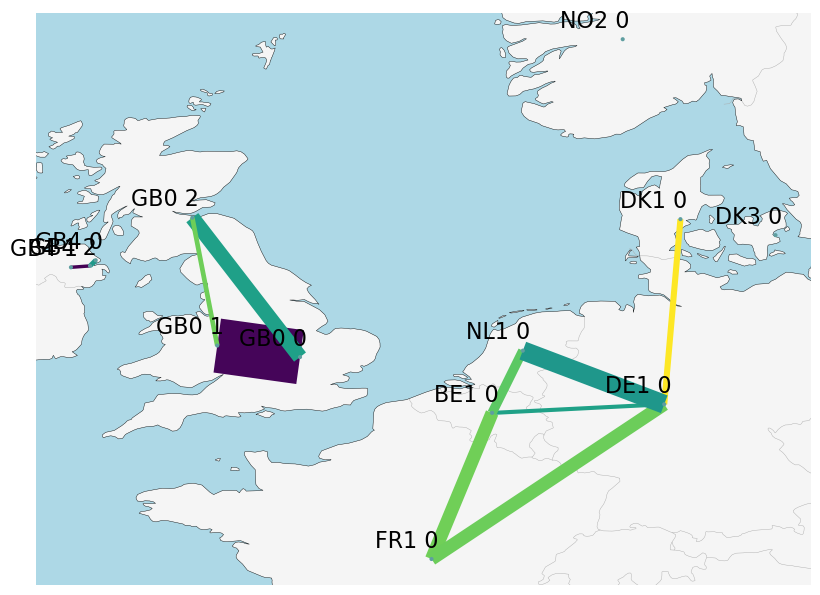

In [91]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [92]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


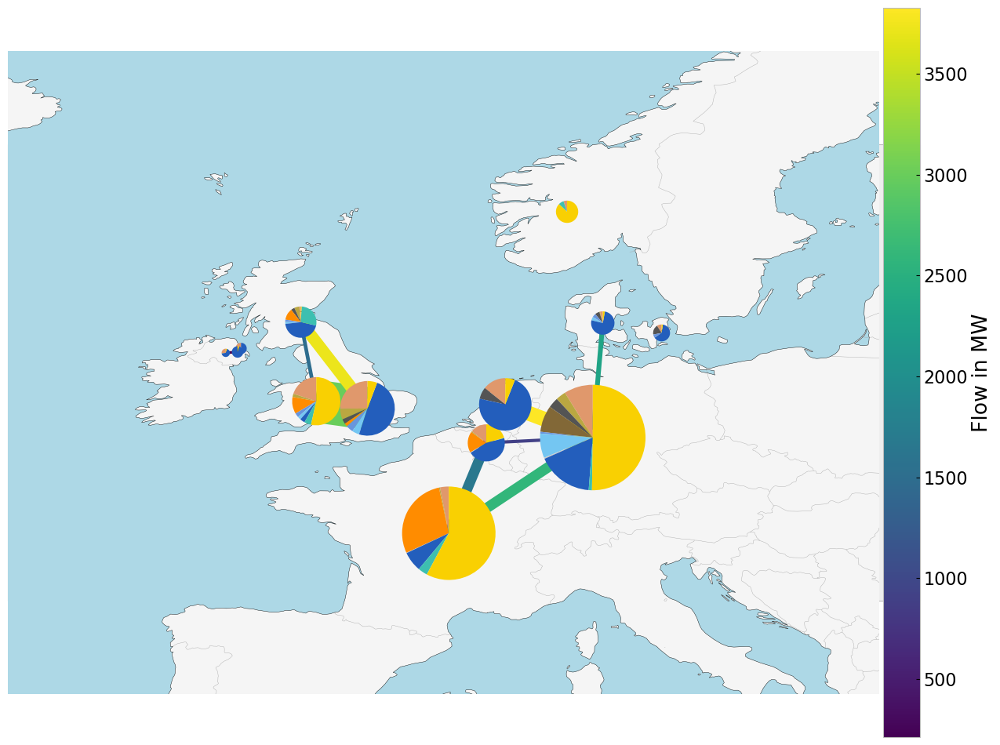

In [93]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [94]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


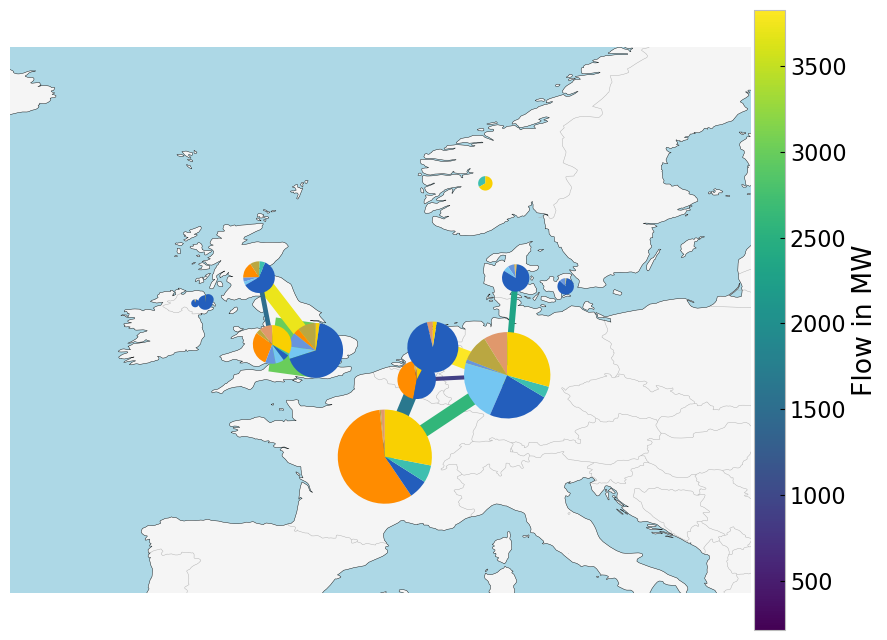

In [95]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

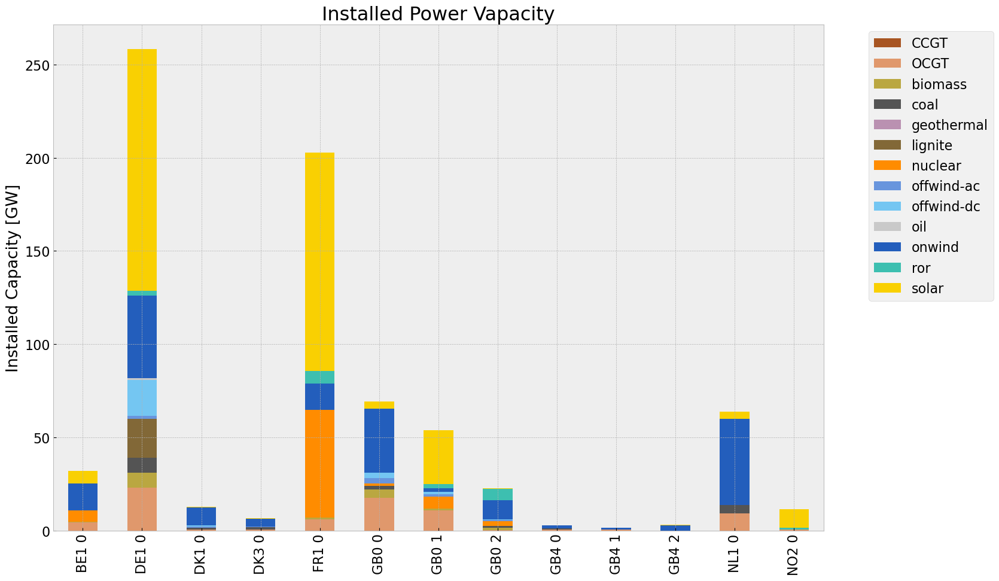

In [96]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

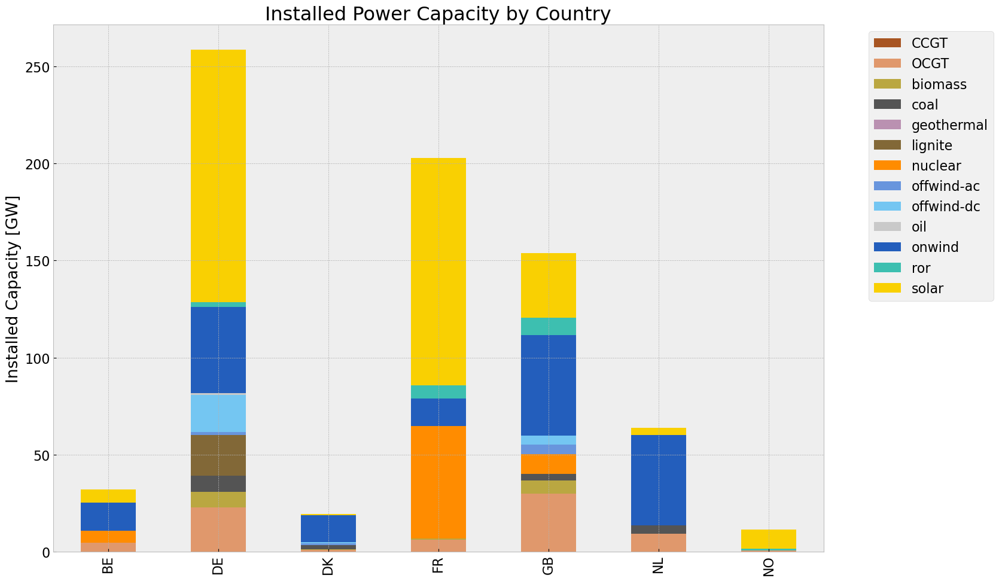

In [97]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

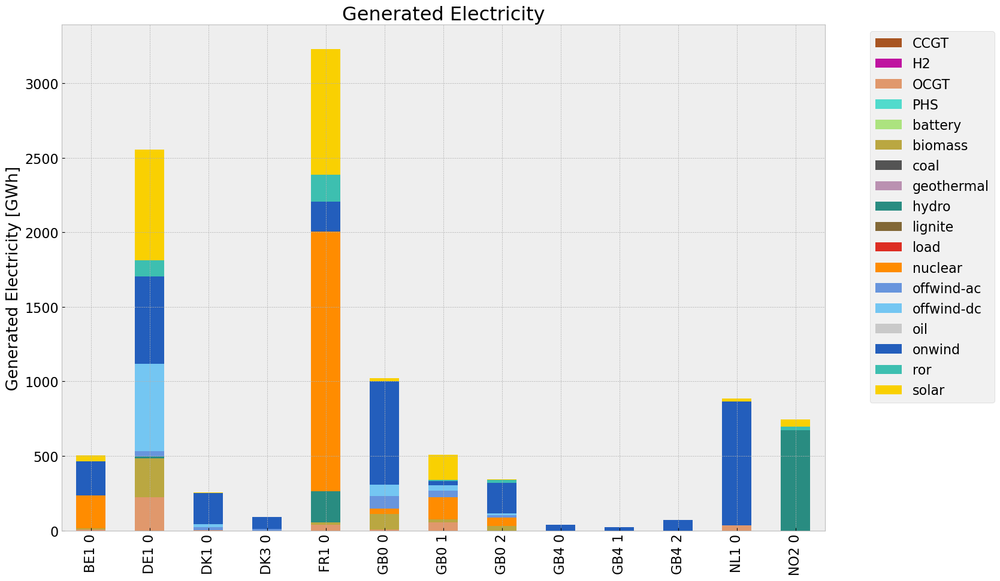

In [98]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

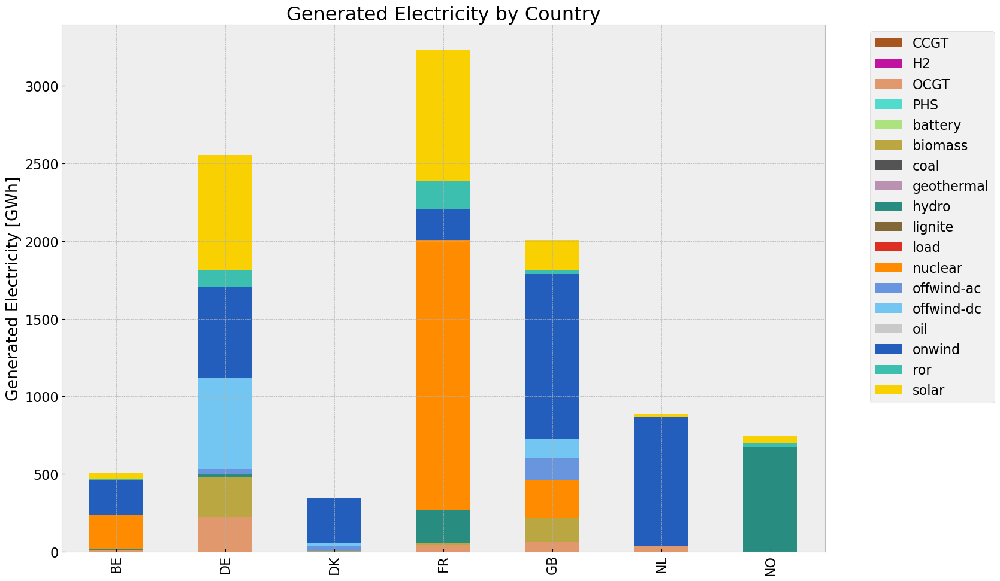

In [99]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [100]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [101]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [102]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production in {country}")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [103]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [104]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [105]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [106]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

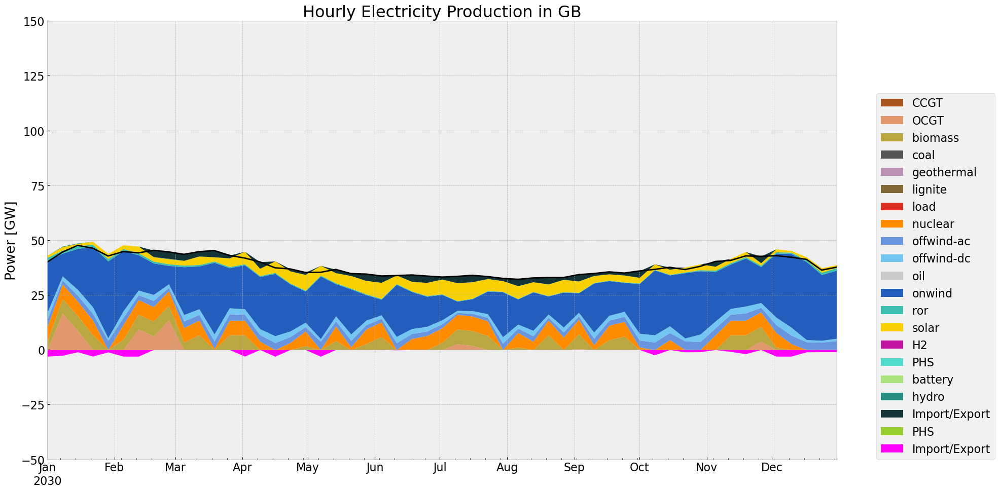

In [107]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen, 'GB')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

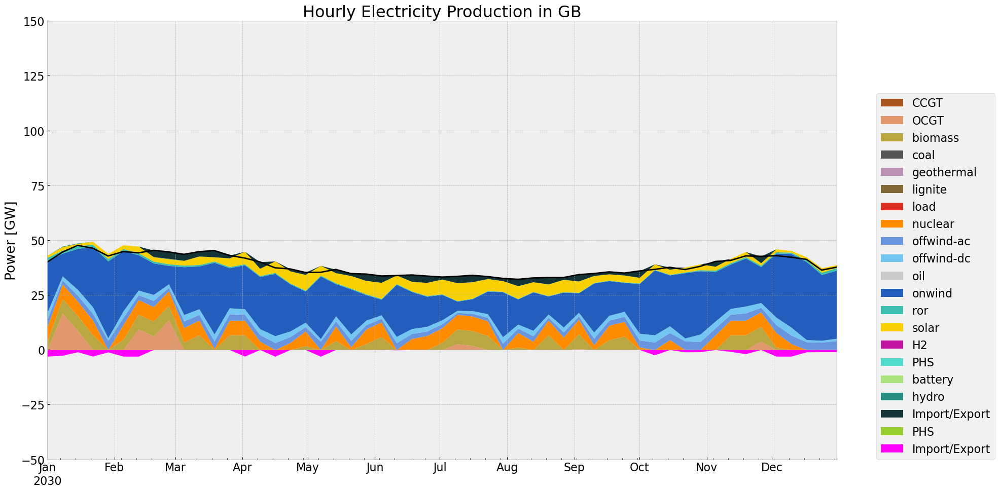

In [108]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'GB')

In [109]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

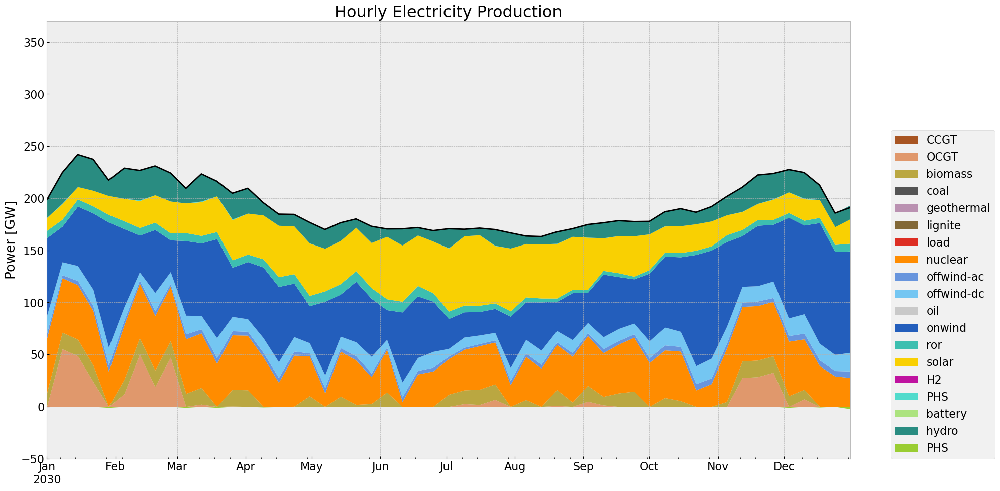

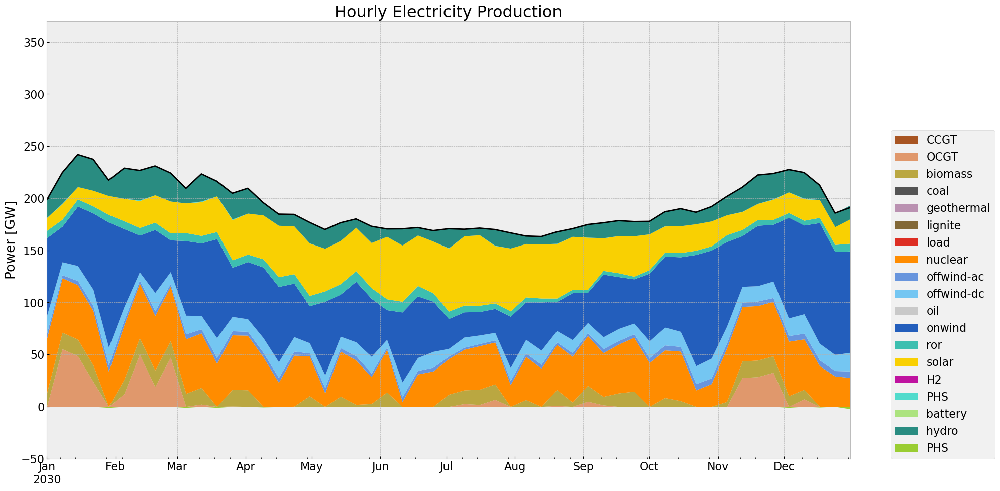

In [110]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [111]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

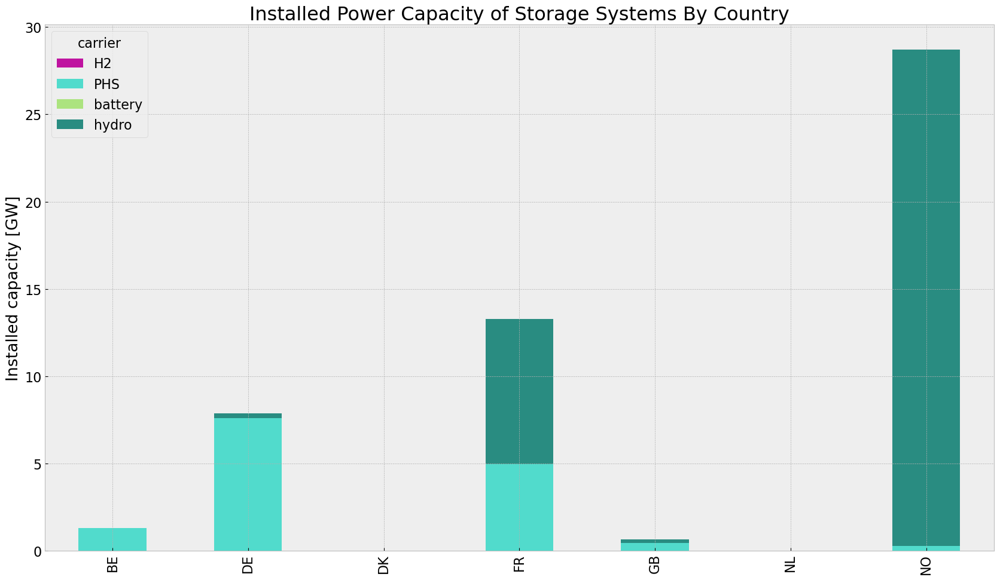

In [112]:
store_base = inst_store_table(n)

In [113]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


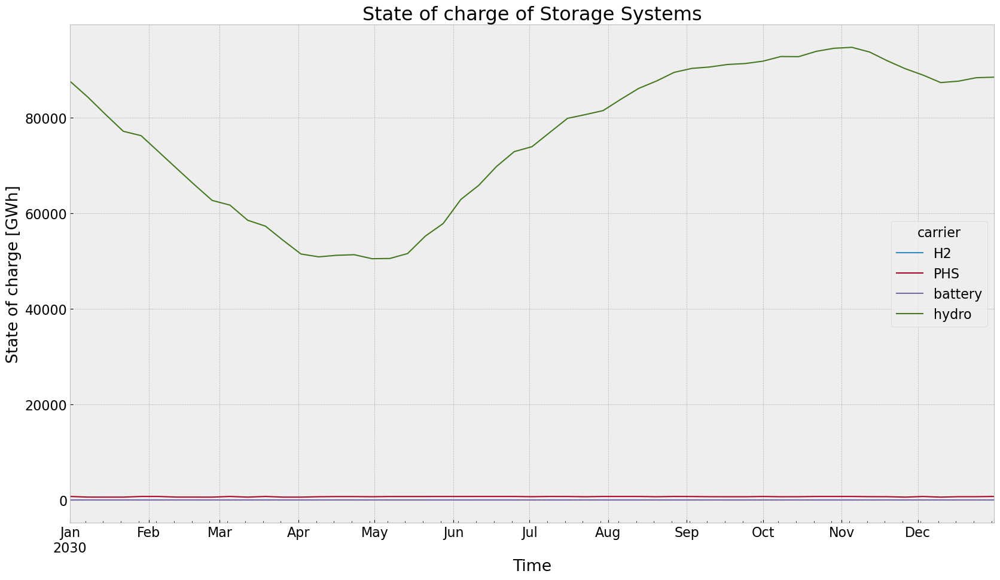

In [114]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [115]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [116]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


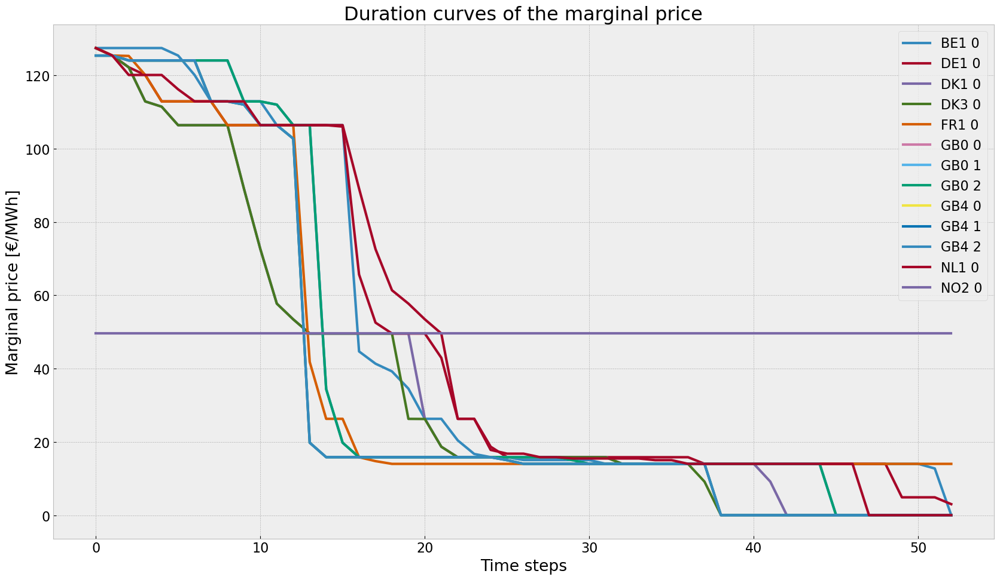

In [117]:
price_dur_curve_plot(n)

In [118]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


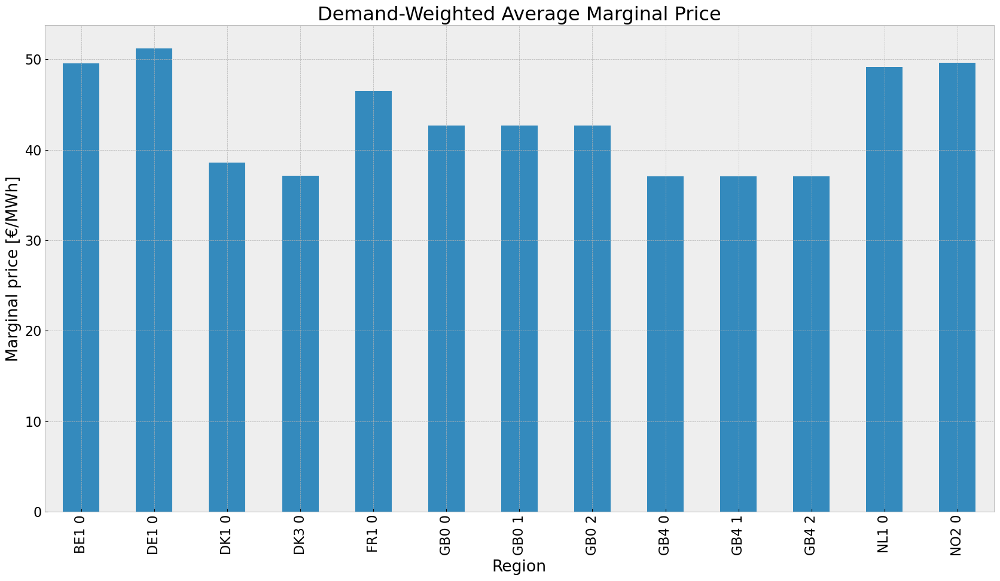

In [119]:
price_regions_table(n)

In [120]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


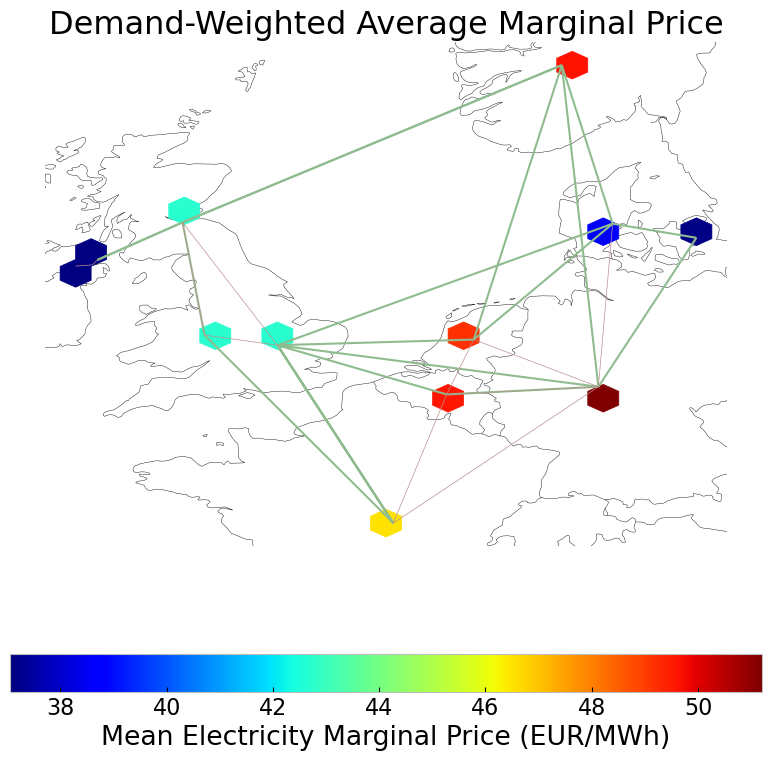

In [121]:
price_regions(n)

## Emission

In [122]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.00000
OCGT,3.727670e+05,0.431981,0.1980,170858.92235
biomass,4.366849e+05,0.468000,0.0000,0.00000
coal,0.000000e+00,0.329985,0.3361,0.00000
geothermal,0.000000e+00,1.000000,0.1200,0.00000
lignite,0.000000e+00,0.333701,0.4069,0.00000
load,0.000000e+00,1.000000,0.0000,0.00000
nuclear,2.203405e+06,0.326308,0.0000,0.00000
offwind-ac,2.105532e+05,1.000000,0.0000,0.00000


# PV Cut Scenario



In [123]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

In [124]:
country = 'GB'

### Allow investment

In [125]:
def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC' and (country in row['bus0'] or country in row['bus1']):
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC' and (country in row['bus0'] or country in row['bus1']):
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False
            

allow_inv(n1,n, country)

In [126]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 134.81it/s]
INFO:linopy.io: Writing time: 0.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ef7e8r60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ef7e8r60.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0xa241193e


INFO:gurobipy:Model fingerprint: 0xa241193e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [8e-03, 3e+02]


INFO:gurobipy:  Matrix range     [8e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7134 columns


INFO:gurobipy:Presolve removed 28775 rows and 7134 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.72901987e+13 -1.61470732e+14  1.40e+05 4.06e+06  6.12e+10     0s


INFO:gurobipy:   0   2.72901987e+13 -1.61470732e+14  1.40e+05 4.06e+06  6.12e+10     0s


   1   1.81574620e+13 -5.99159752e+13  8.77e+04 7.80e+05  2.70e+10     0s


INFO:gurobipy:   1   1.81574620e+13 -5.99159752e+13  8.77e+04 7.80e+05  2.70e+10     0s


   2   6.35339885e+12 -2.88903342e+13  2.71e+04 4.06e+04  7.70e+09     0s


INFO:gurobipy:   2   6.35339885e+12 -2.88903342e+13  2.71e+04 4.06e+04  7.70e+09     0s


   3   6.12051366e+11 -1.25456720e+13  1.50e+03 6.77e+03  9.17e+08     0s


INFO:gurobipy:   3   6.12051366e+11 -1.25456720e+13  1.50e+03 6.77e+03  9.17e+08     0s


   4   2.62412519e+11 -2.08251527e+12  1.37e+02 7.22e+02  1.28e+08     0s


INFO:gurobipy:   4   2.62412519e+11 -2.08251527e+12  1.37e+02 7.22e+02  1.28e+08     0s


   5   1.78422824e+11 -1.31548264e+12  3.57e+01 4.55e+02  7.55e+07     0s


INFO:gurobipy:   5   1.78422824e+11 -1.31548264e+12  3.57e+01 4.55e+02  7.55e+07     0s


   6   1.61326191e+11 -8.96446967e+11  2.60e+01 3.08e+02  5.30e+07     0s


INFO:gurobipy:   6   1.61326191e+11 -8.96446967e+11  2.60e+01 3.08e+02  5.30e+07     0s


   7   1.05613117e+11 -3.18007946e+11  5.36e+00 1.08e+02  2.07e+07     0s


INFO:gurobipy:   7   1.05613117e+11 -3.18007946e+11  5.36e+00 1.08e+02  2.07e+07     0s


   8   6.18412283e+10 -1.04127207e+11  1.13e+00 3.75e+01  8.01e+06     0s


INFO:gurobipy:   8   6.18412283e+10 -1.04127207e+11  1.13e+00 3.75e+01  8.01e+06     0s


   9   4.86561173e+10 -3.54674745e+10  6.23e-01 1.75e+01  4.05e+06     0s


INFO:gurobipy:   9   4.86561173e+10 -3.54674745e+10  6.23e-01 1.75e+01  4.05e+06     0s


  10   3.82155377e+10 -1.04244977e+10  3.48e-01 9.85e+00  2.34e+06     0s


INFO:gurobipy:  10   3.82155377e+10 -1.04244977e+10  3.48e-01 9.85e+00  2.34e+06     0s


  11   3.20928781e+10  1.09800704e+09  2.04e-01 6.35e+00  1.49e+06     0s


INFO:gurobipy:  11   3.20928781e+10  1.09800704e+09  2.04e-01 6.35e+00  1.49e+06     0s


  12   2.83308874e+10  1.11993241e+10  1.17e-01 3.29e+00  8.20e+05     0s


INFO:gurobipy:  12   2.83308874e+10  1.11993241e+10  1.17e-01 3.29e+00  8.20e+05     0s


  13   2.62150259e+10  1.50072110e+10  7.06e-02 2.17e+00  5.37e+05     0s


INFO:gurobipy:  13   2.62150259e+10  1.50072110e+10  7.06e-02 2.17e+00  5.37e+05     0s


  14   2.47668288e+10  1.80422447e+10  3.71e-02 1.29e+00  3.22e+05     0s


INFO:gurobipy:  14   2.47668288e+10  1.80422447e+10  3.71e-02 1.29e+00  3.22e+05     0s


  15   2.35989977e+10  2.12477427e+10  1.18e-02 3.63e-01  1.12e+05     0s


INFO:gurobipy:  15   2.35989977e+10  2.12477427e+10  1.18e-02 3.63e-01  1.12e+05     0s


  16   2.31253111e+10  2.20298490e+10  5.49e-03 1.47e-01  5.24e+04     0s


INFO:gurobipy:  16   2.31253111e+10  2.20298490e+10  5.49e-03 1.47e-01  5.24e+04     0s


  17   2.29153932e+10  2.23592216e+10  2.89e-03 6.60e-02  2.66e+04     0s


INFO:gurobipy:  17   2.29153932e+10  2.23592216e+10  2.89e-03 6.60e-02  2.66e+04     0s


  18   2.28329825e+10  2.25189930e+10  1.97e-03 2.66e-02  1.50e+04     0s


INFO:gurobipy:  18   2.28329825e+10  2.25189930e+10  1.97e-03 2.66e-02  1.50e+04     0s


  19   2.27371473e+10  2.25816989e+10  9.09e-04 1.34e-02  7.43e+03     0s


INFO:gurobipy:  19   2.27371473e+10  2.25816989e+10  9.09e-04 1.34e-02  7.43e+03     0s


  20   2.27114152e+10  2.26019588e+10  6.44e-04 9.14e-03  5.23e+03     0s


INFO:gurobipy:  20   2.27114152e+10  2.26019588e+10  6.44e-04 9.14e-03  5.23e+03     0s


  21   2.26567990e+10  2.26388634e+10  6.70e-05 1.85e-03  8.57e+02     0s


INFO:gurobipy:  21   2.26567990e+10  2.26388634e+10  6.70e-05 1.85e-03  8.57e+02     0s


  22   2.26494066e+10  2.26472034e+10  2.44e-06 2.43e-04  1.05e+02     0s


INFO:gurobipy:  22   2.26494066e+10  2.26472034e+10  2.44e-06 2.43e-04  1.05e+02     0s


  23   2.26489094e+10  2.26483411e+10  3.13e-04 6.48e-05  2.72e+01     1s


INFO:gurobipy:  23   2.26489094e+10  2.26483411e+10  3.13e-04 6.48e-05  2.72e+01     1s


  24   2.26488354e+10  2.26486586e+10  1.82e-04 1.87e-05  8.45e+00     1s


INFO:gurobipy:  24   2.26488354e+10  2.26486586e+10  1.82e-04 1.87e-05  8.45e+00     1s


  25   2.26488105e+10  2.26487496e+10  9.14e-05 6.16e-06  2.91e+00     1s


INFO:gurobipy:  25   2.26488105e+10  2.26487496e+10  9.14e-05 6.16e-06  2.91e+00     1s


  26   2.26488002e+10  2.26487707e+10  3.24e-05 3.23e-06  1.41e+00     1s


INFO:gurobipy:  26   2.26488002e+10  2.26487707e+10  3.24e-05 3.23e-06  1.41e+00     1s


  27   2.26487988e+10  2.26487892e+10  2.48e-05 7.05e-07  4.57e-01     1s


INFO:gurobipy:  27   2.26487988e+10  2.26487892e+10  2.48e-05 7.05e-07  4.57e-01     1s


  28   2.26487965e+10  2.26487941e+10  9.67e-06 8.78e-08  1.16e-01     1s


INFO:gurobipy:  28   2.26487965e+10  2.26487941e+10  9.67e-06 8.78e-08  1.16e-01     1s


  29   2.26487952e+10  2.26487948e+10  1.31e-06 1.68e-08  2.12e-02     1s


INFO:gurobipy:  29   2.26487952e+10  2.26487948e+10  1.31e-06 1.68e-08  2.12e-02     1s


  30   2.26487950e+10  2.26487950e+10  5.05e-08 1.46e-09  8.07e-04     1s


INFO:gurobipy:  30   2.26487950e+10  2.26487950e+10  5.05e-08 1.46e-09  8.07e-04     1s


  31   2.26487950e+10  2.26487950e+10  1.05e-08 1.22e-09  8.63e-06     1s


INFO:gurobipy:  31   2.26487950e+10  2.26487950e+10  1.05e-08 1.22e-09  8.63e-06     1s


  32   2.26487950e+10  2.26487950e+10  7.71e-10 1.40e-09  8.16e-08     1s


INFO:gurobipy:  32   2.26487950e+10  2.26487950e+10  7.71e-10 1.40e-09  8.16e-08     1s


  33   2.26487950e+10  2.26487950e+10  2.85e-10 1.40e-09  2.80e-09     1s


INFO:gurobipy:  33   2.26487950e+10  2.26487950e+10  2.85e-10 1.40e-09  2.80e-09     1s


INFO:gurobipy:


Barrier solved model in 33 iterations and 0.64 seconds (0.21 work units)


INFO:gurobipy:Barrier solved model in 33 iterations and 0.64 seconds (0.21 work units)


Optimal objective 2.26487950e+10


INFO:gurobipy:Optimal objective 2.26487950e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3297 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3297 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


      85 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:      85 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2878287e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2878287e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1749    2.2648795e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1749    2.2648795e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1749 iterations and 0.77 seconds (0.22 work units)


INFO:gurobipy:Solved in 1749 iterations and 0.77 seconds (0.22 work units)


Optimal objective  2.264879497e+10


INFO:gurobipy:Optimal objective  2.264879497e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.26e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [127]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has loads, links, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 164kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, loads_i: 13,
                                           loads_t_p_set_i: 13,
                                           loads_t_p_i: 13, links_i: 21,
                                           links_t_p0_i: 13, links_t_p1_i: 13,
                                           buses_i: 13, buses_t_p_i: 13,
                                           ...
                                           storage_units_t_state_of_charge_i: 36,
                                           generators_i: 174,
                                           generators_t_p_max_pu_i: 57,
                                           generators_t_p_i: 62, lines_i: 11,
                                           lines_t_p0_i: 11, lines_t_p1_i: 11,
                                           lines_t_loss_i: 11)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * loads_i                               (loads_i) object 104B 'BE1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 104B 'BE1 ...
  * loads_t_p_i                           (loads_t_p_i) object 104B 'BE1 0' ....
  * links_i                               (links_i) object 168B '14801' ... '...
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                      (generators_t_p_i) object 496B 'BE1...
  * lines_i                               (lines_i) object 88B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 88B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 88B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 88B '0' ......
Data variables: (12/99)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_s_nom_opt                       (lines_i) float64 88B 2.949e+03 ......
    lines_s_nom_extendable                (lines_i) bool 11B False ... True
    lines_s_nom_min                       (lines_i) float64 88B 0.0 ... 3.441...
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           22648794970.14607
    network_objective_constant:  6214367522.206728
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [128]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

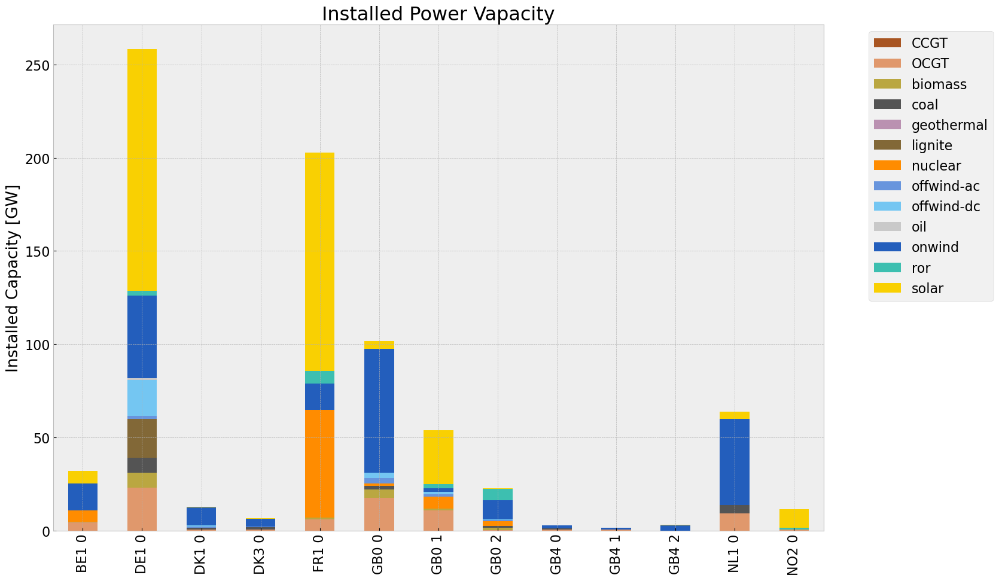

<Figure size 640x480 with 0 Axes>

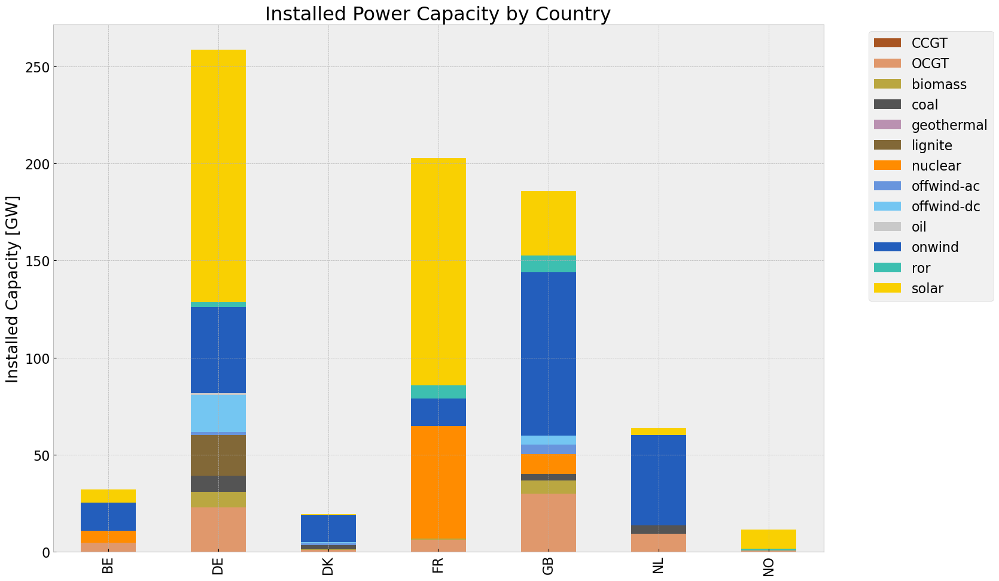

In [129]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

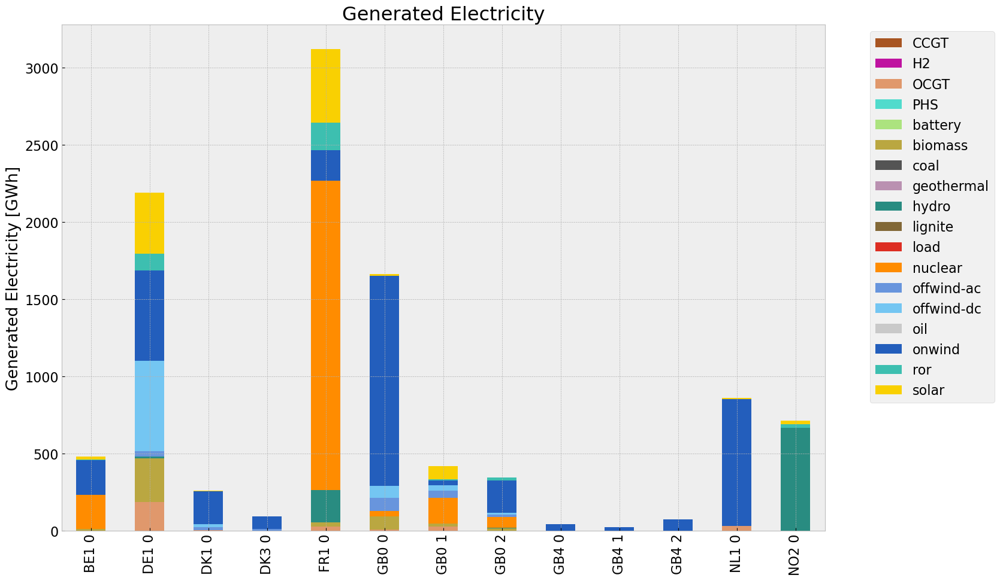

<Figure size 640x480 with 0 Axes>

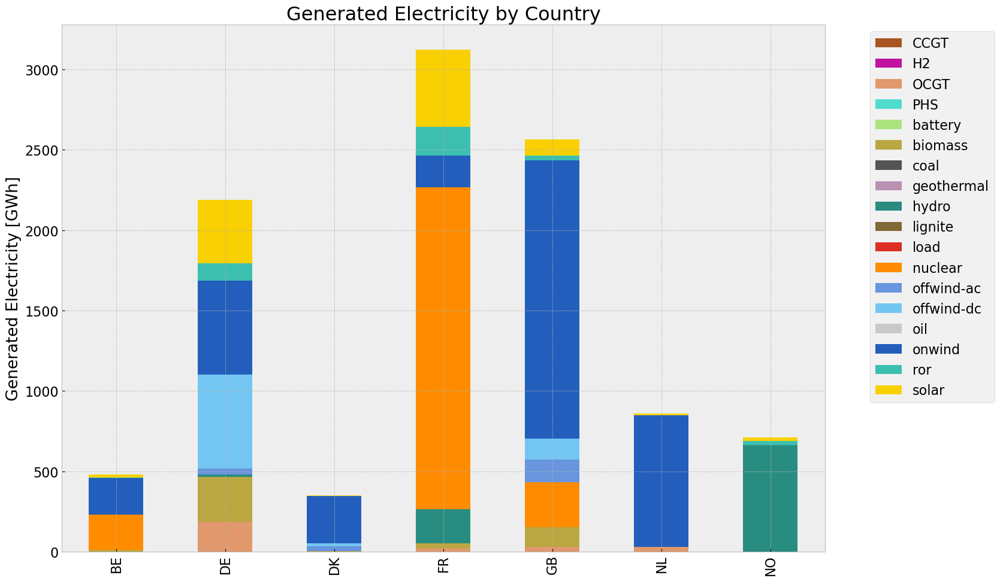

In [130]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

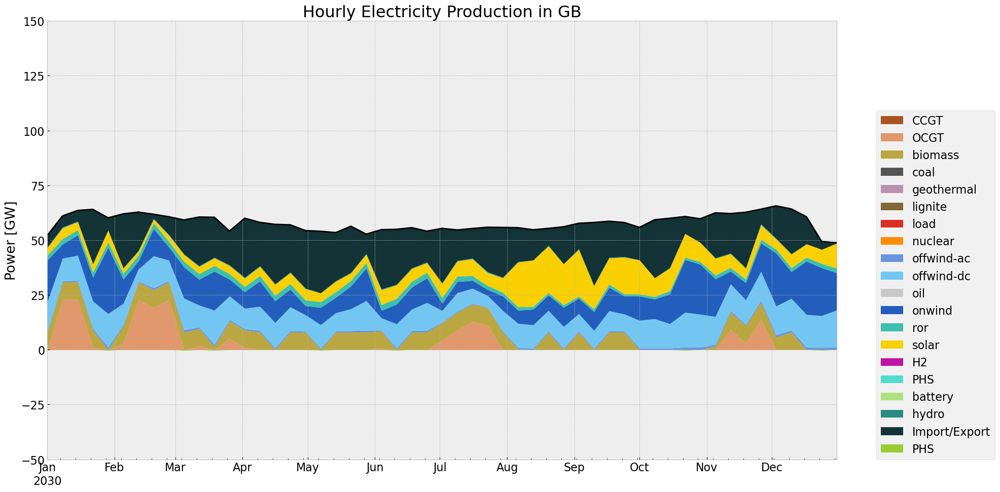

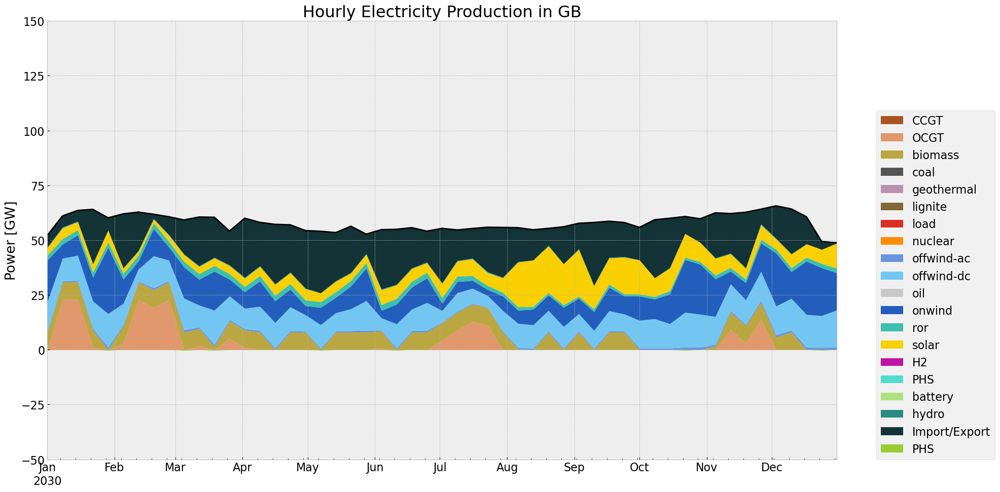

In [131]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

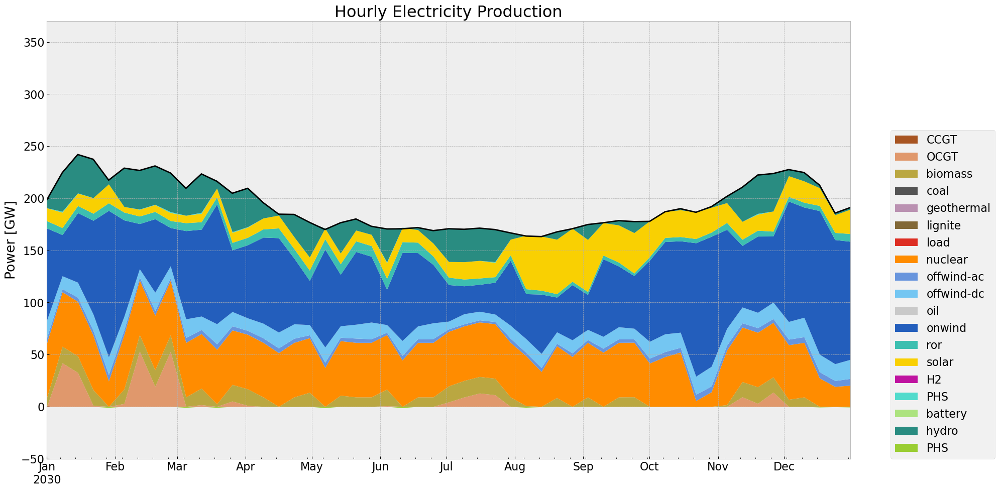

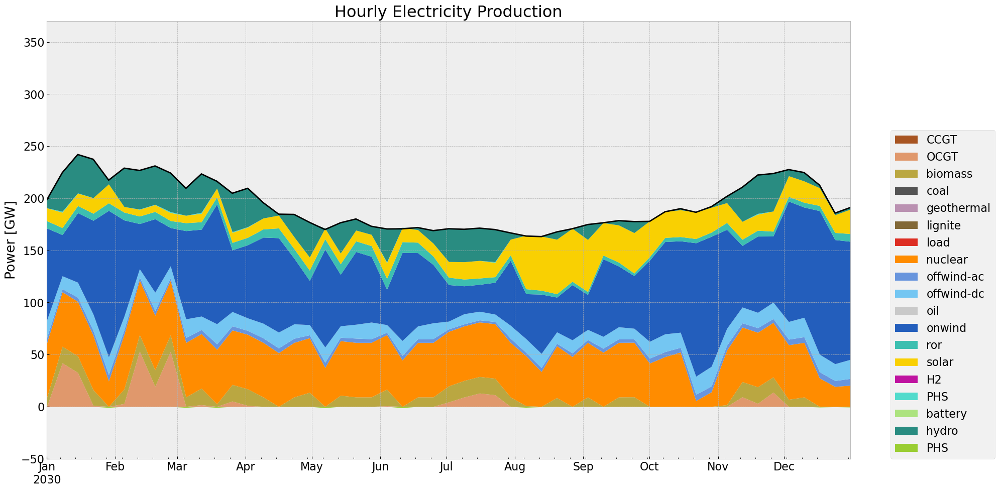

In [132]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

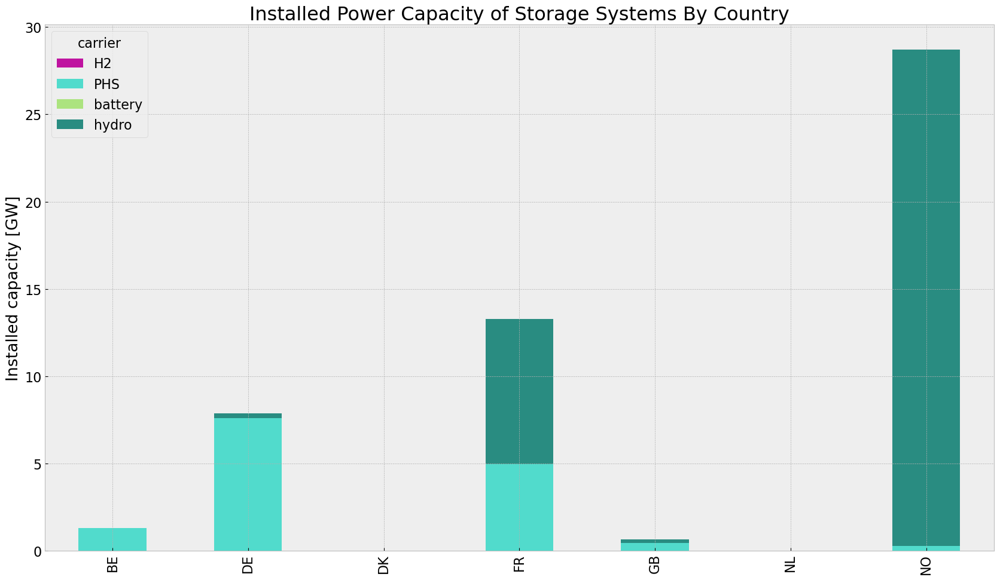

In [133]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


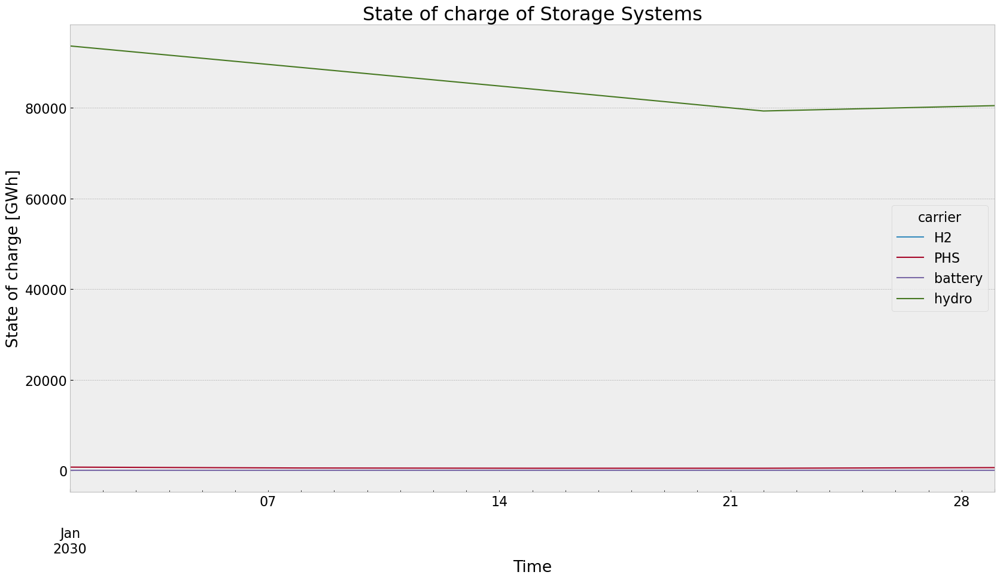

In [134]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


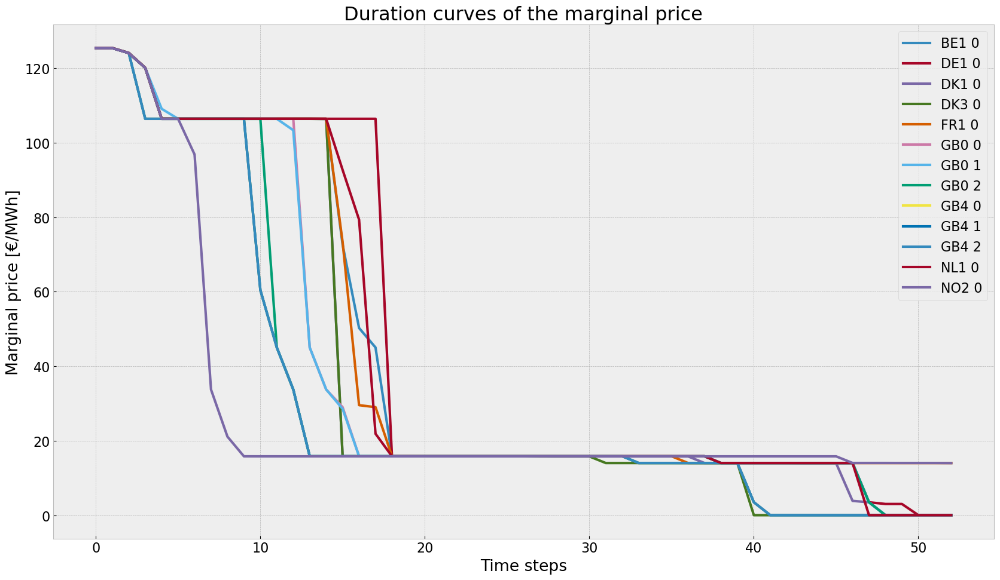

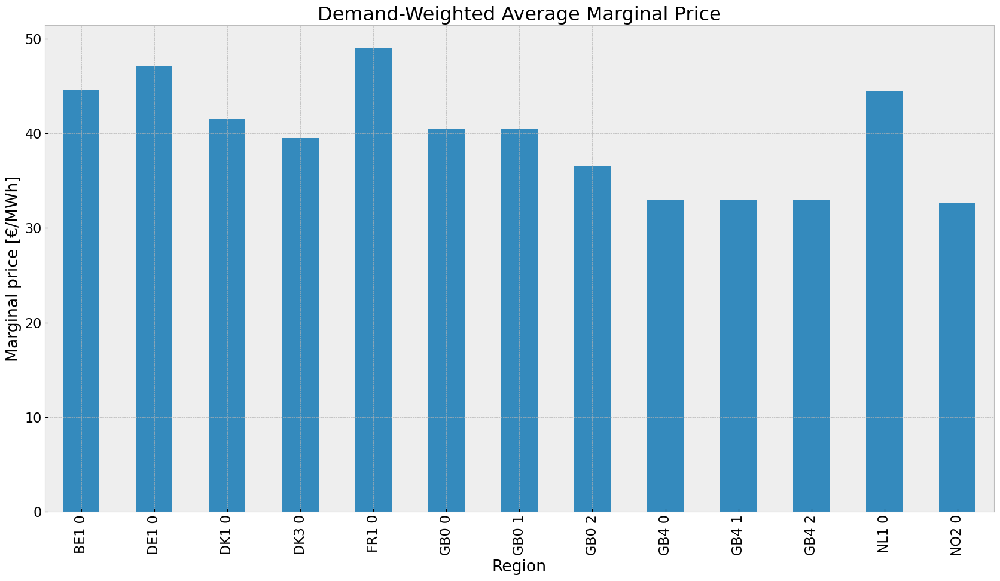

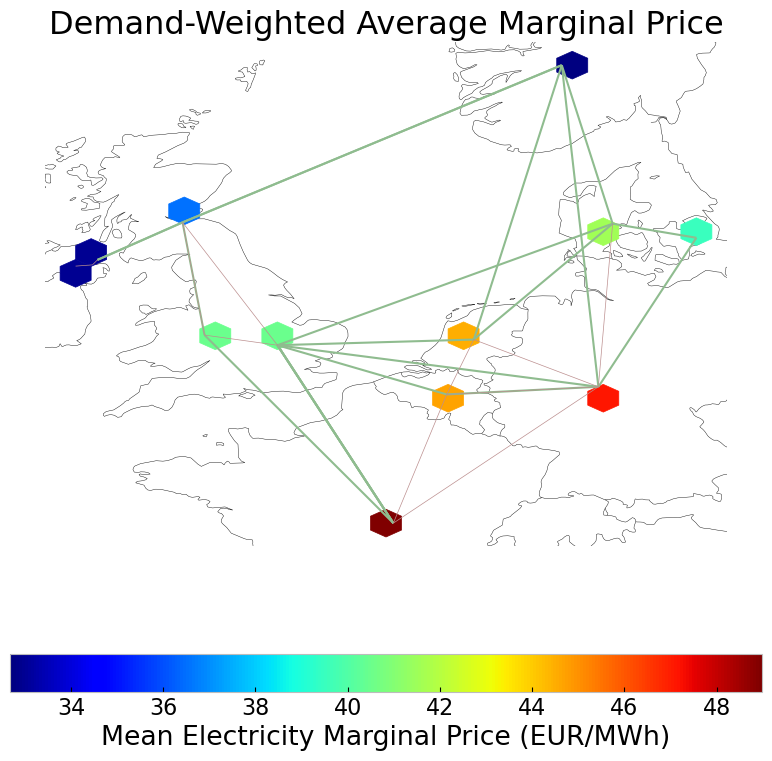

In [135]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [136]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.744153e+05,0.431981,0.1980,125779.122794
biomass,4.419250e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329985,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.333701,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.500834e+06,0.326308,0.0000,0.000000
offwind-ac,2.116461e+05,1.000000,0.0000,0.000000


## 2. Noinv

In [137]:
n2 = pvscenario(n, cut_start, duration, reductionto)

### No Investment

In [138]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)


In [139]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'


INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aa6957so.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aa6957so.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xfad340da


INFO:gurobipy:Model fingerprint: 0xfad340da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2616 rows and 760 columns


INFO:gurobipy:Presolve removed 2616 rows and 760 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 104 rows, 516 columns, 732 nonzeros


INFO:gurobipy:Presolved: 104 rows, 516 columns, 732 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9186288e+05   8.197008e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9186288e+05   8.197008e+05   0.000000e+00      0s


     122    2.0332286e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     122    2.0332286e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 122 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 122 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.033228597e+10


INFO:gurobipy:Optimal objective  2.033228597e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lo3_qqa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lo3_qqa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xfe0b614a


INFO:gurobipy:Model fingerprint: 0xfe0b614a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2616 rows and 766 columns


INFO:gurobipy:Presolve removed 2616 rows and 766 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 510 columns, 726 nonzeros


INFO:gurobipy:Presolved: 104 rows, 510 columns, 726 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1860927e+07   6.946892e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1860927e+07   6.946892e+05   0.000000e+00      0s


     102    2.1456773e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     102    2.1456773e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 102 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 102 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.145677266e+10


INFO:gurobipy:Optimal objective  2.145677266e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.15e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20y1vfhf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20y1vfhf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0x93e4f25f


INFO:gurobipy:Model fingerprint: 0x93e4f25f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 763 columns


INFO:gurobipy:Presolve removed 2616 rows and 763 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 513 columns, 729 nonzeros


INFO:gurobipy:Presolved: 104 rows, 513 columns, 729 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7243511e+05   6.685242e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7243511e+05   6.685242e+05   0.000000e+00      0s


     113    2.0436272e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     113    2.0436272e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 113 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 113 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.043627165e+10


INFO:gurobipy:Optimal objective  2.043627165e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.04e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1u3xaa5g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1u3xaa5g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xc890d34d


INFO:gurobipy:Model fingerprint: 0xc890d34d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 2616 rows and 755 columns


INFO:gurobipy:Presolve removed 2616 rows and 755 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 104 rows, 521 columns, 737 nonzeros


INFO:gurobipy:Presolved: 104 rows, 521 columns, 737 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4625829e+05   5.910350e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4625829e+05   5.910350e+05   0.000000e+00      0s


     122    1.4995003e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     122    1.4995003e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 122 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 122 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.499500264e+10


INFO:gurobipy:Optimal objective  1.499500264e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.50e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ki7_zmuc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ki7_zmuc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0x75c5e989


INFO:gurobipy:Model fingerprint: 0x75c5e989


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 754 columns


INFO:gurobipy:Presolve removed 2616 rows and 754 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3858329e+05   5.255662e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3858329e+05   5.255662e+05   0.000000e+00      0s


      87    4.3554787e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    4.3554787e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.355478744e+09


INFO:gurobipy:Optimal objective  4.355478744e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 4.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oyiu7uqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oyiu7uqb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xbc500356


INFO:gurobipy:Model fingerprint: 0xbc500356


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 757 columns


INFO:gurobipy:Presolve removed 2616 rows and 757 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 519 columns, 735 nonzeros


INFO:gurobipy:Presolved: 104 rows, 519 columns, 735 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2418915e+05   4.759394e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2418915e+05   4.759394e+05   0.000000e+00      0s


     100    2.5285795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     100    2.5285795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 100 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 100 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.528579521e+08


INFO:gurobipy:Optimal objective  2.528579521e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ds9pbcsb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ds9pbcsb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xf7c53957


INFO:gurobipy:Model fingerprint: 0xf7c53957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 754 columns


INFO:gurobipy:Presolve removed 2616 rows and 754 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0319787e+04   4.626272e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0319787e+04   4.626272e+05   0.000000e+00      0s


     101    4.0517009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     101    4.0517009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 101 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 101 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.051700899e+08


INFO:gurobipy:Optimal objective  4.051700899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 4.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jun0bmkf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jun0bmkf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0x29930496


INFO:gurobipy:Model fingerprint: 0x29930496


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 750 columns


INFO:gurobipy:Presolve removed 2616 rows and 750 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 104 rows, 526 columns, 742 nonzeros


INFO:gurobipy:Presolved: 104 rows, 526 columns, 742 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0185361e+05   4.461447e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0185361e+05   4.461447e+05   0.000000e+00      0s


     114    5.7241892e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    5.7241892e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.06 seconds (0.00 work units)


Optimal objective  5.724189225e+08


INFO:gurobipy:Optimal objective  5.724189225e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 5.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6k03vb6c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6k03vb6c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0x8cdbb1d7


INFO:gurobipy:Model fingerprint: 0x8cdbb1d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 753 columns


INFO:gurobipy:Presolve removed 2616 rows and 753 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 523 columns, 739 nonzeros


INFO:gurobipy:Presolved: 104 rows, 523 columns, 739 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2157125e+05   4.650023e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2157125e+05   4.650023e+05   0.000000e+00      0s


     122    5.9443946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     122    5.9443946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 122 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 122 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.944394629e+08


INFO:gurobipy:Optimal objective  5.944394629e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 5.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwu2gg96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwu2gg96.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0x53b22708


INFO:gurobipy:Model fingerprint: 0x53b22708


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 754 columns


INFO:gurobipy:Presolve removed 2616 rows and 754 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:Presolved: 104 rows, 522 columns, 738 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9895532e+05   5.064953e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9895532e+05   5.064953e+05   0.000000e+00      0s


     135    5.4872991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     135    5.4872991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 135 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 135 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.487299069e+08


INFO:gurobipy:Optimal objective  5.487299069e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 5.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49akofv5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49akofv5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xc285f737


INFO:gurobipy:Model fingerprint: 0xc285f737


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2616 rows and 776 columns


INFO:gurobipy:Presolve removed 2616 rows and 776 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 104 rows, 500 columns, 716 nonzeros


INFO:gurobipy:Presolved: 104 rows, 500 columns, 716 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4604439e+05   5.525575e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4604439e+05   5.525575e+05   0.000000e+00      0s


     115    3.3291363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     115    3.3291363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 115 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 115 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.329136329e+08


INFO:gurobipy:Optimal objective  3.329136329e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29y984mz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29y984mz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xcd6387f9


INFO:gurobipy:Model fingerprint: 0xcd6387f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2616 rows and 758 columns


INFO:gurobipy:Presolve removed 2616 rows and 758 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 518 columns, 734 nonzeros


INFO:gurobipy:Presolved: 104 rows, 518 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1749528e+05   6.287567e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1749528e+05   6.287567e+05   0.000000e+00      0s


     127    2.6288765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.6288765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.628876488e+09


INFO:gurobipy:Optimal objective  2.628876488e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lj13bd35.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lj13bd35.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4364 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4364 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4364 nonzeros


Model fingerprint: 0xcbbcd1ad


INFO:gurobipy:Model fingerprint: 0xcbbcd1ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2616 rows and 787 columns


INFO:gurobipy:Presolve removed 2616 rows and 787 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 489 columns, 705 nonzeros


INFO:gurobipy:Presolved: 104 rows, 489 columns, 705 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6178074e+05   6.363375e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6178074e+05   6.363375e+05   0.000000e+00      0s


     111    1.3012985e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     111    1.3012985e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 111 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 111 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.301298465e+09


INFO:gurobipy:Optimal objective  1.301298465e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qca6im93.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qca6im93.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 680 rows, 319 columns, 1019 nonzeros


INFO:gurobipy:obj: 680 rows, 319 columns, 1019 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 680 rows, 319 columns and 1019 nonzeros


INFO:gurobipy:Optimize a model with 680 rows, 319 columns and 1019 nonzeros


Model fingerprint: 0xe0ec8504


INFO:gurobipy:Model fingerprint: 0xe0ec8504


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 664 rows and 225 columns


INFO:gurobipy:Presolve removed 664 rows and 225 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 16 rows, 94 columns, 123 nonzeros


INFO:gurobipy:Presolved: 16 rows, 94 columns, 123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9164697e+04   5.852521e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.9164697e+04   5.852521e+04   0.000000e+00      0s


      17    8.4443001e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      17    8.4443001e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 17 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 17 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.444300093e+06


INFO:gurobipy:Optimal objective  8.444300093e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 319 primals, 680 duals
Objective: 8.44e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [140]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.73it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ppia2sl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ppia2sl.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x3c7f8128


INFO:gurobipy:Model fingerprint: 0x3c7f8128


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 34662 rows and 10078 columns


INFO:gurobipy:Presolve removed 34662 rows and 10078 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 6829 columns, 9691 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6829 columns, 9691 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.17387074e+13 -1.33466000e+14  9.31e+04 6.88e+05  4.28e+10     0s


INFO:gurobipy:   0   2.17387074e+13 -1.33466000e+14  9.31e+04 6.88e+05  4.28e+10     0s


   1   3.66161435e+12 -2.59692226e+13  9.54e+03 3.73e-09  4.95e+09     0s


INFO:gurobipy:   1   3.66161435e+12 -2.59692226e+13  9.54e+03 3.73e-09  4.95e+09     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    2.1705958e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    2.1705958e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.17 seconds (0.03 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.17 seconds (0.03 work units)


Optimal objective  2.170595827e+10


INFO:gurobipy:Optimal objective  2.170595827e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 2.17e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [141]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network GB_13_1.0_base_roll_solved_168h.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 163kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     loads_i: 13,
                                                     loads_t_p_set_i: 13,
                                                     loads_t_p_i: 13,
                                                     links_i: 21,
                                                     ...
                                                     generators_t_p_max_pu_i: 57,
                                                     generators_t_p_i: 67,
                                                     lines_i: 11,
                                                     lines_t_p0_i: 11,
                                                     lines_t_p1_i: 11,
                                                     lines_t_loss_i: 11)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * loads_i                                         (loads_i) object 104B 'BE...
  * loads_t_p_set_i                                 (loads_t_p_set_i) object 104B ...
  * loads_t_p_i                                     (loads_t_p_i) object 104B ...
  * links_i                                         (links_i) object 168B '14...
    ...                                              ...
  * generators_t_p_max_pu_i                         (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                                (generators_t_p_i) object 536B ...
  * lines_i                                         (lines_i) object 88B '0' ...
  * lines_t_p0_i                                    (lines_t_p0_i) object 88B ...
  * lines_t_p1_i                                    (lines_t_p1_i) object 88B ...
  * lines_t_loss_i                                  (lines_t_loss_i) object 88B ...
Data variables: (12/101)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    lines_x_pu_eff                                  (lines_i) float64 88B 0.0...
    lines_r_pu_eff                                  (lines_i) float64 88B 4.8...
    lines_s_nom_opt                                 (lines_i) float64 88B 2.9...
    lines_t_p0                                      (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                                      (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                                    (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_pv_roll
    network_objective:       8444300.092806723
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [142]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 160kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, loads_i: 13,
                                           loads_t_p_set_i: 13,
                                           loads_t_p_i: 13, links_i: 21,
                                           links_t_p0_i: 9, links_t_p1_i: 9,
                                           global_constraints_i: 1,
                                           ...
                                           storage_units_t_state_of_charge_i: 36,
                                           generators_i: 174,
                                           generators_t_p_max_pu_i: 57,
                                           generators_t_p_i: 65, lines_i: 11,
                                           lines_t_p0_i: 11, lines_t_p1_i: 11,
                                           lines_t_loss_i: 11)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * loads_i                               (loads_i) object 104B 'BE1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 104B 'BE1 ...
  * loads_t_p_i                           (loads_t_p_i) object 104B 'BE1 0' ....
  * links_i                               (links_i) object 168B '14801' ... '...
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                      (generators_t_p_i) object 520B 'BE1...
  * lines_i                               (lines_i) object 88B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 88B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 88B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 88B '0' ......
Data variables: (12/97)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_x_pu_eff                        (lines_i) float64 88B 0.0003964 ......
    lines_r_pu_eff                        (lines_i) float64 88B 4.834e-05 ......
    lines_s_nom_opt                       (lines_i) float64 88B 2.949e+03 ......
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       21705958268.130466
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [143]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Base Rolling Horizon

In [144]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

<Figure size 640x480 with 0 Axes>

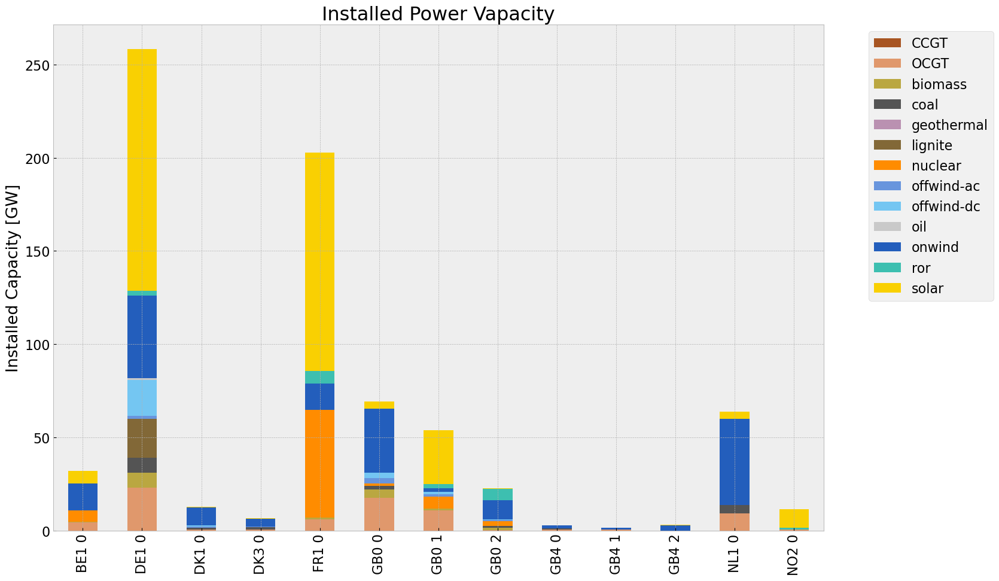

<Figure size 640x480 with 0 Axes>

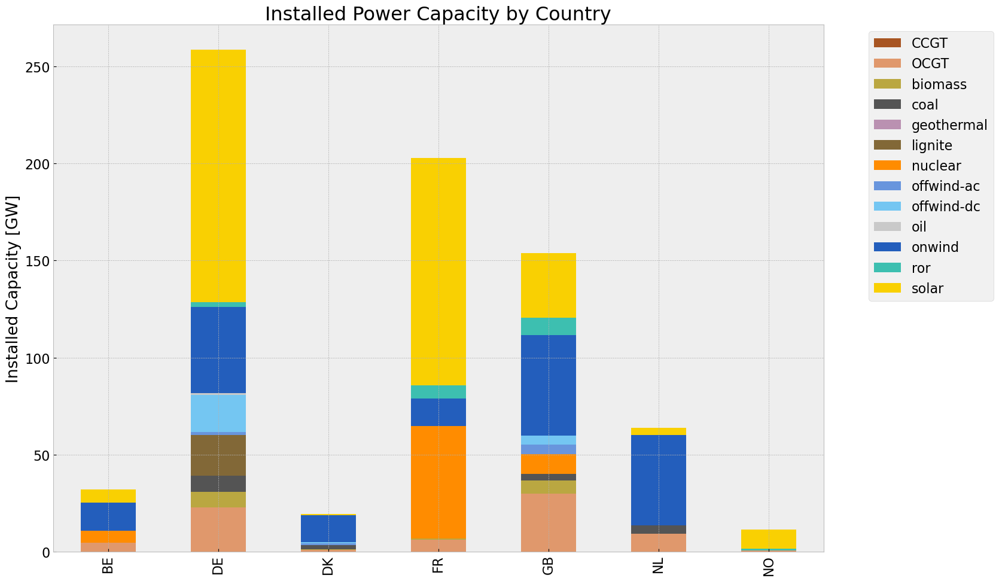

<Figure size 640x480 with 0 Axes>

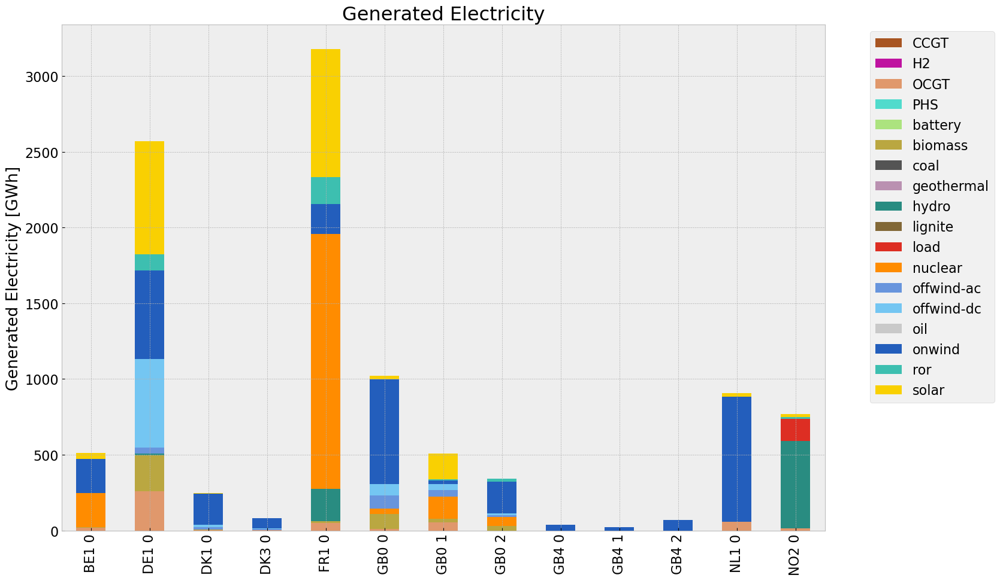

<Figure size 640x480 with 0 Axes>

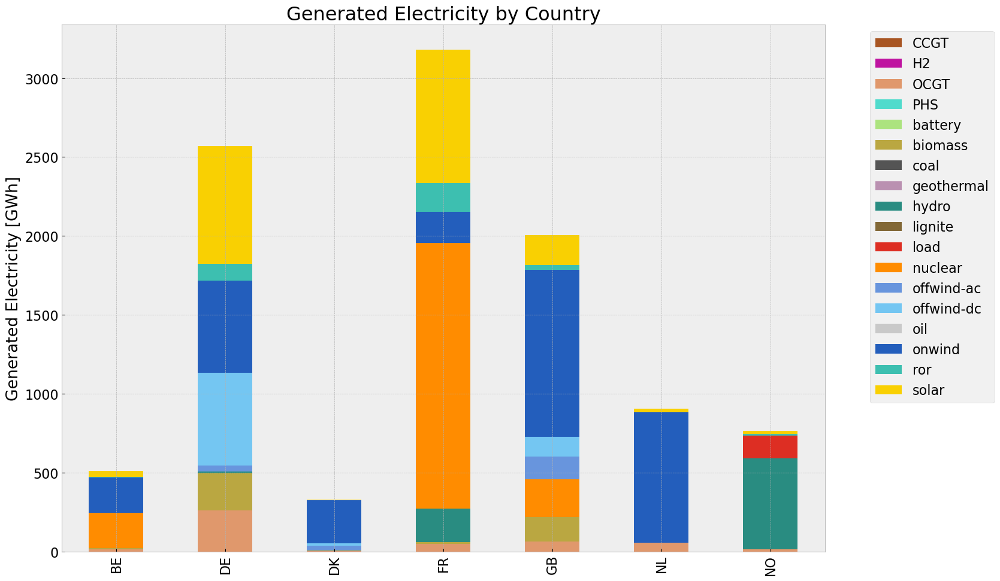

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,4.695707e+05,0.431981,0.1980,215229.208306
biomass,4.158294e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329985,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,5.526366e+02,0.333701,0.4069,673.860263
load,1.451973e+05,1.000000,0.0000,0.000000
nuclear,2.141262e+06,0.326308,0.0000,0.000000
offwind-ac,2.105252e+05,1.000000,0.0000,0.000000


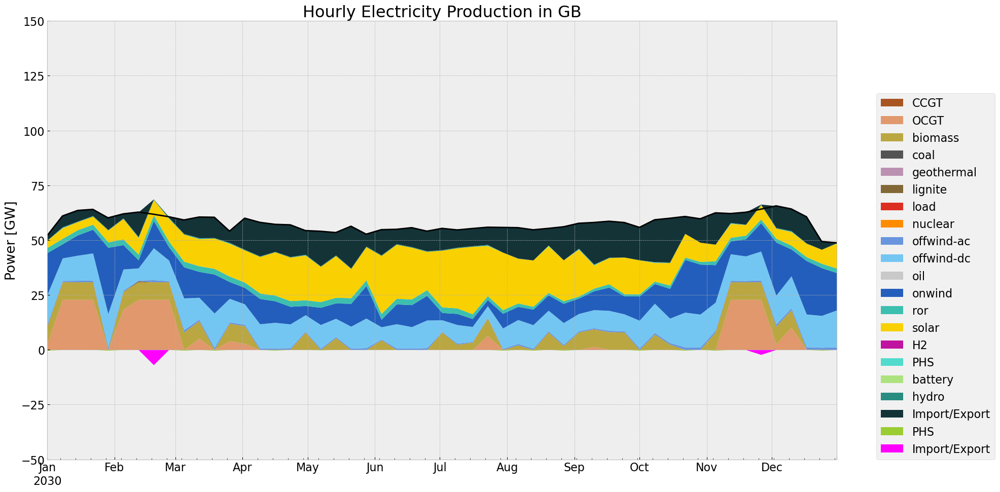

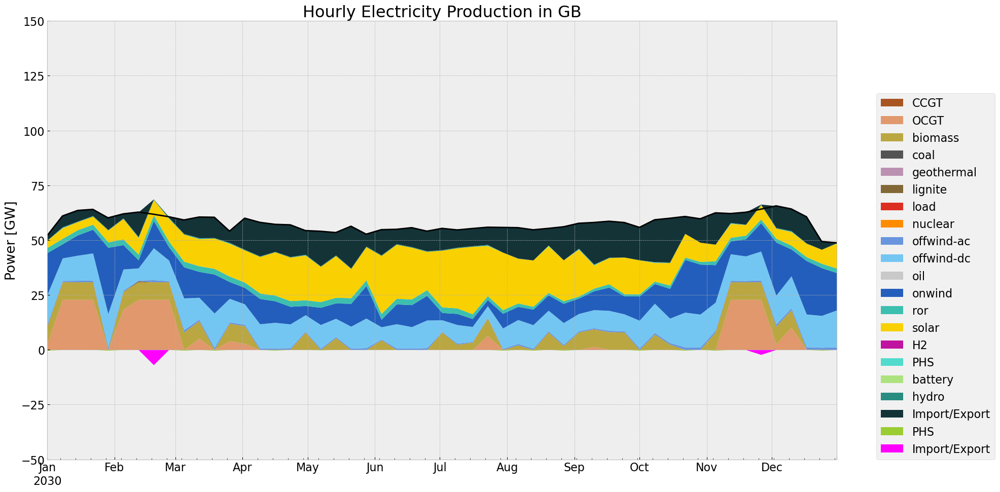

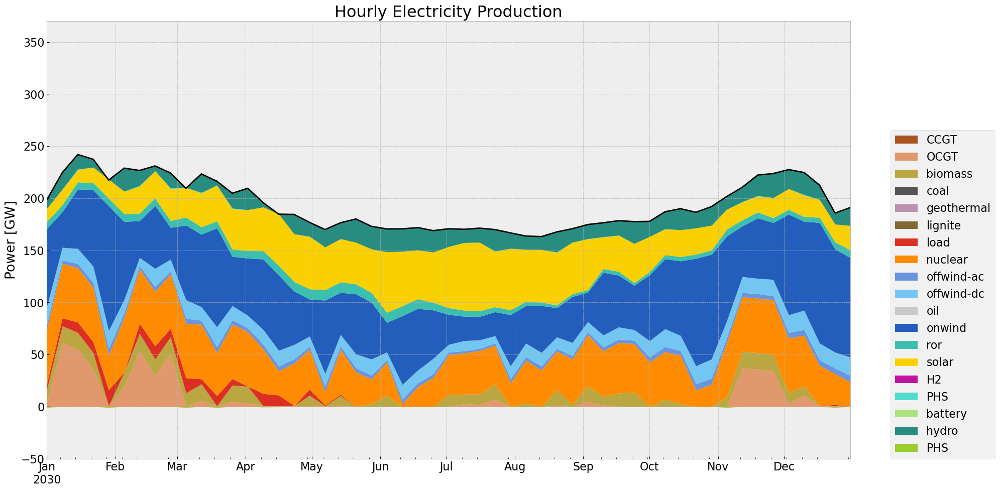

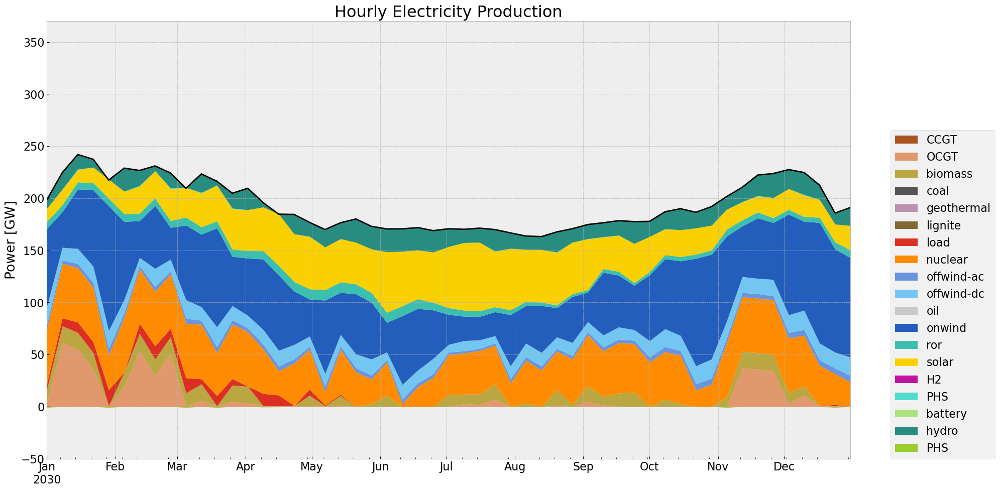

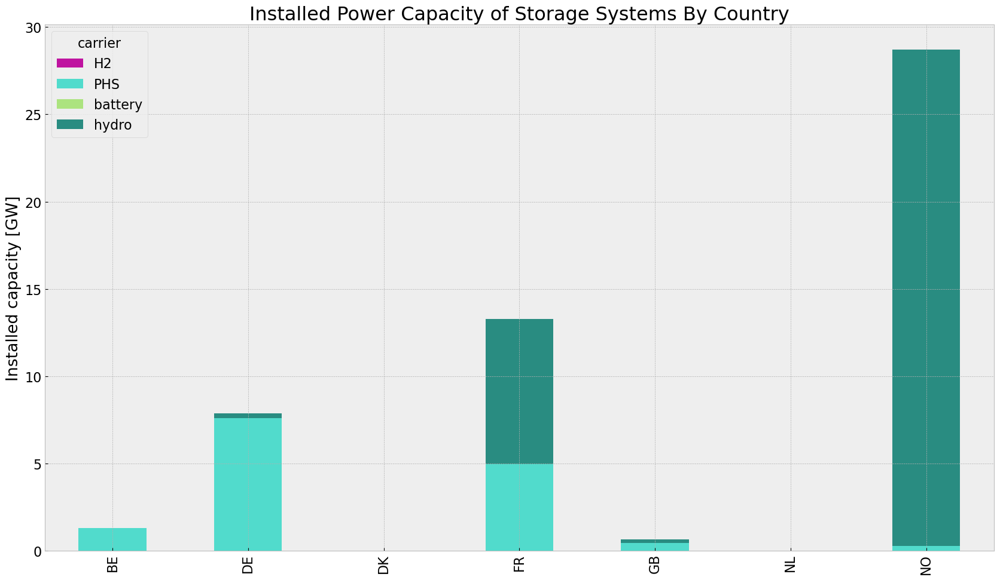

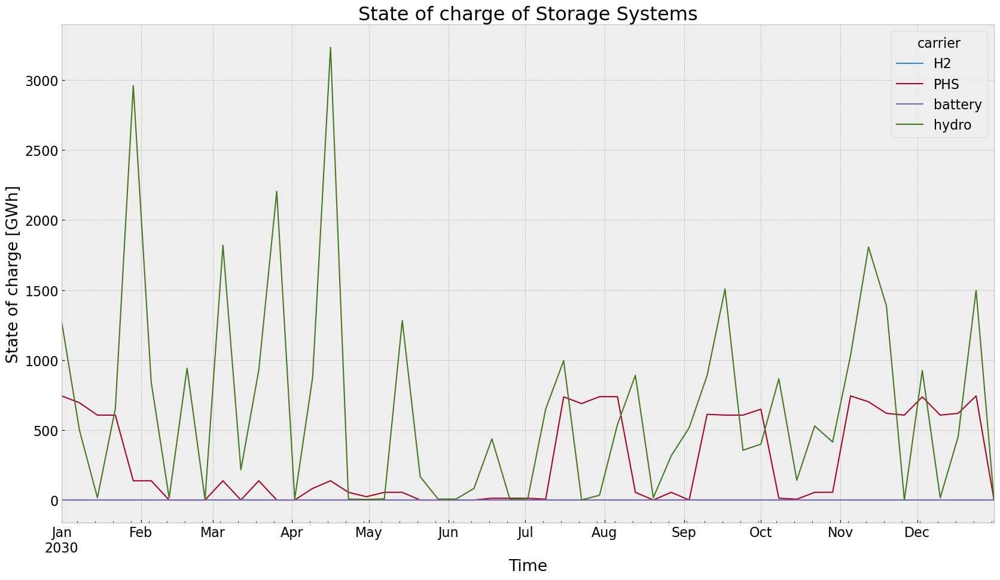

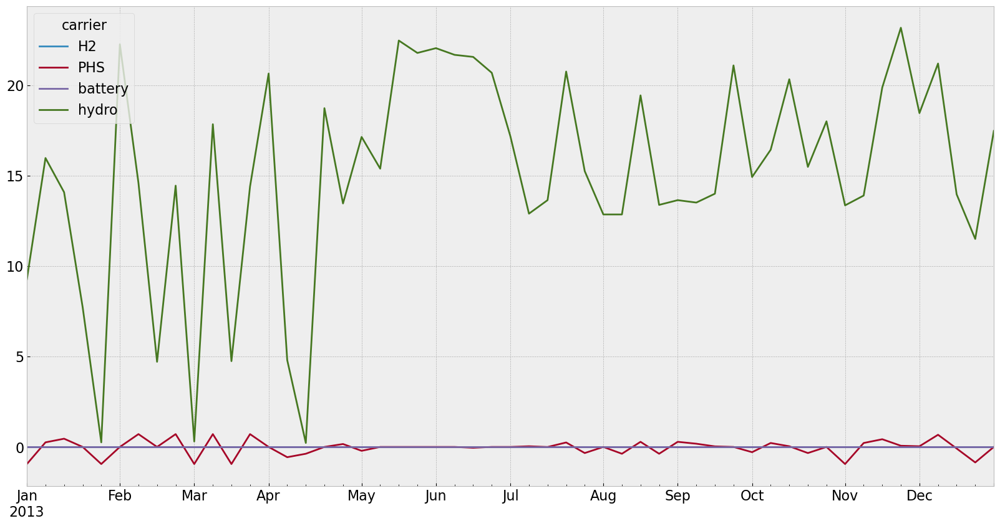

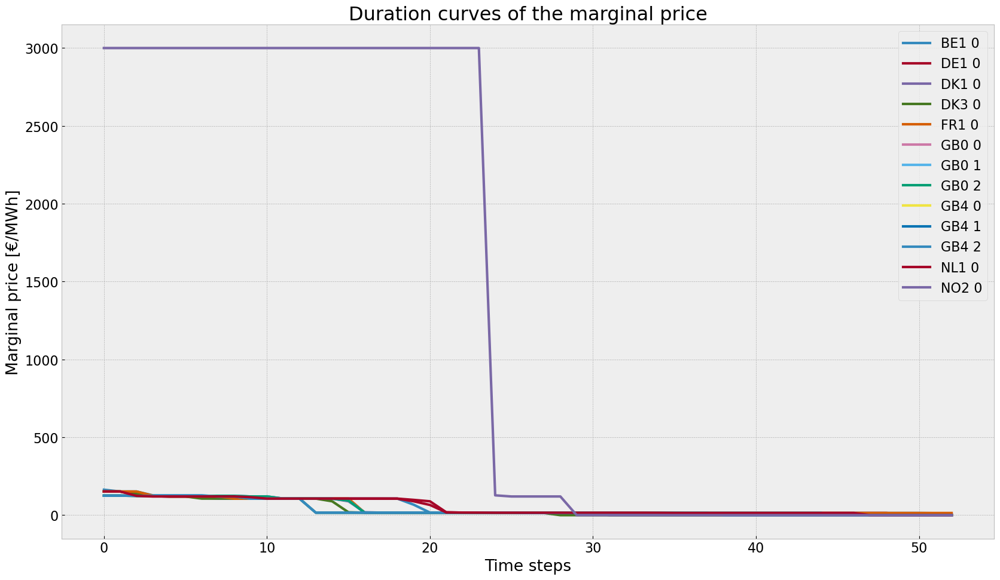

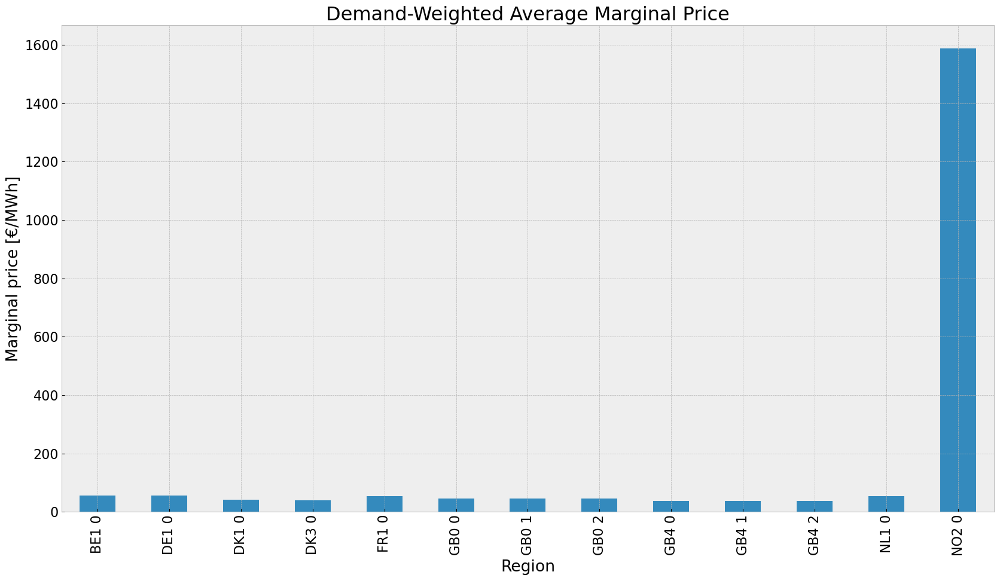

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


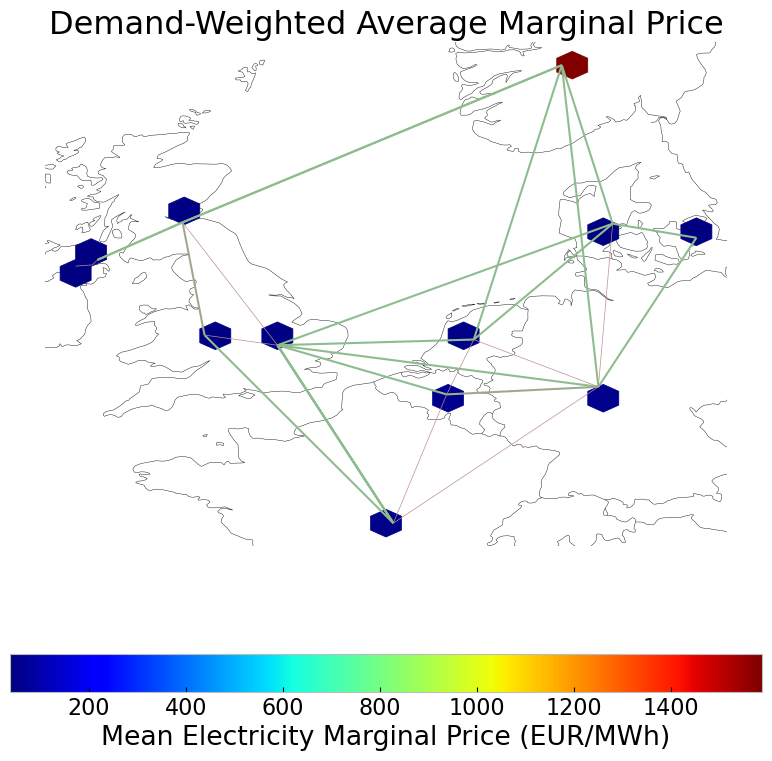

In [145]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

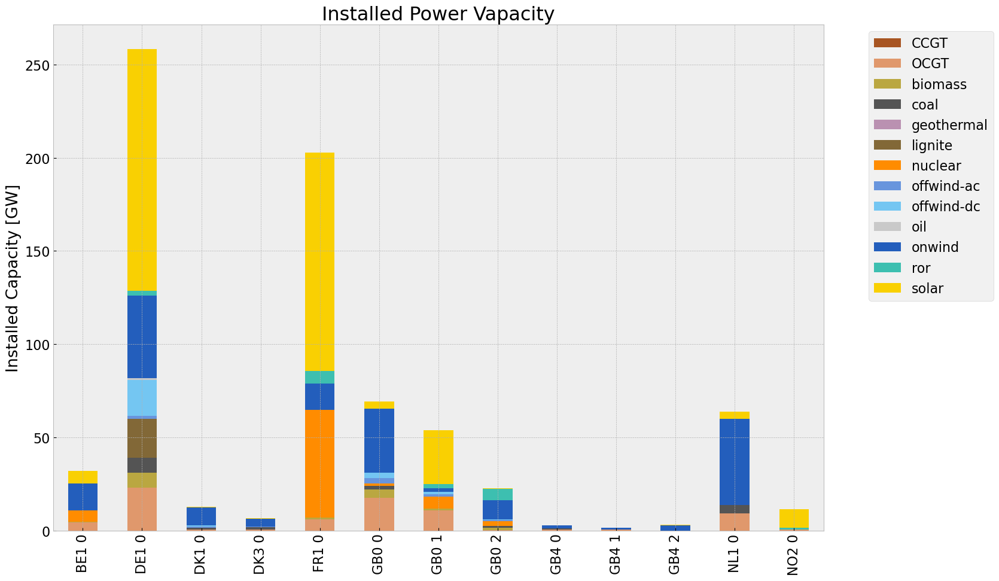

<Figure size 640x480 with 0 Axes>

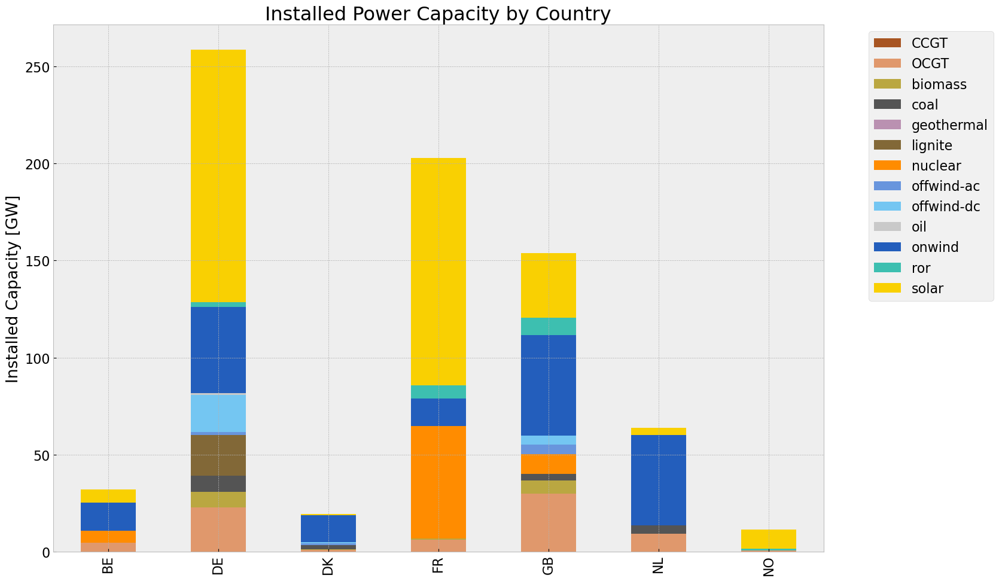

In [146]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

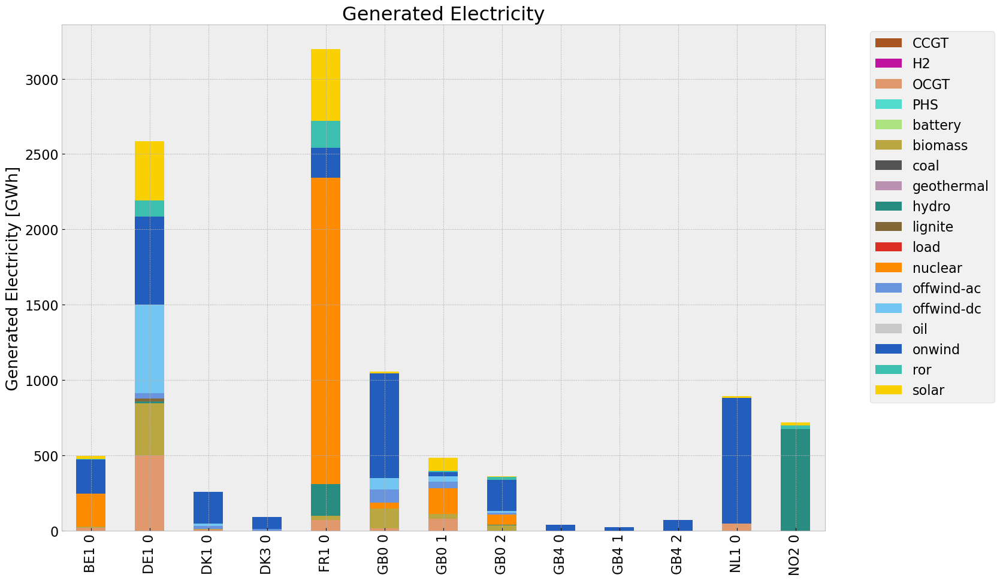

<Figure size 640x480 with 0 Axes>

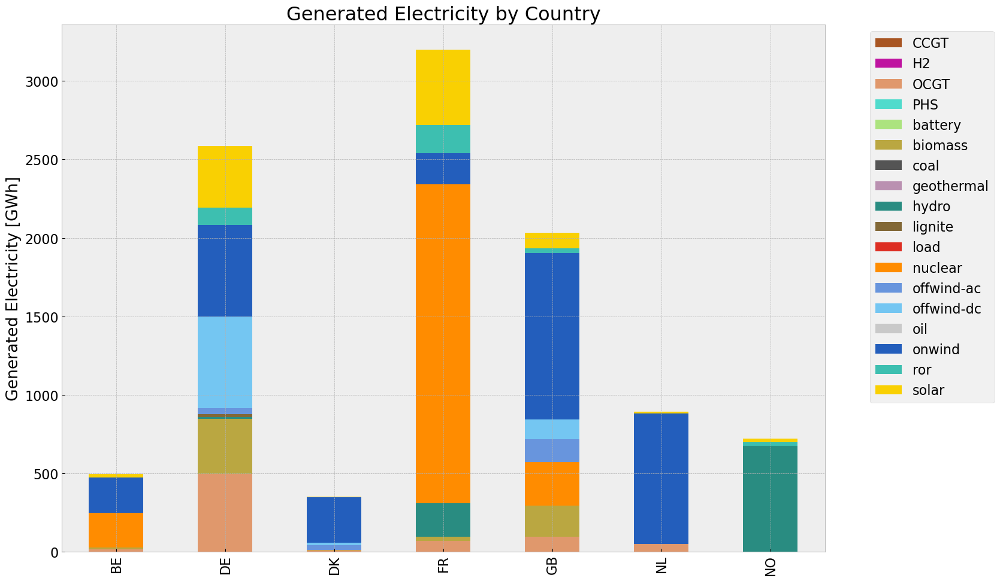

In [147]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

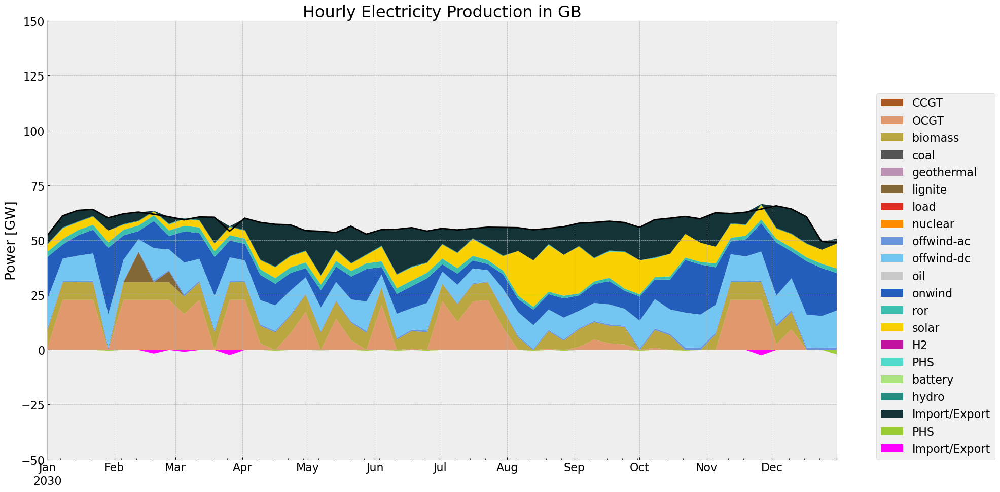

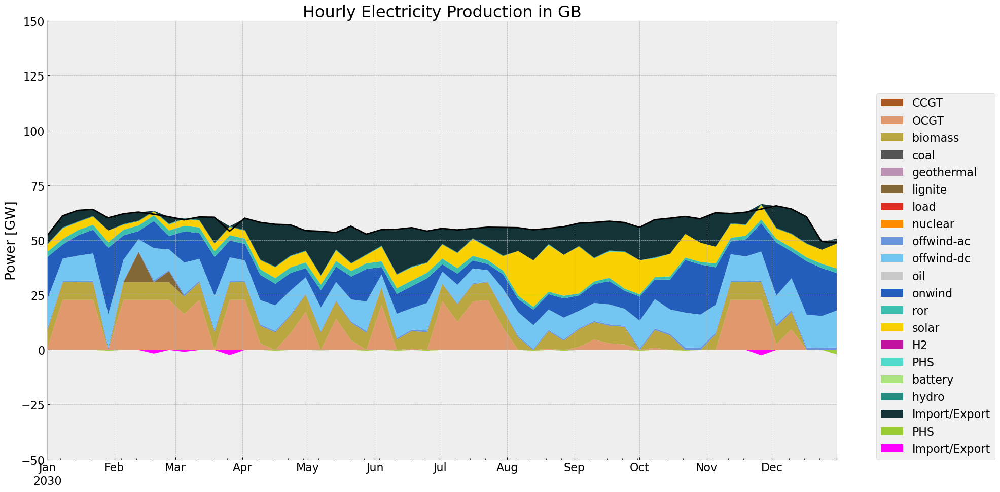

In [148]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

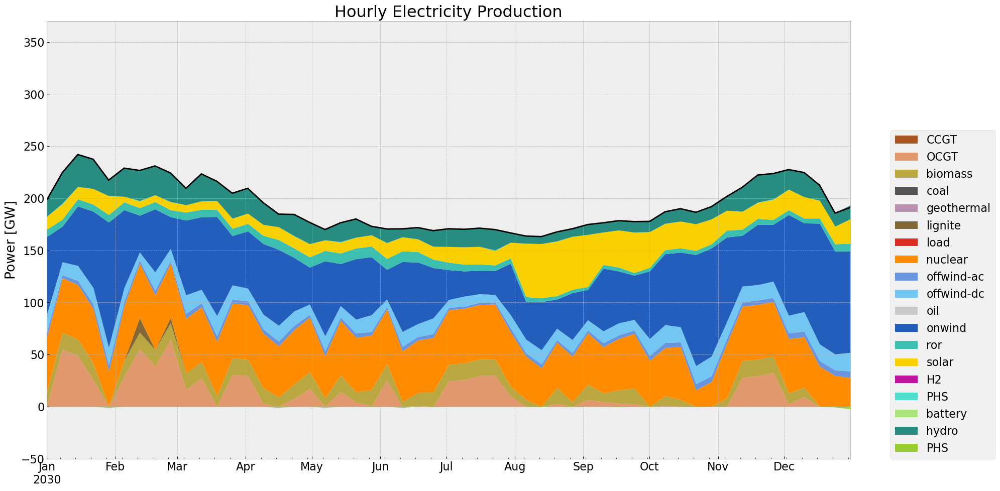

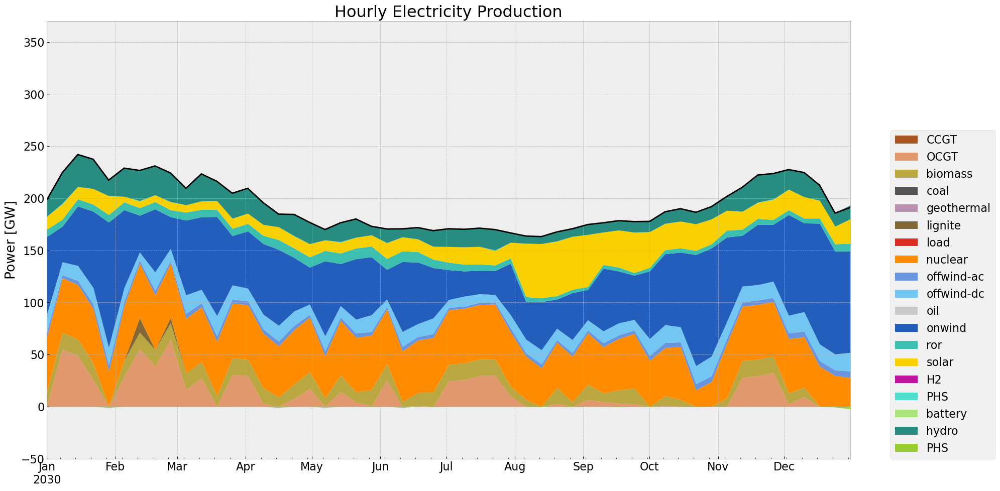

In [149]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

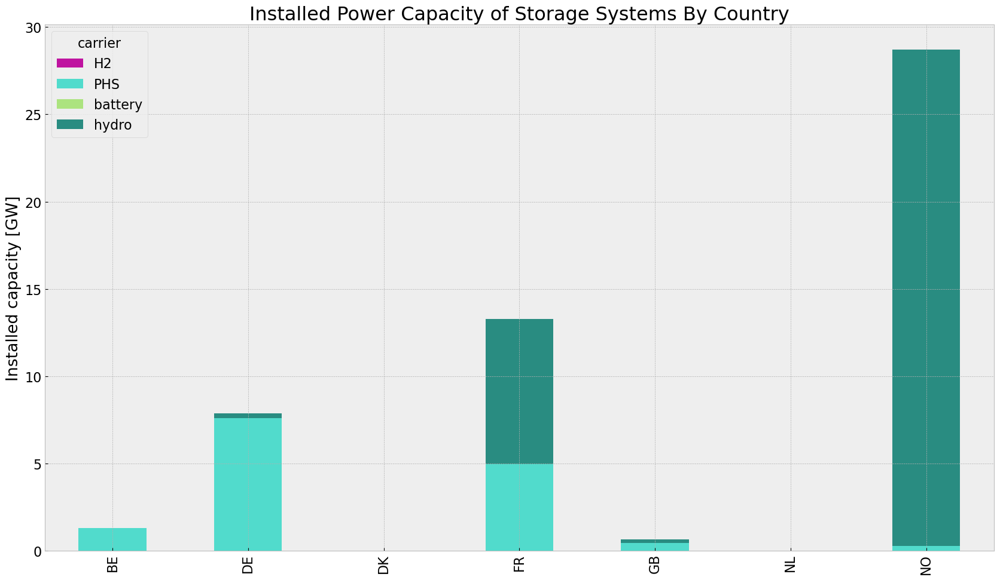

In [150]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carri

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,7.374036e+05,0.431981,0.1980,337991.244827
biomass,5.876006e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329985,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.886123e+04,0.333701,0.4069,22998.534535
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.530726e+06,0.326308,0.0000,0.000000
offwind-ac,2.105532e+05,1.000000,0.0000,0.000000


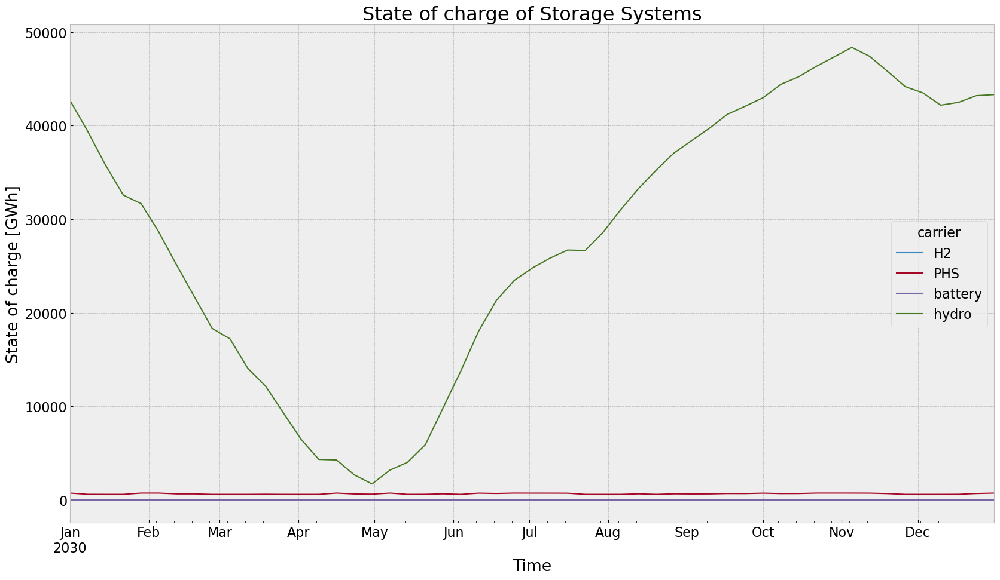

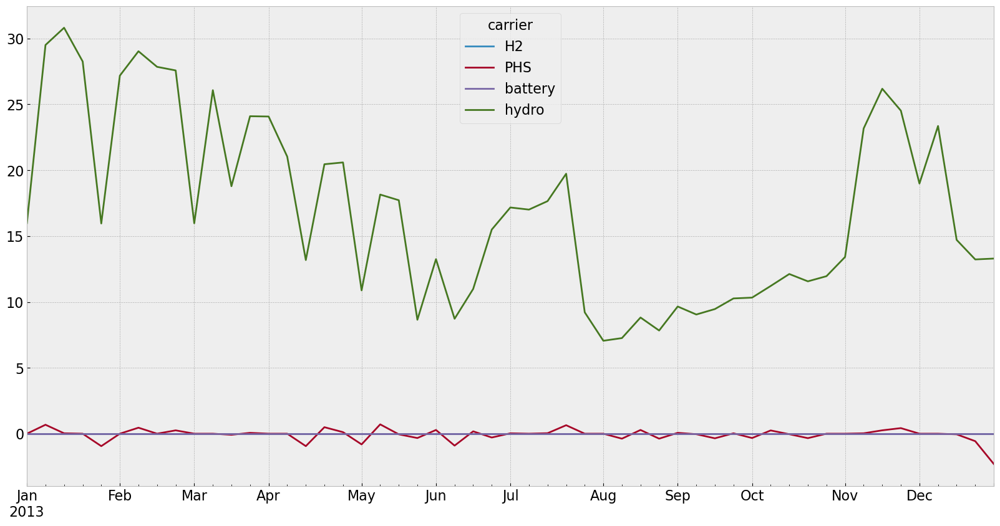

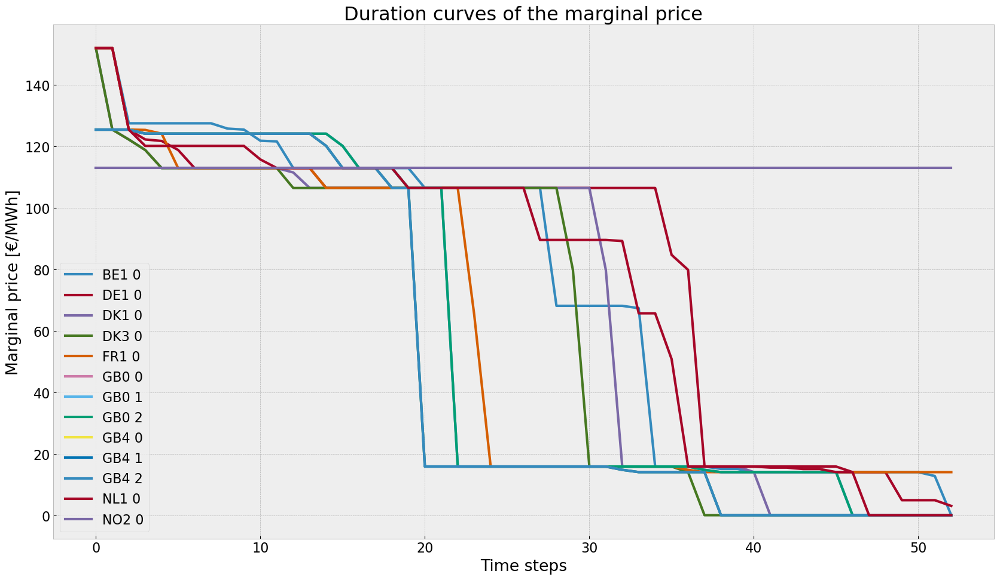

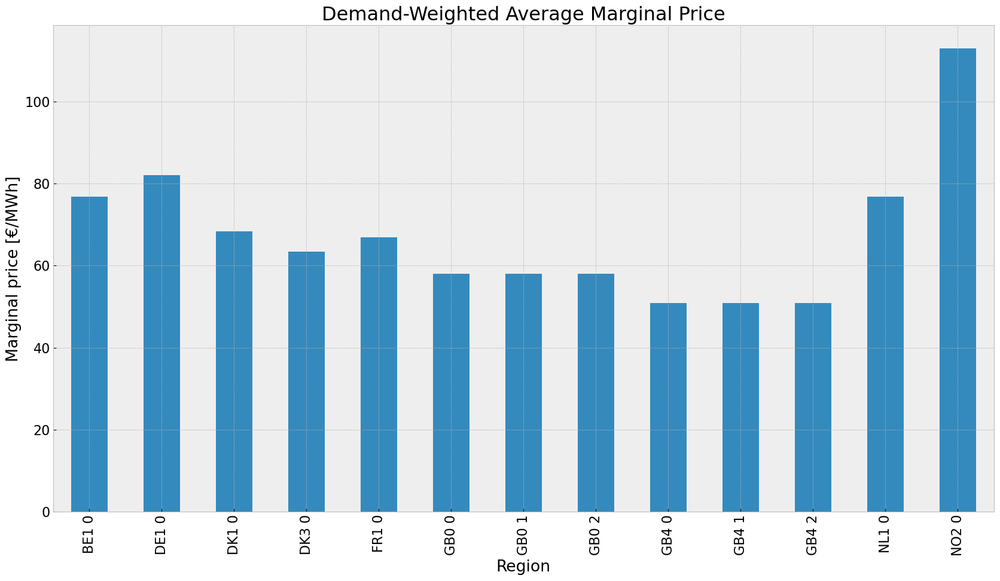

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


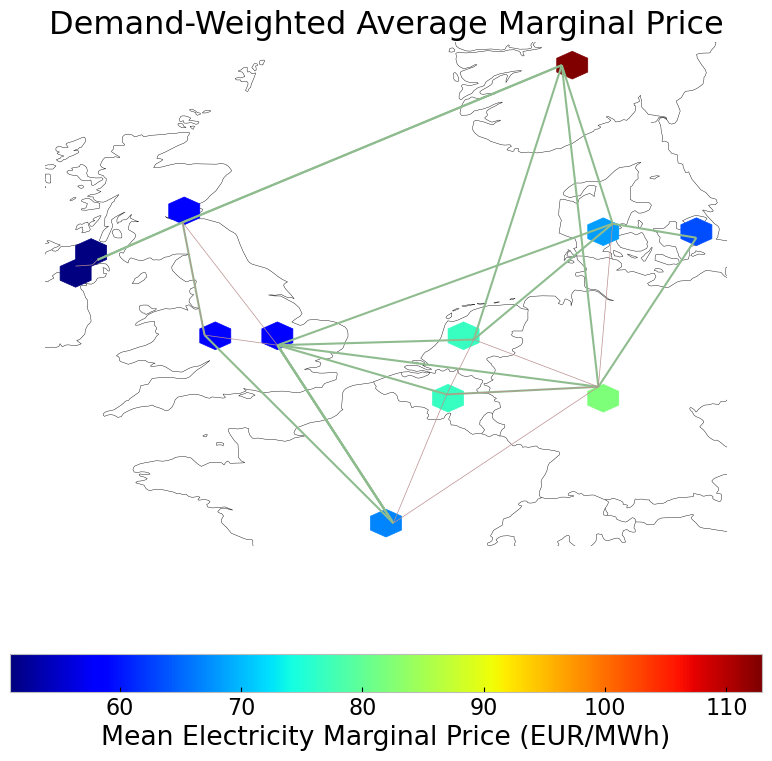

In [151]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [152]:
n3 = pvscenario(n, cut_start, duration, reductionto)

no_inv(n3,n)
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me59hczq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me59hczq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xc5e281eb


INFO:gurobipy:Model fingerprint: 0xc5e281eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2617 rows and 780 columns


INFO:gurobipy:Presolve removed 2617 rows and 780 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 103 rows, 496 columns, 697 nonzeros


INFO:gurobipy:Presolved: 103 rows, 496 columns, 697 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6643482e+09   5.783336e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6643482e+09   5.783336e+05   0.000000e+00      0s


     112    2.0349615e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     112    2.0349615e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 112 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 112 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.034961486e+10


INFO:gurobipy:Optimal objective  2.034961486e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duxnr06o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duxnr06o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0x351cb16e


INFO:gurobipy:Model fingerprint: 0x351cb16e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 2618 rows and 791 columns


INFO:gurobipy:Presolve removed 2618 rows and 791 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 102 rows, 485 columns, 681 nonzeros


INFO:gurobipy:Presolved: 102 rows, 485 columns, 681 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7953375e+09   4.311058e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7953375e+09   4.311058e+05   0.000000e+00      0s


     102    2.3083470e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     102    2.3083470e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 102 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 102 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.308347027e+10


INFO:gurobipy:Optimal objective  2.308347027e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.31e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lek98ebp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lek98ebp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xa61d3cfc


INFO:gurobipy:Model fingerprint: 0xa61d3cfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2618 rows and 791 columns


INFO:gurobipy:Presolve removed 2618 rows and 791 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 102 rows, 485 columns, 681 nonzeros


INFO:gurobipy:Presolved: 102 rows, 485 columns, 681 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3512137e+09   4.172477e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3512137e+09   4.172477e+05   0.000000e+00      0s


     104    2.3312108e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     104    2.3312108e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 104 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 104 iterations and 0.07 seconds (0.00 work units)


Optimal objective  2.331210812e+10


INFO:gurobipy:Optimal objective  2.331210812e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.33e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vubot6dx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vubot6dx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xaf993fa6


INFO:gurobipy:Model fingerprint: 0xaf993fa6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2620 rows and 786 columns


INFO:gurobipy:Presolve removed 2620 rows and 786 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 100 rows, 490 columns, 679 nonzeros


INFO:gurobipy:Presolved: 100 rows, 490 columns, 679 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9689924e+09   2.257428e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9689924e+09   2.257428e+05   0.000000e+00      0s


      95    1.8525097e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      95    1.8525097e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 95 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 95 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.852509733e+10


INFO:gurobipy:Optimal objective  1.852509733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.85e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_u3go5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_u3go5_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0x6fde35f0


INFO:gurobipy:Model fingerprint: 0x6fde35f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2620 rows and 782 columns


INFO:gurobipy:Presolve removed 2620 rows and 782 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 100 rows, 494 columns, 686 nonzeros


INFO:gurobipy:Presolved: 100 rows, 494 columns, 686 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9149277e+09   3.093004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9149277e+09   3.093004e+05   0.000000e+00      0s


     101    8.5574741e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     101    8.5574741e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 101 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 101 iterations and 0.09 seconds (0.00 work units)


Optimal objective  8.557474094e+09


INFO:gurobipy:Optimal objective  8.557474094e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 8.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmciq01f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmciq01f.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xae2da165


INFO:gurobipy:Model fingerprint: 0xae2da165


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2624 rows and 799 columns


INFO:gurobipy:Presolve removed 2624 rows and 799 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 96 rows, 477 columns, 666 nonzeros


INFO:gurobipy:Presolved: 96 rows, 477 columns, 666 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1843035e+05   4.062314e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1843035e+05   4.062314e+05   0.000000e+00      0s


      88    9.8272922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    9.8272922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.05 seconds (0.00 work units)


Optimal objective  9.827292178e+08


INFO:gurobipy:Optimal objective  9.827292178e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 9.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l9rp6mf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l9rp6mf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0x71e4389c


INFO:gurobipy:Model fingerprint: 0x71e4389c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2619 rows and 777 columns


INFO:gurobipy:Presolve removed 2619 rows and 777 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 101 rows, 499 columns, 698 nonzeros


INFO:gurobipy:Presolved: 101 rows, 499 columns, 698 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9100710e+05   4.146161e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9100710e+05   4.146161e+05   0.000000e+00      0s


     100    1.5171746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     100    1.5171746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 100 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 100 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.517174623e+09


INFO:gurobipy:Optimal objective  1.517174623e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdnbn28t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdnbn28t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0x09e139c7


INFO:gurobipy:Model fingerprint: 0x09e139c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 2624 rows and 793 columns


INFO:gurobipy:Presolve removed 2624 rows and 793 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 96 rows, 483 columns, 666 nonzeros


INFO:gurobipy:Presolved: 96 rows, 483 columns, 666 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1725137e+07   8.910979e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.1725137e+07   8.910979e+04   0.000000e+00      0s


      92    1.9628520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.9628520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.962852006e+09


INFO:gurobipy:Optimal objective  1.962852006e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-316nq0i0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-316nq0i0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xaed017a5


INFO:gurobipy:Model fingerprint: 0xaed017a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2624 rows and 806 columns


INFO:gurobipy:Presolve removed 2624 rows and 806 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 96 rows, 470 columns, 653 nonzeros


INFO:gurobipy:Presolved: 96 rows, 470 columns, 653 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0290768e+05   9.305370e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0290768e+05   9.305370e+04   0.000000e+00      0s


     114    5.9443946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    5.9443946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.944394629e+08


INFO:gurobipy:Optimal objective  5.944394629e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 5.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-haj5e2v4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-haj5e2v4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xf8ddcefd


INFO:gurobipy:Model fingerprint: 0xf8ddcefd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2624 rows and 804 columns


INFO:gurobipy:Presolve removed 2624 rows and 804 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 96 rows, 472 columns, 655 nonzeros


INFO:gurobipy:Presolved: 96 rows, 472 columns, 655 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8936320e+05   9.063604e+04   0.000000e+00      0s


INFO:gurobipy:       0    4.8936320e+05   9.063604e+04   0.000000e+00      0s


     108    5.5499443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     108    5.5499443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 108 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 108 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.549944341e+08


INFO:gurobipy:Optimal objective  5.549944341e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 5.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qo2pbxu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qo2pbxu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0x237a8644


INFO:gurobipy:Model fingerprint: 0x237a8644


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 2618 rows and 793 columns


INFO:gurobipy:Presolve removed 2618 rows and 793 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 102 rows, 483 columns, 687 nonzeros


INFO:gurobipy:Presolved: 102 rows, 483 columns, 687 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4604439e+05   6.148836e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4604439e+05   6.148836e+05   0.000000e+00      0s


     108    3.3326780e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     108    3.3326780e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 108 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 108 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.332677999e+08


INFO:gurobipy:Optimal objective  3.332677999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6pyi55g8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6pyi55g8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xcf16e2d9


INFO:gurobipy:Model fingerprint: 0xcf16e2d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2616 rows and 769 columns


INFO:gurobipy:Presolve removed 2616 rows and 769 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 104 rows, 507 columns, 713 nonzeros


INFO:gurobipy:Presolved: 104 rows, 507 columns, 713 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1749528e+05   6.487592e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1749528e+05   6.487592e+05   0.000000e+00      0s


     125    2.6288765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     125    2.6288765e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 125 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 125 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.628876488e+09


INFO:gurobipy:Optimal objective  2.628876488e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 2.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2a3tjl07.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2a3tjl07.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2720 rows, 1276 columns, 4328 nonzeros


INFO:gurobipy:obj: 2720 rows, 1276 columns, 4328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


INFO:gurobipy:Optimize a model with 2720 rows, 1276 columns and 4328 nonzeros


Model fingerprint: 0xcbcdac42


INFO:gurobipy:Model fingerprint: 0xcbcdac42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 2617 rows and 810 columns


INFO:gurobipy:Presolve removed 2617 rows and 810 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 103 rows, 466 columns, 667 nonzeros


INFO:gurobipy:Presolved: 103 rows, 466 columns, 667 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1412567e+08   4.954447e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1412567e+08   4.954447e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


     126    1.7284041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    1.7284041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.728404127e+09


INFO:gurobipy:Optimal objective  1.728404127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1276 primals, 2720 duals
Objective: 1.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.11s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qwfb4gxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qwfb4gxi.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 680 rows, 319 columns, 1055 nonzeros


INFO:gurobipy:obj: 680 rows, 319 columns, 1055 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 680 rows, 319 columns and 1055 nonzeros


INFO:gurobipy:Optimize a model with 680 rows, 319 columns and 1055 nonzeros


Model fingerprint: 0x019bc0b5


INFO:gurobipy:Model fingerprint: 0x019bc0b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 659 rows and 212 columns


INFO:gurobipy:Presolve removed 659 rows and 212 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 21 rows, 107 columns, 146 nonzeros


INFO:gurobipy:Presolved: 21 rows, 107 columns, 146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8127353e+04   3.052253e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.8127353e+04   3.052253e+04   0.000000e+00      0s


      21    8.4443001e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      21    8.4443001e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 21 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 21 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.444300093e+06


INFO:gurobipy:Optimal objective  8.444300093e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 319 primals, 680 duals
Objective: 8.44e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [153]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 162kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      loads_i: 13,
                                                      loads_t_p_set_i: 13,
                                                      loads_t_p_i: 13,
                                                      links_i: 21,
                                                      ...
                                                      generators_t_p_max_pu_i: 57,
                                                      generators_t_p_i: 67,
                                                      lines_i: 11,
                                                      lines_t_p0_i: 11,
                                                      lines_t_p1_i: 11,
                                                      lines_t_loss_i: 11)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * loads_i                                          (loads_i) object 104B 'B...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 104B ...
  * loads_t_p_i                                      (loads_t_p_i) object 104B ...
  * links_i                                          (links_i) object 168B '1...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                                 (generators_t_p_i) object 536B ...
  * lines_i                                          (lines_i) object 88B '0'...
  * lines_t_p0_i                                     (lines_t_p0_i) object 88B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 88B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 88B ...
Data variables: (12/98)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_x_pu_eff                                   (lines_i) float64 88B 0....
    lines_r_pu_eff                                   (lines_i) float64 88B 4....
    lines_s_nom_opt                                  (lines_i) float64 88B 2....
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       8444300.092806723
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [154]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

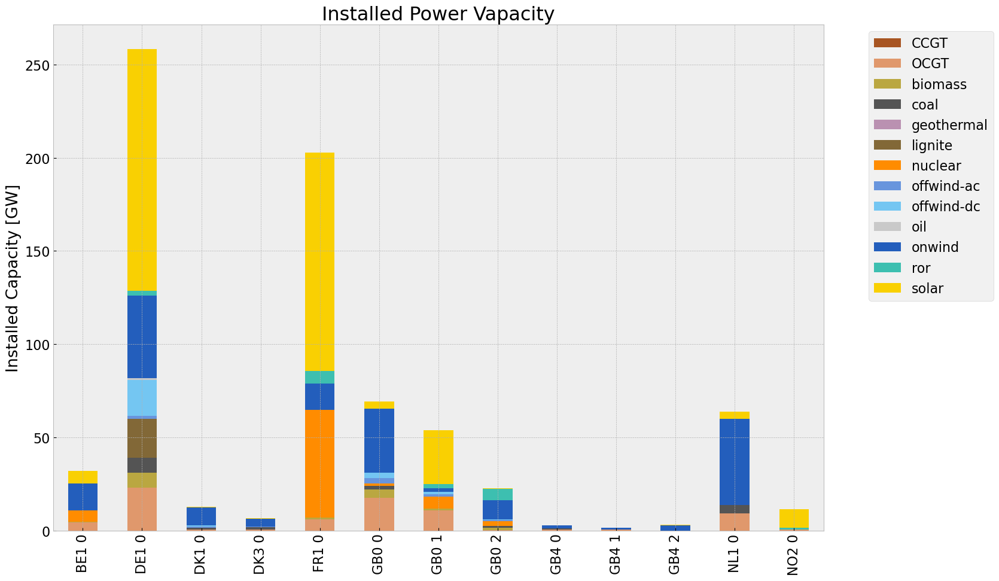

<Figure size 640x480 with 0 Axes>

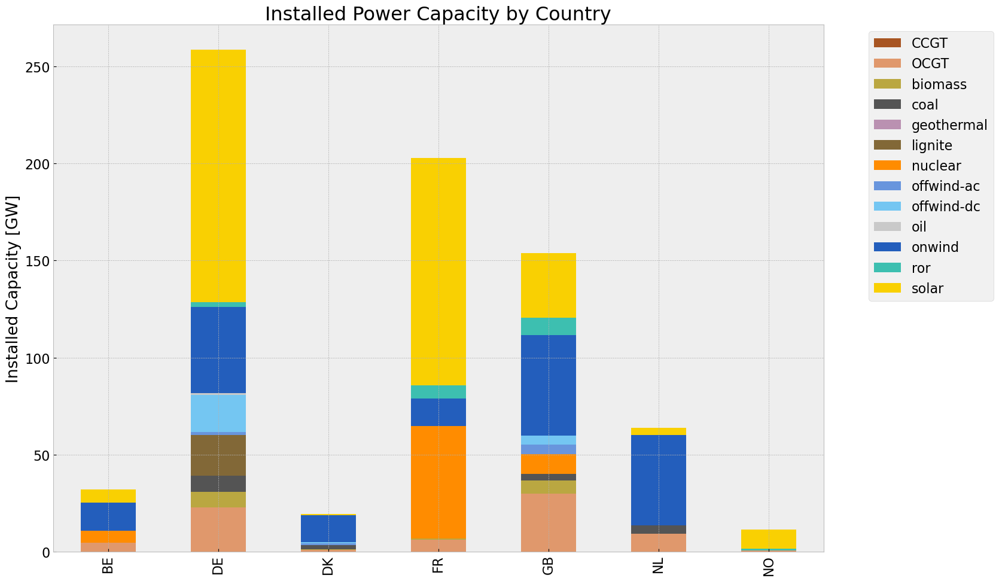

<Figure size 640x480 with 0 Axes>

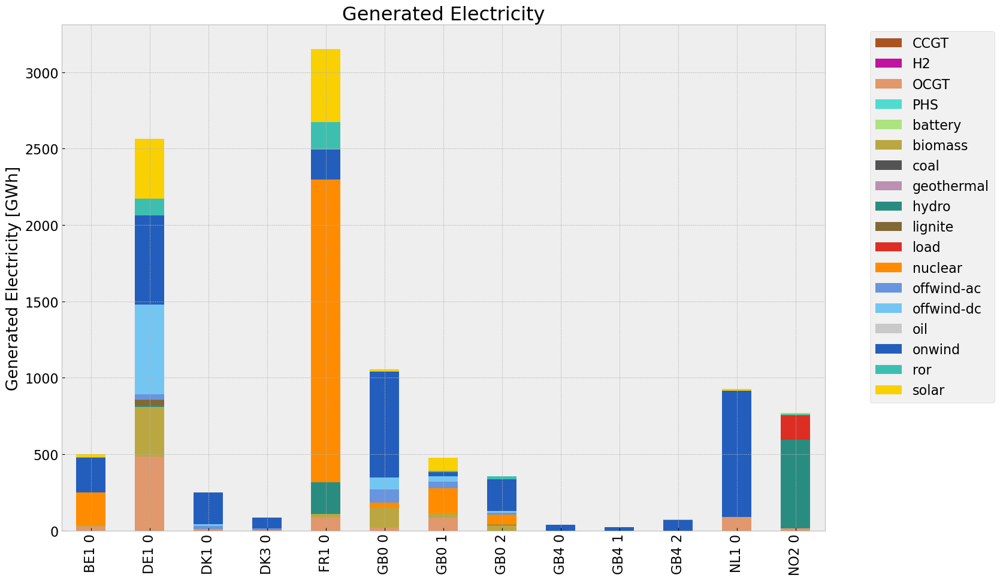

<Figure size 640x480 with 0 Axes>

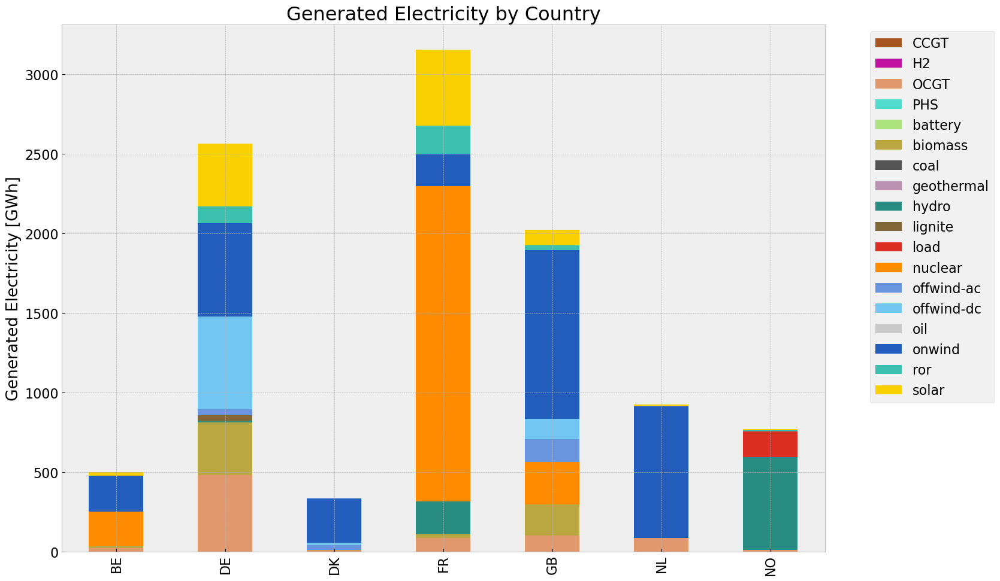

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,8.053910e+05,0.431981,0.1980,369153.498289
biomass,5.570721e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329985,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.403589e+04,0.333701,0.4069,41501.831787
load,1.604329e+05,1.000000,0.0000,0.000000
nuclear,2.464693e+06,0.326308,0.0000,0.000000
offwind-ac,2.104834e+05,1.000000,0.0000,0.000000


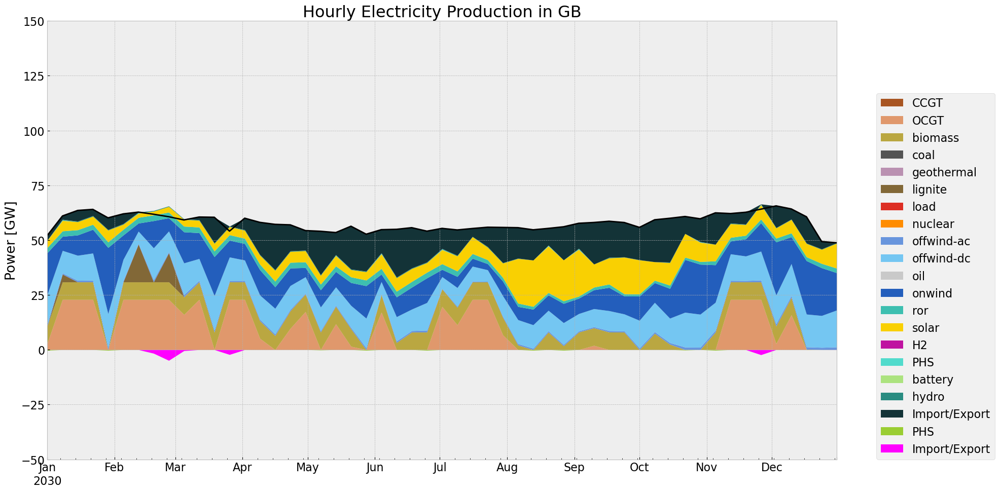

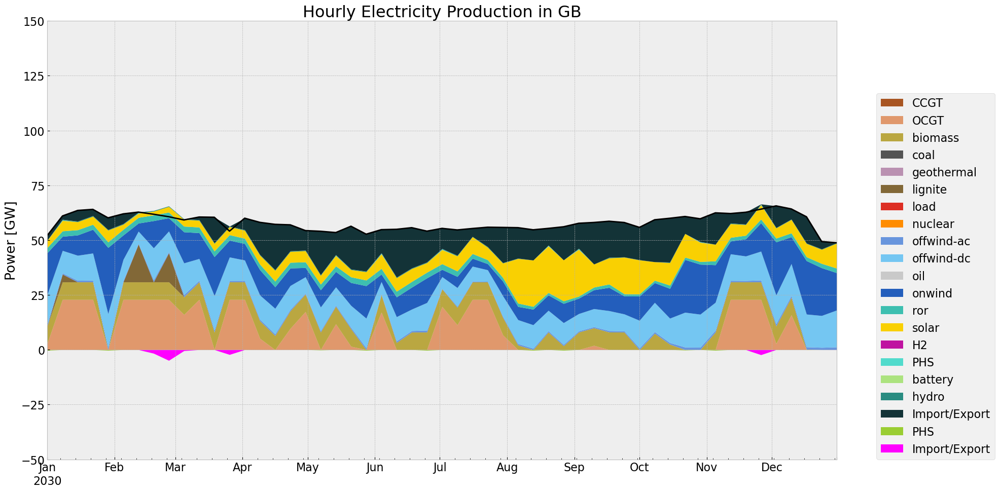

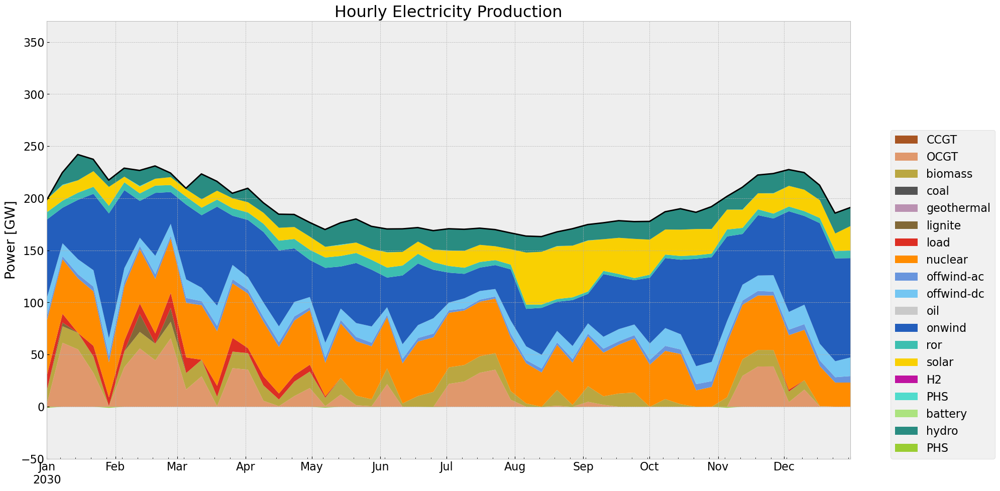

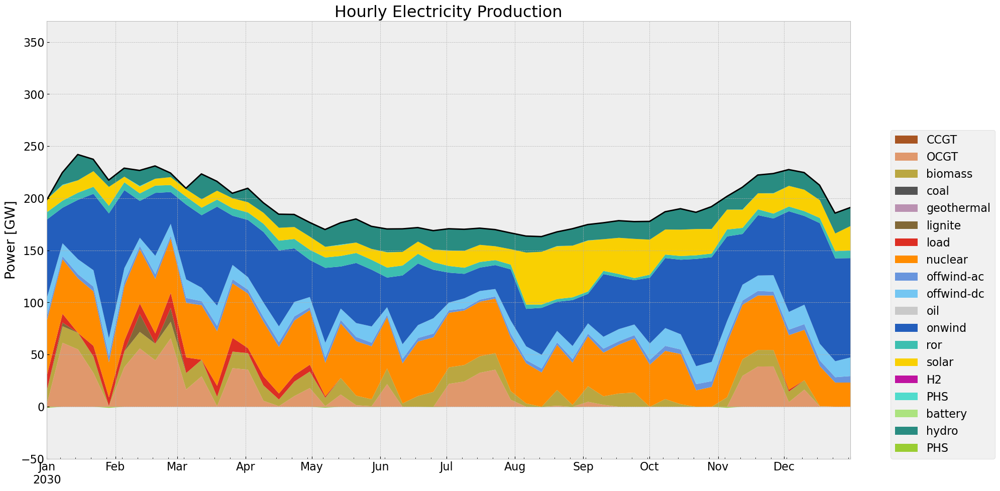

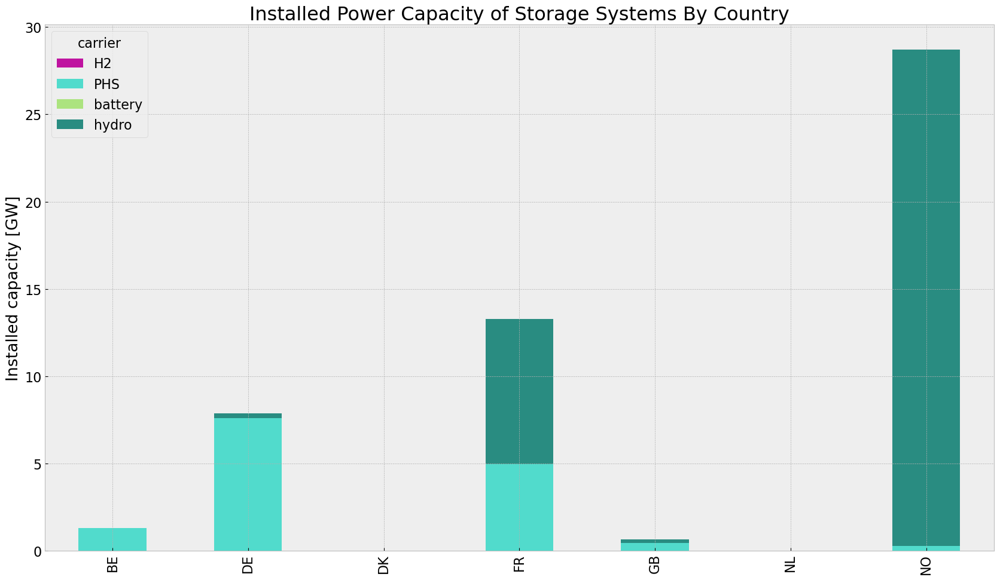

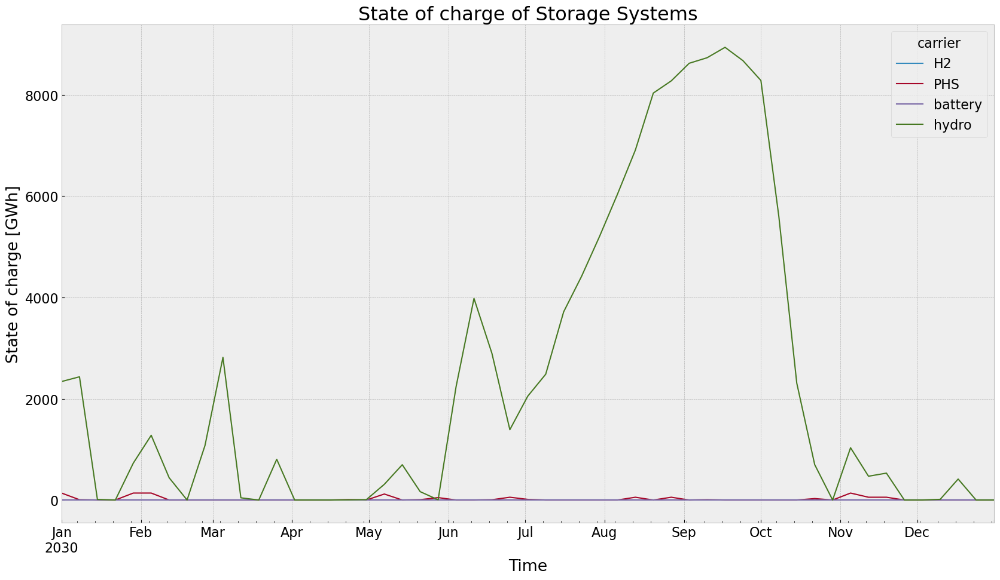

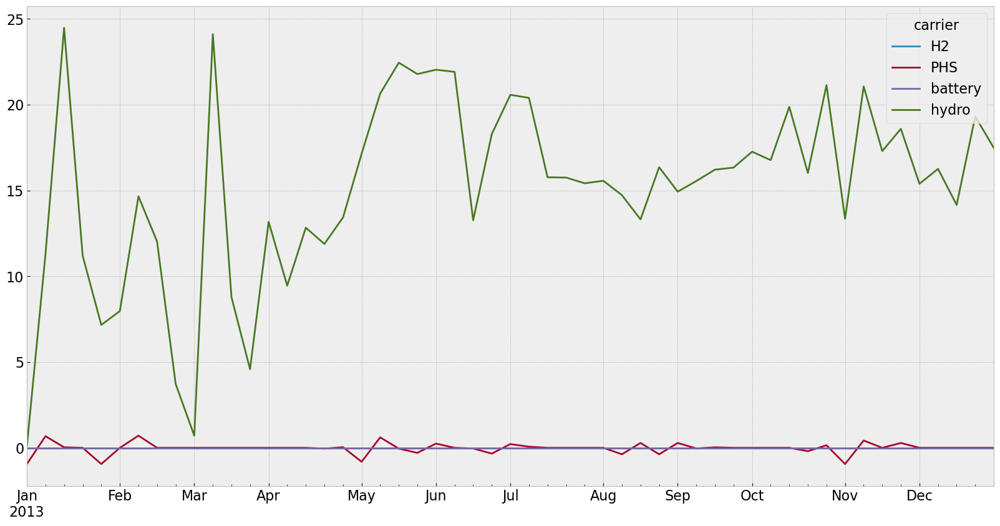

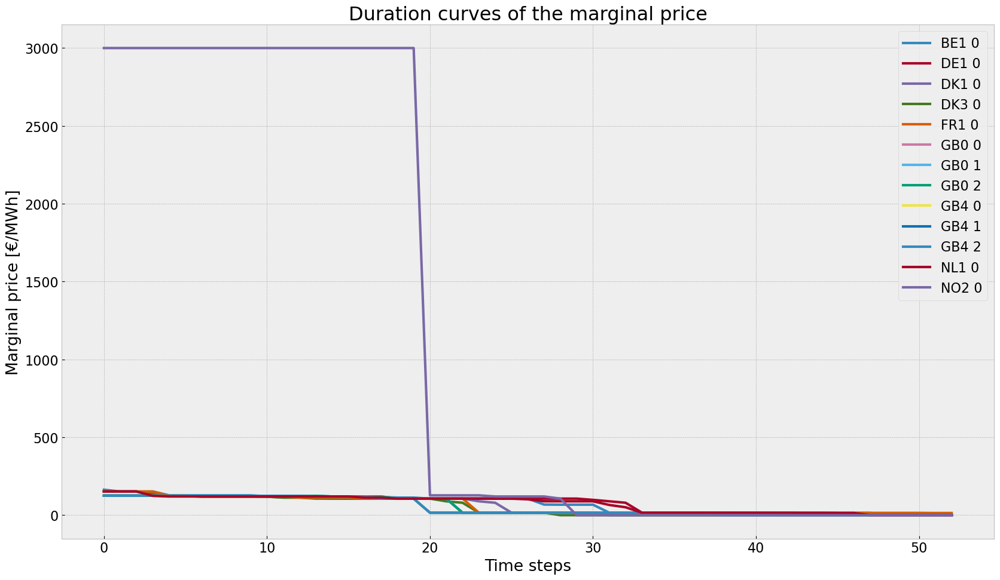

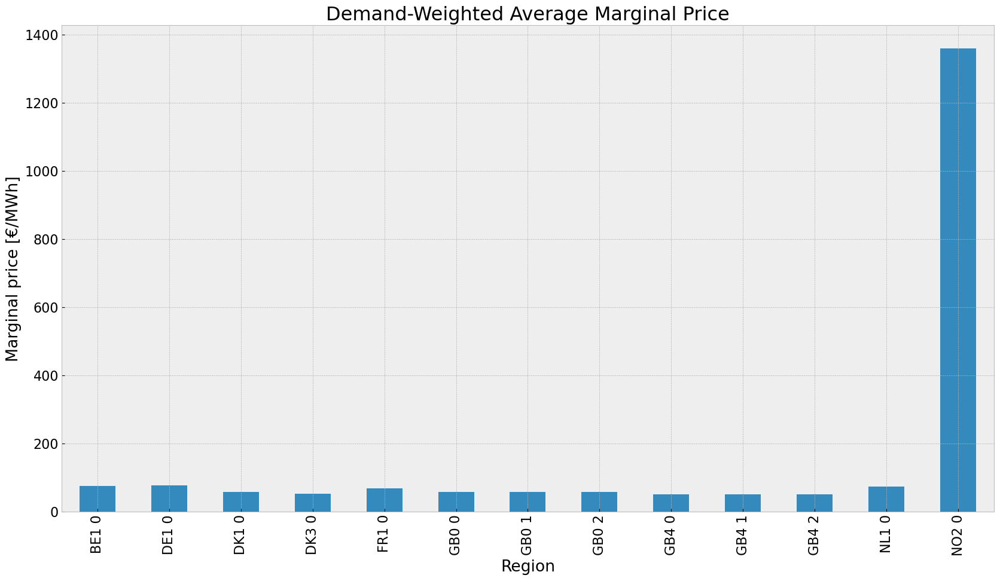

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


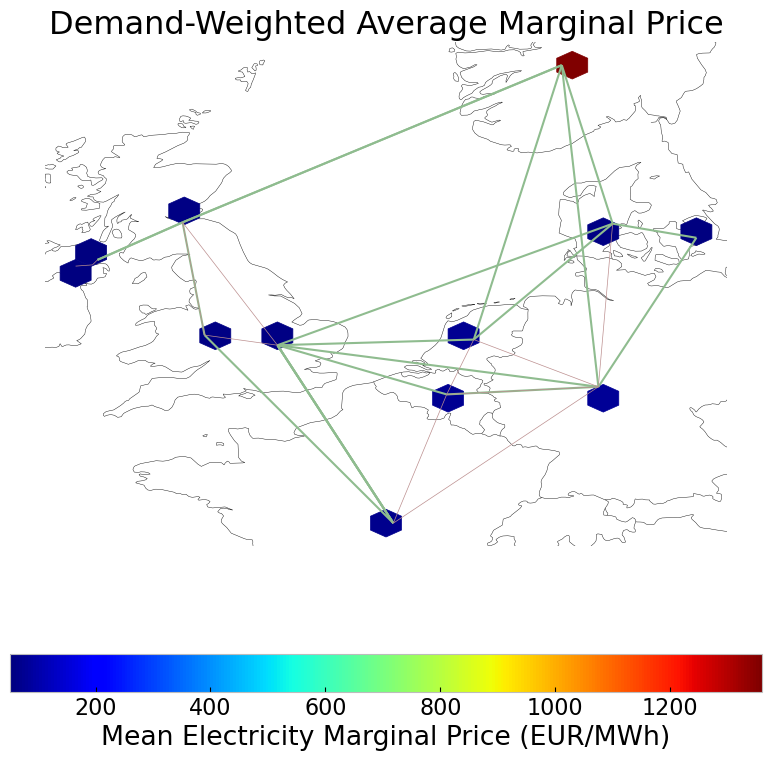

In [155]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [156]:
n4 = n1.copy()

horizon = 3

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjlbqjyq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjlbqjyq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7a0787ca


INFO:gurobipy:Model fingerprint: 0x7a0787ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 565 columns


INFO:gurobipy:Presolve removed 1962 rows and 565 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 78 rows, 392 columns, 556 nonzeros


INFO:gurobipy:Presolved: 78 rows, 392 columns, 556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6433867e+04   2.874254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6433867e+04   2.874254e+05   0.000000e+00      0s


      83    2.7668516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    2.7668516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.766851553e+09


INFO:gurobipy:Optimal objective  2.766851553e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b3lujhzu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b3lujhzu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x914a19d5


INFO:gurobipy:Model fingerprint: 0x914a19d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 1962 rows and 571 columns


INFO:gurobipy:Presolve removed 1962 rows and 571 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 386 columns, 550 nonzeros


INFO:gurobipy:Presolved: 78 rows, 386 columns, 550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6646696e+04   3.005852e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6646696e+04   3.005852e+05   0.000000e+00      0s


      89    1.2202034e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    1.2202034e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.220203351e+09


INFO:gurobipy:Optimal objective  1.220203351e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94309t1k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94309t1k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9a736f59


INFO:gurobipy:Model fingerprint: 0x9a736f59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1358416e+07   2.731253e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1358416e+07   2.731253e+05   0.000000e+00      0s


      87    4.6485174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    4.6485174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.648517443e+09


INFO:gurobipy:Optimal objective  4.648517443e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxpblt_8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxpblt_8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2cea7a85


INFO:gurobipy:Model fingerprint: 0x2cea7a85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.7064032e+04   2.710620e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.7064032e+04   2.710620e+05   0.000000e+00      0s


      98    1.1732149e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      98    1.1732149e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 98 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 98 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.173214942e+09


INFO:gurobipy:Optimal objective  1.173214942e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkstnhw7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkstnhw7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x3518cb81


INFO:gurobipy:Model fingerprint: 0x3518cb81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 554 columns


INFO:gurobipy:Presolve removed 1962 rows and 554 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 403 columns, 567 nonzeros


INFO:gurobipy:Presolved: 78 rows, 403 columns, 567 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1450512e+04   2.203222e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1450512e+04   2.203222e+05   0.000000e+00      0s


      75    1.6538422e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.6538422e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.653842212e+09


INFO:gurobipy:Optimal objective  1.653842212e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w00z8cyw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w00z8cyw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd28de23c


INFO:gurobipy:Model fingerprint: 0xd28de23c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1966 rows and 561 columns


INFO:gurobipy:Presolve removed 1966 rows and 561 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 74 rows, 396 columns, 553 nonzeros


INFO:gurobipy:Presolved: 74 rows, 396 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.4024961e+04   1.822396e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.4024961e+04   1.822396e+05   0.000000e+00      0s


      80    6.8172790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    6.8172790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.817279015e+08


INFO:gurobipy:Optimal objective  6.817279015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qkcezml.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qkcezml.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xacb7a677


INFO:gurobipy:Model fingerprint: 0xacb7a677


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 562 columns


INFO:gurobipy:Presolve removed 1965 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 395 columns, 554 nonzeros


INFO:gurobipy:Presolved: 75 rows, 395 columns, 554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2313138e+04   1.400127e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2313138e+04   1.400127e+05   0.000000e+00      0s


      75    3.2396150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    3.2396150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.239614967e+08


INFO:gurobipy:Optimal objective  3.239614967e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8y46ihio.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8y46ihio.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xdbc093f8


INFO:gurobipy:Model fingerprint: 0xdbc093f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1968 rows and 564 columns


INFO:gurobipy:Presolve removed 1968 rows and 564 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 72 rows, 393 columns, 547 nonzeros


INFO:gurobipy:Presolved: 72 rows, 393 columns, 547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.8929403e+04   1.201341e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.8929403e+04   1.201341e+05   0.000000e+00      0s


      68    3.0326691e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      68    3.0326691e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 68 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 68 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.032669121e+08


INFO:gurobipy:Optimal objective  3.032669121e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9crlu9nh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9crlu9nh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9834071b


INFO:gurobipy:Model fingerprint: 0x9834071b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 556 columns


INFO:gurobipy:Presolve removed 1965 rows and 556 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 75 rows, 401 columns, 560 nonzeros


INFO:gurobipy:Presolved: 75 rows, 401 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.0462961e+04   1.160310e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.0462961e+04   1.160310e+05   0.000000e+00      0s


      85    4.4882821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    4.4882821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.488282120e+08


INFO:gurobipy:Optimal objective  4.488282120e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jua5jd1_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jua5jd1_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa7e1bdaf


INFO:gurobipy:Model fingerprint: 0xa7e1bdaf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 553 columns


INFO:gurobipy:Presolve removed 1962 rows and 553 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6774043e+04   1.040663e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6774043e+04   1.040663e+05   0.000000e+00      0s


      85    1.6145069e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.6145069e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.614506890e+09


INFO:gurobipy:Optimal objective  1.614506890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-neyz36rz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-neyz36rz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x615ab63a


INFO:gurobipy:Model fingerprint: 0x615ab63a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 558 columns


INFO:gurobipy:Presolve removed 1962 rows and 558 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7082272e+05   1.111457e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7082272e+05   1.111457e+05   0.000000e+00      0s


      89    2.1390348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    2.1390348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.139034763e+08


INFO:gurobipy:Optimal objective  2.139034763e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3si2nlvw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3si2nlvw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x89ecc32c


INFO:gurobipy:Model fingerprint: 0x89ecc32c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 552 columns


INFO:gurobipy:Presolve removed 1962 rows and 552 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 405 columns, 569 nonzeros


INFO:gurobipy:Presolved: 78 rows, 405 columns, 569 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2238051e+05   1.287898e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2238051e+05   1.287898e+05   0.000000e+00      0s


      90    3.1957463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    3.1957463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.195746349e+08


INFO:gurobipy:Optimal objective  3.195746349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8n9i75j1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8n9i75j1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd5f36d5e


INFO:gurobipy:Model fingerprint: 0xd5f36d5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 545 columns


INFO:gurobipy:Presolve removed 1962 rows and 545 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 412 columns, 576 nonzeros


INFO:gurobipy:Presolved: 78 rows, 412 columns, 576 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.8953610e+04   1.479927e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.8953610e+04   1.479927e+05   0.000000e+00      0s


      92    3.3499741e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    3.3499741e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.349974054e+08


INFO:gurobipy:Optimal objective  3.349974054e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r9yrklp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r9yrklp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa79753d7


INFO:gurobipy:Model fingerprint: 0xa79753d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 553 columns


INFO:gurobipy:Presolve removed 1962 rows and 553 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.9389075e+04   1.756796e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.9389075e+04   1.756796e+05   0.000000e+00      0s


      90    2.1797878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    2.1797878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.179787798e+08


INFO:gurobipy:Optimal objective  2.179787798e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ke56n9ue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ke56n9ue.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x588221db


INFO:gurobipy:Model fingerprint: 0x588221db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 573 columns


INFO:gurobipy:Presolve removed 1962 rows and 573 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9995945e+04   1.940177e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9995945e+04   1.940177e+05   0.000000e+00      0s


      98    9.7603045e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      98    9.7603045e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 98 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 98 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.760304460e+07


INFO:gurobipy:Optimal objective  9.760304460e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxjs7ij7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxjs7ij7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf7f59e62


INFO:gurobipy:Model fingerprint: 0xf7f59e62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4930148e+05   2.366491e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4930148e+05   2.366491e+05   0.000000e+00      0s


      85    1.9146396e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.9146396e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.914639636e+09


INFO:gurobipy:Optimal objective  1.914639636e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bcb9kcp9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bcb9kcp9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x28d2d506


INFO:gurobipy:Model fingerprint: 0x28d2d506


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 575 columns


INFO:gurobipy:Presolve removed 1962 rows and 575 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 78 rows, 382 columns, 546 nonzeros


INFO:gurobipy:Presolved: 78 rows, 382 columns, 546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4594137e+05   2.521673e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4594137e+05   2.521673e+05   0.000000e+00      0s


      88    3.0296727e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    3.0296727e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.029672720e+08


INFO:gurobipy:Optimal objective  3.029672720e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dd58azdn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dd58azdn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x66abb860


INFO:gurobipy:Model fingerprint: 0x66abb860


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 397 columns


INFO:gurobipy:Presolve removed 1308 rows and 397 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 52 rows, 241 columns, 347 nonzeros


INFO:gurobipy:Presolved: 52 rows, 241 columns, 347 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2033521e+04   6.391422e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.2033521e+04   6.391422e+04   0.000000e+00      0s


      44    4.2573995e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      44    4.2573995e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 44 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 44 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.257399481e+07


INFO:gurobipy:Optimal objective  4.257399481e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 4.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [157]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has loads, links, buses, carriers, storage_units, generators, lines


<xarray.Dataset> Size: 167kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      loads_i: 13,
                                                      loads_t_p_set_i: 13,
                                                      loads_t_p_i: 13,
                                                      links_i: 21,
                                                      ...
                                                      generators_t_p_max_pu_i: 57,
                                                      generators_t_p_i: 69,
                                                      lines_i: 11,
                                                      lines_t_p0_i: 11,
                                                      lines_t_p1_i: 11,
                                                      lines_t_loss_i: 11)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * loads_i                                          (loads_i) object 104B 'B...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 104B ...
  * loads_t_p_i                                      (loads_t_p_i) object 104B ...
  * links_i                                          (links_i) object 168B '1...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 456B ...
  * generators_t_p_i                                 (generators_t_p_i) object 552B ...
  * lines_i                                          (lines_i) object 88B '0'...
  * lines_t_p0_i                                     (lines_t_p0_i) object 88B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 88B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 88B ...
Data variables: (12/96)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_r_pu_eff                                   (lines_i) float64 88B 4....
    lines_s_nom_opt                                  (lines_i) float64 88B 2....
    lines_s_nom_min                                  (lines_i) float64 88B 0....
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 5kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 5kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 5kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       42573994.810126096
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [158]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

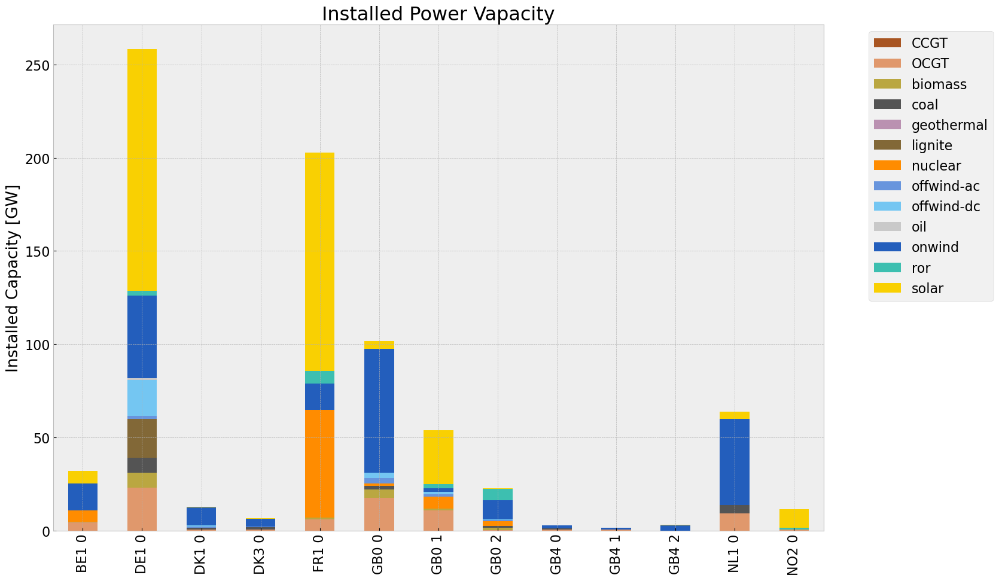

<Figure size 640x480 with 0 Axes>

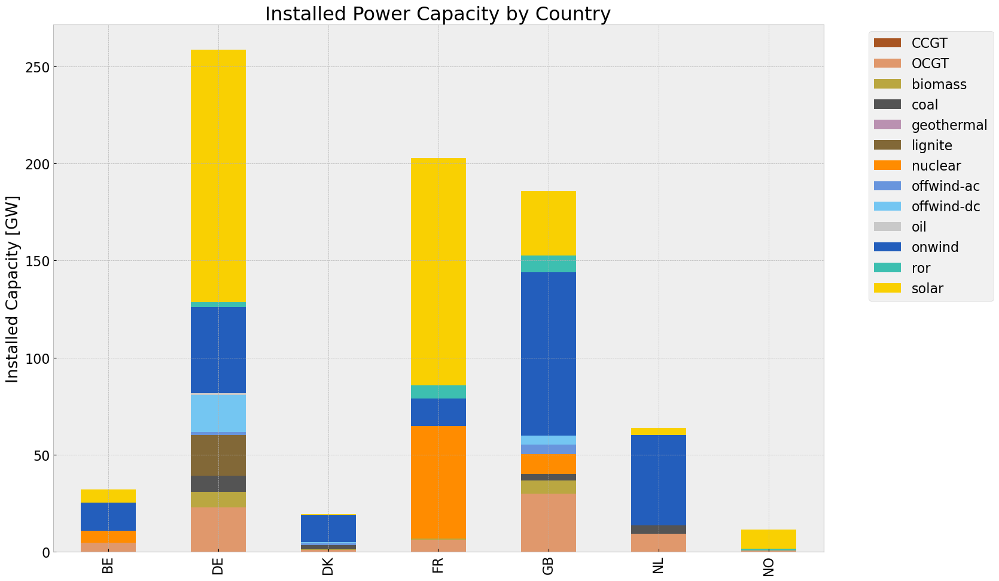

<Figure size 640x480 with 0 Axes>

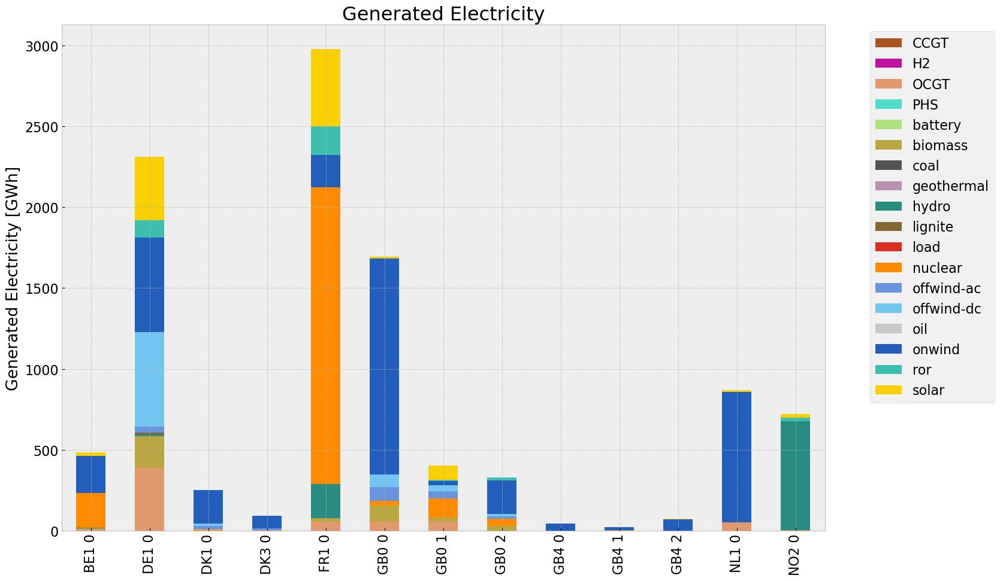

<Figure size 640x480 with 0 Axes>

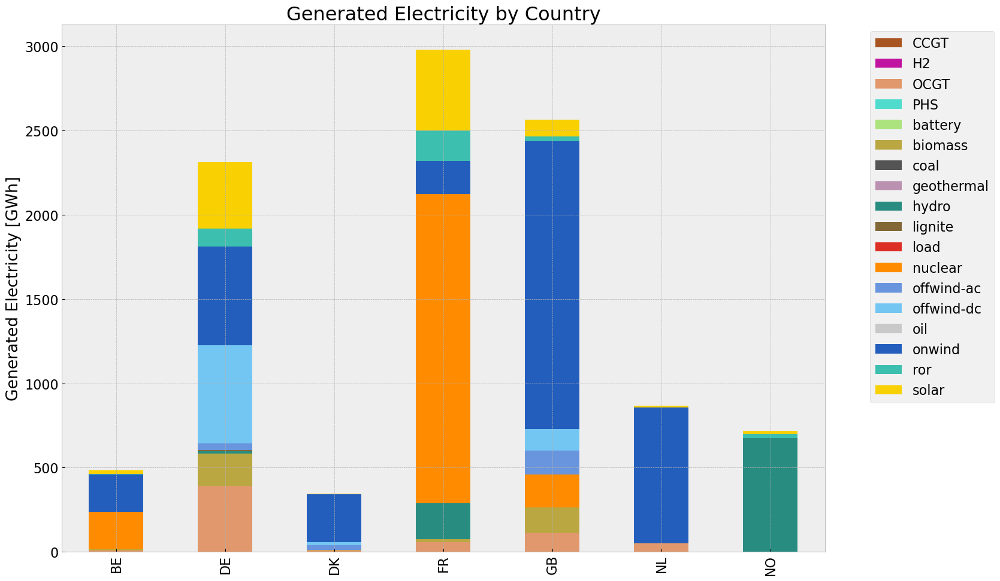

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1755589399.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Us

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.254922e+05,0.431981,0.1980,286696.326483
biomass,3.744926e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329985,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,9.137214e+03,0.333701,0.4069,11141.508314
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.247465e+06,0.326308,0.0000,0.000000
offwind-ac,2.114010e+05,1.000000,0.0000,0.000000


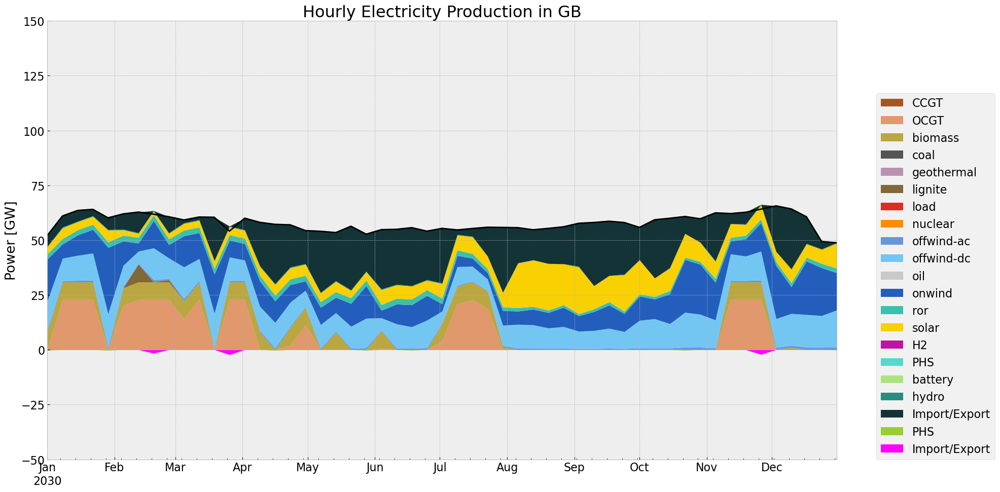

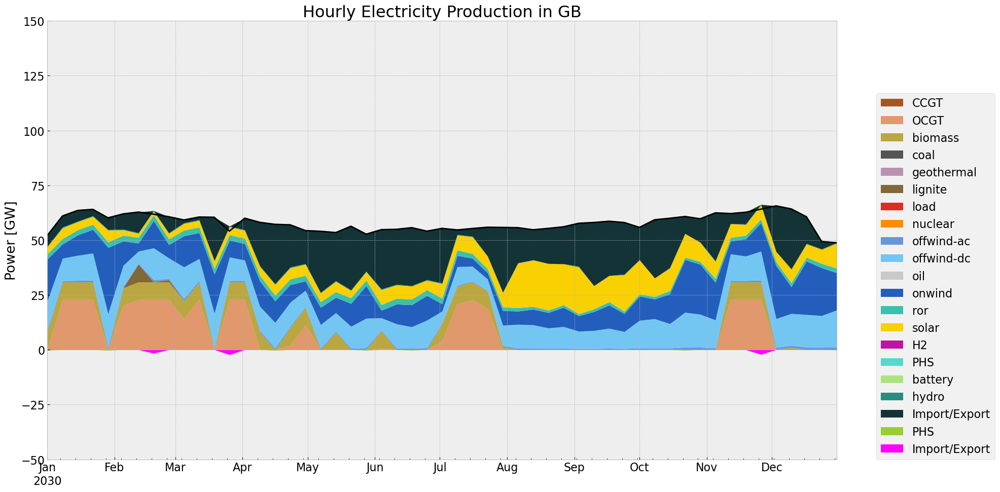

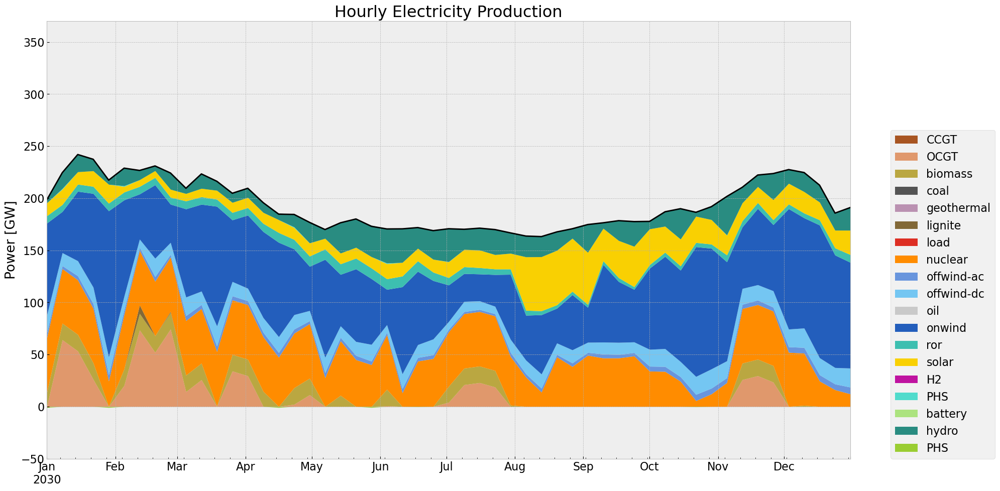

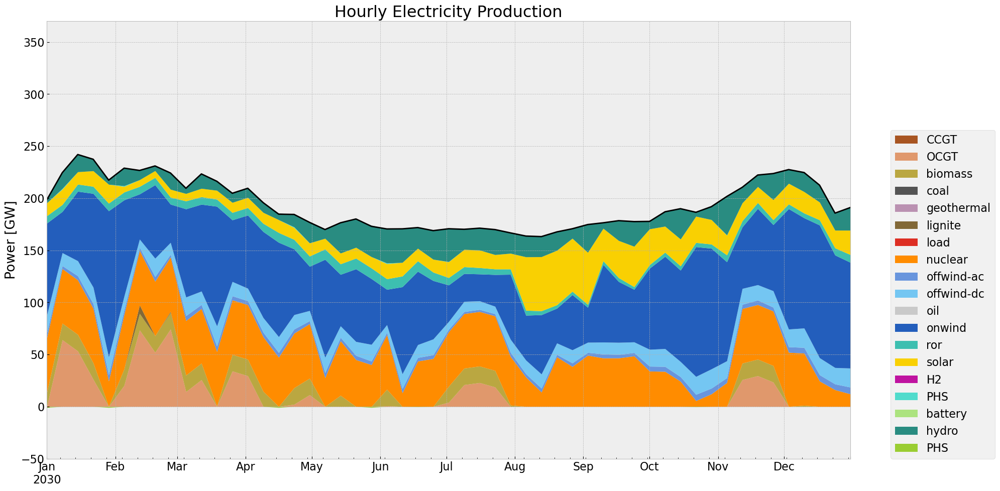

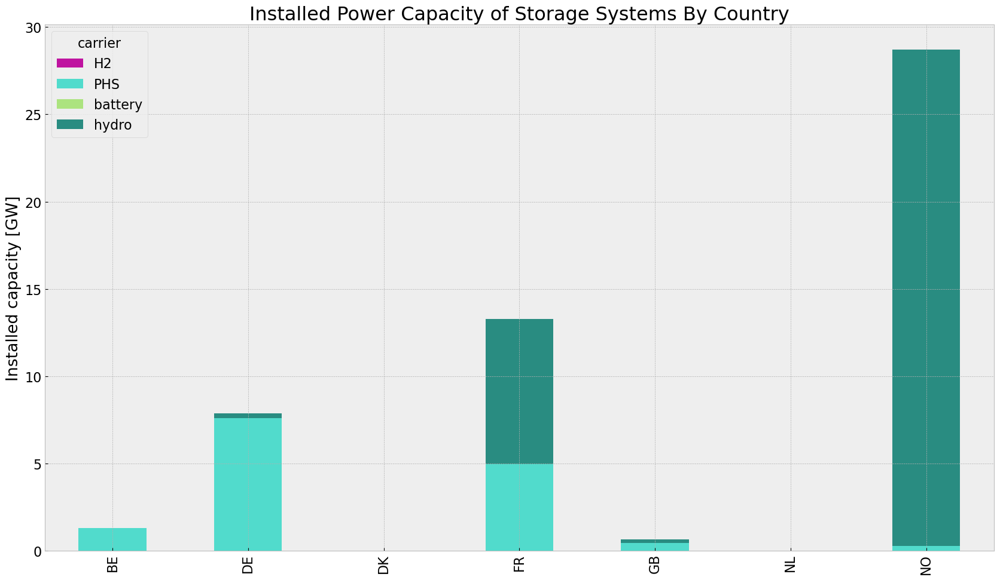

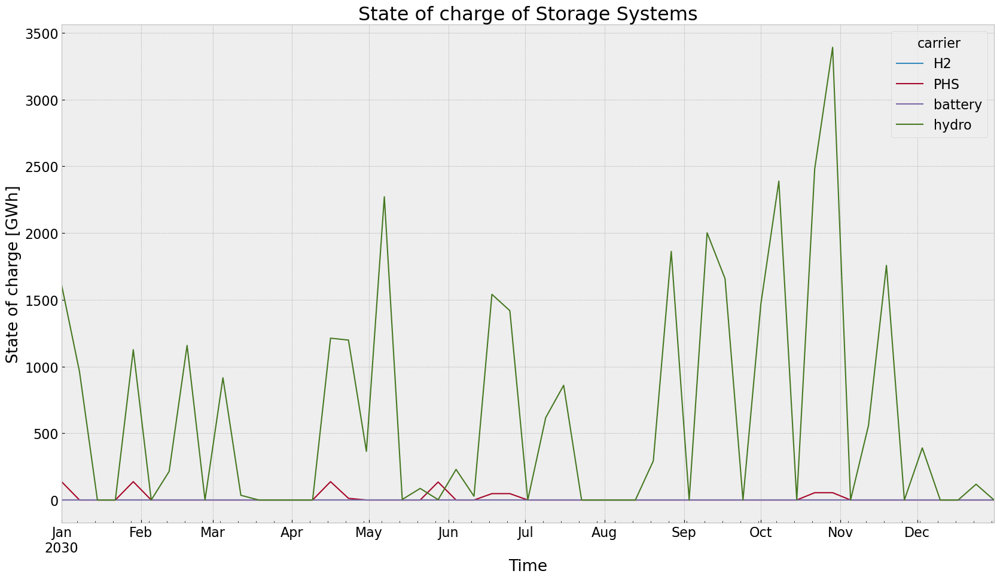

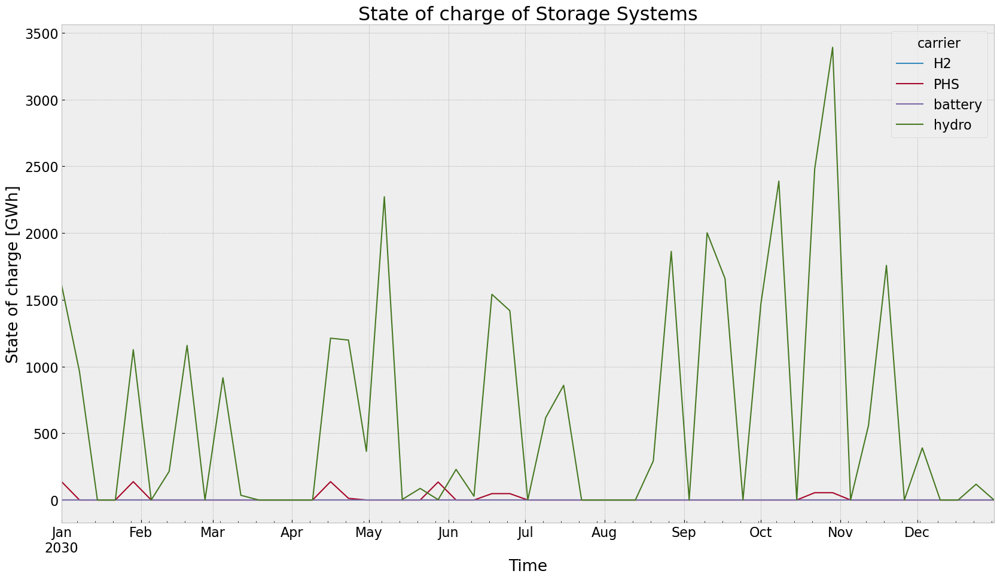

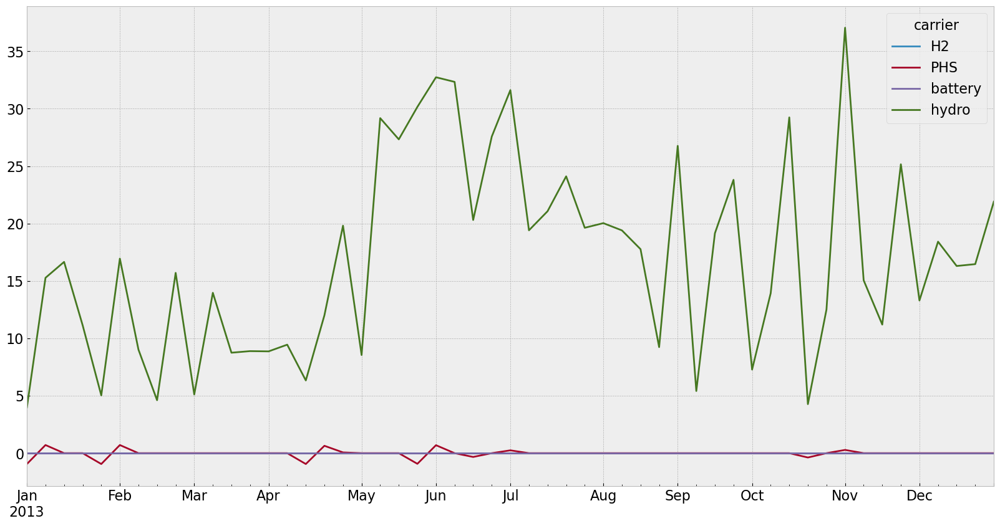

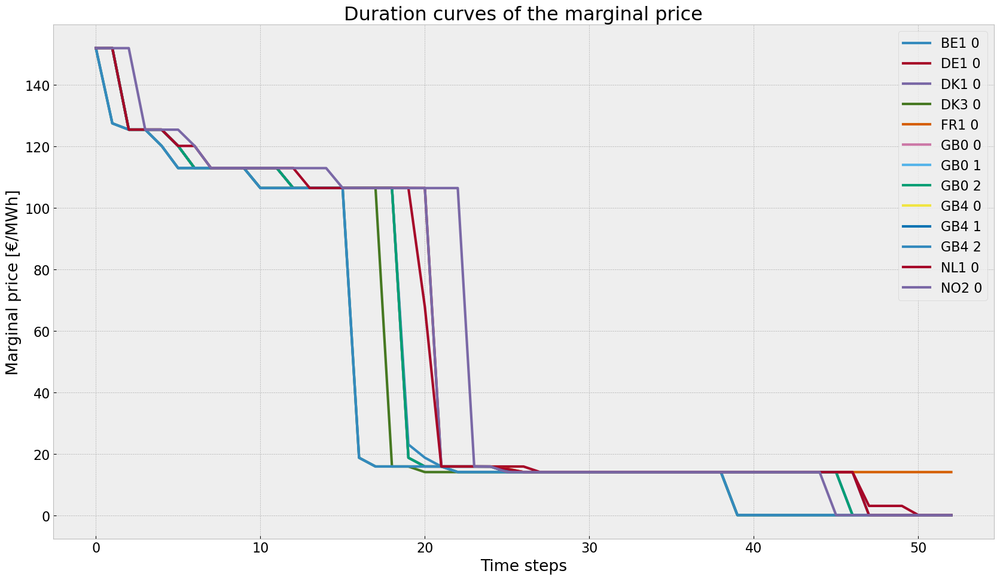

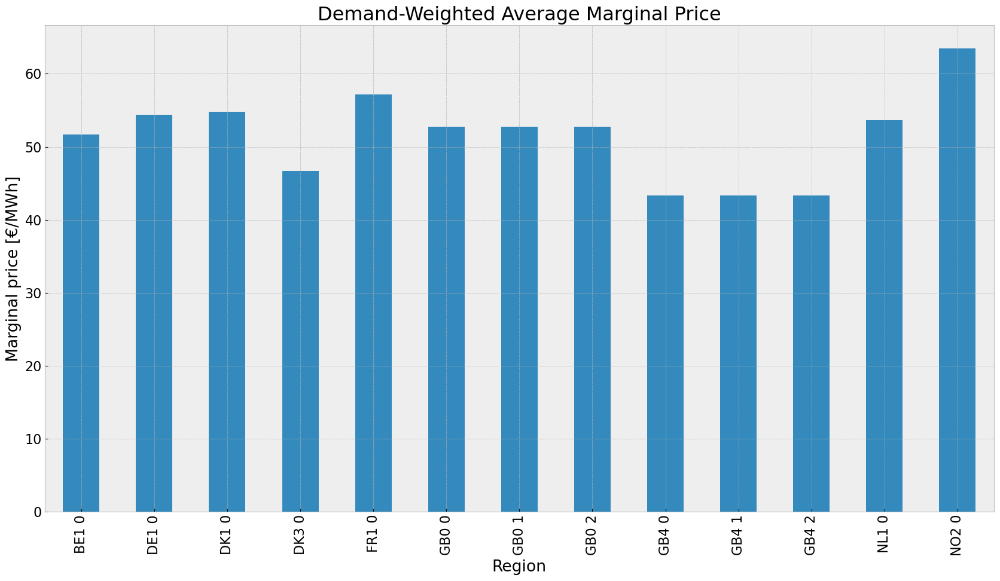

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


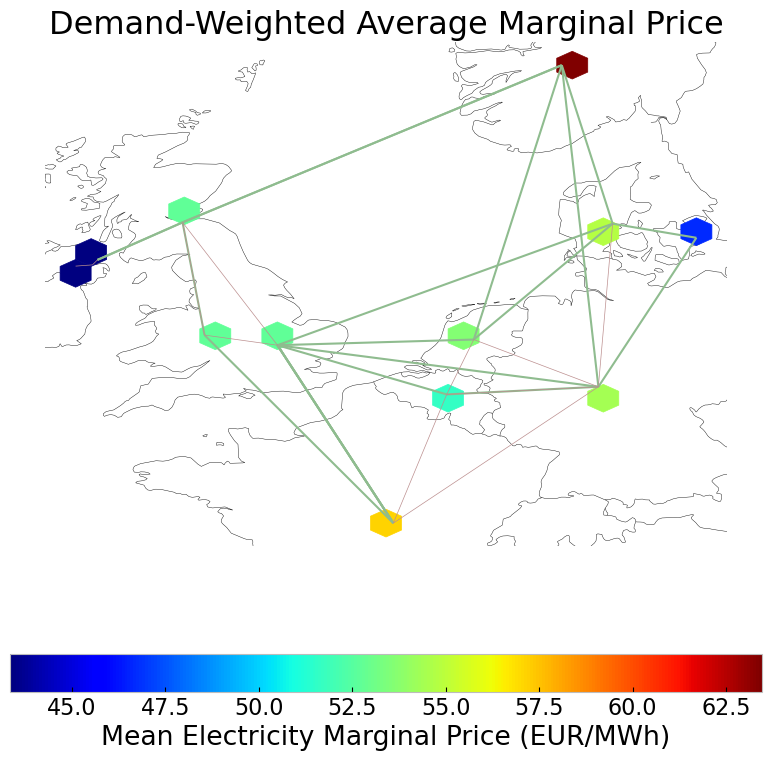

In [159]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [160]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

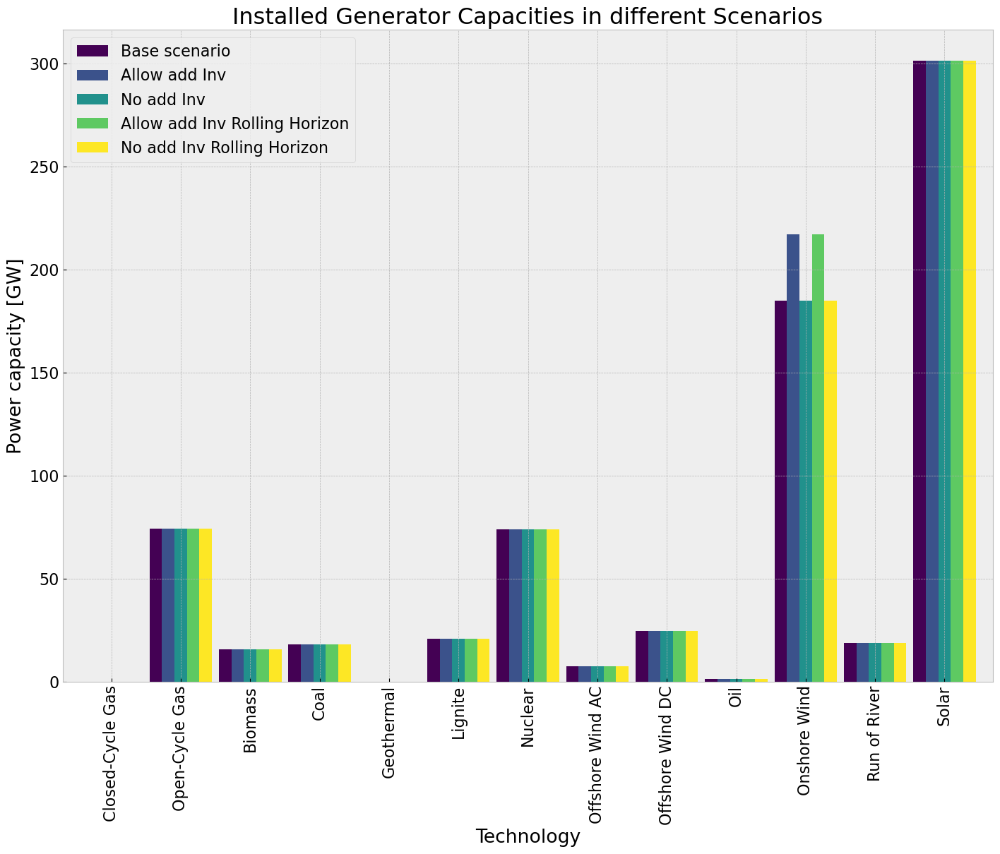

In [161]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'onwind': '#235ebc', 'offwind-dc': '#74c6f2', 'CCGT': '#a85522', 'solar': '#f9d002', 'OCGT': '#e0986c', 'biomass': '#baa741', 'nuclear': '#ff8c00', 'offwind-ac': '#6895dd', 'lignite': '#826837', 'coal': '#545454', 'geothermal': '#ba91b1', 'oil': '#c9c9c9', 'hydro': '#298c81', 'ror': '#3dbfb0', 'PHS': '#51dbcc', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


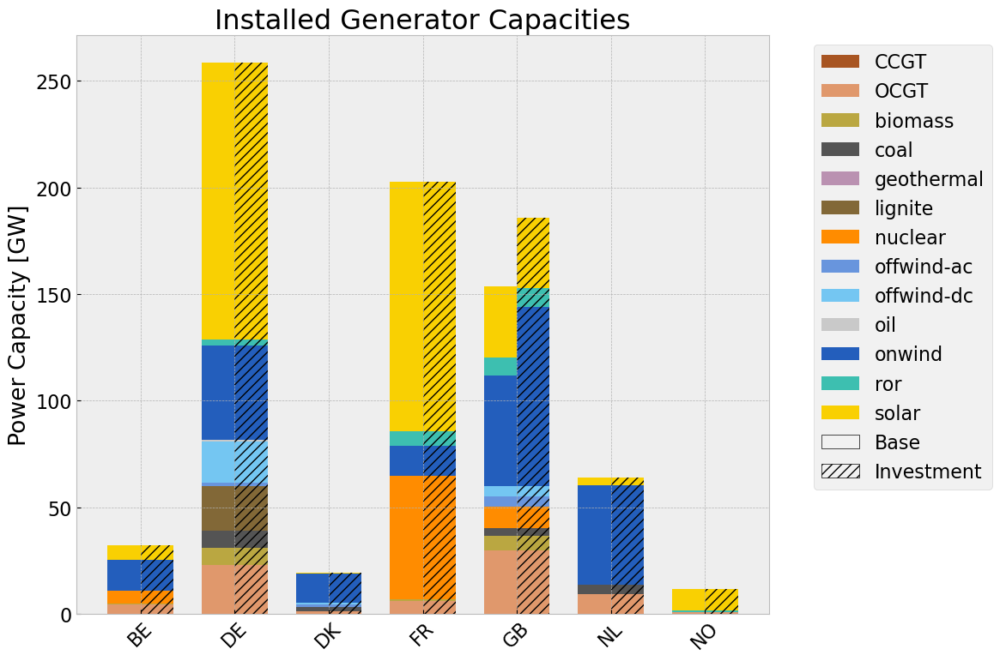

In [162]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


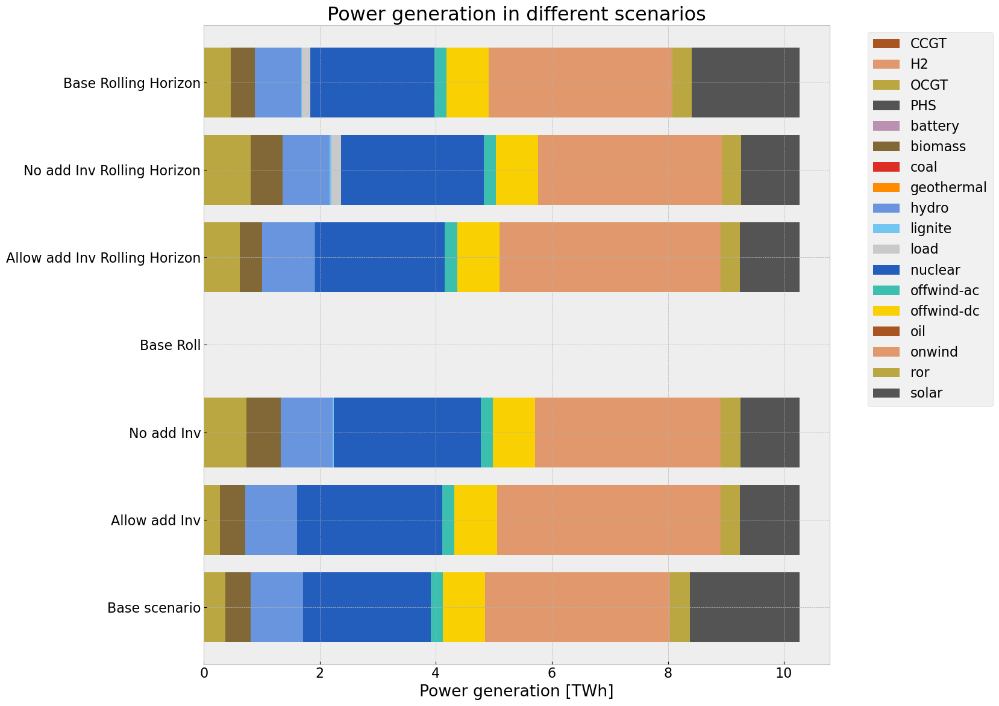

In [163]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

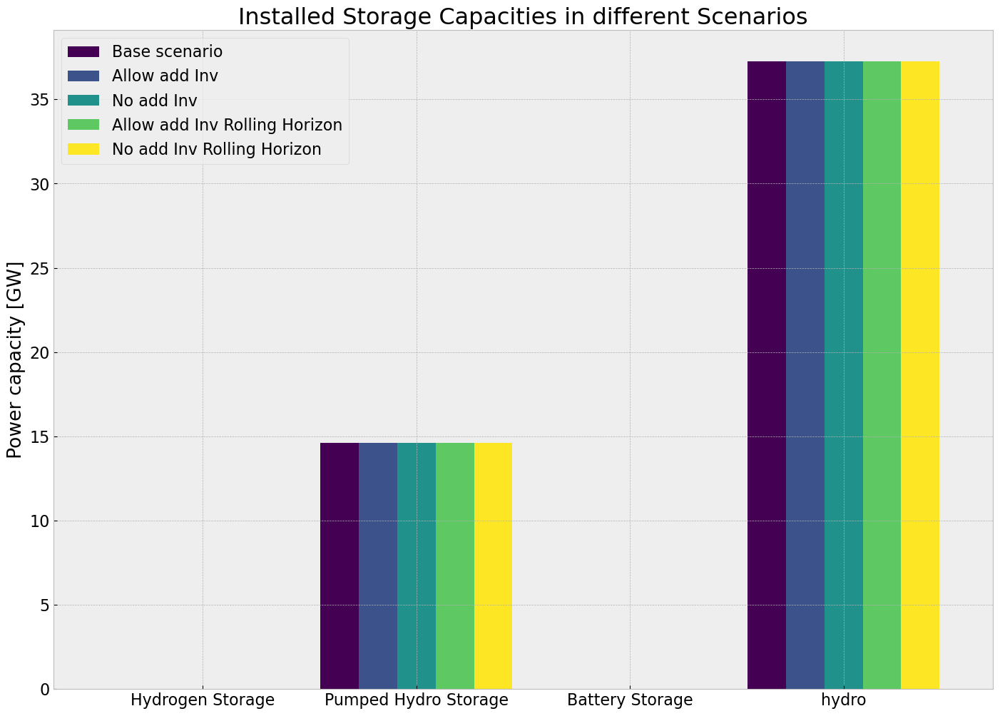

In [164]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

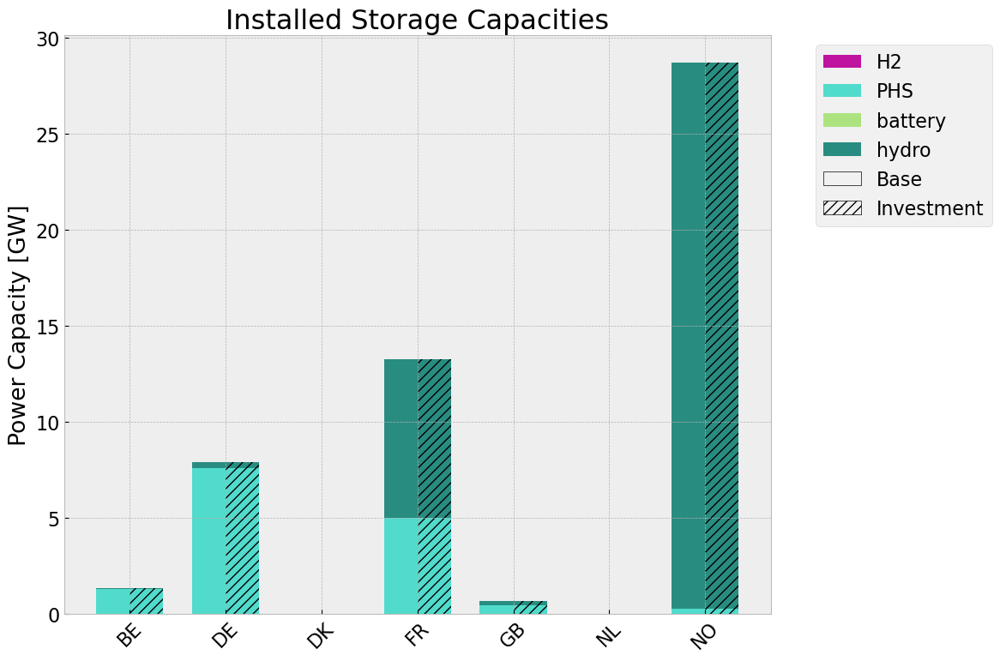

In [165]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [166]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


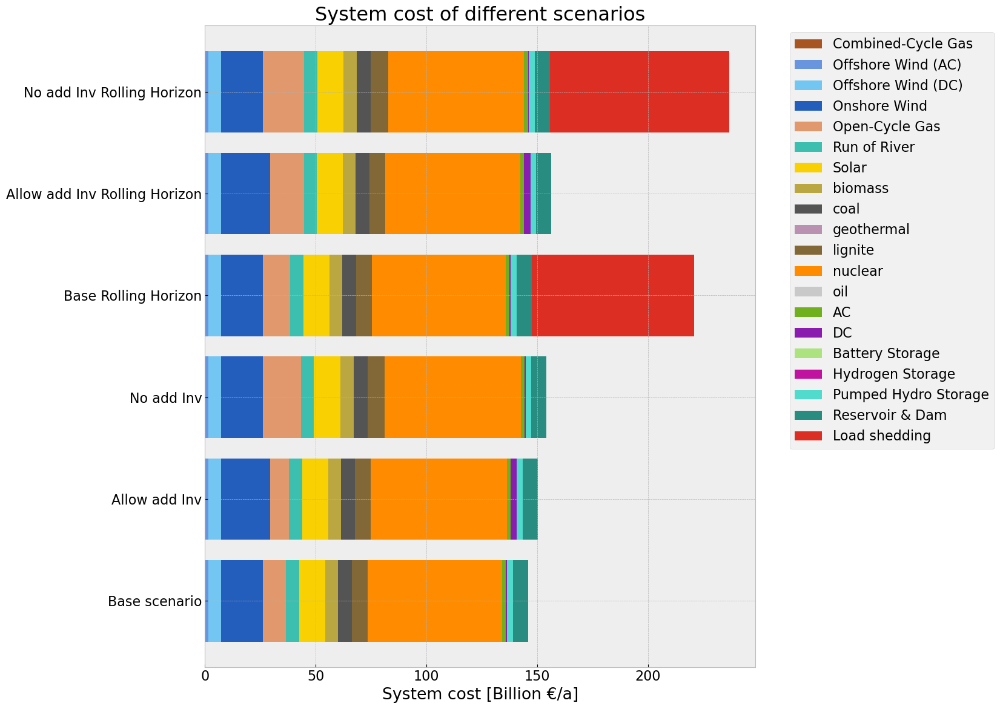

In [167]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [168]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [169]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


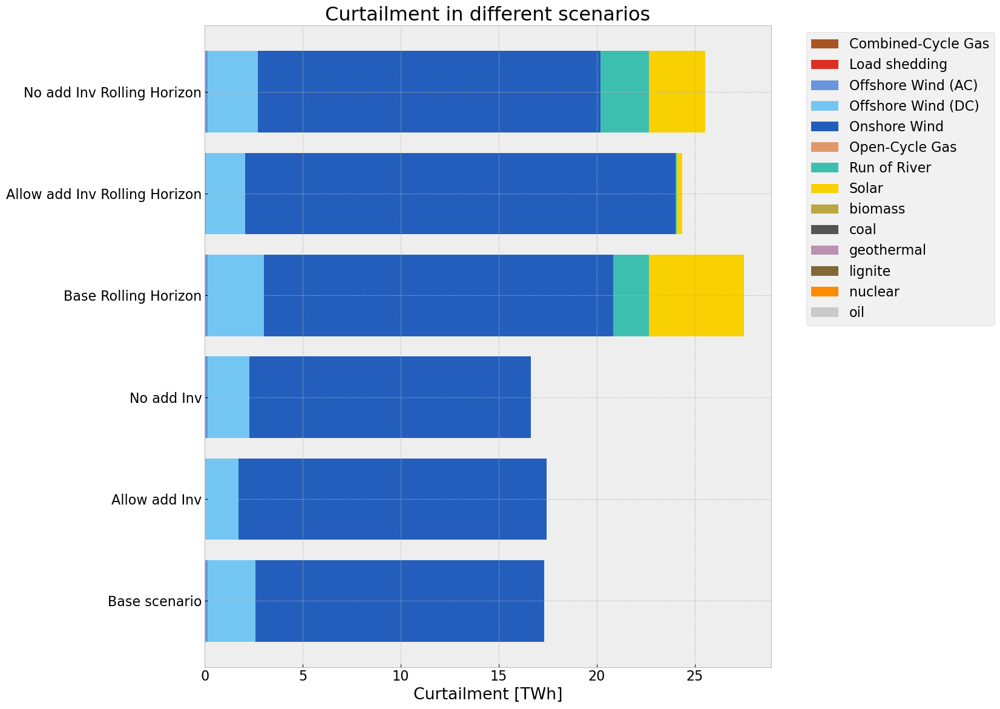

In [170]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


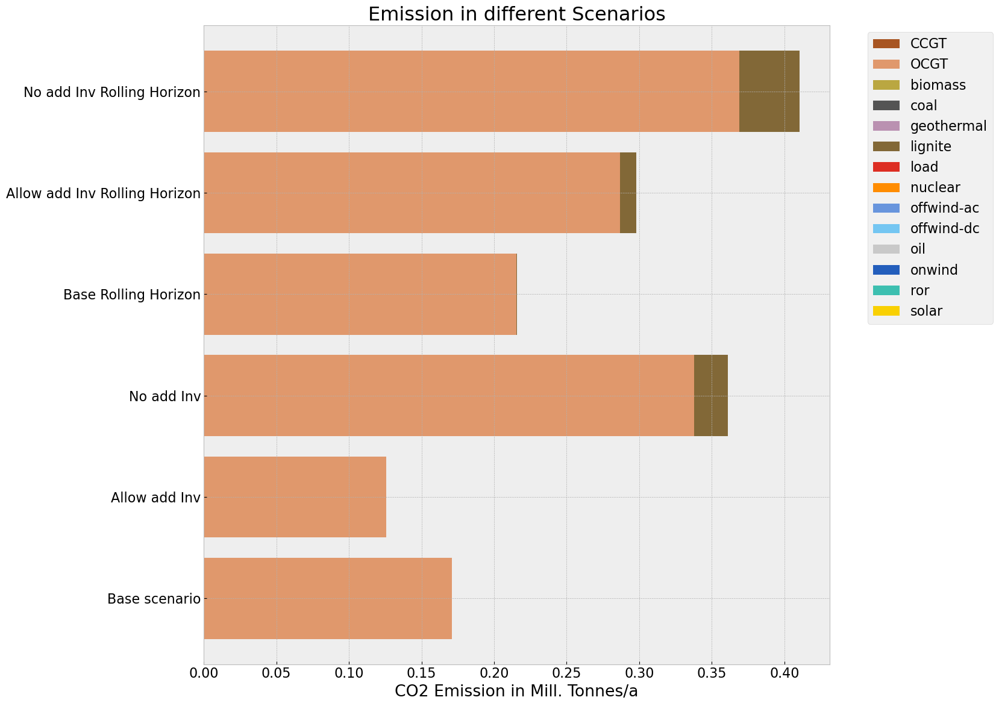

In [171]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [172]:
models = [n, n1, n2, n4]

In [173]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

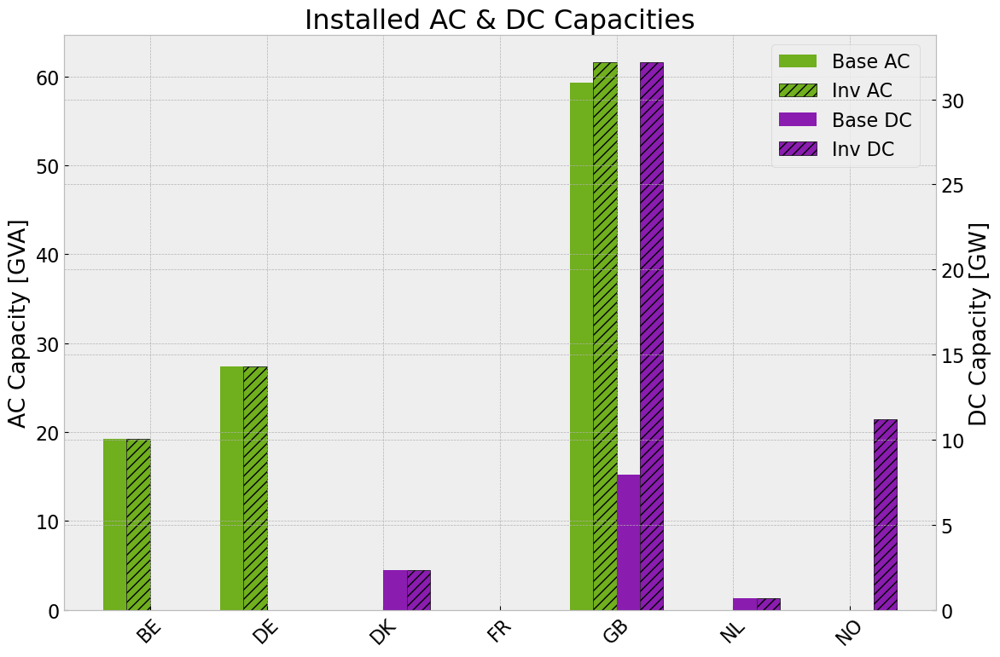

In [174]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [175]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 0,BE1 0: 14801, p_nom_opt: 0.0, 0.0
DK3 0,DE1 0: 14824, p_nom_opt: 600.0, 600.0
DE1 0,NO2 0: 14848, p_nom_opt: 0.0, 0.0
GB0 0,DE1 0: T22, p_nom_opt: 0.0, 10435.829274258878


In [176]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 0,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",404.140030,0.0,,True,False,-1.0,0.000000,32774.066774,30000.0,0,0.010393,0,0,1,0,0.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",505.455247,1000.0,,False,False,-1.0,0.450458,45494.172729,31000.0,0,0.009572,0,0,1,0,3940.626145,False,,1.0,inf,0.0,True,1000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",812.211433,2000.0,,False,False,-1.0,0.061430,51800.134473,32000.0,0,0.009454,0,0,1,0,7982.503004,False,,1.0,inf,0.0,True,2000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14805,DK3 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",207.254534,600.0,,False,True,-1.0,0.133757,25509.554195,30600.0,0,0.010103,0,0,1,0,600.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14824,DK3 0,DE1 0,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",673.462806,600.0,,False,False,-1.0,0.105226,46749.720294,30600.0,0,0.010439,0,0,1,0,600.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",595.265647,0.0,,True,False,-1.0,0.432981,50391.767620,30000.0,0,0.009846,0,0,1,0,0.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1171.718291,700.0,,False,False,-1.0,0.465556,85364.764875,30700.0,0,0.010962,0,0,1,0,700.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14848,DE1 0,NO2 0,DC,"LINESTRING(6.81690675921544 58.6338502746805,6...",1355.390618,0.0,,True,False,-1.0,0.346341,90273.483388,30000.0,0,0.010370,0,0,1,0,0.000000,False,,1.0,inf,0.0,False,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
5581,GB0 2,GB4 0,DC,"LINESTRING(-4.94702447012386 55.0727948492206,...",257.511970,2501.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32527"", ""...",False,False,-1.0,0.193945,28450.007471,32501.0,0,0.009962,0,0,1,0,2501.000000,False,,1.0,inf,0.0,True,2501.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB


# Sensitivity Analysis

In [177]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [178]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [179]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_5_90_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 146.33it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdfeovjj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdfeovjj.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0xeb1716ed


INFO:gurobipy:Model fingerprint: 0xeb1716ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7135 columns


INFO:gurobipy:Presolve removed 28775 rows and 7135 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 7367 rows, 9833 columns, 25833 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9833 columns, 25833 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.72582457e+13 -1.61772885e+14  1.40e+05 4.06e+06  6.13e+10     0s


INFO:gurobipy:   0   2.72582457e+13 -1.61772885e+14  1.40e+05 4.06e+06  6.13e+10     0s


   1   1.79110479e+13 -6.01124422e+13  8.66e+04 7.80e+05  2.67e+10     0s


INFO:gurobipy:   1   1.79110479e+13 -6.01124422e+13  8.66e+04 7.80e+05  2.67e+10     0s


   2   5.98554153e+12 -2.88947698e+13  2.51e+04 3.72e+04  7.21e+09     0s


INFO:gurobipy:   2   5.98554153e+12 -2.88947698e+13  2.51e+04 3.72e+04  7.21e+09     0s


   3   5.25444289e+11 -1.23688530e+13  1.20e+03 6.56e+03  8.49e+08     0s


INFO:gurobipy:   3   5.25444289e+11 -1.23688530e+13  1.20e+03 6.56e+03  8.49e+08     0s


   4   2.39586393e+11 -2.55404226e+12  9.78e+01 7.97e+02  1.47e+08     0s


INFO:gurobipy:   4   2.39586393e+11 -2.55404226e+12  9.78e+01 7.97e+02  1.47e+08     0s


   5   1.66697948e+11 -1.17837816e+12  2.23e+01 3.62e+02  6.68e+07     0s


INFO:gurobipy:   5   1.66697948e+11 -1.17837816e+12  2.23e+01 3.62e+02  6.68e+07     0s


   6   1.27064017e+11 -4.50318438e+11  1.07e+01 1.39e+02  2.83e+07     0s


INFO:gurobipy:   6   1.27064017e+11 -4.50318438e+11  1.07e+01 1.39e+02  2.83e+07     0s


   7   8.27557618e+10 -1.16041625e+11  3.97e+00 3.73e+01  9.63e+06     0s


INFO:gurobipy:   7   8.27557618e+10 -1.16041625e+11  3.97e+00 3.73e+01  9.63e+06     0s


   8   4.58880094e+10 -3.91045324e+10  1.07e+00 1.47e+01  4.09e+06     0s


INFO:gurobipy:   8   4.58880094e+10 -3.91045324e+10  1.07e+00 1.47e+01  4.09e+06     0s


   9   3.43907353e+10 -4.89484924e+09  5.60e-01 5.90e+00  1.88e+06     0s


INFO:gurobipy:   9   3.43907353e+10 -4.89484924e+09  5.60e-01 5.90e+00  1.88e+06     0s


  10   2.75950305e+10  3.39522408e+09  2.95e-01 3.82e+00  1.16e+06     0s


INFO:gurobipy:  10   2.75950305e+10  3.39522408e+09  2.95e-01 3.82e+00  1.16e+06     0s


  11   2.49521891e+10  8.24822293e+09  1.95e-01 2.63e+00  8.00e+05     0s


INFO:gurobipy:  11   2.49521891e+10  8.24822293e+09  1.95e-01 2.63e+00  8.00e+05     0s


  12   2.25360191e+10  1.33618415e+10  1.05e-01 1.39e+00  4.39e+05     0s


INFO:gurobipy:  12   2.25360191e+10  1.33618415e+10  1.05e-01 1.39e+00  4.39e+05     0s


  13   2.12788357e+10  1.49134497e+10  6.19e-02 1.01e+00  3.05e+05     0s


INFO:gurobipy:  13   2.12788357e+10  1.49134497e+10  6.19e-02 1.01e+00  3.05e+05     0s


  14   2.05853293e+10  1.68178334e+10  3.88e-02 5.60e-01  1.80e+05     0s


INFO:gurobipy:  14   2.05853293e+10  1.68178334e+10  3.88e-02 5.60e-01  1.80e+05     0s


  15   1.97188063e+10  1.83612476e+10  1.17e-02 1.80e-01  6.49e+04     0s


INFO:gurobipy:  15   1.97188063e+10  1.83612476e+10  1.17e-02 1.80e-01  6.49e+04     0s


  16   1.96005650e+10  1.89732921e+10  8.77e-03 4.72e-02  3.00e+04     0s


INFO:gurobipy:  16   1.96005650e+10  1.89732921e+10  8.77e-03 4.72e-02  3.00e+04     0s


  17   1.94245100e+10  1.90929630e+10  4.66e-03 2.23e-02  1.59e+04     0s


INFO:gurobipy:  17   1.94245100e+10  1.90929630e+10  4.66e-03 2.23e-02  1.59e+04     0s


  18   1.93308893e+10  1.91612089e+10  2.40e-03 1.02e-02  8.11e+03     0s


INFO:gurobipy:  18   1.93308893e+10  1.91612089e+10  2.40e-03 1.02e-02  8.11e+03     0s


  19   1.92631928e+10  1.92001819e+10  8.37e-04 3.64e-03  3.01e+03     0s


INFO:gurobipy:  19   1.92631928e+10  1.92001819e+10  8.37e-04 3.64e-03  3.01e+03     0s


  20   1.92345358e+10  1.92146072e+10  2.08e-04 1.35e-03  9.53e+02     1s


INFO:gurobipy:  20   1.92345358e+10  1.92146072e+10  2.08e-04 1.35e-03  9.53e+02     1s


  21   1.92272063e+10  1.92203770e+10  5.61e-05 5.18e-04  3.27e+02     1s


INFO:gurobipy:  21   1.92272063e+10  1.92203770e+10  5.61e-05 5.18e-04  3.27e+02     1s


  22   1.92247073e+10  1.92234868e+10  8.22e-06 8.25e-05  5.84e+01     1s


INFO:gurobipy:  22   1.92247073e+10  1.92234868e+10  8.22e-06 8.25e-05  5.84e+01     1s


  23   1.92242998e+10  1.92240027e+10  1.76e-06 1.82e-05  1.42e+01     1s


INFO:gurobipy:  23   1.92242998e+10  1.92240027e+10  1.76e-06 1.82e-05  1.42e+01     1s


  24   1.92242555e+10  1.92241297e+10  1.76e-05 4.48e-06  6.02e+00     1s


INFO:gurobipy:  24   1.92242555e+10  1.92241297e+10  1.76e-05 4.48e-06  6.02e+00     1s


  25   1.92242161e+10  1.92241651e+10  8.16e-06 1.03e-06  2.44e+00     1s


INFO:gurobipy:  25   1.92242161e+10  1.92241651e+10  8.16e-06 1.03e-06  2.44e+00     1s


  26   1.92241827e+10  1.92241756e+10  6.33e-07 2.31e-07  3.40e-01     1s


INFO:gurobipy:  26   1.92241827e+10  1.92241756e+10  6.33e-07 2.31e-07  3.40e-01     1s


  27   1.92241794e+10  1.92241791e+10  6.96e-07 5.06e-09  1.63e-02     1s


INFO:gurobipy:  27   1.92241794e+10  1.92241791e+10  6.96e-07 5.06e-09  1.63e-02     1s


  28   1.92241792e+10  1.92241792e+10  8.41e-09 1.40e-09  2.67e-04     1s


INFO:gurobipy:  28   1.92241792e+10  1.92241792e+10  8.41e-09 1.40e-09  2.67e-04     1s


  29   1.92241792e+10  1.92241792e+10  7.32e-09 1.42e-09  7.34e-07     1s


INFO:gurobipy:  29   1.92241792e+10  1.92241792e+10  7.32e-09 1.42e-09  7.34e-07     1s


  30   1.92241792e+10  1.92241792e+10  1.02e-09 1.40e-09  3.56e-09     1s


INFO:gurobipy:  30   1.92241792e+10  1.92241792e+10  1.02e-09 1.40e-09  3.56e-09     1s


INFO:gurobipy:


Barrier solved model in 30 iterations and 0.69 seconds (0.19 work units)


INFO:gurobipy:Barrier solved model in 30 iterations and 0.69 seconds (0.19 work units)


Optimal objective 1.92241792e+10


INFO:gurobipy:Optimal objective 1.92241792e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3307 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3307 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     123 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     123 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2683701e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2683701e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1814    1.9224179e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1814    1.9224179e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1814 iterations and 0.78 seconds (0.20 work units)


INFO:gurobipy:Solved in 1814 iterations and 0.78 seconds (0.20 work units)


Optimal objective  1.922417924e+10


INFO:gurobipy:Optimal objective  1.922417924e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_90_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80on7w4k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80on7w4k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xccef206c


INFO:gurobipy:Model fingerprint: 0xccef206c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 570 columns


INFO:gurobipy:Presolve removed 1962 rows and 570 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 387 columns, 551 nonzeros


INFO:gurobipy:Presolved: 78 rows, 387 columns, 551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3109711e+05   3.164011e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3109711e+05   3.164011e+05   0.000000e+00      0s


      77    3.1878374e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    3.1878374e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.187837439e+09


INFO:gurobipy:Optimal objective  3.187837439e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgjqxfyo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgjqxfyo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2a33ffa1


INFO:gurobipy:Model fingerprint: 0x2a33ffa1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 583 columns


INFO:gurobipy:Presolve removed 1963 rows and 583 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 77 rows, 374 columns, 532 nonzeros


INFO:gurobipy:Presolved: 77 rows, 374 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0010501e+08   2.203549e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0010501e+08   2.203549e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      75    1.9729016e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.9729016e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.972901557e+09


INFO:gurobipy:Optimal objective  1.972901557e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uyi1zok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uyi1zok.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9ffadcaf


INFO:gurobipy:Model fingerprint: 0x9ffadcaf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 572 columns


INFO:gurobipy:Presolve removed 1963 rows and 572 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 385 columns, 543 nonzeros


INFO:gurobipy:Presolved: 77 rows, 385 columns, 543 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4305968e+08   2.191611e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4305968e+08   2.191611e+05   0.000000e+00      0s


      88    4.7922959e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    4.7922959e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.792295906e+09


INFO:gurobipy:Optimal objective  4.792295906e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47av4wjc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47av4wjc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x92700cc6


INFO:gurobipy:Model fingerprint: 0x92700cc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 576 columns


INFO:gurobipy:Presolve removed 1962 rows and 576 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3565084e+05   2.976224e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3565084e+05   2.976224e+05   0.000000e+00      0s


      81    2.0846783e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    2.0846783e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.11 seconds (0.00 work units)


Optimal objective  2.084678250e+09


INFO:gurobipy:Optimal objective  2.084678250e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8hkkg_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8hkkg_h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2891ec58


INFO:gurobipy:Model fingerprint: 0x2891ec58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5801880e+05   2.476519e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5801880e+05   2.476519e+05   0.000000e+00      0s


      70    1.7183818e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    1.7183818e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.718381756e+09


INFO:gurobipy:Optimal objective  1.718381756e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t70wzagx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t70wzagx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4a54af87


INFO:gurobipy:Model fingerprint: 0x4a54af87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 572 columns


INFO:gurobipy:Presolve removed 1966 rows and 572 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 74 rows, 385 columns, 542 nonzeros


INFO:gurobipy:Presolved: 74 rows, 385 columns, 542 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3438085e+05   2.051229e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3438085e+05   2.051229e+05   0.000000e+00      0s


      90    5.6638085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    5.6638085e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.08 seconds (0.00 work units)


Optimal objective  5.663808519e+08


INFO:gurobipy:Optimal objective  5.663808519e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8jqsukn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8jqsukn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6863aeb2


INFO:gurobipy:Model fingerprint: 0x6863aeb2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 576 columns


INFO:gurobipy:Presolve removed 1965 rows and 576 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 381 columns, 540 nonzeros


INFO:gurobipy:Presolved: 75 rows, 381 columns, 540 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5286425e+04   1.677578e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5286425e+04   1.677578e+05   0.000000e+00      0s


      75    1.8097356e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.8097356e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.809735583e+08


INFO:gurobipy:Optimal objective  1.809735583e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-107gzc7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-107gzc7u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9b54c598


INFO:gurobipy:Model fingerprint: 0x9b54c598


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 579 columns


INFO:gurobipy:Presolve removed 1968 rows and 579 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.6337606e+04   1.495977e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.6337606e+04   1.495977e+05   0.000000e+00      0s


      69    1.1228684e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.1228684e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.10 seconds (0.00 work units)


Optimal objective  1.122868380e+08


INFO:gurobipy:Optimal objective  1.122868380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_jyfw53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_jyfw53.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x65e5a119


INFO:gurobipy:Model fingerprint: 0x65e5a119


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 569 columns


INFO:gurobipy:Presolve removed 1965 rows and 569 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 388 columns, 547 nonzeros


INFO:gurobipy:Presolved: 75 rows, 388 columns, 547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.6531791e+04   1.465950e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.6531791e+04   1.465950e+05   0.000000e+00      0s


      93    1.5620226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      93    1.5620226e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 93 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 93 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.562022634e+08


INFO:gurobipy:Optimal objective  1.562022634e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahsimq10.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahsimq10.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x214d1e52


INFO:gurobipy:Model fingerprint: 0x214d1e52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3768956e+05   1.379980e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.3768956e+05   1.379980e+05   0.000000e+00      0s


      85    3.2501505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.2501505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.250150483e+08


INFO:gurobipy:Optimal objective  3.250150483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dux2d1u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8dux2d1u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xe6a85691


INFO:gurobipy:Model fingerprint: 0xe6a85691


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1476008e+03   1.347601e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.1476008e+03   1.347601e+05   0.000000e+00      0s


      91    1.6652155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    1.6652155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665215514e+08


INFO:gurobipy:Optimal objective  1.665215514e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0vcxqn4_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0vcxqn4_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xae9abb40


INFO:gurobipy:Model fingerprint: 0xae9abb40


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6025167e+04   1.489032e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6025167e+04   1.489032e+05   0.000000e+00      0s


      88    3.5706293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    3.5706293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.570629347e+08


INFO:gurobipy:Optimal objective  3.570629347e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_vme8kl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_vme8kl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x3266e8d8


INFO:gurobipy:Model fingerprint: 0x3266e8d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 558 columns


INFO:gurobipy:Presolve removed 1962 rows and 558 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1593158e+04   1.735429e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1593158e+04   1.735429e+05   0.000000e+00      0s


      94    3.9776940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      94    3.9776940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 94 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 94 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.977694030e+08


INFO:gurobipy:Optimal objective  3.977694030e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22y7jgvf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22y7jgvf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd52bff7f


INFO:gurobipy:Model fingerprint: 0xd52bff7f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 564 columns


INFO:gurobipy:Presolve removed 1962 rows and 564 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7409415e+05   2.000394e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7409415e+05   2.000394e+05   0.000000e+00      0s


      81    3.1375794e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    3.1375794e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.137579398e+08


INFO:gurobipy:Optimal objective  3.137579398e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjrbast7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjrbast7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x650476d9


INFO:gurobipy:Model fingerprint: 0x650476d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 583 columns


INFO:gurobipy:Presolve removed 1962 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0812955e+05   2.198593e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0812955e+05   2.198593e+05   0.000000e+00      0s


      92    1.5078563e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.5078563e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.507856301e+08


INFO:gurobipy:Optimal objective  1.507856301e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhc1uppi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhc1uppi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xce23422c


INFO:gurobipy:Model fingerprint: 0xce23422c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 564 columns


INFO:gurobipy:Presolve removed 1962 rows and 564 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7721244e+05   2.678200e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7721244e+05   2.678200e+05   0.000000e+00      0s


      82    2.4686318e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      82    2.4686318e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 82 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 82 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.468631763e+09


INFO:gurobipy:Optimal objective  2.468631763e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.47e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uo_4d2c0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uo_4d2c0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf649413c


INFO:gurobipy:Model fingerprint: 0xf649413c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 582 columns


INFO:gurobipy:Presolve removed 1962 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8269014e+05   2.831419e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8269014e+05   2.831419e+05   0.000000e+00      0s


      86    4.3737290e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    4.3737290e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.373728979e+08


INFO:gurobipy:Optimal objective  4.373728979e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5eyczph5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5eyczph5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x712e12c2


INFO:gurobipy:Model fingerprint: 0x712e12c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 399 columns


INFO:gurobipy:Presolve removed 1308 rows and 399 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4739166e+04   6.353717e+04   0.000000e+00      0s


INFO:gurobipy:       0    4.4739166e+04   6.353717e+04   0.000000e+00      0s


      45    5.2937881e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    5.2937881e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.293788092e+07


INFO:gurobipy:Optimal objective  5.293788092e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 5.29e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_5_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yirgzzac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yirgzzac.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x5998e79d


INFO:gurobipy:Model fingerprint: 0x5998e79d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10085 columns


INFO:gurobipy:Presolve removed 34662 rows and 10085 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1378 rows, 6822 columns, 9684 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6822 columns, 9684 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09640070e+13 -1.33792135e+14  9.32e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:   0   2.09640070e+13 -1.33792135e+14  9.32e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1668    1.6062202e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1668    1.6062202e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1668 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1668 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.606220207e+10


INFO:gurobipy:Optimal objective  1.606220207e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 1.61e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk6eputw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk6eputw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr_tilib.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr_tilib.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd50ec3be


INFO:gurobipy:Model fingerprint: 0xd50ec3be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 606 columns


INFO:gurobipy:Presolve removed 1964 rows and 606 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.597624501e+10


INFO:gurobipy:Optimal objective  1.597624501e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.60e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_tat5d1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_tat5d1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xfa601278


INFO:gurobipy:Model fingerprint: 0xfa601278


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1964 rows and 592 columns


INFO:gurobipy:Presolve removed 1964 rows and 592 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.840471313e+10


INFO:gurobipy:Optimal objective  1.840471313e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.84e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ennr_7m3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ennr_7m3.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x287f10dd


INFO:gurobipy:Model fingerprint: 0x287f10dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 616 columns


INFO:gurobipy:Presolve removed 1965 rows and 616 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.643373315e+10


INFO:gurobipy:Optimal objective  1.643373315e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.64e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mjyt4fs3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mjyt4fs3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa3c51554


INFO:gurobipy:Model fingerprint: 0xa3c51554


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 594 columns


INFO:gurobipy:Presolve removed 1965 rows and 594 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.448761986e+10


INFO:gurobipy:Optimal objective  1.448761986e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czy2bo2_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czy2bo2_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x09670551


INFO:gurobipy:Model fingerprint: 0x09670551


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 602 columns


INFO:gurobipy:Presolve removed 1968 rows and 602 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.595929603e+09


INFO:gurobipy:Optimal objective  9.595929603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l71mhm63.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l71mhm63.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd0eb6295


INFO:gurobipy:Model fingerprint: 0xd0eb6295


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 611 columns


INFO:gurobipy:Presolve removed 1968 rows and 611 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.235221773e+08


INFO:gurobipy:Optimal objective  6.235221773e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syrwmup2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syrwmup2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf8deac84


INFO:gurobipy:Model fingerprint: 0xf8deac84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 607 columns


INFO:gurobipy:Presolve removed 1970 rows and 607 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 60 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 60 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.751738539e+08


INFO:gurobipy:Optimal objective  1.751738539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lid5u356.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lid5u356.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb7593025


INFO:gurobipy:Model fingerprint: 0xb7593025


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 613 columns


INFO:gurobipy:Presolve removed 1971 rows and 613 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.401009240e+08


INFO:gurobipy:Optimal objective  2.401009240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nquw_oh7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nquw_oh7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xac7d5367


INFO:gurobipy:Model fingerprint: 0xac7d5367


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 590 columns


INFO:gurobipy:Presolve removed 1967 rows and 590 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.866790905e+08


INFO:gurobipy:Optimal objective  5.866790905e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pyoufk1g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pyoufk1g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5a3b6cc7


INFO:gurobipy:Model fingerprint: 0x5a3b6cc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 599 columns


INFO:gurobipy:Presolve removed 1967 rows and 599 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 68 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 68 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.279639880e+08


INFO:gurobipy:Optimal objective  2.279639880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lizk43ut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lizk43ut.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6ae7f4d8


INFO:gurobipy:Model fingerprint: 0x6ae7f4d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 586 columns


INFO:gurobipy:Presolve removed 1964 rows and 586 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.198479113e+08


INFO:gurobipy:Optimal objective  5.198479113e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_9ve0_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_9ve0_i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f821f1e


INFO:gurobipy:Model fingerprint: 0x0f821f1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.594033631e+08


INFO:gurobipy:Optimal objective  4.594033631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfs0yauz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfs0yauz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8a620dbb


INFO:gurobipy:Model fingerprint: 0x8a620dbb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.454001978e+08


INFO:gurobipy:Optimal objective  3.454001978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ndtwvn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ndtwvn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa2050eb7


INFO:gurobipy:Model fingerprint: 0xa2050eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 600 columns


INFO:gurobipy:Presolve removed 1962 rows and 600 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.079434626e+08


INFO:gurobipy:Optimal objective  2.079434626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_vpm4t8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y_vpm4t8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9x3902rd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9x3902rd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lr9amaoq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lr9amaoq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_5_180_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 146.32it/s]
INFO:linopy.io: Writing time: 0.63s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7q3wy5n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7q3wy5n.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0x2b1575f7


INFO:gurobipy:Model fingerprint: 0x2b1575f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7134 columns


INFO:gurobipy:Presolve removed 28775 rows and 7134 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.72828967e+13 -1.61609528e+14  1.40e+05 4.06e+06  6.12e+10     0s


INFO:gurobipy:   0   2.72828967e+13 -1.61609528e+14  1.40e+05 4.06e+06  6.12e+10     0s


   1   1.82234369e+13 -6.01037338e+13  8.82e+04 7.81e+05  2.70e+10     0s


INFO:gurobipy:   1   1.82234369e+13 -6.01037338e+13  8.82e+04 7.81e+05  2.70e+10     0s


   2   6.40111634e+12 -2.91410599e+13  2.75e+04 4.20e+04  7.78e+09     0s


INFO:gurobipy:   2   6.40111634e+12 -2.91410599e+13  2.75e+04 4.20e+04  7.78e+09     0s


   3   5.49372543e+11 -1.25623468e+13  1.26e+03 6.69e+03  8.72e+08     0s


INFO:gurobipy:   3   5.49372543e+11 -1.25623468e+13  1.26e+03 6.69e+03  8.72e+08     0s


   4   2.44890801e+11 -2.02496962e+12  8.66e+01 7.27e+02  1.20e+08     0s


INFO:gurobipy:   4   2.44890801e+11 -2.02496962e+12  8.66e+01 7.27e+02  1.20e+08     0s


   5   1.67910424e+11 -1.48649176e+12  2.01e+01 5.34e+02  8.25e+07     0s


INFO:gurobipy:   5   1.67910424e+11 -1.48649176e+12  2.01e+01 5.34e+02  8.25e+07     0s


   6   1.39508025e+11 -5.13526621e+11  1.13e+01 1.74e+02  3.22e+07     0s


INFO:gurobipy:   6   1.39508025e+11 -5.13526621e+11  1.13e+01 1.74e+02  3.22e+07     0s


   7   9.07539341e+10 -2.39923923e+11  3.66e+00 8.34e+01  1.61e+07     0s


INFO:gurobipy:   7   9.07539341e+10 -2.39923923e+11  3.66e+00 8.34e+01  1.61e+07     0s


   8   5.53697329e+10 -9.12823113e+10  6.72e-01 3.16e+01  7.06e+06     0s


INFO:gurobipy:   8   5.53697329e+10 -9.12823113e+10  6.72e-01 3.16e+01  7.06e+06     0s


   9   3.65345627e+10 -2.65984918e+10  2.22e-01 1.25e+01  3.03e+06     0s


INFO:gurobipy:   9   3.65345627e+10 -2.65984918e+10  2.22e-01 1.25e+01  3.03e+06     0s


  10   3.19029654e+10 -9.20202438e+09  1.49e-01 7.61e+00  1.97e+06     0s


INFO:gurobipy:  10   3.19029654e+10 -9.20202438e+09  1.49e-01 7.61e+00  1.97e+06     0s


  11   2.79672727e+10 -2.36145388e+09  9.23e-02 5.84e+00  1.45e+06     0s


INFO:gurobipy:  11   2.79672727e+10 -2.36145388e+09  9.23e-02 5.84e+00  1.45e+06     0s


  12   2.49094027e+10  6.24032702e+09  5.11e-02 3.60e+00  8.94e+05     0s


INFO:gurobipy:  12   2.49094027e+10  6.24032702e+09  5.11e-02 3.60e+00  8.94e+05     0s


  13   2.37452105e+10  8.92768001e+09  3.62e-02 2.91e+00  7.09e+05     0s


INFO:gurobipy:  13   2.37452105e+10  8.92768001e+09  3.62e-02 2.91e+00  7.09e+05     0s


  14   2.24315626e+10  1.20574468e+10  2.01e-02 2.14e+00  4.96e+05     1s


INFO:gurobipy:  14   2.24315626e+10  1.20574468e+10  2.01e-02 2.14e+00  4.96e+05     1s


  15   2.15435518e+10  1.73559254e+10  8.14e-03 7.61e-01  2.00e+05     1s


INFO:gurobipy:  15   2.15435518e+10  1.73559254e+10  8.14e-03 7.61e-01  2.00e+05     1s


  16   2.10493152e+10  1.92923226e+10  4.08e-03 2.60e-01  8.40e+04     1s


INFO:gurobipy:  16   2.10493152e+10  1.92923226e+10  4.08e-03 2.60e-01  8.40e+04     1s


  17   2.07684274e+10  1.96994733e+10  2.23e-03 1.59e-01  5.11e+04     1s


INFO:gurobipy:  17   2.07684274e+10  1.96994733e+10  2.23e-03 1.59e-01  5.11e+04     1s


  18   2.06410342e+10  2.01434690e+10  1.45e-03 5.26e-02  2.38e+04     1s


INFO:gurobipy:  18   2.06410342e+10  2.01434690e+10  1.45e-03 5.26e-02  2.38e+04     1s


  19   2.04995719e+10  2.02864448e+10  5.93e-04 1.99e-02  1.02e+04     1s


INFO:gurobipy:  19   2.04995719e+10  2.02864448e+10  5.93e-04 1.99e-02  1.02e+04     1s


  20   2.04515035e+10  2.03533384e+10  3.49e-04 5.67e-03  4.69e+03     1s


INFO:gurobipy:  20   2.04515035e+10  2.03533384e+10  3.49e-04 5.67e-03  4.69e+03     1s


  21   2.03996253e+10  2.03752422e+10  7.52e-05 1.19e-03  1.17e+03     1s


INFO:gurobipy:  21   2.03996253e+10  2.03752422e+10  7.52e-05 1.19e-03  1.17e+03     1s


  22   2.03855097e+10  2.03815906e+10  7.82e-06 1.65e-04  1.87e+02     1s


INFO:gurobipy:  22   2.03855097e+10  2.03815906e+10  7.82e-06 1.65e-04  1.87e+02     1s


  23   2.03833976e+10  2.03827961e+10  1.48e-06 3.39e-05  2.88e+01     1s


INFO:gurobipy:  23   2.03833976e+10  2.03827961e+10  1.48e-06 3.39e-05  2.88e+01     1s


  24   2.03832596e+10  2.03830537e+10  5.37e-05 1.00e-05  9.84e+00     1s


INFO:gurobipy:  24   2.03832596e+10  2.03830537e+10  5.37e-05 1.00e-05  9.84e+00     1s


  25   2.03831981e+10  2.03831361e+10  3.29e-05 3.01e-06  2.96e+00     1s


INFO:gurobipy:  25   2.03831981e+10  2.03831361e+10  3.29e-05 3.01e-06  2.96e+00     1s


  26   2.03831763e+10  2.03831662e+10  1.01e-05 5.32e-07  4.79e-01     1s


INFO:gurobipy:  26   2.03831763e+10  2.03831662e+10  1.01e-05 5.32e-07  4.79e-01     1s


  27   2.03831741e+10  2.03831715e+10  2.69e-06 1.44e-07  1.26e-01     1s


INFO:gurobipy:  27   2.03831741e+10  2.03831715e+10  2.69e-06 1.44e-07  1.26e-01     1s


  28   2.03831737e+10  2.03831734e+10  5.27e-07 1.10e-08  1.24e-02     1s


INFO:gurobipy:  28   2.03831737e+10  2.03831734e+10  5.27e-07 1.10e-08  1.24e-02     1s


  29   2.03831736e+10  2.03831736e+10  1.47e-07 1.35e-09  5.11e-04     1s


INFO:gurobipy:  29   2.03831736e+10  2.03831736e+10  1.47e-07 1.35e-09  5.11e-04     1s


INFO:gurobipy:


Barrier performed 29 iterations in 0.92 seconds (0.19 work units)


INFO:gurobipy:Barrier performed 29 iterations in 0.92 seconds (0.19 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    9046    2.0383174e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    9046    2.0383174e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 9046 iterations and 0.98 seconds (0.40 work units)


INFO:gurobipy:Solved in 9046 iterations and 0.98 seconds (0.40 work units)


Optimal objective  2.038317360e+10


INFO:gurobipy:Optimal objective  2.038317360e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.04e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_180_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4w9ssg7a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4w9ssg7a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4e927f4e


INFO:gurobipy:Model fingerprint: 0x4e927f4e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5180867e+05   3.141596e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5180867e+05   3.141596e+05   0.000000e+00      0s


      87    3.0459015e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    3.0459015e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.045901535e+09


INFO:gurobipy:Optimal objective  3.045901535e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kuwtll38.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kuwtll38.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xdbcf2f7c


INFO:gurobipy:Model fingerprint: 0xdbcf2f7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 580 columns


INFO:gurobipy:Presolve removed 1963 rows and 580 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 377 columns, 535 nonzeros


INFO:gurobipy:Presolved: 77 rows, 377 columns, 535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1484027e+08   2.205305e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1484027e+08   2.205305e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      78    1.7144223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.7144223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.714422314e+09


INFO:gurobipy:Optimal objective  1.714422314e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wgaftmea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wgaftmea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xe662b87b


INFO:gurobipy:Model fingerprint: 0xe662b87b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 563 columns


INFO:gurobipy:Presolve removed 1962 rows and 563 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1495977e+07   2.992000e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1495977e+07   2.992000e+05   0.000000e+00      0s


      85    4.5084158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    4.5084158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.508415783e+09


INFO:gurobipy:Optimal objective  4.508415783e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-867feqcg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-867feqcg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x230ab484


INFO:gurobipy:Model fingerprint: 0x230ab484


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 575 columns


INFO:gurobipy:Presolve removed 1962 rows and 575 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 382 columns, 546 nonzeros


INFO:gurobipy:Presolved: 78 rows, 382 columns, 546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1456354e+05   2.935702e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1456354e+05   2.935702e+05   0.000000e+00      0s


      86    1.7003422e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    1.7003422e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.700342151e+09


INFO:gurobipy:Optimal objective  1.700342151e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iwsf2oej.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iwsf2oej.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf4f15940


INFO:gurobipy:Model fingerprint: 0xf4f15940


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 559 columns


INFO:gurobipy:Presolve removed 1962 rows and 559 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5944594e+05   2.459323e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5944594e+05   2.459323e+05   0.000000e+00      0s


      73    1.5666365e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    1.5666365e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.566636484e+09


INFO:gurobipy:Optimal objective  1.566636484e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y4fitrb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y4fitrb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0023c7a5


INFO:gurobipy:Model fingerprint: 0x0023c7a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 565 columns


INFO:gurobipy:Presolve removed 1966 rows and 565 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 74 rows, 392 columns, 549 nonzeros


INFO:gurobipy:Presolved: 74 rows, 392 columns, 549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3504732e+04   2.050172e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3504732e+04   2.050172e+05   0.000000e+00      0s


      88    4.7016825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    4.7016825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.701682458e+08


INFO:gurobipy:Optimal objective  4.701682458e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhl6anok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhl6anok.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa1664471


INFO:gurobipy:Model fingerprint: 0xa1664471


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 570 columns


INFO:gurobipy:Presolve removed 1965 rows and 570 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 387 columns, 546 nonzeros


INFO:gurobipy:Presolved: 75 rows, 387 columns, 546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1222590e+05   1.624535e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1222590e+05   1.624535e+05   0.000000e+00      0s


      81    3.0421400e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    3.0421400e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.042139970e+08


INFO:gurobipy:Optimal objective  3.042139970e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ndcxljl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ndcxljl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xc7277e1d


INFO:gurobipy:Model fingerprint: 0xc7277e1d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 574 columns


INFO:gurobipy:Presolve removed 1968 rows and 574 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 383 columns, 537 nonzeros


INFO:gurobipy:Presolved: 72 rows, 383 columns, 537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6589582e+04   1.420913e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6589582e+04   1.420913e+05   0.000000e+00      0s


      74    2.4906249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      74    2.4906249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 74 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 74 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.490624908e+08


INFO:gurobipy:Optimal objective  2.490624908e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ltz7mxok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ltz7mxok.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb2e54d6b


INFO:gurobipy:Model fingerprint: 0xb2e54d6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 558 columns


INFO:gurobipy:Presolve removed 1965 rows and 558 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 399 columns, 558 nonzeros


INFO:gurobipy:Presolved: 75 rows, 399 columns, 558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0969537e+04   1.398253e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0969537e+04   1.398253e+05   0.000000e+00      0s


      77    3.7930960e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    3.7930960e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.793095972e+08


INFO:gurobipy:Optimal objective  3.793095972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsdh7lii.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsdh7lii.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4af0dc03


INFO:gurobipy:Model fingerprint: 0x4af0dc03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 551 columns


INFO:gurobipy:Presolve removed 1962 rows and 551 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 406 columns, 570 nonzeros


INFO:gurobipy:Presolved: 78 rows, 406 columns, 570 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2276938e+04   1.278124e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2276938e+04   1.278124e+05   0.000000e+00      0s


      87    9.0452023e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    9.0452023e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.045202319e+08


INFO:gurobipy:Optimal objective  9.045202319e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2imo8o_z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2imo8o_z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb0757ba5


INFO:gurobipy:Model fingerprint: 0xb0757ba5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2122638e+05   1.342332e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2122638e+05   1.342332e+05   0.000000e+00      0s


      79    2.1918322e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    2.1918322e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.191832181e+08


INFO:gurobipy:Optimal objective  2.191832181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvx3siea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvx3siea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9652b2db


INFO:gurobipy:Model fingerprint: 0x9652b2db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 559 columns


INFO:gurobipy:Presolve removed 1962 rows and 559 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6838654e+04   1.474804e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6838654e+04   1.474804e+05   0.000000e+00      0s


      81    3.4520710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    3.4520710e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.452071025e+08


INFO:gurobipy:Optimal objective  3.452071025e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zgwych4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zgwych4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x1ab07b96


INFO:gurobipy:Model fingerprint: 0x1ab07b96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 555 columns


INFO:gurobipy:Presolve removed 1962 rows and 555 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 402 columns, 566 nonzeros


INFO:gurobipy:Presolved: 78 rows, 402 columns, 566 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6793565e+04   1.704962e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6793565e+04   1.704962e+05   0.000000e+00      0s


      98    3.7684303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      98    3.7684303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 98 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 98 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.768430268e+08


INFO:gurobipy:Optimal objective  3.768430268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q60p_zou.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q60p_zou.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb26d5e0b


INFO:gurobipy:Model fingerprint: 0xb26d5e0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 563 columns


INFO:gurobipy:Presolve removed 1962 rows and 563 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5300685e+05   1.959607e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5300685e+05   1.959607e+05   0.000000e+00      0s


      81    2.8360671e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    2.8360671e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.836067145e+08


INFO:gurobipy:Optimal objective  2.836067145e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ji4sydw3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ji4sydw3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb2d0fa83


INFO:gurobipy:Model fingerprint: 0xb2d0fa83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 579 columns


INFO:gurobipy:Presolve removed 1962 rows and 579 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1296793e+05   2.180597e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1296793e+05   2.180597e+05   0.000000e+00      0s


      93    1.3463788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      93    1.3463788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 93 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 93 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.346378774e+08


INFO:gurobipy:Optimal objective  1.346378774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njxbf3iv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njxbf3iv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf0e89c72


INFO:gurobipy:Model fingerprint: 0xf0e89c72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 563 columns


INFO:gurobipy:Presolve removed 1962 rows and 563 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5612514e+05   2.638009e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5612514e+05   2.638009e+05   0.000000e+00      0s


      87    2.2930810e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    2.2930810e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293081019e+09


INFO:gurobipy:Optimal objective  2.293081019e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v833r9u7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v833r9u7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf0011a12


INFO:gurobipy:Model fingerprint: 0xf0011a12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 579 columns


INFO:gurobipy:Presolve removed 1962 rows and 579 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6160284e+05   2.791324e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6160284e+05   2.791324e+05   0.000000e+00      0s


      88    3.6643175e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    3.6643175e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.664317471e+08


INFO:gurobipy:Optimal objective  3.664317471e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0l1iv3po.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0l1iv3po.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x047e748c


INFO:gurobipy:Model fingerprint: 0x047e748c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 399 columns


INFO:gurobipy:Presolve removed 1308 rows and 399 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6705909e+04   6.289411e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.6705909e+04   6.289411e+04   0.000000e+00      0s


      51    4.9650614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      51    4.9650614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 51 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 51 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.965061435e+07


INFO:gurobipy:Optimal objective  4.965061435e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 4.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_5_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.59it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1duuxm8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1duuxm8.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x947aed53


INFO:gurobipy:Model fingerprint: 0x947aed53


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10081 columns


INFO:gurobipy:Presolve removed 34662 rows and 10081 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1378 rows, 6826 columns, 9688 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6826 columns, 9688 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12270966e+13 -1.33558499e+14  9.31e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:   0   2.12270966e+13 -1.33558499e+14  9.31e+04 6.88e+05  4.29e+10     0s


   1   3.54681217e+12 -2.60634667e+13  9.54e+03 4.66e-09  4.96e+09     0s


INFO:gurobipy:   1   3.54681217e+12 -2.60634667e+13  9.54e+03 4.66e-09  4.96e+09     0s


   2   4.76520254e+11 -6.28851794e+12  5.73e+02 2.06e+03  6.16e+08     0s


INFO:gurobipy:   2   4.76520254e+11 -6.28851794e+12  5.73e+02 2.06e+03  6.16e+08     0s


   3   1.14322417e+11 -1.07504199e+12  5.36e+01 6.98e-08  9.27e+07     0s


INFO:gurobipy:   3   1.14322417e+11 -1.07504199e+12  5.36e+01 6.98e-08  9.27e+07     0s


   4   6.21985880e+10 -1.29725154e+11  7.21e+00 1.30e-08  1.43e+07     0s


INFO:gurobipy:   4   6.21985880e+10 -1.29725154e+11  7.21e+00 1.30e-08  1.43e+07     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1623    1.8478745e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1623    1.8478745e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1623 iterations and 0.24 seconds (0.03 work units)


INFO:gurobipy:Solved in 1623 iterations and 0.24 seconds (0.03 work units)


Optimal objective  1.847874541e+10


INFO:gurobipy:Optimal objective  1.847874541e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 1.85e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hy3lbnl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hy3lbnl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uawqo5zs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uawqo5zs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd50ec3be


INFO:gurobipy:Model fingerprint: 0xd50ec3be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 606 columns


INFO:gurobipy:Presolve removed 1964 rows and 606 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.597624501e+10


INFO:gurobipy:Optimal objective  1.597624501e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.60e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig4dy4sh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig4dy4sh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xfa601278


INFO:gurobipy:Model fingerprint: 0xfa601278


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1964 rows and 592 columns


INFO:gurobipy:Presolve removed 1964 rows and 592 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.840471313e+10


INFO:gurobipy:Optimal objective  1.840471313e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.84e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28rx4vc6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28rx4vc6.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x287f10dd


INFO:gurobipy:Model fingerprint: 0x287f10dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 616 columns


INFO:gurobipy:Presolve removed 1965 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.643373315e+10


INFO:gurobipy:Optimal objective  1.643373315e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.64e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tm3z9xtg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tm3z9xtg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa3c51554


INFO:gurobipy:Model fingerprint: 0xa3c51554


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 594 columns


INFO:gurobipy:Presolve removed 1965 rows and 594 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.448761986e+10


INFO:gurobipy:Optimal objective  1.448761986e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kg2it_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kg2it_q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x09670551


INFO:gurobipy:Model fingerprint: 0x09670551


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 602 columns


INFO:gurobipy:Presolve removed 1968 rows and 602 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.595929603e+09


INFO:gurobipy:Optimal objective  9.595929603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq7bgrxo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq7bgrxo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8b23a9e5


INFO:gurobipy:Model fingerprint: 0x8b23a9e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 613 columns


INFO:gurobipy:Presolve removed 1968 rows and 613 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 344 columns, 480 nonzeros


INFO:gurobipy:Presolved: 72 rows, 344 columns, 480 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2404088e+08   1.556968e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2404088e+08   1.556968e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      64    1.0560804e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.0560804e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.056080376e+09


INFO:gurobipy:Optimal objective  1.056080376e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-byv0eb_d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-byv0eb_d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x69b71af4


INFO:gurobipy:Model fingerprint: 0x69b71af4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 609 columns


INFO:gurobipy:Presolve removed 1970 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 70 rows, 348 columns, 484 nonzeros


INFO:gurobipy:Presolved: 70 rows, 348 columns, 484 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3721996e+05   2.629764e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3721996e+05   2.629764e+05   0.000000e+00      0s


      59    5.6452534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      59    5.6452534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 59 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 59 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.645253391e+08


INFO:gurobipy:Optimal objective  5.645253391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cm0fluuo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cm0fluuo.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x79036dc5


INFO:gurobipy:Model fingerprint: 0x79036dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 614 columns


INFO:gurobipy:Presolve removed 1971 rows and 614 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 69 rows, 343 columns, 473 nonzeros


INFO:gurobipy:Presolved: 69 rows, 343 columns, 473 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0021540e+05   6.420253e+04   0.000000e+00      0s


INFO:gurobipy:       0    4.0021540e+05   6.420253e+04   0.000000e+00      0s


      66    6.3548330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    6.3548330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.354833029e+08


INFO:gurobipy:Optimal objective  6.354833029e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p3tcrup8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p3tcrup8.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd6bed090


INFO:gurobipy:Model fingerprint: 0xd6bed090


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 589 columns


INFO:gurobipy:Presolve removed 1967 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7239733e+05   2.499949e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7239733e+05   2.499949e+05   0.000000e+00      0s


      77    1.5016387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.5016387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.501638724e+09


INFO:gurobipy:Optimal objective  1.501638724e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjd9_cih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjd9_cih.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x719a895b


INFO:gurobipy:Model fingerprint: 0x719a895b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 599 columns


INFO:gurobipy:Presolve removed 1967 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0926549e+05   2.526917e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0926549e+05   2.526917e+05   0.000000e+00      0s


      61    2.9994114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      61    2.9994114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 61 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 61 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.999411421e+08


INFO:gurobipy:Optimal objective  2.999411421e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcrwdyox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcrwdyox.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6ae7f4d8


INFO:gurobipy:Model fingerprint: 0x6ae7f4d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 586 columns


INFO:gurobipy:Presolve removed 1964 rows and 586 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.198479113e+08


INFO:gurobipy:Optimal objective  5.198479113e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k80f7x5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k80f7x5_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f821f1e


INFO:gurobipy:Model fingerprint: 0x0f821f1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.594033631e+08


INFO:gurobipy:Optimal objective  4.594033631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzamm525.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzamm525.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8a620dbb


INFO:gurobipy:Model fingerprint: 0x8a620dbb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.454001978e+08


INFO:gurobipy:Optimal objective  3.454001978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vl2vyv6v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vl2vyv6v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa2050eb7


INFO:gurobipy:Model fingerprint: 0xa2050eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 600 columns


INFO:gurobipy:Presolve removed 1962 rows and 600 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.079434626e+08


INFO:gurobipy:Optimal objective  2.079434626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4u9henij.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4u9henij.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_59epj0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_59epj0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zs16jkif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zs16jkif.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_5_270_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 141.16it/s]
INFO:linopy.io: Writing time: 0.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dayxe8fw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dayxe8fw.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0x9ced6540


INFO:gurobipy:Model fingerprint: 0x9ced6540


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7134 columns


INFO:gurobipy:Presolve removed 28775 rows and 7134 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.73579323e+13 -1.61443189e+14  1.40e+05 4.06e+06  6.12e+10     0s


INFO:gurobipy:   0   2.73579323e+13 -1.61443189e+14  1.40e+05 4.06e+06  6.12e+10     0s


   1   1.80014720e+13 -5.97732350e+13  8.65e+04 7.83e+05  2.66e+10     0s


INFO:gurobipy:   1   1.80014720e+13 -5.97732350e+13  8.65e+04 7.83e+05  2.66e+10     0s


   2   5.96807303e+12 -2.86328139e+13  2.48e+04 3.75e+04  7.12e+09     0s


INFO:gurobipy:   2   5.96807303e+12 -2.86328139e+13  2.48e+04 3.75e+04  7.12e+09     0s


   3   5.05072016e+11 -1.20868437e+13  1.08e+03 6.34e+03  8.13e+08     0s


INFO:gurobipy:   3   5.05072016e+11 -1.20868437e+13  1.08e+03 6.34e+03  8.13e+08     0s


   4   2.32255447e+11 -2.43664125e+12  6.97e+01 7.88e+02  1.38e+08     0s


INFO:gurobipy:   4   2.32255447e+11 -2.43664125e+12  6.97e+01 7.88e+02  1.38e+08     0s


   5   1.63805222e+11 -1.27391517e+12  1.77e+01 4.10e+02  7.13e+07     0s


INFO:gurobipy:   5   1.63805222e+11 -1.27391517e+12  1.77e+01 4.10e+02  7.13e+07     0s


   6   1.30357028e+11 -4.49332632e+11  8.97e+00 1.47e+02  2.84e+07     0s


INFO:gurobipy:   6   1.30357028e+11 -4.49332632e+11  8.97e+00 1.47e+02  2.84e+07     0s


   7   8.44412127e+10 -1.22966360e+11  3.15e+00 4.22e+01  1.00e+07     0s


INFO:gurobipy:   7   8.44412127e+10 -1.22966360e+11  3.15e+00 4.22e+01  1.00e+07     0s


   8   4.79782350e+10 -4.90247663e+10  9.17e-01 1.91e+01  4.67e+06     0s


INFO:gurobipy:   8   4.79782350e+10 -4.90247663e+10  9.17e-01 1.91e+01  4.67e+06     0s


   9   3.40795312e+10 -9.93693091e+09  3.53e-01 8.12e+00  2.11e+06     0s


INFO:gurobipy:   9   3.40795312e+10 -9.93693091e+09  3.53e-01 8.12e+00  2.11e+06     0s


  10   2.90196348e+10  2.72039914e+09  2.03e-01 4.64e+00  1.26e+06     0s


INFO:gurobipy:  10   2.90196348e+10  2.72039914e+09  2.03e-01 4.64e+00  1.26e+06     0s


  11   2.62978480e+10  9.20479878e+09  1.28e-01 2.97e+00  8.18e+05     0s


INFO:gurobipy:  11   2.62978480e+10  9.20479878e+09  1.28e-01 2.97e+00  8.18e+05     0s


  12   2.34636738e+10  1.29153779e+10  4.79e-02 2.02e+00  5.05e+05     0s


INFO:gurobipy:  12   2.34636738e+10  1.29153779e+10  4.79e-02 2.02e+00  5.05e+05     0s


  13   2.27356210e+10  1.52101337e+10  2.98e-02 1.46e+00  3.60e+05     0s


INFO:gurobipy:  13   2.27356210e+10  1.52101337e+10  2.98e-02 1.46e+00  3.60e+05     0s


  14   2.20402664e+10  1.80673736e+10  1.57e-02 7.44e-01  1.90e+05     0s


INFO:gurobipy:  14   2.20402664e+10  1.80673736e+10  1.57e-02 7.44e-01  1.90e+05     0s


  15   2.14375128e+10  1.95048529e+10  4.44e-03 3.92e-01  9.24e+04     1s


INFO:gurobipy:  15   2.14375128e+10  1.95048529e+10  4.44e-03 3.92e-01  9.24e+04     1s


  16   2.12794274e+10  2.03669738e+10  2.28e-03 1.70e-01  4.36e+04     1s


INFO:gurobipy:  16   2.12794274e+10  2.03669738e+10  2.28e-03 1.70e-01  4.36e+04     1s


  17   2.11901706e+10  2.06578332e+10  1.15e-03 9.86e-02  2.55e+04     1s


INFO:gurobipy:  17   2.11901706e+10  2.06578332e+10  1.15e-03 9.86e-02  2.55e+04     1s


  18   2.11273985e+10  2.09049200e+10  5.37e-04 3.85e-02  1.06e+04     1s


INFO:gurobipy:  18   2.11273985e+10  2.09049200e+10  5.37e-04 3.85e-02  1.06e+04     1s


  19   2.10813173e+10  2.10197996e+10  1.22e-04 1.00e-02  2.94e+03     1s


INFO:gurobipy:  19   2.10813173e+10  2.10197996e+10  1.22e-04 1.00e-02  2.94e+03     1s


  20   2.10699654e+10  2.10510806e+10  3.86e-05 2.80e-03  9.03e+02     1s


INFO:gurobipy:  20   2.10699654e+10  2.10510806e+10  3.86e-05 2.80e-03  9.03e+02     1s


  21   2.10654358e+10  2.10600323e+10  7.47e-06 8.00e-04  2.58e+02     1s


INFO:gurobipy:  21   2.10654358e+10  2.10600323e+10  7.47e-06 8.00e-04  2.58e+02     1s


  22   2.10643279e+10  2.10629979e+10  1.42e-06 1.86e-04  6.36e+01     1s


INFO:gurobipy:  22   2.10643279e+10  2.10629979e+10  1.42e-06 1.86e-04  6.36e+01     1s


  23   2.10640985e+10  2.10635902e+10  5.22e-05 7.16e-05  2.43e+01     1s


INFO:gurobipy:  23   2.10640985e+10  2.10635902e+10  5.22e-05 7.16e-05  2.43e+01     1s


  24   2.10640297e+10  2.10638738e+10  4.90e-05 1.73e-05  7.45e+00     1s


INFO:gurobipy:  24   2.10640297e+10  2.10638738e+10  4.90e-05 1.73e-05  7.45e+00     1s


  25   2.10639930e+10  2.10639363e+10  2.09e-05 6.25e-06  2.71e+00     1s


INFO:gurobipy:  25   2.10639930e+10  2.10639363e+10  2.09e-05 6.25e-06  2.71e+00     1s


  26   2.10639782e+10  2.10639654e+10  7.47e-06 1.39e-06  6.14e-01     1s


INFO:gurobipy:  26   2.10639782e+10  2.10639654e+10  7.47e-06 1.39e-06  6.14e-01     1s


  27   2.10639757e+10  2.10639713e+10  5.10e-06 4.64e-07  2.08e-01     1s


INFO:gurobipy:  27   2.10639757e+10  2.10639713e+10  5.10e-06 4.64e-07  2.08e-01     1s


  28   2.10639745e+10  2.10639740e+10  2.51e-07 5.08e-08  2.46e-02     1s


INFO:gurobipy:  28   2.10639745e+10  2.10639740e+10  2.51e-07 5.08e-08  2.46e-02     1s


  29   2.10639744e+10  2.10639744e+10  7.79e-08 1.28e-09  1.03e-03     1s


INFO:gurobipy:  29   2.10639744e+10  2.10639744e+10  7.79e-08 1.28e-09  1.03e-03     1s


INFO:gurobipy:


Barrier performed 29 iterations in 0.93 seconds (0.19 work units)


INFO:gurobipy:Barrier performed 29 iterations in 0.93 seconds (0.19 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    9564    2.1063974e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    9564    2.1063974e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 9564 iterations and 0.96 seconds (0.43 work units)


INFO:gurobipy:Solved in 9564 iterations and 0.96 seconds (0.43 work units)


Optimal objective  2.106397438e+10


INFO:gurobipy:Optimal objective  2.106397438e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.11e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_270_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57xvbbxg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57xvbbxg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa6d83718


INFO:gurobipy:Model fingerprint: 0xa6d83718


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4308514e+05   3.090486e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4308514e+05   3.090486e+05   0.000000e+00      0s


      84    2.9938516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    2.9938516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.993851571e+09


INFO:gurobipy:Optimal objective  2.993851571e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avdchbu8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-avdchbu8.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xce2a8e09


INFO:gurobipy:Model fingerprint: 0xce2a8e09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 573 columns


INFO:gurobipy:Presolve removed 1962 rows and 573 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1156505e+05   3.218936e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1156505e+05   3.218936e+05   0.000000e+00      0s


      79    1.5232927e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    1.5232927e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.523292699e+09


INFO:gurobipy:Optimal objective  1.523292699e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwhfik0q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwhfik0q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xca9058a3


INFO:gurobipy:Model fingerprint: 0xca9058a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 563 columns


INFO:gurobipy:Presolve removed 1962 rows and 563 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:Presolved: 78 rows, 394 columns, 558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1487253e+07   2.940889e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1487253e+07   2.940889e+05   0.000000e+00      0s


      81    4.4326945e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.4326945e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.432694549e+09


INFO:gurobipy:Optimal objective  4.432694549e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlf84v4p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlf84v4p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x42298fd8


INFO:gurobipy:Model fingerprint: 0x42298fd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 572 columns


INFO:gurobipy:Presolve removed 1962 rows and 572 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 385 columns, 549 nonzeros


INFO:gurobipy:Presolved: 78 rows, 385 columns, 549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3361121e+05   2.906701e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3361121e+05   2.906701e+05   0.000000e+00      0s


      79    1.2772239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    1.2772239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.277223914e+09


INFO:gurobipy:Optimal objective  1.277223914e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m5pl2yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m5pl2yq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x84098a54


INFO:gurobipy:Model fingerprint: 0x84098a54


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 557 columns


INFO:gurobipy:Presolve removed 1962 rows and 557 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4787618e+05   2.409084e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4787618e+05   2.409084e+05   0.000000e+00      0s


      82    1.5141048e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      82    1.5141048e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 82 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 82 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.514104805e+09


INFO:gurobipy:Optimal objective  1.514104805e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n5pbdwg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3n5pbdwg.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x01060ad3


INFO:gurobipy:Model fingerprint: 0x01060ad3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 564 columns


INFO:gurobipy:Presolve removed 1966 rows and 564 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 74 rows, 393 columns, 550 nonzeros


INFO:gurobipy:Presolved: 74 rows, 393 columns, 550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0256362e+04   2.011307e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0256362e+04   2.011307e+05   0.000000e+00      0s


      88    4.3871029e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    4.3871029e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.387102915e+08


INFO:gurobipy:Optimal objective  4.387102915e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6w_exwd2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6w_exwd2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7627776d


INFO:gurobipy:Model fingerprint: 0x7627776d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 567 columns


INFO:gurobipy:Presolve removed 1965 rows and 567 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 390 columns, 549 nonzeros


INFO:gurobipy:Presolved: 75 rows, 390 columns, 549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2602455e+04   1.576663e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2602455e+04   1.576663e+05   0.000000e+00      0s


      73    2.9495166e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    2.9495166e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.949516552e+08


INFO:gurobipy:Optimal objective  2.949516552e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2dxr39tw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2dxr39tw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0b17d1a9


INFO:gurobipy:Model fingerprint: 0x0b17d1a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 573 columns


INFO:gurobipy:Presolve removed 1968 rows and 573 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 384 columns, 538 nonzeros


INFO:gurobipy:Presolved: 72 rows, 384 columns, 538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7866043e+04   1.369802e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7866043e+04   1.369802e+05   0.000000e+00      0s


      71    2.4004434e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    2.4004434e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.400443352e+08


INFO:gurobipy:Optimal objective  2.400443352e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vd5fpe0y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vd5fpe0y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4f8459f7


INFO:gurobipy:Model fingerprint: 0x4f8459f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 555 columns


INFO:gurobipy:Presolve removed 1965 rows and 555 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 402 columns, 561 nonzeros


INFO:gurobipy:Presolved: 75 rows, 402 columns, 561 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.2400364e+04   1.354094e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.2400364e+04   1.354094e+05   0.000000e+00      0s


      80    3.5523325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    3.5523325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.552332479e+08


INFO:gurobipy:Optimal objective  3.552332479e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rnr2h9u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rnr2h9u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x28817f73


INFO:gurobipy:Model fingerprint: 0x28817f73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 550 columns


INFO:gurobipy:Presolve removed 1962 rows and 550 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 407 columns, 571 nonzeros


INFO:gurobipy:Presolved: 78 rows, 407 columns, 571 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.9471084e+03   1.230487e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.9471084e+03   1.230487e+05   0.000000e+00      0s


      88    8.8233718e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    8.8233718e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.823371810e+08


INFO:gurobipy:Optimal objective  8.823371810e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 8.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvxjgcqj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvxjgcqj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd4ba823f


INFO:gurobipy:Model fingerprint: 0xd4ba823f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 552 columns


INFO:gurobipy:Presolve removed 1962 rows and 552 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 405 columns, 569 nonzeros


INFO:gurobipy:Presolved: 78 rows, 405 columns, 569 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.9797941e+04   1.268128e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.9797941e+04   1.268128e+05   0.000000e+00      0s


     105    3.3423165e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     105    3.3423165e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 105 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 105 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.342316464e+08


INFO:gurobipy:Optimal objective  3.342316464e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sa3uwhwy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sa3uwhwy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xe009ffa2


INFO:gurobipy:Model fingerprint: 0xe009ffa2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 549 columns


INFO:gurobipy:Presolve removed 1962 rows and 549 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 408 columns, 572 nonzeros


INFO:gurobipy:Presolved: 78 rows, 408 columns, 572 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3847666e+04   1.399655e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3847666e+04   1.399655e+05   0.000000e+00      0s


      79    7.7647903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    7.7647903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.764790315e+08


INFO:gurobipy:Optimal objective  7.764790315e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 7.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0ckb6a8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0ckb6a8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd0c19699


INFO:gurobipy:Model fingerprint: 0xd0c19699


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 556 columns


INFO:gurobipy:Presolve removed 1962 rows and 556 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 401 columns, 565 nonzeros


INFO:gurobipy:Presolved: 78 rows, 401 columns, 565 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0676790e+05   1.629850e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0676790e+05   1.629850e+05   0.000000e+00      0s


      90    5.7438654e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    5.7438654e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.743865438e+08


INFO:gurobipy:Optimal objective  5.743865438e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ycubt7lq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ycubt7lq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xddfd53d4


INFO:gurobipy:Model fingerprint: 0xddfd53d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8553026e+04   1.927365e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8553026e+04   1.927365e+05   0.000000e+00      0s


      80    3.7424495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    3.7424495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.742449457e+08


INFO:gurobipy:Optimal objective  3.742449457e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6k_8zt8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6k_8zt8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x390479bc


INFO:gurobipy:Model fingerprint: 0x390479bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 376 columns, 540 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 540 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0519015e+05   2.133257e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0519015e+05   2.133257e+05   0.000000e+00      0s


      96    1.6084432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      96    1.6084432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 96 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 96 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.608443201e+08


INFO:gurobipy:Optimal objective  1.608443201e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikuyez3w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikuyez3w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x398df6a3


INFO:gurobipy:Model fingerprint: 0x398df6a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2319582e+05   2.594209e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2319582e+05   2.594209e+05   0.000000e+00      0s


      87    2.2293186e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    2.2293186e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.229318606e+09


INFO:gurobipy:Optimal objective  2.229318606e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv54173x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv54173x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x14999ed2


INFO:gurobipy:Model fingerprint: 0x14999ed2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 579 columns


INFO:gurobipy:Presolve removed 1962 rows and 579 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:Presolved: 78 rows, 378 columns, 542 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5287930e+05   2.740213e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5287930e+05   2.740213e+05   0.000000e+00      0s


      92    3.5572397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    3.5572397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.557239729e+08


INFO:gurobipy:Optimal objective  3.557239729e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vgkg1den.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vgkg1den.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x1065adef


INFO:gurobipy:Model fingerprint: 0x1065adef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 398 columns


INFO:gurobipy:Presolve removed 1308 rows and 398 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 240 columns, 346 nonzeros


INFO:gurobipy:Presolved: 52 rows, 240 columns, 346 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7846054e+04   6.405042e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.7846054e+04   6.405042e+04   0.000000e+00      0s


      49    4.7985809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      49    4.7985809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 49 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 49 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.798580945e+07


INFO:gurobipy:Optimal objective  4.798580945e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_5_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.58it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tujt27jd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tujt27jd.lp


Reading time = 0.17 seconds


INFO:gurobipy:Reading time = 0.17 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0xd21d4981


INFO:gurobipy:Model fingerprint: 0xd21d4981


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10075 columns


INFO:gurobipy:Presolve removed 34662 rows and 10075 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 6832 columns, 9694 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6832 columns, 9694 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16223312e+13 -1.33427665e+14  9.32e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:   0   2.16223312e+13 -1.33427665e+14  9.32e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1681    2.0399913e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1681    2.0399913e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1681 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1681 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.039991292e+10


INFO:gurobipy:Optimal objective  2.039991292e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 2.04e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d2jnq_0g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d2jnq_0g.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5jy8rt4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5jy8rt4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd50ec3be


INFO:gurobipy:Model fingerprint: 0xd50ec3be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 606 columns


INFO:gurobipy:Presolve removed 1964 rows and 606 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5531258e+09   2.336703e+05   0.000000e+00      0s


      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.5976245e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.597624501e+10


INFO:gurobipy:Optimal objective  1.597624501e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.60e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7_h5uq_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v7_h5uq_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xfa601278


INFO:gurobipy:Model fingerprint: 0xfa601278


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1964 rows and 592 columns


INFO:gurobipy:Presolve removed 1964 rows and 592 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:Presolved: 76 rows, 365 columns, 507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7928456e+09   2.190443e+05   0.000000e+00      0s


      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.8404713e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.840471313e+10


INFO:gurobipy:Optimal objective  1.840471313e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.84e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qntdettu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qntdettu.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x287f10dd


INFO:gurobipy:Model fingerprint: 0x287f10dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 616 columns


INFO:gurobipy:Presolve removed 1965 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:Presolved: 75 rows, 341 columns, 478 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5459468e+09   1.181175e+05   0.000000e+00      0s


      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.6433733e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.643373315e+10


INFO:gurobipy:Optimal objective  1.643373315e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.64e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evzjgd05.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evzjgd05.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa3c51554


INFO:gurobipy:Model fingerprint: 0xa3c51554


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 594 columns


INFO:gurobipy:Presolve removed 1965 rows and 594 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:Presolved: 75 rows, 363 columns, 500 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4417922e+09   1.004686e+05   0.000000e+00      0s


      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.4487620e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.448761986e+10


INFO:gurobipy:Optimal objective  1.448761986e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tsyi4s4z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tsyi4s4z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x09670551


INFO:gurobipy:Model fingerprint: 0x09670551


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 602 columns


INFO:gurobipy:Presolve removed 1968 rows and 602 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:Presolved: 72 rows, 355 columns, 490 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7675061e+09   1.792574e+05   0.000000e+00      0s


      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    9.5959296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.595929603e+09


INFO:gurobipy:Optimal objective  9.595929603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fm54deyd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fm54deyd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8b23a9e5


INFO:gurobipy:Model fingerprint: 0x8b23a9e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 613 columns


INFO:gurobipy:Presolve removed 1968 rows and 613 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 344 columns, 480 nonzeros


INFO:gurobipy:Presolved: 72 rows, 344 columns, 480 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2404088e+08   1.556968e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2404088e+08   1.556968e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      64    1.0560804e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.0560804e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.056080376e+09


INFO:gurobipy:Optimal objective  1.056080376e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8jd83ag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8jd83ag.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x69b71af4


INFO:gurobipy:Model fingerprint: 0x69b71af4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 609 columns


INFO:gurobipy:Presolve removed 1970 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 70 rows, 348 columns, 484 nonzeros


INFO:gurobipy:Presolved: 70 rows, 348 columns, 484 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3721996e+05   2.629764e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3721996e+05   2.629764e+05   0.000000e+00      0s


      59    5.6452534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      59    5.6452534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 59 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 59 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.645253391e+08


INFO:gurobipy:Optimal objective  5.645253391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_q7aovbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_q7aovbk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x79036dc5


INFO:gurobipy:Model fingerprint: 0x79036dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 614 columns


INFO:gurobipy:Presolve removed 1971 rows and 614 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 69 rows, 343 columns, 473 nonzeros


INFO:gurobipy:Presolved: 69 rows, 343 columns, 473 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0021540e+05   6.420253e+04   0.000000e+00      0s


INFO:gurobipy:       0    4.0021540e+05   6.420253e+04   0.000000e+00      0s


      66    6.3548330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    6.3548330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.354833029e+08


INFO:gurobipy:Optimal objective  6.354833029e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0ugcl64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0ugcl64.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd6bed090


INFO:gurobipy:Model fingerprint: 0xd6bed090


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 589 columns


INFO:gurobipy:Presolve removed 1967 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7239733e+05   2.499949e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7239733e+05   2.499949e+05   0.000000e+00      0s


      77    1.5016387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.5016387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.501638724e+09


INFO:gurobipy:Optimal objective  1.501638724e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-325v6nhj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-325v6nhj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x20a9347f


INFO:gurobipy:Model fingerprint: 0x20a9347f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 597 columns


INFO:gurobipy:Presolve removed 1967 rows and 597 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 73 rows, 360 columns, 501 nonzeros


INFO:gurobipy:Presolved: 73 rows, 360 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3263705e+05   2.524246e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3263705e+05   2.524246e+05   0.000000e+00      0s


      72    4.6702523e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      72    4.6702523e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 72 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 72 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.670252349e+08


INFO:gurobipy:Optimal objective  4.670252349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owkncftp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owkncftp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x3335a4da


INFO:gurobipy:Model fingerprint: 0x3335a4da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 584 columns


INFO:gurobipy:Presolve removed 1964 rows and 584 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 373 columns, 519 nonzeros


INFO:gurobipy:Presolved: 76 rows, 373 columns, 519 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5645140e+05   2.625385e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5645140e+05   2.625385e+05   0.000000e+00      0s


      78    1.2392199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.2392199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.239219913e+09


INFO:gurobipy:Optimal objective  1.239219913e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d76_4w_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d76_4w_1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xfd1bc727


INFO:gurobipy:Model fingerprint: 0xfd1bc727


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 575 columns


INFO:gurobipy:Presolve removed 1962 rows and 575 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 382 columns, 534 nonzeros


INFO:gurobipy:Presolved: 78 rows, 382 columns, 534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7232383e+05   3.698475e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7232383e+05   3.698475e+05   0.000000e+00      0s


      88    1.0267791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.0267791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.026779148e+09


INFO:gurobipy:Optimal objective  1.026779148e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6xorbw3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6xorbw3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x855cea10


INFO:gurobipy:Model fingerprint: 0x855cea10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 583 columns


INFO:gurobipy:Presolve removed 1962 rows and 583 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 374 columns, 526 nonzeros


INFO:gurobipy:Presolved: 78 rows, 374 columns, 526 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2777953e+05   4.006665e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2777953e+05   4.006665e+05   0.000000e+00      0s


      91    5.5202043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    5.5202043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.520204340e+08


INFO:gurobipy:Optimal objective  5.520204340e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfx5ie7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfx5ie7d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb0575762


INFO:gurobipy:Model fingerprint: 0xb0575762


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1962 rows and 599 columns


INFO:gurobipy:Presolve removed 1962 rows and 599 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 358 columns, 510 nonzeros


INFO:gurobipy:Presolved: 78 rows, 358 columns, 510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7780466e+05   4.229934e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7780466e+05   4.229934e+05   0.000000e+00      0s


      76    2.5819450e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.5819450e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.581945019e+08


INFO:gurobipy:Optimal objective  2.581945019e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o8aq7f2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o8aq7f2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfgx8j_u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfgx8j_u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p9qw6da9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p9qw6da9.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_25_90_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 139.52it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv95df96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv95df96.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0x8713ea42


INFO:gurobipy:Model fingerprint: 0x8713ea42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [8e-03, 3e+02]


INFO:gurobipy:  Matrix range     [8e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7135 columns


INFO:gurobipy:Presolve removed 28775 rows and 7135 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 7367 rows, 9833 columns, 25833 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9833 columns, 25833 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.72607840e+13 -1.61717146e+14  1.40e+05 4.06e+06  6.13e+10     0s


INFO:gurobipy:   0   2.72607840e+13 -1.61717146e+14  1.40e+05 4.06e+06  6.13e+10     0s


   1   1.79342460e+13 -6.00248898e+13  8.67e+04 7.80e+05  2.67e+10     0s


INFO:gurobipy:   1   1.79342460e+13 -6.00248898e+13  8.67e+04 7.80e+05  2.67e+10     0s


   2   6.06712605e+12 -2.88304054e+13  2.55e+04 3.74e+04  7.30e+09     0s


INFO:gurobipy:   2   6.06712605e+12 -2.88304054e+13  2.55e+04 3.74e+04  7.30e+09     0s


   3   5.30974185e+11 -1.24047363e+13  1.21e+03 6.60e+03  8.55e+08     1s


INFO:gurobipy:   3   5.30974185e+11 -1.24047363e+13  1.21e+03 6.60e+03  8.55e+08     1s


   4   2.29759036e+11 -2.27712203e+12  6.12e+01 7.73e+02  1.29e+08     1s


INFO:gurobipy:   4   2.29759036e+11 -2.27712203e+12  6.12e+01 7.73e+02  1.29e+08     1s


   5   1.63886139e+11 -1.02957029e+12  1.56e+01 3.47e+02  5.91e+07     1s


INFO:gurobipy:   5   1.63886139e+11 -1.02957029e+12  1.56e+01 3.47e+02  5.91e+07     1s


   6   1.23680563e+11 -3.94773633e+11  7.47e+00 1.35e+02  2.54e+07     1s


INFO:gurobipy:   6   1.23680563e+11 -3.94773633e+11  7.47e+00 1.35e+02  2.54e+07     1s


   7   7.67374669e+10 -1.15139043e+11  2.47e+00 4.25e+01  9.29e+06     1s


INFO:gurobipy:   7   7.67374669e+10 -1.15139043e+11  2.47e+00 4.25e+01  9.29e+06     1s


   8   4.52846734e+10 -2.97224512e+10  7.23e-01 1.41e+01  3.61e+06     1s


INFO:gurobipy:   8   4.52846734e+10 -2.97224512e+10  7.23e-01 1.41e+01  3.61e+06     1s


   9   3.47206390e+10 -1.66524701e+09  3.85e-01 5.96e+00  1.74e+06     1s


INFO:gurobipy:   9   3.47206390e+10 -1.66524701e+09  3.85e-01 5.96e+00  1.74e+06     1s


  10   2.86503811e+10  6.91023826e+09  2.14e-01 3.59e+00  1.04e+06     1s


INFO:gurobipy:  10   2.86503811e+10  6.91023826e+09  2.14e-01 3.59e+00  1.04e+06     1s


  11   2.55522034e+10  1.19866163e+10  1.28e-01 2.20e+00  6.49e+05     1s


INFO:gurobipy:  11   2.55522034e+10  1.19866163e+10  1.28e-01 2.20e+00  6.49e+05     1s


  12   2.31502932e+10  1.51498932e+10  5.67e-02 1.38e+00  3.83e+05     1s


INFO:gurobipy:  12   2.31502932e+10  1.51498932e+10  5.67e-02 1.38e+00  3.83e+05     1s


  13   2.19567548e+10  1.73284767e+10  2.85e-02 8.18e-01  2.21e+05     1s


INFO:gurobipy:  13   2.19567548e+10  1.73284767e+10  2.85e-02 8.18e-01  2.21e+05     1s


  14   2.11994439e+10  1.91431301e+10  1.26e-02 3.34e-01  9.83e+04     1s


INFO:gurobipy:  14   2.11994439e+10  1.91431301e+10  1.26e-02 3.34e-01  9.83e+04     1s


  15   2.08565627e+10  1.99073852e+10  6.44e-03 1.33e-01  4.54e+04     1s


INFO:gurobipy:  15   2.08565627e+10  1.99073852e+10  6.44e-03 1.33e-01  4.54e+04     1s


  16   2.06778797e+10  2.01841599e+10  3.32e-03 6.47e-02  2.36e+04     1s


INFO:gurobipy:  16   2.06778797e+10  2.01841599e+10  3.32e-03 6.47e-02  2.36e+04     1s


  17   2.05613041e+10  2.03670419e+10  1.40e-03 2.11e-02  9.29e+03     1s


INFO:gurobipy:  17   2.05613041e+10  2.03670419e+10  1.40e-03 2.11e-02  9.29e+03     1s


  18   2.05023367e+10  2.04246053e+10  5.08e-04 8.58e-03  3.72e+03     1s


INFO:gurobipy:  18   2.05023367e+10  2.04246053e+10  5.08e-04 8.58e-03  3.72e+03     1s


INFO:gurobipy:


Barrier performed 18 iterations in 1.01 seconds (0.12 work units)


INFO:gurobipy:Barrier performed 18 iterations in 1.01 seconds (0.12 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    8624    2.0465253e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    8624    2.0465253e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 8624 iterations and 1.04 seconds (0.45 work units)


INFO:gurobipy:Solved in 8624 iterations and 1.04 seconds (0.45 work units)


Optimal objective  2.046525324e+10


INFO:gurobipy:Optimal objective  2.046525324e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.05e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmxuzjoa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmxuzjoa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x1adbb2c0


INFO:gurobipy:Model fingerprint: 0x1adbb2c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 569 columns


INFO:gurobipy:Presolve removed 1962 rows and 569 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 388 columns, 552 nonzeros


INFO:gurobipy:Presolved: 78 rows, 388 columns, 552 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2416865e+05   3.179986e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2416865e+05   3.179986e+05   0.000000e+00      0s


      86    3.1292387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    3.1292387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.129238667e+09


INFO:gurobipy:Optimal objective  3.129238667e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sw7a157h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sw7a157h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xad7d1b85


INFO:gurobipy:Model fingerprint: 0xad7d1b85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 1963 rows and 581 columns


INFO:gurobipy:Presolve removed 1963 rows and 581 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 376 columns, 534 nonzeros


INFO:gurobipy:Presolved: 77 rows, 376 columns, 534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3832202e+08   2.218634e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3832202e+08   2.218634e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      70    2.0472919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    2.0472919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.047291872e+09


INFO:gurobipy:Optimal objective  2.047291872e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xisnconx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xisnconx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4adf8f03


INFO:gurobipy:Model fingerprint: 0x4adf8f03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 571 columns


INFO:gurobipy:Presolve removed 1963 rows and 571 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 386 columns, 544 nonzeros


INFO:gurobipy:Presolved: 77 rows, 386 columns, 544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2786581e+08   2.223517e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2786581e+08   2.223517e+05   0.000000e+00      0s


      71    5.4152618e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    5.4152618e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.415261845e+09


INFO:gurobipy:Optimal objective  5.415261845e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvmuu3ch.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvmuu3ch.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xc5e1e299


INFO:gurobipy:Model fingerprint: 0xc5e1e299


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 583 columns


INFO:gurobipy:Presolve removed 1963 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 374 columns, 532 nonzeros


INFO:gurobipy:Presolved: 77 rows, 374 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5617225e+08   2.223723e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5617225e+08   2.223723e+05   0.000000e+00      0s


      80    2.8482764e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.8482764e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.848276372e+09


INFO:gurobipy:Optimal objective  2.848276372e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9fwokru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9fwokru.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xc0acad59


INFO:gurobipy:Model fingerprint: 0xc0acad59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6617258e+05   2.523355e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6617258e+05   2.523355e+05   0.000000e+00      0s


      78    2.2168990e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    2.2168990e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.216899021e+09


INFO:gurobipy:Optimal objective  2.216899021e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9w5_f4x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9w5_f4x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x520d9d4a


INFO:gurobipy:Model fingerprint: 0x520d9d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1966 rows and 570 columns


INFO:gurobipy:Presolve removed 1966 rows and 570 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 74 rows, 387 columns, 544 nonzeros


INFO:gurobipy:Presolved: 74 rows, 387 columns, 544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6758834e+05   2.091669e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6758834e+05   2.091669e+05   0.000000e+00      0s


      73    9.7459947e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    9.7459947e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.745994691e+08


INFO:gurobipy:Optimal objective  9.745994691e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wtp_cpa_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wtp_cpa_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5e0eaebe


INFO:gurobipy:Model fingerprint: 0x5e0eaebe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 576 columns


INFO:gurobipy:Presolve removed 1965 rows and 576 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 381 columns, 540 nonzeros


INFO:gurobipy:Presolved: 75 rows, 381 columns, 540 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.8357973e+04   1.693696e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.8357973e+04   1.693696e+05   0.000000e+00      0s


      85    1.7073600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.7073600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.707359954e+08


INFO:gurobipy:Optimal objective  1.707359954e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4d9enla9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4d9enla9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbbab8970


INFO:gurobipy:Model fingerprint: 0xbbab8970


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 579 columns


INFO:gurobipy:Presolve removed 1968 rows and 579 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.3266058e+04   1.512095e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.3266058e+04   1.512095e+05   0.000000e+00      0s


      79    1.0969005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    1.0969005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.096900518e+08


INFO:gurobipy:Optimal objective  1.096900518e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1muzu3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1muzu3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x48091e06


INFO:gurobipy:Model fingerprint: 0x48091e06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 568 columns


INFO:gurobipy:Presolve removed 1965 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 389 columns, 548 nonzeros


INFO:gurobipy:Presolved: 75 rows, 389 columns, 548 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.3460243e+04   1.482068e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.3460243e+04   1.482068e+05   0.000000e+00      0s


      83    1.5039527e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    1.5039527e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.503952658e+08


INFO:gurobipy:Optimal objective  1.503952658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh2nhfzg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh2nhfzg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x3e9de0a4


INFO:gurobipy:Model fingerprint: 0x3e9de0a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4461802e+05   1.396098e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4461802e+05   1.396098e+05   0.000000e+00      0s


      89    3.2119989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    3.2119989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.211998867e+08


INFO:gurobipy:Optimal objective  3.211998867e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-om_o9tls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-om_o9tls.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6241a238


INFO:gurobipy:Model fingerprint: 0x6241a238


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1076053e+04   1.363718e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1076053e+04   1.363718e+05   0.000000e+00      0s


      76    1.5884315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    1.5884315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.588431524e+08


INFO:gurobipy:Optimal objective  1.588431524e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afijus0s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afijus0s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x20d59346


INFO:gurobipy:Model fingerprint: 0x20d59346


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9096715e+04   1.505150e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9096715e+04   1.505150e+05   0.000000e+00      0s


      90    3.5220298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    3.5220298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.522029755e+08


INFO:gurobipy:Optimal objective  3.522029755e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-78af2cl7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-78af2cl7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbb6d29de


INFO:gurobipy:Model fingerprint: 0xbb6d29de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 558 columns


INFO:gurobipy:Presolve removed 1962 rows and 558 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4664706e+04   1.751547e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4664706e+04   1.751547e+05   0.000000e+00      0s


      91    3.8965313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    3.8965313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.896531310e+08


INFO:gurobipy:Optimal objective  3.896531310e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-noq9wikf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-noq9wikf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x72a67f25


INFO:gurobipy:Model fingerprint: 0x72a67f25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 562 columns


INFO:gurobipy:Presolve removed 1962 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:Presolved: 78 rows, 395 columns, 559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6716570e+05   2.016511e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6716570e+05   2.016511e+05   0.000000e+00      0s


      77    3.0137916e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    3.0137916e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.013791646e+08


INFO:gurobipy:Optimal objective  3.013791646e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqa4gjxo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqa4gjxo.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4cffaed2


INFO:gurobipy:Model fingerprint: 0x4cffaed2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 583 columns


INFO:gurobipy:Presolve removed 1962 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0120110e+05   2.214710e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0120110e+05   2.214710e+05   0.000000e+00      0s


      87    1.4664180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      87    1.4664180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 87 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 87 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.466417962e+08


INFO:gurobipy:Optimal objective  1.466417962e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p1hvw0a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p1hvw0a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x609ecc38


INFO:gurobipy:Model fingerprint: 0x609ecc38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 564 columns


INFO:gurobipy:Presolve removed 1962 rows and 564 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7028399e+05   2.694273e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7028399e+05   2.694273e+05   0.000000e+00      0s


      79    2.3957140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    2.3957140e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.395713988e+09


INFO:gurobipy:Optimal objective  2.395713988e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fq6wjyg5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fq6wjyg5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xef471db5


INFO:gurobipy:Model fingerprint: 0xef471db5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 583 columns


INFO:gurobipy:Presolve removed 1962 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:Presolved: 78 rows, 374 columns, 538 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7576168e+05   2.847273e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7576168e+05   2.847273e+05   0.000000e+00      0s


      94    4.2681846e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      94    4.2681846e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 94 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 94 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.268184624e+08


INFO:gurobipy:Optimal objective  4.268184624e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8o_ljdwe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8o_ljdwe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0xcd80d1ba


INFO:gurobipy:Model fingerprint: 0xcd80d1ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 399 columns


INFO:gurobipy:Presolve removed 1308 rows and 399 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:Presolved: 52 rows, 239 columns, 345 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2099755e+04   6.367935e+04   0.000000e+00      0s


INFO:gurobipy:       0    4.2099755e+04   6.367935e+04   0.000000e+00      0s


      46    5.2424244e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      46    5.2424244e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 46 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 46 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.242424402e+07


INFO:gurobipy:Optimal objective  5.242424402e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 5.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_25_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 98.58it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_43n5pib.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_43n5pib.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x2919f461


INFO:gurobipy:Model fingerprint: 0x2919f461


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 34662 rows and 10083 columns


INFO:gurobipy:Presolve removed 34662 rows and 10083 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 6824 columns, 9686 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6824 columns, 9686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10530959e+13 -1.33762916e+14  9.31e+04 6.88e+05  4.29e+10     0s


INFO:gurobipy:   0   2.10530959e+13 -1.33762916e+14  9.31e+04 6.88e+05  4.29e+10     0s


   1   3.52188733e+12 -2.62149486e+13  9.53e+03 4.66e-09  4.96e+09     0s


INFO:gurobipy:   1   3.52188733e+12 -2.62149486e+13  9.53e+03 4.66e-09  4.96e+09     0s


   2   4.82985648e+11 -6.31757902e+12  5.74e+02 2.08e+03  6.18e+08     0s


INFO:gurobipy:   2   4.82985648e+11 -6.31757902e+12  5.74e+02 2.08e+03  6.18e+08     0s


   3   1.14605787e+11 -1.06837335e+12  5.67e+01 1.86e-08  9.26e+07     0s


INFO:gurobipy:   3   1.14605787e+11 -1.06837335e+12  5.67e+01 1.86e-08  9.26e+07     0s


   4   5.63486325e+10 -1.27919861e+11  1.21e+00 7.22e-09  1.35e+07     0s


INFO:gurobipy:   4   5.63486325e+10 -1.27919861e+11  1.21e+00 7.22e-09  1.35e+07     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1658    1.7736066e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1658    1.7736066e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1658 iterations and 0.15 seconds (0.03 work units)


INFO:gurobipy:Solved in 1658 iterations and 0.15 seconds (0.03 work units)


Optimal objective  1.773606648e+10


INFO:gurobipy:Optimal objective  1.773606648e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 1.77e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-att_1nf8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-att_1nf8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nws4faie.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nws4faie.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa0dbcf41


INFO:gurobipy:Model fingerprint: 0xa0dbcf41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 1964 rows and 606 columns


INFO:gurobipy:Presolve removed 1964 rows and 606 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5531096e+09   2.342575e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5531096e+09   2.342575e+05   0.000000e+00      0s


      69    1.6112859e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.6112859e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.611285922e+10


INFO:gurobipy:Optimal objective  1.611285922e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.61e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hur72jmy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hur72jmy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x73c24fb5


INFO:gurobipy:Model fingerprint: 0x73c24fb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 593 columns


INFO:gurobipy:Presolve removed 1964 rows and 593 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 364 columns, 506 nonzeros


INFO:gurobipy:Presolved: 76 rows, 364 columns, 506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9326487e+09   2.202858e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9326487e+09   2.202858e+05   0.000000e+00      0s


      75    1.9097389e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.9097389e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.909738895e+10


INFO:gurobipy:Optimal objective  1.909738895e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.91e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpshfpln.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpshfpln.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x644ecfba


INFO:gurobipy:Model fingerprint: 0x644ecfba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1965 rows and 614 columns


INFO:gurobipy:Presolve removed 1965 rows and 614 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 343 columns, 480 nonzeros


INFO:gurobipy:Presolved: 75 rows, 343 columns, 480 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9513001e+09   1.191868e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9513001e+09   1.191868e+05   0.000000e+00      0s


      73    1.7130886e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    1.7130886e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.713088571e+10


INFO:gurobipy:Optimal objective  1.713088571e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.71e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y708y9na.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y708y9na.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xed10658d


INFO:gurobipy:Model fingerprint: 0xed10658d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 593 columns


INFO:gurobipy:Presolve removed 1965 rows and 593 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 364 columns, 501 nonzeros


INFO:gurobipy:Presolved: 75 rows, 364 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9688961e+09   1.035404e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9688961e+09   1.035404e+05   0.000000e+00      0s


      75    1.5490901e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.5490901e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.549090102e+10


INFO:gurobipy:Optimal objective  1.549090102e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.55e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkilivm6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkilivm6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x80d29704


INFO:gurobipy:Model fingerprint: 0x80d29704


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1968 rows and 600 columns


INFO:gurobipy:Presolve removed 1968 rows and 600 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 357 columns, 492 nonzeros


INFO:gurobipy:Presolved: 72 rows, 357 columns, 492 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1323449e+09   1.814073e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1323449e+09   1.814073e+05   0.000000e+00      0s


      64    1.0344734e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.0344734e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.034473394e+10


INFO:gurobipy:Optimal objective  1.034473394e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ub8s02uy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ub8s02uy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd0eb6295


INFO:gurobipy:Model fingerprint: 0xd0eb6295


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 611 columns


INFO:gurobipy:Presolve removed 1968 rows and 611 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.235221773e+08


INFO:gurobipy:Optimal objective  6.235221773e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gtywv4b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gtywv4b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf8deac84


INFO:gurobipy:Model fingerprint: 0xf8deac84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 607 columns


INFO:gurobipy:Presolve removed 1970 rows and 607 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 60 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 60 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.751738539e+08


INFO:gurobipy:Optimal objective  1.751738539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lt3wpg2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lt3wpg2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb7593025


INFO:gurobipy:Model fingerprint: 0xb7593025


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 613 columns


INFO:gurobipy:Presolve removed 1971 rows and 613 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.401009240e+08


INFO:gurobipy:Optimal objective  2.401009240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03q9v4wy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03q9v4wy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xac7d5367


INFO:gurobipy:Model fingerprint: 0xac7d5367


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 590 columns


INFO:gurobipy:Presolve removed 1967 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.866790905e+08


INFO:gurobipy:Optimal objective  5.866790905e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zvlmh7m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zvlmh7m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5a3b6cc7


INFO:gurobipy:Model fingerprint: 0x5a3b6cc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 599 columns


INFO:gurobipy:Presolve removed 1967 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 68 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 68 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.279639880e+08


INFO:gurobipy:Optimal objective  2.279639880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oob_o_ke.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oob_o_ke.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6ae7f4d8


INFO:gurobipy:Model fingerprint: 0x6ae7f4d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 586 columns


INFO:gurobipy:Presolve removed 1964 rows and 586 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.198479113e+08


INFO:gurobipy:Optimal objective  5.198479113e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-teefgudi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-teefgudi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f821f1e


INFO:gurobipy:Model fingerprint: 0x0f821f1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.594033631e+08


INFO:gurobipy:Optimal objective  4.594033631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8o7isik.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p8o7isik.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8a620dbb


INFO:gurobipy:Model fingerprint: 0x8a620dbb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.454001978e+08


INFO:gurobipy:Optimal objective  3.454001978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sio1npdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sio1npdo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa2050eb7


INFO:gurobipy:Model fingerprint: 0xa2050eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 600 columns


INFO:gurobipy:Presolve removed 1962 rows and 600 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.079434626e+08


INFO:gurobipy:Optimal objective  2.079434626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ep4gw0o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ep4gw0o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zrq_89r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zrq_89r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bey3lwsl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bey3lwsl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_25_270_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 134.82it/s]
INFO:linopy.io: Writing time: 0.72s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bl9uda8r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bl9uda8r.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63384 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63384 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63384 nonzeros


Model fingerprint: 0xaee19504


INFO:gurobipy:Model fingerprint: 0xaee19504


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [8e-03, 3e+02]


INFO:gurobipy:  Matrix range     [8e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28775 rows and 7134 columns


INFO:gurobipy:Presolve removed 28775 rows and 7134 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:Presolved: 7367 rows, 9834 columns, 25834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.751e+04


INFO:gurobipy: AA' NZ     : 5.751e+04


 Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.430e+05 (roughly 9 MB of memory)


 Factor Ops : 2.144e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.144e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.73991943e+13 -1.61252742e+14  1.40e+05 4.06e+06  6.12e+10     0s


INFO:gurobipy:   0   2.73991943e+13 -1.61252742e+14  1.40e+05 4.06e+06  6.12e+10     0s


   1   1.89095537e+13 -5.96780408e+13  9.12e+04 7.83e+05  2.78e+10     0s


INFO:gurobipy:   1   1.89095537e+13 -5.96780408e+13  9.12e+04 7.83e+05  2.78e+10     0s


   2   6.80787645e+12 -2.92209279e+13  2.92e+04 4.95e+04  8.24e+09     0s


INFO:gurobipy:   2   6.80787645e+12 -2.92209279e+13  2.92e+04 4.95e+04  8.24e+09     0s


   3   5.84855898e+11 -1.21884062e+13  1.36e+03 7.10e+03  8.75e+08     0s


INFO:gurobipy:   3   5.84855898e+11 -1.21884062e+13  1.36e+03 7.10e+03  8.75e+08     0s


   4   2.66381705e+11 -2.88030866e+12  1.68e+02 1.04e+03  1.72e+08     0s


INFO:gurobipy:   4   2.66381705e+11 -2.88030866e+12  1.68e+02 1.04e+03  1.72e+08     0s


   5   1.80066847e+11 -1.21616227e+12  2.98e+01 4.38e+02  7.00e+07     0s


INFO:gurobipy:   5   1.80066847e+11 -1.21616227e+12  2.98e+01 4.38e+02  7.00e+07     0s


   6   1.68386090e+11 -8.46171399e+11  2.40e+01 3.02e+02  5.06e+07     0s


INFO:gurobipy:   6   1.68386090e+11 -8.46171399e+11  2.40e+01 3.02e+02  5.06e+07     0s


   7   1.22917562e+11 -3.44517297e+11  9.12e+00 1.20e+02  2.29e+07     0s


INFO:gurobipy:   7   1.22917562e+11 -3.44517297e+11  9.12e+00 1.20e+02  2.29e+07     0s


   8   7.14175416e+10 -1.24426317e+11  1.55e+00 4.57e+01  9.46e+06     0s


INFO:gurobipy:   8   7.14175416e+10 -1.24426317e+11  1.55e+00 4.57e+01  9.46e+06     0s


   9   4.97337084e+10 -5.00511709e+10  6.03e-01 2.12e+01  4.80e+06     1s


INFO:gurobipy:   9   4.97337084e+10 -5.00511709e+10  6.03e-01 2.12e+01  4.80e+06     1s


  10   3.88611321e+10 -1.87631108e+10  2.98e-01 1.24e+01  2.77e+06     1s


INFO:gurobipy:  10   3.88611321e+10 -1.87631108e+10  2.98e-01 1.24e+01  2.77e+06     1s


  11   3.24686787e+10  1.71329067e+09  1.53e-01 6.43e+00  1.47e+06     1s


INFO:gurobipy:  11   3.24686787e+10  1.71329067e+09  1.53e-01 6.43e+00  1.47e+06     1s


  12   2.85819895e+10  9.94699568e+09  7.61e-02 3.99e+00  8.92e+05     1s


INFO:gurobipy:  12   2.85819895e+10  9.94699568e+09  7.61e-02 3.99e+00  8.92e+05     1s


  13   2.70459317e+10  1.62922007e+10  4.87e-02 2.15e+00  5.15e+05     1s


INFO:gurobipy:  13   2.70459317e+10  1.62922007e+10  4.87e-02 2.15e+00  5.15e+05     1s


  14   2.55129853e+10  1.85338716e+10  2.28e-02 1.51e+00  3.34e+05     1s


INFO:gurobipy:  14   2.55129853e+10  1.85338716e+10  2.28e-02 1.51e+00  3.34e+05     1s


  15   2.45406448e+10  2.11337817e+10  7.34e-03 7.57e-01  1.63e+05     1s


INFO:gurobipy:  15   2.45406448e+10  2.11337817e+10  7.34e-03 7.57e-01  1.63e+05     1s


  16   2.43056809e+10  2.20161357e+10  4.54e-03 5.08e-01  1.09e+05     1s


INFO:gurobipy:  16   2.43056809e+10  2.20161357e+10  4.54e-03 5.08e-01  1.09e+05     1s


  17   2.42644389e+10  2.21557955e+10  4.08e-03 4.67e-01  1.01e+05     1s


INFO:gurobipy:  17   2.42644389e+10  2.21557955e+10  4.08e-03 4.67e-01  1.01e+05     1s


  18   2.41314342e+10  2.29990032e+10  2.46e-03 2.29e-01  5.42e+04     1s


INFO:gurobipy:  18   2.41314342e+10  2.29990032e+10  2.46e-03 2.29e-01  5.42e+04     1s


  19   2.40058266e+10  2.34682946e+10  1.21e-03 9.49e-02  2.57e+04     1s


INFO:gurobipy:  19   2.40058266e+10  2.34682946e+10  1.21e-03 9.49e-02  2.57e+04     1s


  20   2.39641692e+10  2.37181128e+10  8.74e-04 3.07e-02  1.18e+04     1s


INFO:gurobipy:  20   2.39641692e+10  2.37181128e+10  8.74e-04 3.07e-02  1.18e+04     1s


  21   2.39269580e+10  2.37748243e+10  5.91e-04 1.64e-02  7.27e+03     1s


INFO:gurobipy:  21   2.39269580e+10  2.37748243e+10  5.91e-04 1.64e-02  7.27e+03     1s


  22   2.38785642e+10  2.38283568e+10  2.26e-04 3.93e-03  2.40e+03     1s


INFO:gurobipy:  22   2.38785642e+10  2.38283568e+10  2.26e-04 3.93e-03  2.40e+03     1s


INFO:gurobipy:


Barrier performed 22 iterations in 1.01 seconds (0.15 work units)


INFO:gurobipy:Barrier performed 22 iterations in 1.01 seconds (0.15 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    9597    2.3847243e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    9597    2.3847243e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 9597 iterations and 1.04 seconds (0.45 work units)


INFO:gurobipy:Solved in 9597 iterations and 1.04 seconds (0.45 work units)


Optimal objective  2.384724260e+10


INFO:gurobipy:Optimal objective  2.384724260e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.38e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhow_d5b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhow_d5b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x23ba22c3


INFO:gurobipy:Model fingerprint: 0x23ba22c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 565 columns


INFO:gurobipy:Presolve removed 1962 rows and 565 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 392 columns, 556 nonzeros


INFO:gurobipy:Presolved: 78 rows, 392 columns, 556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5737093e+04   2.399265e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5737093e+04   2.399265e+05   0.000000e+00      0s


      88    2.6453456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    2.6453456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.645345581e+09


INFO:gurobipy:Optimal objective  2.645345581e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcc5a550.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcc5a550.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x707d8009


INFO:gurobipy:Model fingerprint: 0x707d8009


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 1962 rows and 573 columns


INFO:gurobipy:Presolve removed 1962 rows and 573 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:Presolved: 78 rows, 384 columns, 548 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5949922e+04   2.528459e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5949922e+04   2.528459e+05   0.000000e+00      0s


      84    1.0424656e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    1.0424656e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.042465581e+09


INFO:gurobipy:Optimal objective  1.042465581e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62i4_gpw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62i4_gpw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xfcfa041c


INFO:gurobipy:Model fingerprint: 0xfcfa041c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9600555e+04   2.261896e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9600555e+04   2.261896e+05   0.000000e+00      0s


      85    4.5140026e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    4.5140026e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.514002563e+09


INFO:gurobipy:Optimal objective  4.514002563e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9h3p0zrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9h3p0zrt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8de76c5e


INFO:gurobipy:Model fingerprint: 0x8de76c5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 567 columns


INFO:gurobipy:Presolve removed 1962 rows and 567 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 390 columns, 554 nonzeros


INFO:gurobipy:Presolved: 78 rows, 390 columns, 554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.7760806e+04   2.231567e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.7760806e+04   2.231567e+05   0.000000e+00      0s


      89    1.0534526e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    1.0534526e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.053452626e+09


INFO:gurobipy:Optimal objective  1.053452626e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci9yr8v_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci9yr8v_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x37fcbe0d


INFO:gurobipy:Model fingerprint: 0x37fcbe0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 553 columns


INFO:gurobipy:Presolve removed 1962 rows and 553 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:Presolved: 78 rows, 404 columns, 568 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4367432e+04   1.747618e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.4367432e+04   1.747618e+05   0.000000e+00      0s


      81    1.5243392e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    1.5243392e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.524339206e+09


INFO:gurobipy:Optimal objective  1.524339206e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahcx36ru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahcx36ru.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x73279233


INFO:gurobipy:Model fingerprint: 0x73279233


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1966 rows and 561 columns


INFO:gurobipy:Presolve removed 1966 rows and 561 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 396 columns, 553 nonzeros


INFO:gurobipy:Presolved: 74 rows, 396 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4721735e+04   1.356348e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.4721735e+04   1.356348e+05   0.000000e+00      0s


      82    5.8152543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      82    5.8152543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 82 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 82 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.815254311e+08


INFO:gurobipy:Optimal objective  5.815254311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wvjtv0yp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wvjtv0yp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb1d3bbf7


INFO:gurobipy:Model fingerprint: 0xb1d3bbf7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 562 columns


INFO:gurobipy:Presolve removed 1965 rows and 562 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 395 columns, 554 nonzeros


INFO:gurobipy:Presolved: 75 rows, 395 columns, 554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.7839543e+04   9.408993e+04   0.000000e+00      0s


INFO:gurobipy:       0   -4.7839543e+04   9.408993e+04   0.000000e+00      0s


      73    3.0130759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    3.0130759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.013075899e+08


INFO:gurobipy:Optimal objective  3.013075899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lgpxuv7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lgpxuv7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9c8fac32


INFO:gurobipy:Model fingerprint: 0x9c8fac32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1968 rows and 570 columns


INFO:gurobipy:Presolve removed 1968 rows and 570 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 387 columns, 541 nonzeros


INFO:gurobipy:Presolved: 72 rows, 387 columns, 541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.0753566e+04   7.781942e+04   0.000000e+00      0s


INFO:gurobipy:       0   -3.0753566e+04   7.781942e+04   0.000000e+00      0s


      72    2.8173234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      72    2.8173234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 72 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 72 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.817323350e+08


INFO:gurobipy:Optimal objective  2.817323350e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_oefd2xi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_oefd2xi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x414fac17


INFO:gurobipy:Model fingerprint: 0x414fac17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 560 columns


INFO:gurobipy:Presolve removed 1965 rows and 560 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 397 columns, 556 nonzeros


INFO:gurobipy:Presolved: 75 rows, 397 columns, 556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.4164032e+04   8.213799e+04   0.000000e+00      0s


INFO:gurobipy:       0   -7.4164032e+04   8.213799e+04   0.000000e+00      0s


      77    4.1170033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    4.1170033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.117003349e+08


INFO:gurobipy:Optimal objective  4.117003349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-phcllk69.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-phcllk69.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4fe7d5e9


INFO:gurobipy:Model fingerprint: 0x4fe7d5e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1966 rows and 564 columns


INFO:gurobipy:Presolve removed 1966 rows and 564 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 393 columns, 551 nonzeros


INFO:gurobipy:Presolved: 74 rows, 393 columns, 551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.9549088e+04   8.127230e+04   0.000000e+00      0s


INFO:gurobipy:       0   -2.9549088e+04   8.127230e+04   0.000000e+00      0s


      76    1.5560161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    1.5560161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.556016139e+09


INFO:gurobipy:Optimal objective  1.556016139e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jipvpnke.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jipvpnke.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf52e22eb


INFO:gurobipy:Model fingerprint: 0xf52e22eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1966 rows and 561 columns


INFO:gurobipy:Presolve removed 1966 rows and 561 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 74 rows, 396 columns, 554 nonzeros


INFO:gurobipy:Presolved: 74 rows, 396 columns, 554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0166633e+05   8.235680e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.0166633e+05   8.235680e+04   0.000000e+00      0s


      83    3.7978349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    3.7978349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.797834942e+08


INFO:gurobipy:Optimal objective  3.797834942e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpdjz41f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpdjz41f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x68d37f2f


INFO:gurobipy:Model fingerprint: 0x68d37f2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 554 columns


INFO:gurobipy:Presolve removed 1963 rows and 554 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 403 columns, 566 nonzeros


INFO:gurobipy:Presolved: 77 rows, 403 columns, 566 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.8661373e+04   8.344398e+04   0.000000e+00      0s


INFO:gurobipy:       0   -6.8661373e+04   8.344398e+04   0.000000e+00      0s


      84    1.2321443e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    1.2321443e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.232144261e+09


INFO:gurobipy:Optimal objective  1.232144261e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c84p8nsj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c84p8nsj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4a56ec52


INFO:gurobipy:Model fingerprint: 0x4a56ec52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 557 columns


INFO:gurobipy:Presolve removed 1962 rows and 557 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.4834472e+03   9.904776e+04   0.000000e+00      0s


INFO:gurobipy:       0   -8.4834472e+03   9.904776e+04   0.000000e+00      0s


      82    6.6225463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      82    6.6225463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 82 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 82 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.622546328e+08


INFO:gurobipy:Optimal objective  6.622546328e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t07twc4n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t07twc4n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x1d33ff1f


INFO:gurobipy:Model fingerprint: 0x1d33ff1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 1962 rows and 559 columns


INFO:gurobipy:Presolve removed 1962 rows and 559 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6564642e+04   1.276307e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6564642e+04   1.276307e+05   0.000000e+00      0s


      92    3.4231141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    3.4231141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.423114134e+08


INFO:gurobipy:Optimal objective  3.423114134e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz3yg09k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz3yg09k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x3cbe179d


INFO:gurobipy:Model fingerprint: 0x3cbe179d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 576 columns


INFO:gurobipy:Presolve removed 1962 rows and 576 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7015663e+04   1.472127e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7015663e+04   1.472127e+05   0.000000e+00      0s


      80    1.4585249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    1.4585249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458524903e+08


INFO:gurobipy:Optimal objective  1.458524903e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__14fxsb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__14fxsb.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x03ad21be


INFO:gurobipy:Model fingerprint: 0x03ad21be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3860471e+05   1.895708e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3860471e+05   1.895708e+05   0.000000e+00      0s


      74    1.7669053e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      74    1.7669053e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 74 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 74 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.766905342e+09


INFO:gurobipy:Optimal objective  1.766905342e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-66qrf0ix.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-66qrf0ix.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf6163305


INFO:gurobipy:Model fingerprint: 0xf6163305


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 574 columns


INFO:gurobipy:Presolve removed 1962 rows and 574 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 78 rows, 383 columns, 547 nonzeros


INFO:gurobipy:Presolved: 78 rows, 383 columns, 547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3181359e+05   2.052631e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3181359e+05   2.052631e+05   0.000000e+00      0s


      85    2.8780268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.8780268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.878026827e+08


INFO:gurobipy:Optimal objective  2.878026827e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-azc0dqi5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-azc0dqi5.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0xbd5e0707


INFO:gurobipy:Model fingerprint: 0xbd5e0707


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 398 columns


INFO:gurobipy:Presolve removed 1308 rows and 398 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 240 columns, 346 nonzeros


INFO:gurobipy:Presolved: 52 rows, 240 columns, 346 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3748808e+04   6.189397e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.3748808e+04   6.189397e+04   0.000000e+00      0s


      45    4.8261537e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    4.8261537e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.826153707e+07


INFO:gurobipy:Optimal objective  4.826153707e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 4.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_25_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 93.33it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t157v8ey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t157v8ey.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x7bf74b72


INFO:gurobipy:Model fingerprint: 0x7bf74b72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 34662 rows and 10069 columns


INFO:gurobipy:Presolve removed 34662 rows and 10069 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 6838 columns, 9700 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6838 columns, 9700 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24238212e+13 -1.31599925e+14  9.33e+04 6.87e+05  4.23e+10     0s


INFO:gurobipy:   0   2.24238212e+13 -1.31599925e+14  9.33e+04 6.87e+05  4.23e+10     0s


   1   3.77993017e+12 -2.55162749e+13  9.66e+03 4.19e-09  4.91e+09     0s


INFO:gurobipy:   1   3.77993017e+12 -2.55162749e+13  9.66e+03 4.19e-09  4.91e+09     0s


   2   5.07900056e+11 -6.10982362e+12  5.85e+02 2.02e+03  6.05e+08     0s


INFO:gurobipy:   2   5.07900056e+11 -6.10982362e+12  5.85e+02 2.02e+03  6.05e+08     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1637    2.5632992e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1637    2.5632992e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1637 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1637 iterations and 0.12 seconds (0.03 work units)


Optimal objective  2.563299241e+10


INFO:gurobipy:Optimal objective  2.563299241e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 2.56e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nmx34hro.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nmx34hro.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udwkeof5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udwkeof5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa0dbcf41


INFO:gurobipy:Model fingerprint: 0xa0dbcf41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 1964 rows and 606 columns


INFO:gurobipy:Presolve removed 1964 rows and 606 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:Presolved: 76 rows, 351 columns, 493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5531096e+09   2.342575e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5531096e+09   2.342575e+05   0.000000e+00      0s


      69    1.6112859e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      69    1.6112859e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 69 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 69 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.611285922e+10


INFO:gurobipy:Optimal objective  1.611285922e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.61e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d2v3cekb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d2v3cekb.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x73c24fb5


INFO:gurobipy:Model fingerprint: 0x73c24fb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 593 columns


INFO:gurobipy:Presolve removed 1964 rows and 593 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 364 columns, 506 nonzeros


INFO:gurobipy:Presolved: 76 rows, 364 columns, 506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9326487e+09   2.202858e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9326487e+09   2.202858e+05   0.000000e+00      0s


      75    1.9097389e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.9097389e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.909738895e+10


INFO:gurobipy:Optimal objective  1.909738895e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.91e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97uztejr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97uztejr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x644ecfba


INFO:gurobipy:Model fingerprint: 0x644ecfba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1965 rows and 614 columns


INFO:gurobipy:Presolve removed 1965 rows and 614 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 343 columns, 480 nonzeros


INFO:gurobipy:Presolved: 75 rows, 343 columns, 480 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9513001e+09   1.191868e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9513001e+09   1.191868e+05   0.000000e+00      0s


      73    1.7130886e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    1.7130886e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.713088571e+10


INFO:gurobipy:Optimal objective  1.713088571e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.71e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xy8khqxf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xy8khqxf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xed10658d


INFO:gurobipy:Model fingerprint: 0xed10658d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1965 rows and 593 columns


INFO:gurobipy:Presolve removed 1965 rows and 593 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 364 columns, 501 nonzeros


INFO:gurobipy:Presolved: 75 rows, 364 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9688961e+09   1.035404e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9688961e+09   1.035404e+05   0.000000e+00      0s


      75    1.5490901e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.5490901e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.549090102e+10


INFO:gurobipy:Optimal objective  1.549090102e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.55e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ol9rr8tb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ol9rr8tb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x80d29704


INFO:gurobipy:Model fingerprint: 0x80d29704


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1968 rows and 600 columns


INFO:gurobipy:Presolve removed 1968 rows and 600 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 72 rows, 357 columns, 492 nonzeros


INFO:gurobipy:Presolved: 72 rows, 357 columns, 492 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1323449e+09   1.814073e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1323449e+09   1.814073e+05   0.000000e+00      0s


      64    1.0344734e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.0344734e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.034473394e+10


INFO:gurobipy:Optimal objective  1.034473394e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5g_8zsh0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5g_8zsh0.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xddc26696


INFO:gurobipy:Model fingerprint: 0xddc26696


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1968 rows and 610 columns


INFO:gurobipy:Presolve removed 1968 rows and 610 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 347 columns, 483 nonzeros


INFO:gurobipy:Presolved: 72 rows, 347 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.3781695e+08   1.574652e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.3781695e+08   1.574652e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      72    1.3868596e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      72    1.3868596e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 72 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 72 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.386859638e+09


INFO:gurobipy:Optimal objective  1.386859638e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnw72lbc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnw72lbc.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5575fc41


INFO:gurobipy:Model fingerprint: 0x5575fc41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1970 rows and 611 columns


INFO:gurobipy:Presolve removed 1970 rows and 611 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 70 rows, 346 columns, 482 nonzeros


INFO:gurobipy:Presolved: 70 rows, 346 columns, 482 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4915014e+05   2.598284e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4915014e+05   2.598284e+05   0.000000e+00      0s


      61    8.0953838e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      61    8.0953838e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 61 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 61 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.095383761e+08


INFO:gurobipy:Optimal objective  8.095383761e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 8.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyuk7sha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyuk7sha.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4dfc5781


INFO:gurobipy:Model fingerprint: 0x4dfc5781


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1971 rows and 612 columns


INFO:gurobipy:Presolve removed 1971 rows and 612 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 69 rows, 345 columns, 475 nonzeros


INFO:gurobipy:Presolved: 69 rows, 345 columns, 475 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2587247e+05   6.715026e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.2587247e+05   6.715026e+04   0.000000e+00      0s


      63    8.6668651e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      63    8.6668651e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 63 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 63 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.666865082e+08


INFO:gurobipy:Optimal objective  8.666865082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 8.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghbx4r9e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghbx4r9e.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xadc30da8


INFO:gurobipy:Model fingerprint: 0xadc30da8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 1967 rows and 589 columns


INFO:gurobipy:Presolve removed 1967 rows and 589 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:Presolved: 73 rows, 368 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1605967e+07   2.523661e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1605967e+07   2.523661e+05   0.000000e+00      0s


      83    2.2923607e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    2.2923607e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.292360715e+09


INFO:gurobipy:Optimal objective  2.292360715e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ps17l91a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ps17l91a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xefa105cb


INFO:gurobipy:Model fingerprint: 0xefa105cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1967 rows and 597 columns


INFO:gurobipy:Presolve removed 1967 rows and 597 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 73 rows, 360 columns, 501 nonzeros


INFO:gurobipy:Presolved: 73 rows, 360 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1567723e+05   2.499867e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1567723e+05   2.499867e+05   0.000000e+00      0s


      71    8.4756503e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    8.4756503e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.475650315e+08


INFO:gurobipy:Optimal objective  8.475650315e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rtafolyd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rtafolyd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xee18c16d


INFO:gurobipy:Model fingerprint: 0xee18c16d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1964 rows and 583 columns


INFO:gurobipy:Presolve removed 1964 rows and 583 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 374 columns, 520 nonzeros


INFO:gurobipy:Presolved: 76 rows, 374 columns, 520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1928474e+05   2.643254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1928474e+05   2.643254e+05   0.000000e+00      0s


      75    1.9067034e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    1.9067034e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.906703373e+09


INFO:gurobipy:Optimal objective  1.906703373e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_cubg639.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_cubg639.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbf5756fa


INFO:gurobipy:Model fingerprint: 0xbf5756fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 574 columns


INFO:gurobipy:Presolve removed 1962 rows and 574 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 78 rows, 383 columns, 535 nonzeros


INFO:gurobipy:Presolved: 78 rows, 383 columns, 535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9458938e+05   3.726554e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9458938e+05   3.726554e+05   0.000000e+00      0s


      81    1.4571742e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    1.4571742e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.457174231e+09


INFO:gurobipy:Optimal objective  1.457174231e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8lp43ky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m8lp43ky.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x900bbbdd


INFO:gurobipy:Model fingerprint: 0x900bbbdd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 1962 rows and 583 columns


INFO:gurobipy:Presolve removed 1962 rows and 583 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 374 columns, 526 nonzeros


INFO:gurobipy:Presolved: 78 rows, 374 columns, 526 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2111895e+05   4.012435e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2111895e+05   4.012435e+05   0.000000e+00      0s


      96    8.2121839e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      96    8.2121839e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 96 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 96 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.212183909e+08


INFO:gurobipy:Optimal objective  8.212183909e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 8.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4dngxu8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4dngxu8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa625decb


INFO:gurobipy:Model fingerprint: 0xa625decb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 599 columns


INFO:gurobipy:Presolve removed 1962 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 358 columns, 510 nonzeros


INFO:gurobipy:Presolved: 78 rows, 358 columns, 510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4124037e+05   4.243156e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4124037e+05   4.243156e+05   0.000000e+00      0s


      77    2.8662922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    2.8662922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.866292240e+08


INFO:gurobipy:Optimal objective  2.866292240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8veud53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8veud53.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng3vym4e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng3vym4e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to1nngmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to1nngmg.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_90_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 149.99it/s]
INFO:linopy.io: Writing time: 0.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8k1__50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8k1__50.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36142 rows, 16968 columns, 63306 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63306 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63306 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63306 nonzeros


Model fingerprint: 0x45cfdc1e


INFO:gurobipy:Model fingerprint: 0x45cfdc1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28866 rows and 7310 columns


INFO:gurobipy:Presolve removed 28866 rows and 7310 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 7276 rows, 9658 columns, 25645 nonzeros


INFO:gurobipy:Presolved: 7276 rows, 9658 columns, 25645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 31


INFO:gurobipy: Dense cols : 31


 AA' NZ     : 5.388e+04


INFO:gurobipy: AA' NZ     : 5.388e+04


 Factor NZ  : 2.255e+05 (roughly 9 MB of memory)


INFO:gurobipy: Factor NZ  : 2.255e+05 (roughly 9 MB of memory)


 Factor Ops : 1.837e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.837e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.71420777e+13 -1.61332162e+14  1.41e+05 4.06e+06  6.16e+10     0s


INFO:gurobipy:   0   2.71420777e+13 -1.61332162e+14  1.41e+05 4.06e+06  6.16e+10     0s


   1   1.78405315e+13 -5.98068937e+13  8.70e+04 7.82e+05  2.68e+10     0s


INFO:gurobipy:   1   1.78405315e+13 -5.98068937e+13  8.70e+04 7.82e+05  2.68e+10     0s


   2   6.14333631e+12 -2.88897555e+13  2.61e+04 4.31e+04  7.46e+09     0s


INFO:gurobipy:   2   6.14333631e+12 -2.88897555e+13  2.61e+04 4.31e+04  7.46e+09     0s


   3   5.37435995e+11 -1.19212573e+13  1.22e+03 6.81e+03  8.42e+08     0s


INFO:gurobipy:   3   5.37435995e+11 -1.19212573e+13  1.22e+03 6.81e+03  8.42e+08     0s


   4   2.30183863e+11 -2.22120439e+12  7.08e+01 8.21e+02  1.29e+08     0s


INFO:gurobipy:   4   2.30183863e+11 -2.22120439e+12  7.08e+01 8.21e+02  1.29e+08     0s


   5   1.59815585e+11 -8.25044452e+11  1.96e+01 3.00e+02  4.99e+07     0s


INFO:gurobipy:   5   1.59815585e+11 -8.25044452e+11  1.96e+01 3.00e+02  4.99e+07     0s


   6   1.18367090e+11 -4.28805981e+11  9.34e+00 1.63e+02  2.74e+07     0s


INFO:gurobipy:   6   1.18367090e+11 -4.28805981e+11  9.34e+00 1.63e+02  2.74e+07     0s


   7   7.74608903e+10 -1.18188384e+11  3.35e+00 4.93e+01  9.68e+06     1s


INFO:gurobipy:   7   7.74608903e+10 -1.18188384e+11  3.35e+00 4.93e+01  9.68e+06     1s


   8   4.45306199e+10 -4.79977277e+10  7.99e-01 2.35e+01  4.54e+06     1s


INFO:gurobipy:   8   4.45306199e+10 -4.79977277e+10  7.99e-01 2.35e+01  4.54e+06     1s


   9   3.41875437e+10 -1.13121643e+10  3.70e-01 1.06e+01  2.23e+06     1s


INFO:gurobipy:   9   3.41875437e+10 -1.13121643e+10  3.70e-01 1.06e+01  2.23e+06     1s


  10   2.94593773e+10  1.84297801e+09  2.08e-01 6.38e+00  1.35e+06     1s


INFO:gurobipy:  10   2.94593773e+10  1.84297801e+09  2.08e-01 6.38e+00  1.35e+06     1s


  11   2.73427690e+10  7.30704280e+09  1.43e-01 4.62e+00  9.79e+05     1s


INFO:gurobipy:  11   2.73427690e+10  7.30704280e+09  1.43e-01 4.62e+00  9.79e+05     1s


  12   2.55197022e+10  1.28915566e+10  8.77e-02 2.79e+00  6.16e+05     1s


INFO:gurobipy:  12   2.55197022e+10  1.28915566e+10  8.77e-02 2.79e+00  6.16e+05     1s


  13   2.38652985e+10  1.65427039e+10  4.19e-02 1.68e+00  3.57e+05     1s


INFO:gurobipy:  13   2.38652985e+10  1.65427039e+10  4.19e-02 1.68e+00  3.57e+05     1s


  14   2.28488966e+10  1.90540246e+10  1.66e-02 8.81e-01  1.85e+05     1s


INFO:gurobipy:  14   2.28488966e+10  1.90540246e+10  1.66e-02 8.81e-01  1.85e+05     1s


  15   2.24483750e+10  2.05507663e+10  9.15e-03 4.17e-01  9.25e+04     1s


INFO:gurobipy:  15   2.24483750e+10  2.05507663e+10  9.15e-03 4.17e-01  9.25e+04     1s


  16   2.22429658e+10  2.12645665e+10  5.77e-03 1.75e-01  4.77e+04     1s


INFO:gurobipy:  16   2.22429658e+10  2.12645665e+10  5.77e-03 1.75e-01  4.77e+04     1s


  17   2.20681565e+10  2.16322656e+10  3.03e-03 6.27e-02  2.13e+04     1s


INFO:gurobipy:  17   2.20681565e+10  2.16322656e+10  3.03e-03 6.27e-02  2.13e+04     1s


  18   2.19281801e+10  2.17774666e+10  9.45e-04 2.05e-02  7.35e+03     1s


INFO:gurobipy:  18   2.19281801e+10  2.17774666e+10  9.45e-04 2.05e-02  7.35e+03     1s


  19   2.18733969e+10  2.18090360e+10  2.14e-04 1.20e-02  3.14e+03     1s


INFO:gurobipy:  19   2.18733969e+10  2.18090360e+10  2.14e-04 1.20e-02  3.14e+03     1s


  20   2.18629199e+10  2.18427500e+10  8.60e-05 2.97e-03  9.83e+02     1s


INFO:gurobipy:  20   2.18629199e+10  2.18427500e+10  8.60e-05 2.97e-03  9.83e+02     1s


INFO:gurobipy:


Barrier performed 20 iterations in 1.04 seconds (0.13 work units)


INFO:gurobipy:Barrier performed 20 iterations in 1.04 seconds (0.13 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    8718    2.1854958e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    8718    2.1854958e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 8718 iterations and 1.07 seconds (0.43 work units)


INFO:gurobipy:Solved in 8718 iterations and 1.07 seconds (0.43 work units)


Optimal objective  2.185495760e+10


INFO:gurobipy:Optimal objective  2.185495760e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.19e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_90_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-de8_llxp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-de8_llxp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xe1a91201


INFO:gurobipy:Model fingerprint: 0xe1a91201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 568 columns


INFO:gurobipy:Presolve removed 1962 rows and 568 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:Presolved: 78 rows, 389 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0289974e+05   3.150207e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0289974e+05   3.150207e+05   0.000000e+00      0s


      77    3.0012174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    3.0012174e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.001217432e+09


INFO:gurobipy:Optimal objective  3.001217432e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5kf4z75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5kf4z75.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x074ef0a8


INFO:gurobipy:Model fingerprint: 0x074ef0a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 592 columns


INFO:gurobipy:Presolve removed 1963 rows and 592 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 365 columns, 523 nonzeros


INFO:gurobipy:Presolved: 77 rows, 365 columns, 523 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6279627e+08   2.205983e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6279627e+08   2.205983e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      72    1.9156757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      72    1.9156757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 72 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 72 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.915675682e+09


INFO:gurobipy:Optimal objective  1.915675682e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dacvo_ot.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dacvo_ot.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x755b54ab


INFO:gurobipy:Model fingerprint: 0x755b54ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1963 rows and 597 columns


INFO:gurobipy:Presolve removed 1963 rows and 597 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 360 columns, 518 nonzeros


INFO:gurobipy:Presolved: 77 rows, 360 columns, 518 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2024729e+08   2.217602e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2024729e+08   2.217602e+05   0.000000e+00      0s


      78    5.7513944e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    5.7513944e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.751394368e+09


INFO:gurobipy:Optimal objective  5.751394368e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j2nu1cv3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j2nu1cv3.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2f17b296


INFO:gurobipy:Model fingerprint: 0x2f17b296


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 348 columns, 506 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9153404e+08   2.230307e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9153404e+08   2.230307e+05   0.000000e+00      0s


      75    3.2359487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    3.2359487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.235948662e+09


INFO:gurobipy:Optimal objective  3.235948662e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bi6_vqfe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bi6_vqfe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x321eaa0d


INFO:gurobipy:Model fingerprint: 0x321eaa0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 589 columns


INFO:gurobipy:Presolve removed 1962 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.5514381e+04   2.513895e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.5514381e+04   2.513895e+05   0.000000e+00      0s


      67    2.6205919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      67    2.6205919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 67 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 67 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.620591861e+09


INFO:gurobipy:Optimal objective  2.620591861e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_pkfso1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_pkfso1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f9ac300


INFO:gurobipy:Model fingerprint: 0x0f9ac300


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 599 columns


INFO:gurobipy:Presolve removed 1966 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 358 columns, 515 nonzeros


INFO:gurobipy:Presolved: 74 rows, 358 columns, 515 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1827621e+04   2.087823e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1827621e+04   2.087823e+05   0.000000e+00      0s


      77    1.3582919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.3582919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.358291885e+09


INFO:gurobipy:Optimal objective  1.358291885e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2dndixt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2dndixt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x406e036a


INFO:gurobipy:Model fingerprint: 0x406e036a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 572 columns


INFO:gurobipy:Presolve removed 1965 rows and 572 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 385 columns, 544 nonzeros


INFO:gurobipy:Presolved: 75 rows, 385 columns, 544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.4127345e+03   1.686895e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.4127345e+03   1.686895e+05   0.000000e+00      0s


      74    1.4855921e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      74    1.4855921e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 74 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 74 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.485592054e+08


INFO:gurobipy:Optimal objective  1.485592054e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4f2xo9f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4f2xo9f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd8ebe997


INFO:gurobipy:Model fingerprint: 0xd8ebe997


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 579 columns


INFO:gurobipy:Presolve removed 1968 rows and 579 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:Presolved: 72 rows, 378 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.0686735e+04   1.481484e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.0686735e+04   1.481484e+05   0.000000e+00      0s


      72    1.0296608e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      72    1.0296608e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 72 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 72 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.029660815e+08


INFO:gurobipy:Optimal objective  1.029660815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vtiwjjki.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vtiwjjki.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x45b52d66


INFO:gurobipy:Model fingerprint: 0x45b52d66


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 563 columns


INFO:gurobipy:Presolve removed 1965 rows and 563 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 394 columns, 553 nonzeros


INFO:gurobipy:Presolved: 75 rows, 394 columns, 553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.0880920e+04   1.451811e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.0880920e+04   1.451811e+05   0.000000e+00      0s


      81    1.3649597e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    1.3649597e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.364959680e+08


INFO:gurobipy:Optimal objective  1.364959680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gkxd_ec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gkxd_ec.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd7536a2b


INFO:gurobipy:Model fingerprint: 0xd7536a2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 559 columns


INFO:gurobipy:Presolve removed 1962 rows and 559 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:Presolved: 78 rows, 398 columns, 562 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6203869e+05   1.365487e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6203869e+05   1.365487e+05   0.000000e+00      0s


      89    3.1372043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    3.1372043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.137204294e+08


INFO:gurobipy:Optimal objective  3.137204294e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmw4usdk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmw4usdk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xc01e2db3


INFO:gurobipy:Model fingerprint: 0xc01e2db3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 566 columns


INFO:gurobipy:Presolve removed 1962 rows and 566 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 78 rows, 391 columns, 555 nonzeros


INFO:gurobipy:Presolved: 78 rows, 391 columns, 555 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.9953315e+04   1.365049e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.9953315e+04   1.365049e+05   0.000000e+00      0s


      93    1.4220924e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      93    1.4220924e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 93 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 93 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.422092417e+08


INFO:gurobipy:Optimal objective  1.422092417e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6ba6h3m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6ba6h3m.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xdb44d1f7


INFO:gurobipy:Model fingerprint: 0xdb44d1f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 557 columns


INFO:gurobipy:Presolve removed 1962 rows and 557 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:Presolved: 78 rows, 400 columns, 564 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1676038e+04   1.476142e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1676038e+04   1.476142e+05   0.000000e+00      0s


      93    3.4055738e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      93    3.4055738e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 93 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 93 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.405573804e+08


INFO:gurobipy:Optimal objective  3.405573804e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8xrurfzy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8xrurfzy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x90717933


INFO:gurobipy:Model fingerprint: 0x90717933


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 554 columns


INFO:gurobipy:Presolve removed 1962 rows and 554 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 403 columns, 567 nonzeros


INFO:gurobipy:Presolved: 78 rows, 403 columns, 567 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5173742e+04   1.721569e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5173742e+04   1.721569e+05   0.000000e+00      0s


      98    3.7248669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      98    3.7248669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 98 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 98 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.724866917e+08


INFO:gurobipy:Optimal objective  3.724866917e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c495rx9z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c495rx9z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xcc7b7ca3


INFO:gurobipy:Model fingerprint: 0xcc7b7ca3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3612333e+05   1.989948e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3612333e+05   1.989948e+05   0.000000e+00      0s


      90    2.7456585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    2.7456585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.745658519e+08


INFO:gurobipy:Optimal objective  2.745658519e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-temmve10.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-temmve10.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa908f1d5


INFO:gurobipy:Model fingerprint: 0xa908f1d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 580 columns


INFO:gurobipy:Presolve removed 1962 rows and 580 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 377 columns, 541 nonzeros


INFO:gurobipy:Presolved: 78 rows, 377 columns, 541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1121610e+05   2.208004e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1121610e+05   2.208004e+05   0.000000e+00      0s


      91    1.2351790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    1.2351790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.09 seconds (0.00 work units)


Optimal objective  1.235178988e+08


INFO:gurobipy:Optimal objective  1.235178988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ny1gcxj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ny1gcxj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x494c2505


INFO:gurobipy:Model fingerprint: 0x494c2505


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 564 columns


INFO:gurobipy:Presolve removed 1962 rows and 564 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5286331e+05   2.663662e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5286331e+05   2.663662e+05   0.000000e+00      0s


      85    2.2398821e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.2398821e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.239882112e+09


INFO:gurobipy:Optimal objective  2.239882112e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j51aet9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j51aet9s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x15c4ee8f


INFO:gurobipy:Model fingerprint: 0x15c4ee8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 584 columns


INFO:gurobipy:Presolve removed 1962 rows and 584 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 373 columns, 537 nonzeros


INFO:gurobipy:Presolved: 78 rows, 373 columns, 537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5834101e+05   2.816655e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5834101e+05   2.816655e+05   0.000000e+00      0s


      86    3.5666462e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    3.5666462e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.566646173e+08


INFO:gurobipy:Optimal objective  3.566646173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9eafmum.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l9eafmum.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0xf8dc014b


INFO:gurobipy:Model fingerprint: 0xf8dc014b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 400 columns


INFO:gurobipy:Presolve removed 1308 rows and 400 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 238 columns, 344 nonzeros


INFO:gurobipy:Presolved: 52 rows, 238 columns, 344 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5463307e+04   6.347916e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.5463307e+04   6.347916e+04   0.000000e+00      0s


      45    4.3653164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    4.3653164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.365316381e+07


INFO:gurobipy:Optimal objective  4.365316381e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 4.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.73it/s]
INFO:linopy.io: Writing time: 0.58s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qlrr7tgl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qlrr7tgl.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0xde8c6c77


INFO:gurobipy:Model fingerprint: 0xde8c6c77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10203 columns


INFO:gurobipy:Presolve removed 34662 rows and 10203 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 6704 columns, 9566 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6704 columns, 9566 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12824242e+13 -1.33709713e+14  9.34e+04 6.90e+05  4.31e+10     0s


INFO:gurobipy:   0   2.12824242e+13 -1.33709713e+14  9.34e+04 6.90e+05  4.31e+10     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1676    1.9855032e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1676    1.9855032e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1676 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1676 iterations and 0.11 seconds (0.03 work units)


Optimal objective  1.985503243e+10


INFO:gurobipy:Optimal objective  1.985503243e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 1.99e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0sxsywi7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0sxsywi7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i537itjs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i537itjs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbae964aa


INFO:gurobipy:Model fingerprint: 0xbae964aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.625471563e+10


INFO:gurobipy:Optimal objective  1.625471563e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.63e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3sn15k5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3sn15k5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9ddf8d1e


INFO:gurobipy:Model fingerprint: 0x9ddf8d1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.067722351e+10


INFO:gurobipy:Optimal objective  2.067722351e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.07e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjgsud5m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjgsud5m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xebd0b19c


INFO:gurobipy:Model fingerprint: 0xebd0b19c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 634 columns


INFO:gurobipy:Presolve removed 1965 rows and 634 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.794184046e+10


INFO:gurobipy:Optimal objective  1.794184046e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.79e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qg2wa_o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qg2wa_o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xea322280


INFO:gurobipy:Model fingerprint: 0xea322280


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 619 columns


INFO:gurobipy:Presolve removed 1965 rows and 619 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.657390166e+10


INFO:gurobipy:Optimal objective  1.657390166e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nxlcw16v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nxlcw16v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x610cdddd


INFO:gurobipy:Model fingerprint: 0x610cdddd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 624 columns


INFO:gurobipy:Presolve removed 1968 rows and 624 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.135784910e+10


INFO:gurobipy:Optimal objective  1.135784910e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qjlhvtls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qjlhvtls.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd0eb6295


INFO:gurobipy:Model fingerprint: 0xd0eb6295


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 611 columns


INFO:gurobipy:Presolve removed 1968 rows and 611 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:Presolved: 72 rows, 346 columns, 482 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9628767e+08   1.592617e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    6.2352218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.235221773e+08


INFO:gurobipy:Optimal objective  6.235221773e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1cl4klx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d1cl4klx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf8deac84


INFO:gurobipy:Model fingerprint: 0xf8deac84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 607 columns


INFO:gurobipy:Presolve removed 1970 rows and 607 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:Presolved: 70 rows, 350 columns, 486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0178352e+05   2.676565e+05   0.000000e+00      0s


      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      60    1.7517385e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 60 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 60 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.751738539e+08


INFO:gurobipy:Optimal objective  1.751738539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8olc_bc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8olc_bc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xb7593025


INFO:gurobipy:Model fingerprint: 0xb7593025


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 613 columns


INFO:gurobipy:Presolve removed 1971 rows and 613 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:Presolved: 69 rows, 344 columns, 474 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.0117695e+05   7.425208e+04   0.000000e+00      0s


      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    2.4010092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.401009240e+08


INFO:gurobipy:Optimal objective  2.401009240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-np65jduc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-np65jduc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xac7d5367


INFO:gurobipy:Model fingerprint: 0xac7d5367


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 590 columns


INFO:gurobipy:Presolve removed 1967 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:Presolved: 73 rows, 367 columns, 508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7427290e+04   2.603361e+05   0.000000e+00      0s


      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    5.8667909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.866790905e+08


INFO:gurobipy:Optimal objective  5.866790905e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7xdmkks.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7xdmkks.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5a3b6cc7


INFO:gurobipy:Model fingerprint: 0x5a3b6cc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1967 rows and 599 columns


INFO:gurobipy:Presolve removed 1967 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:Presolved: 73 rows, 358 columns, 499 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2479649e+05   2.555605e+05   0.000000e+00      0s


      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      68    2.2796399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 68 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 68 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.279639880e+08


INFO:gurobipy:Optimal objective  2.279639880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50qzrgat.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-50qzrgat.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6ae7f4d8


INFO:gurobipy:Model fingerprint: 0x6ae7f4d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 586 columns


INFO:gurobipy:Presolve removed 1964 rows and 586 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:Presolved: 76 rows, 371 columns, 517 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8419091e+05   2.676964e+05   0.000000e+00      0s


      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    5.1984791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.198479113e+08


INFO:gurobipy:Optimal objective  5.198479113e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46ykkq_f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46ykkq_f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f821f1e


INFO:gurobipy:Model fingerprint: 0x0f821f1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.594033631e+08


INFO:gurobipy:Optimal objective  4.594033631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rjn9uldl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rjn9uldl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8a620dbb


INFO:gurobipy:Model fingerprint: 0x8a620dbb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.454001978e+08


INFO:gurobipy:Optimal objective  3.454001978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6byge35.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6byge35.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa2050eb7


INFO:gurobipy:Model fingerprint: 0xa2050eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 600 columns


INFO:gurobipy:Presolve removed 1962 rows and 600 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.079434626e+08


INFO:gurobipy:Optimal objective  2.079434626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7mywms1u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7mywms1u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slf1hclh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slf1hclh.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__ts8yue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__ts8yue.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_180_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 141.16it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xim1zts7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xim1zts7.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63228 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63228 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63228 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63228 nonzeros


Model fingerprint: 0xd8c65334


INFO:gurobipy:Model fingerprint: 0xd8c65334


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 28957 rows and 7491 columns


INFO:gurobipy:Presolve removed 28957 rows and 7491 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 7185 rows, 9477 columns, 25451 nonzeros


INFO:gurobipy:Presolved: 7185 rows, 9477 columns, 25451 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 53


INFO:gurobipy: Dense cols : 53


 AA' NZ     : 2.212e+04


INFO:gurobipy: AA' NZ     : 2.212e+04


 Factor NZ  : 1.086e+05 (roughly 8 MB of memory)


INFO:gurobipy: Factor NZ  : 1.086e+05 (roughly 8 MB of memory)


 Factor Ops : 4.276e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.276e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.70453750e+13 -1.60684085e+14  1.41e+05 4.06e+06  6.19e+10     0s


INFO:gurobipy:   0   2.70453750e+13 -1.60684085e+14  1.41e+05 4.06e+06  6.19e+10     0s


   1   1.78180728e+13 -5.93127390e+13  8.74e+04 7.83e+05  2.69e+10     0s


INFO:gurobipy:   1   1.78180728e+13 -5.93127390e+13  8.74e+04 7.83e+05  2.69e+10     0s


   2   6.17938269e+12 -2.85357000e+13  2.68e+04 4.42e+04  7.61e+09     0s


INFO:gurobipy:   2   6.17938269e+12 -2.85357000e+13  2.68e+04 4.42e+04  7.61e+09     0s


   3   6.14685634e+11 -1.17916420e+13  1.48e+03 6.85e+03  8.94e+08     0s


INFO:gurobipy:   3   6.14685634e+11 -1.17916420e+13  1.48e+03 6.85e+03  8.94e+08     0s


   4   2.60408875e+11 -2.03646422e+12  1.34e+02 7.83e+02  1.30e+08     0s


INFO:gurobipy:   4   2.60408875e+11 -2.03646422e+12  1.34e+02 7.83e+02  1.30e+08     0s


   5   1.65732109e+11 -7.05812037e+11  3.12e+01 2.62e+02  4.58e+07     1s


INFO:gurobipy:   5   1.65732109e+11 -7.05812037e+11  3.12e+01 2.62e+02  4.58e+07     1s


   6   1.25041275e+11 -3.61527913e+11  1.56e+01 1.41e+02  2.51e+07     1s


INFO:gurobipy:   6   1.25041275e+11 -3.61527913e+11  1.56e+01 1.41e+02  2.51e+07     1s


   7   8.96987423e+10 -2.37120815e+11  7.09e+00 9.52e+01  1.66e+07     1s


INFO:gurobipy:   7   8.96987423e+10 -2.37120815e+11  7.09e+00 9.52e+01  1.66e+07     1s


   8   6.34171836e+10 -1.01901744e+11  3.06e+00 4.31e+01  8.34e+06     1s


INFO:gurobipy:   8   6.34171836e+10 -1.01901744e+11  3.06e+00 4.31e+01  8.34e+06     1s


   9   4.20854540e+10 -3.98471336e+10  6.93e-01 2.13e+01  4.10e+06     1s


INFO:gurobipy:   9   4.20854540e+10 -3.98471336e+10  6.93e-01 2.13e+01  4.10e+06     1s


  10   3.30063014e+10 -3.11732705e+09  2.12e-01 8.94e+00  1.80e+06     1s


INFO:gurobipy:  10   3.30063014e+10 -3.11732705e+09  2.12e-01 8.94e+00  1.80e+06     1s


  11   2.99535497e+10  7.23786769e+09  1.12e-01 5.71e+00  1.13e+06     1s


INFO:gurobipy:  11   2.99535497e+10  7.23786769e+09  1.12e-01 5.71e+00  1.13e+06     1s


  12   2.86237709e+10  1.21444267e+10  7.16e-02 4.21e+00  8.21e+05     1s


INFO:gurobipy:  12   2.86237709e+10  1.21444267e+10  7.16e-02 4.21e+00  8.21e+05     1s


  13   2.76194564e+10  1.59727401e+10  4.41e-02 3.00e+00  5.80e+05     1s


INFO:gurobipy:  13   2.76194564e+10  1.59727401e+10  4.41e-02 3.00e+00  5.80e+05     1s


  14   2.67646676e+10  2.12725613e+10  2.28e-02 1.30e+00  2.73e+05     1s


INFO:gurobipy:  14   2.67646676e+10  2.12725613e+10  2.28e-02 1.30e+00  2.73e+05     1s


  15   2.64542309e+10  2.18433524e+10  1.69e-02 1.12e+00  2.30e+05     1s


INFO:gurobipy:  15   2.64542309e+10  2.18433524e+10  1.69e-02 1.12e+00  2.30e+05     1s


  16   2.59760627e+10  2.31435299e+10  7.71e-03 7.06e-01  1.41e+05     1s


INFO:gurobipy:  16   2.59760627e+10  2.31435299e+10  7.71e-03 7.06e-01  1.41e+05     1s


  17   2.56790540e+10  2.39594724e+10  2.94e-03 4.46e-01  8.56e+04     1s


INFO:gurobipy:  17   2.56790540e+10  2.39594724e+10  2.94e-03 4.46e-01  8.56e+04     1s


  18   2.55810844e+10  2.45094889e+10  1.67e-03 2.73e-01  5.33e+04     1s


INFO:gurobipy:  18   2.55810844e+10  2.45094889e+10  1.67e-03 2.73e-01  5.33e+04     1s


  19   2.54867497e+10  2.48440356e+10  5.53e-04 1.73e-01  3.20e+04     1s


INFO:gurobipy:  19   2.54867497e+10  2.48440356e+10  5.53e-04 1.73e-01  3.20e+04     1s


  20   2.54437932e+10  2.52023812e+10  2.23e-04 6.32e-02  1.20e+04     1s


INFO:gurobipy:  20   2.54437932e+10  2.52023812e+10  2.23e-04 6.32e-02  1.20e+04     1s


  21   2.54185288e+10  2.53169863e+10  4.98e-05 2.74e-02  5.05e+03     1s


INFO:gurobipy:  21   2.54185288e+10  2.53169863e+10  4.98e-05 2.74e-02  5.05e+03     1s


  22   2.54102630e+10  2.53716524e+10  8.08e-06 1.06e-02  1.92e+03     1s


INFO:gurobipy:  22   2.54102630e+10  2.53716524e+10  8.08e-06 1.06e-02  1.92e+03     1s


  23   2.54085846e+10  2.53966942e+10  1.44e-06 2.89e-03  5.92e+02     1s


INFO:gurobipy:  23   2.54085846e+10  2.53966942e+10  1.44e-06 2.89e-03  5.92e+02     1s


  24   2.54073095e+10  2.54027069e+10  3.02e-04 1.15e-03  2.29e+02     1s


INFO:gurobipy:  24   2.54073095e+10  2.54027069e+10  3.02e-04 1.15e-03  2.29e+02     1s


  25   2.54070231e+10  2.54056273e+10  2.71e-04 3.17e-04  6.95e+01     1s


INFO:gurobipy:  25   2.54070231e+10  2.54056273e+10  2.71e-04 3.17e-04  6.95e+01     1s


  26   2.54069036e+10  2.54064775e+10  1.24e-04 8.75e-05  2.12e+01     1s


INFO:gurobipy:  26   2.54069036e+10  2.54064775e+10  1.24e-04 8.75e-05  2.12e+01     1s


  27   2.54068604e+10  2.54067351e+10  5.26e-05 2.41e-05  6.23e+00     1s


INFO:gurobipy:  27   2.54068604e+10  2.54067351e+10  5.26e-05 2.41e-05  6.23e+00     1s


  28   2.54068413e+10  2.54068235e+10  7.36e-06 2.94e-06  8.88e-01     1s


INFO:gurobipy:  28   2.54068413e+10  2.54068235e+10  7.36e-06 2.94e-06  8.88e-01     1s


  29   2.54068390e+10  2.54068359e+10  1.10e-05 4.07e-07  1.52e-01     1s


INFO:gurobipy:  29   2.54068390e+10  2.54068359e+10  1.10e-05 4.07e-07  1.52e-01     1s


  30   2.54068382e+10  2.54068380e+10  3.78e-07 1.58e-08  1.09e-02     1s


INFO:gurobipy:  30   2.54068382e+10  2.54068380e+10  3.78e-07 1.58e-08  1.09e-02     1s


  31   2.54068381e+10  2.54068381e+10  4.88e-08 1.21e-09  3.97e-04     1s


INFO:gurobipy:  31   2.54068381e+10  2.54068381e+10  4.88e-08 1.21e-09  3.97e-04     1s


  32   2.54068381e+10  2.54068381e+10  3.27e-09 1.53e-09  1.91e-06     1s


INFO:gurobipy:  32   2.54068381e+10  2.54068381e+10  3.27e-09 1.53e-09  1.91e-06     1s


  33   2.54068381e+10  2.54068381e+10  2.84e-10 1.42e-09  1.29e-07     1s


INFO:gurobipy:  33   2.54068381e+10  2.54068381e+10  2.84e-10 1.42e-09  1.29e-07     1s


  34   2.54068381e+10  2.54068381e+10  9.05e-10 1.41e-09  4.51e-09     1s


INFO:gurobipy:  34   2.54068381e+10  2.54068381e+10  9.05e-10 1.41e-09  4.51e-09     1s


INFO:gurobipy:


Barrier solved model in 34 iterations and 0.99 seconds (0.16 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 0.99 seconds (0.16 work units)


Optimal objective 2.54068381e+10


INFO:gurobipy:Optimal objective 2.54068381e+10


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    8622    2.5406838e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    8622    2.5406838e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 8622 iterations and 1.02 seconds (0.42 work units)


INFO:gurobipy:Solved in 8622 iterations and 1.02 seconds (0.42 work units)


Optimal objective  2.540683815e+10


INFO:gurobipy:Optimal objective  2.540683815e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.54e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_180_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt1w4_qj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt1w4_qj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x11c4ba06


INFO:gurobipy:Model fingerprint: 0x11c4ba06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 566 columns


INFO:gurobipy:Presolve removed 1962 rows and 566 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 391 columns, 555 nonzeros


INFO:gurobipy:Presolved: 78 rows, 391 columns, 555 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8932408e+04   2.300096e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8932408e+04   2.300096e+05   0.000000e+00      0s


      85    2.6198745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.6198745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.619874497e+09


INFO:gurobipy:Optimal objective  2.619874497e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xe8kb2qv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xe8kb2qv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x93961a56


INFO:gurobipy:Model fingerprint: 0x93961a56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 582 columns


INFO:gurobipy:Presolve removed 1962 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2931270e+04   2.434531e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2931270e+04   2.434531e+05   0.000000e+00      0s


      91    1.0911789e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    1.0911789e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.091178937e+09


INFO:gurobipy:Optimal objective  1.091178937e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvrwkf55.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvrwkf55.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa6cb4ad3


INFO:gurobipy:Model fingerprint: 0xa6cb4ad3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1962 rows and 590 columns


INFO:gurobipy:Presolve removed 1962 rows and 590 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 78 rows, 367 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 367 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1303673e+07   2.168084e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1303673e+07   2.168084e+05   0.000000e+00      0s


      83    4.9793178e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    4.9793178e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.979317778e+09


INFO:gurobipy:Optimal objective  4.979317778e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v91zaspa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v91zaspa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf419aba3


INFO:gurobipy:Model fingerprint: 0xf419aba3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 597 columns


INFO:gurobipy:Presolve removed 1962 rows and 597 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 360 columns, 524 nonzeros


INFO:gurobipy:Presolved: 78 rows, 360 columns, 524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6874051e+03   2.119233e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6874051e+03   2.119233e+05   0.000000e+00      0s


      91    1.3345657e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      91    1.3345657e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 91 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 91 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.334565678e+09


INFO:gurobipy:Optimal objective  1.334565678e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7fidg3o8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7fidg3o8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5dd000fc


INFO:gurobipy:Model fingerprint: 0x5dd000fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 588 columns


INFO:gurobipy:Presolve removed 1962 rows and 588 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 369 columns, 533 nonzeros


INFO:gurobipy:Presolved: 78 rows, 369 columns, 533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.3693983e+02   1.649002e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.3693983e+02   1.649002e+05   0.000000e+00      0s


      84    1.9946082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    1.9946082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.994608184e+09


INFO:gurobipy:Optimal objective  1.994608184e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6hpqv60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6hpqv60.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x21e214ee


INFO:gurobipy:Model fingerprint: 0x21e214ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 598 columns


INFO:gurobipy:Presolve removed 1966 rows and 598 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 359 columns, 516 nonzeros


INFO:gurobipy:Presolved: 74 rows, 359 columns, 516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.5810051e+04   1.257075e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.5810051e+04   1.257075e+05   0.000000e+00      0s


      71    1.0252364e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      71    1.0252364e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 71 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 71 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.025236361e+09


INFO:gurobipy:Optimal objective  1.025236361e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nb4_kvbr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nb4_kvbr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xecc8ac7c


INFO:gurobipy:Model fingerprint: 0xecc8ac7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 596 columns


INFO:gurobipy:Presolve removed 1965 rows and 596 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 361 columns, 520 nonzeros


INFO:gurobipy:Presolved: 75 rows, 361 columns, 520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6369949e+04   8.592272e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.6369949e+04   8.592272e+04   0.000000e+00      0s


      77    4.0242401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    4.0242401e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.024240138e+08


INFO:gurobipy:Optimal objective  4.024240138e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q4v1s1p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q4v1s1p.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xf5a645f0


INFO:gurobipy:Model fingerprint: 0xf5a645f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1969 rows and 604 columns


INFO:gurobipy:Presolve removed 1969 rows and 604 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 71 rows, 353 columns, 506 nonzeros


INFO:gurobipy:Presolved: 71 rows, 353 columns, 506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.0925276e+04   8.234310e+04   0.000000e+00      0s


INFO:gurobipy:       0   -6.0925276e+04   8.234310e+04   0.000000e+00      0s


      70    5.3818278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    5.3818278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.381827822e+08


INFO:gurobipy:Optimal objective  5.381827822e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0umhrr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0umhrr2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2a801d22


INFO:gurobipy:Model fingerprint: 0x2a801d22


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 597 columns


INFO:gurobipy:Presolve removed 1966 rows and 597 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 360 columns, 518 nonzeros


INFO:gurobipy:Presolved: 74 rows, 360 columns, 518 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.1219016e+04   8.475605e+04   0.000000e+00      0s


INFO:gurobipy:       0   -6.1219016e+04   8.475605e+04   0.000000e+00      0s


      75    6.7050422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    6.7050422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.705042168e+08


INFO:gurobipy:Optimal objective  6.705042168e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-348wx13i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-348wx13i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa6faeea7


INFO:gurobipy:Model fingerprint: 0xa6faeea7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 600 columns


INFO:gurobipy:Presolve removed 1966 rows and 600 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 357 columns, 515 nonzeros


INFO:gurobipy:Presolved: 74 rows, 357 columns, 515 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.5561594e+04   8.593330e+04   0.000000e+00      0s


INFO:gurobipy:       0   -7.5561594e+04   8.593330e+04   0.000000e+00      0s


      89    2.4527162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    2.4527162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.452716223e+09


INFO:gurobipy:Optimal objective  2.452716223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs74_h16.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs74_h16.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2ec3c99d


INFO:gurobipy:Model fingerprint: 0x2ec3c99d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 578 columns


INFO:gurobipy:Presolve removed 1966 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 379 columns, 537 nonzeros


INFO:gurobipy:Presolved: 74 rows, 379 columns, 537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7341521e+05   8.771801e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.7341521e+05   8.771801e+04   0.000000e+00      0s


      74    2.4868964e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      74    2.4868964e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 74 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 74 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.486896420e+08


INFO:gurobipy:Optimal objective  2.486896420e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vq1hky6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vq1hky6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd451650b


INFO:gurobipy:Model fingerprint: 0xd451650b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1963 rows and 555 columns


INFO:gurobipy:Presolve removed 1963 rows and 555 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 402 columns, 565 nonzeros


INFO:gurobipy:Presolved: 77 rows, 402 columns, 565 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3725591e+05   9.219289e+04   0.000000e+00      0s


INFO:gurobipy:       0   -2.3725591e+05   9.219289e+04   0.000000e+00      0s


      76    3.0773725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    3.0773725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.077372515e+08


INFO:gurobipy:Optimal objective  3.077372515e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfinsaz0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfinsaz0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x48952595


INFO:gurobipy:Model fingerprint: 0x48952595


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1963 rows and 547 columns


INFO:gurobipy:Presolve removed 1963 rows and 547 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 410 columns, 573 nonzeros


INFO:gurobipy:Presolved: 77 rows, 410 columns, 573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0631547e+05   9.474339e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.0631547e+05   9.474339e+04   0.000000e+00      0s


      86    3.1544422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    3.1544422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.154442229e+08


INFO:gurobipy:Optimal objective  3.154442229e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh_sfhb4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh_sfhb4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x4bc88cad


INFO:gurobipy:Model fingerprint: 0x4bc88cad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 551 columns


INFO:gurobipy:Presolve removed 1962 rows and 551 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 406 columns, 570 nonzeros


INFO:gurobipy:Presolved: 78 rows, 406 columns, 570 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2063060e+05   1.210685e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2063060e+05   1.210685e+05   0.000000e+00      0s


      94    1.8663703e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      94    1.8663703e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 94 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 94 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.866370348e+08


INFO:gurobipy:Optimal objective  1.866370348e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mufr_212.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mufr_212.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x48517436


INFO:gurobipy:Model fingerprint: 0x48517436


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 577 columns


INFO:gurobipy:Presolve removed 1962 rows and 577 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 380 columns, 544 nonzeros


INFO:gurobipy:Presolved: 78 rows, 380 columns, 544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4125099e+04   1.404453e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4125099e+04   1.404453e+05   0.000000e+00      0s


      96    7.5367859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      96    7.5367859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 96 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 96 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.536785870e+07


INFO:gurobipy:Optimal objective  7.536785870e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 7.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kd9rpsn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kd9rpsn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x859637ba


INFO:gurobipy:Model fingerprint: 0x859637ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 561 columns


INFO:gurobipy:Presolve removed 1962 rows and 561 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:Presolved: 78 rows, 396 columns, 560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3180002e+05   1.803634e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3180002e+05   1.803634e+05   0.000000e+00      0s


      84    1.7389846e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    1.7389846e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.738984604e+09


INFO:gurobipy:Optimal objective  1.738984604e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3w19yn6x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3w19yn6x.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x93735f35


INFO:gurobipy:Model fingerprint: 0x93735f35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 580 columns


INFO:gurobipy:Presolve removed 1962 rows and 580 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 377 columns, 541 nonzeros


INFO:gurobipy:Presolved: 78 rows, 377 columns, 541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2843991e+05   1.959359e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2843991e+05   1.959359e+05   0.000000e+00      0s


      80    2.7397184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.7397184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.739718352e+08


INFO:gurobipy:Optimal objective  2.739718352e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdr9szz8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdr9szz8.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x40c34f2b


INFO:gurobipy:Model fingerprint: 0x40c34f2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 400 columns


INFO:gurobipy:Presolve removed 1308 rows and 400 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 238 columns, 344 nonzeros


INFO:gurobipy:Presolved: 52 rows, 238 columns, 344 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3662979e+03   6.196257e+04   0.000000e+00      0s


INFO:gurobipy:       0    5.3662979e+03   6.196257e+04   0.000000e+00      0s


      46    3.4599382e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      46    3.4599382e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 46 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 46 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.459938161e+07


INFO:gurobipy:Optimal objective  3.459938161e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 3.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.58it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m50dvbjs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m50dvbjs.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0x95510f6a


INFO:gurobipy:Model fingerprint: 0x95510f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10324 columns


INFO:gurobipy:Presolve removed 34662 rows and 10324 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 6583 columns, 9445 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6583 columns, 9445 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.23109747e+13 -1.33348866e+14  9.37e+04 6.90e+05  4.33e+10     0s


INFO:gurobipy:   0   2.23109747e+13 -1.33348866e+14  9.37e+04 6.90e+05  4.33e+10     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1655    2.6676980e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1655    2.6676980e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1655 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1655 iterations and 0.10 seconds (0.03 work units)


Optimal objective  2.667697974e+10


INFO:gurobipy:Optimal objective  2.667697974e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 2.67e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aivwvr6l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aivwvr6l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52y_7pt_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52y_7pt_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbae964aa


INFO:gurobipy:Model fingerprint: 0xbae964aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.625471563e+10


INFO:gurobipy:Optimal objective  1.625471563e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.63e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90wt_l8d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90wt_l8d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9ddf8d1e


INFO:gurobipy:Model fingerprint: 0x9ddf8d1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.067722351e+10


INFO:gurobipy:Optimal objective  2.067722351e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.07e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-claf5s1o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-claf5s1o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xebd0b19c


INFO:gurobipy:Model fingerprint: 0xebd0b19c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 634 columns


INFO:gurobipy:Presolve removed 1965 rows and 634 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.794184046e+10


INFO:gurobipy:Optimal objective  1.794184046e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.79e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inx2di65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inx2di65.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xea322280


INFO:gurobipy:Model fingerprint: 0xea322280


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 619 columns


INFO:gurobipy:Presolve removed 1965 rows and 619 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.657390166e+10


INFO:gurobipy:Optimal objective  1.657390166e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkd9me1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkd9me1f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x610cdddd


INFO:gurobipy:Model fingerprint: 0x610cdddd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 624 columns


INFO:gurobipy:Presolve removed 1968 rows and 624 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.135784910e+10


INFO:gurobipy:Optimal objective  1.135784910e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vboyv61.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vboyv61.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xde9bd3c1


INFO:gurobipy:Model fingerprint: 0xde9bd3c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 632 columns


INFO:gurobipy:Presolve removed 1968 rows and 632 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 325 columns, 461 nonzeros


INFO:gurobipy:Presolved: 72 rows, 325 columns, 461 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5162174e+08   1.583572e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5162174e+08   1.583572e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      62    1.8858649e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      62    1.8858649e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 62 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 62 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.885864874e+09


INFO:gurobipy:Optimal objective  1.885864874e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vplnhxy6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vplnhxy6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0824e183


INFO:gurobipy:Model fingerprint: 0x0824e183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 637 columns


INFO:gurobipy:Presolve removed 1970 rows and 637 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 70 rows, 320 columns, 456 nonzeros


INFO:gurobipy:Presolved: 70 rows, 320 columns, 456 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2269631e+07   2.617024e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2269631e+07   2.617024e+05   0.000000e+00      0s


      64    1.1198587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.1198587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.119858684e+09


INFO:gurobipy:Optimal objective  1.119858684e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u7kq0_9n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u7kq0_9n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa3e07c45


INFO:gurobipy:Model fingerprint: 0xa3e07c45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 637 columns


INFO:gurobipy:Presolve removed 1971 rows and 637 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 69 rows, 320 columns, 450 nonzeros


INFO:gurobipy:Presolved: 69 rows, 320 columns, 450 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1571668e+07   6.881026e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.1571668e+07   6.881026e+04   0.000000e+00      0s


      65    1.4069267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      65    1.4069267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 65 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 65 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.406926746e+09


INFO:gurobipy:Optimal objective  1.406926746e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db18e2s_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db18e2s_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbefb8ecc


INFO:gurobipy:Model fingerprint: 0xbefb8ecc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 613 columns


INFO:gurobipy:Presolve removed 1965 rows and 613 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 344 columns, 489 nonzeros


INFO:gurobipy:Presolved: 75 rows, 344 columns, 489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4106094e+07   2.572819e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4106094e+07   2.572819e+05   0.000000e+00      0s


      84    3.2090733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    3.2090733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.209073333e+09


INFO:gurobipy:Optimal objective  3.209073333e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qn18olp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qn18olp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x08d15a64


INFO:gurobipy:Model fingerprint: 0x08d15a64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 602 columns


INFO:gurobipy:Presolve removed 1964 rows and 602 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 355 columns, 501 nonzeros


INFO:gurobipy:Presolved: 76 rows, 355 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0309570e+05   2.532478e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0309570e+05   2.532478e+05   0.000000e+00      0s


      62    6.3971634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      62    6.3971634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 62 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 62 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.397163389e+08


INFO:gurobipy:Optimal objective  6.397163389e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs7brswx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs7brswx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9c93b89a


INFO:gurobipy:Model fingerprint: 0x9c93b89a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 587 columns


INFO:gurobipy:Presolve removed 1964 rows and 587 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 370 columns, 516 nonzeros


INFO:gurobipy:Presolved: 76 rows, 370 columns, 516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8419091e+05   2.667806e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8419091e+05   2.667806e+05   0.000000e+00      0s


      89    5.2293311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      89    5.2293311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 89 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 89 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.229331129e+08


INFO:gurobipy:Optimal objective  5.229331129e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hb12k8z4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hb12k8z4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0f821f1e


INFO:gurobipy:Model fingerprint: 0x0f821f1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1086944e+05   3.711172e+05   0.000000e+00      0s


      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5940336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.594033631e+08


INFO:gurobipy:Optimal objective  4.594033631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aca9s_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aca9s_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8a620dbb


INFO:gurobipy:Model fingerprint: 0x8a620dbb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 581 columns


INFO:gurobipy:Presolve removed 1962 rows and 581 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 376 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5110435e+05   3.992275e+05   0.000000e+00      0s


      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    3.4540020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.454001978e+08


INFO:gurobipy:Optimal objective  3.454001978e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqeuu3sl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqeuu3sl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa2050eb7


INFO:gurobipy:Model fingerprint: 0xa2050eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 600 columns


INFO:gurobipy:Presolve removed 1962 rows and 600 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:Presolved: 78 rows, 357 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1571915e+05   4.213952e+05   0.000000e+00      0s


      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.0794346e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.079434626e+08


INFO:gurobipy:Optimal objective  2.079434626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st2_bt4k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st2_bt4k.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6ge3btd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6ge3btd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2039ucq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2039ucq.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


n_0_270_inv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 144.56it/s]
INFO:linopy.io: Writing time: 0.67s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uhr1c_im.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uhr1c_im.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36142 rows, 16968 columns, 63150 nonzeros


INFO:gurobipy:obj: 36142 rows, 16968 columns, 63150 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36142 rows, 16968 columns and 63150 nonzeros


INFO:gurobipy:Optimize a model with 36142 rows, 16968 columns and 63150 nonzeros


Model fingerprint: 0xb16ad2fd


INFO:gurobipy:Model fingerprint: 0xb16ad2fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 6e+09]


INFO:gurobipy:  Bounds range     [1e+00, 6e+09]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 29048 rows and 7668 columns


INFO:gurobipy:Presolve removed 29048 rows and 7668 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 7094 rows, 9300 columns, 25261 nonzeros


INFO:gurobipy:Presolved: 7094 rows, 9300 columns, 25261 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 53


INFO:gurobipy: Dense cols : 53


 AA' NZ     : 2.052e+04


INFO:gurobipy: AA' NZ     : 2.052e+04


 Factor NZ  : 1.018e+05 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 1.018e+05 (roughly 7 MB of memory)


 Factor Ops : 3.827e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.827e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.70186692e+13 -1.60064224e+14  1.41e+05 4.06e+06  6.22e+10     0s


INFO:gurobipy:   0   2.70186692e+13 -1.60064224e+14  1.41e+05 4.06e+06  6.22e+10     0s


   1   1.78162921e+13 -5.86927946e+13  8.76e+04 7.84e+05  2.69e+10     0s


INFO:gurobipy:   1   1.78162921e+13 -5.86927946e+13  8.76e+04 7.84e+05  2.69e+10     0s


   2   6.19352709e+12 -2.81148386e+13  2.70e+04 4.49e+04  7.62e+09     0s


INFO:gurobipy:   2   6.19352709e+12 -2.81148386e+13  2.70e+04 4.49e+04  7.62e+09     0s


   3   6.19048769e+11 -1.15758417e+13  1.45e+03 6.85e+03  8.90e+08     0s


INFO:gurobipy:   3   6.19048769e+11 -1.15758417e+13  1.45e+03 6.85e+03  8.90e+08     0s


   4   2.59222529e+11 -2.23919345e+12  1.37e+02 7.86e+02  1.43e+08     0s


INFO:gurobipy:   4   2.59222529e+11 -2.23919345e+12  1.37e+02 7.86e+02  1.43e+08     0s


   5   1.62236399e+11 -7.36387611e+11  2.97e+01 2.53e+02  4.79e+07     1s


INFO:gurobipy:   5   1.62236399e+11 -7.36387611e+11  2.97e+01 2.53e+02  4.79e+07     1s


   6   1.25481295e+11 -3.79218232e+11  1.52e+01 1.35e+02  2.65e+07     1s


INFO:gurobipy:   6   1.25481295e+11 -3.79218232e+11  1.52e+01 1.35e+02  2.65e+07     1s


   7   8.70140948e+10 -2.43467162e+11  5.80e+00 8.90e+01  1.71e+07     1s


INFO:gurobipy:   7   8.70140948e+10 -2.43467162e+11  5.80e+00 8.90e+01  1.71e+07     1s


   8   6.24350084e+10 -1.00841976e+11  1.88e+00 3.91e+01  8.37e+06     1s


INFO:gurobipy:   8   6.24350084e+10 -1.00841976e+11  1.88e+00 3.91e+01  8.37e+06     1s


   9   4.47034279e+10 -2.76769140e+10  5.85e-01 1.61e+01  3.69e+06     1s


INFO:gurobipy:   9   4.47034279e+10 -2.76769140e+10  5.85e-01 1.61e+01  3.69e+06     1s


  10   3.57536883e+10 -3.97602233e+09  2.08e-01 9.26e+00  2.02e+06     1s


INFO:gurobipy:  10   3.57536883e+10 -3.97602233e+09  2.08e-01 9.26e+00  2.02e+06     1s


  11   3.26781823e+10  1.31188693e+10  1.18e-01 4.19e+00  9.95e+05     1s


INFO:gurobipy:  11   3.26781823e+10  1.31188693e+10  1.18e-01 4.19e+00  9.95e+05     1s


  12   3.03510627e+10  2.00344070e+10  6.21e-02 2.04e+00  5.25e+05     1s


INFO:gurobipy:  12   3.03510627e+10  2.00344070e+10  6.21e-02 2.04e+00  5.25e+05     1s


  13   2.92911857e+10  2.15347253e+10  3.88e-02 1.61e+00  3.94e+05     1s


INFO:gurobipy:  13   2.92911857e+10  2.15347253e+10  3.88e-02 1.61e+00  3.94e+05     1s


  14   2.84680093e+10  2.43186125e+10  1.94e-02 8.23e-01  2.11e+05     1s


INFO:gurobipy:  14   2.84680093e+10  2.43186125e+10  1.94e-02 8.23e-01  2.11e+05     1s


  15   2.80692594e+10  2.52985254e+10  1.22e-02 5.50e-01  1.41e+05     1s


INFO:gurobipy:  15   2.80692594e+10  2.52985254e+10  1.22e-02 5.50e-01  1.41e+05     1s


  16   2.77133489e+10  2.58831199e+10  6.37e-03 3.83e-01  9.30e+04     1s


INFO:gurobipy:  16   2.77133489e+10  2.58831199e+10  6.37e-03 3.83e-01  9.30e+04     1s


  17   2.74141298e+10  2.66990943e+10  1.73e-03 1.59e-01  3.63e+04     1s


INFO:gurobipy:  17   2.74141298e+10  2.66990943e+10  1.73e-03 1.59e-01  3.63e+04     1s


  18   2.73396851e+10  2.70424128e+10  6.28e-04 6.16e-02  1.51e+04     1s


INFO:gurobipy:  18   2.73396851e+10  2.70424128e+10  6.28e-04 6.16e-02  1.51e+04     1s


  19   2.73109254e+10  2.71729885e+10  3.71e-04 2.43e-02  7.01e+03     1s


INFO:gurobipy:  19   2.73109254e+10  2.71729885e+10  3.71e-04 2.43e-02  7.01e+03     1s


  20   2.72935764e+10  2.72148542e+10  2.08e-04 1.35e-02  4.00e+03     1s


INFO:gurobipy:  20   2.72935764e+10  2.72148542e+10  2.08e-04 1.35e-02  4.00e+03     1s


  21   2.72860191e+10  2.72450865e+10  1.36e-04 5.53e-03  2.08e+03     1s


INFO:gurobipy:  21   2.72860191e+10  2.72450865e+10  1.36e-04 5.53e-03  2.08e+03     1s


  22   2.72717281e+10  2.72633042e+10  1.57e-05 1.15e-03  4.28e+02     1s


INFO:gurobipy:  22   2.72717281e+10  2.72633042e+10  1.57e-05 1.15e-03  4.28e+02     1s


  23   2.72696645e+10  2.72666698e+10  3.75e-06 4.33e-04  1.52e+02     1s


INFO:gurobipy:  23   2.72696645e+10  2.72666698e+10  3.75e-06 4.33e-04  1.52e+02     1s


  24   2.72689832e+10  2.72683318e+10  4.86e-04 9.78e-05  3.31e+01     1s


INFO:gurobipy:  24   2.72689832e+10  2.72683318e+10  4.86e-04 9.78e-05  3.31e+01     1s


  25   2.72689016e+10  2.72687554e+10  2.51e-04 1.89e-05  7.42e+00     1s


INFO:gurobipy:  25   2.72689016e+10  2.72687554e+10  2.51e-04 1.89e-05  7.42e+00     1s


  26   2.72688730e+10  2.72688465e+10  5.68e-05 3.34e-06  1.35e+00     1s


INFO:gurobipy:  26   2.72688730e+10  2.72688465e+10  5.68e-05 3.34e-06  1.35e+00     1s


  27   2.72688708e+10  2.72688623e+10  2.66e-05 9.25e-07  4.34e-01     1s


INFO:gurobipy:  27   2.72688708e+10  2.72688623e+10  2.66e-05 9.25e-07  4.34e-01     1s


  28   2.72688695e+10  2.72688675e+10  7.03e-06 2.02e-07  1.02e-01     1s


INFO:gurobipy:  28   2.72688695e+10  2.72688675e+10  7.03e-06 2.02e-07  1.02e-01     1s


  29   2.72688691e+10  2.72688684e+10  8.92e-07 7.36e-08  3.33e-02     1s


INFO:gurobipy:  29   2.72688691e+10  2.72688684e+10  8.92e-07 7.36e-08  3.33e-02     1s


  30   2.72688690e+10  2.72688689e+10  1.26e-07 1.00e-08  5.47e-03     1s


INFO:gurobipy:  30   2.72688690e+10  2.72688689e+10  1.26e-07 1.00e-08  5.47e-03     1s


  31   2.72688690e+10  2.72688690e+10  1.89e-08 1.44e-09  6.85e-05     1s


INFO:gurobipy:  31   2.72688690e+10  2.72688690e+10  1.89e-08 1.44e-09  6.85e-05     1s


  32   2.72688690e+10  2.72688690e+10  4.06e-09 1.40e-09  1.88e-07     1s


INFO:gurobipy:  32   2.72688690e+10  2.72688690e+10  4.06e-09 1.40e-09  1.88e-07     1s


  33   2.72688690e+10  2.72688690e+10  3.20e-10 1.57e-09  1.22e-09     1s


INFO:gurobipy:  33   2.72688690e+10  2.72688690e+10  3.20e-10 1.57e-09  1.22e-09     1s


INFO:gurobipy:


Barrier solved model in 33 iterations and 1.04 seconds (0.16 work units)


INFO:gurobipy:Barrier solved model in 33 iterations and 1.04 seconds (0.16 work units)


Optimal objective 2.72688690e+10


INFO:gurobipy:Optimal objective 2.72688690e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3253 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    3253 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


      68 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:      68 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 3.2293821e-09      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 3.2293821e-09      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1667    2.7268869e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1667    2.7268869e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1667 iterations and 1.10 seconds (0.17 work units)


INFO:gurobipy:Solved in 1667 iterations and 1.10 seconds (0.17 work units)


Optimal objective  2.726886900e+10


INFO:gurobipy:Optimal objective  2.726886900e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16968 primals, 36142 duals
Objective: 2.73e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv.nc has loads, links, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_270_inv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yv8c87y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yv8c87y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x8dafa9f4


INFO:gurobipy:Model fingerprint: 0x8dafa9f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 564 columns


INFO:gurobipy:Presolve removed 1962 rows and 564 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:Presolved: 78 rows, 393 columns, 557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7362589e+03   2.193719e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7362589e+03   2.193719e+05   0.000000e+00      0s


      83    2.3234533e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    2.3234533e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.323453322e+09


INFO:gurobipy:Optimal objective  2.323453322e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r15mjvo1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r15mjvo1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5ed9077a


INFO:gurobipy:Model fingerprint: 0x5ed9077a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1962 rows and 582 columns


INFO:gurobipy:Presolve removed 1962 rows and 582 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:Presolved: 78 rows, 375 columns, 539 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2262603e+04   2.331013e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2262603e+04   2.331013e+05   0.000000e+00      0s


      81    6.1042704e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    6.1042704e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.104270385e+08


INFO:gurobipy:Optimal objective  6.104270385e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ertmiwwa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ertmiwwa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xe90f7237


INFO:gurobipy:Model fingerprint: 0xe90f7237


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1962 rows and 589 columns


INFO:gurobipy:Presolve removed 1962 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1257960e+07   2.072639e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1257960e+07   2.072639e+05   0.000000e+00      0s


      81    4.5193766e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      81    4.5193766e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 81 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 81 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.519376638e+09


INFO:gurobipy:Optimal objective  4.519376638e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tka_xisj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tka_xisj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x38efe31e


INFO:gurobipy:Model fingerprint: 0x38efe31e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 592 columns


INFO:gurobipy:Presolve removed 1962 rows and 592 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 365 columns, 529 nonzeros


INFO:gurobipy:Presolved: 78 rows, 365 columns, 529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4530578e+05   2.056424e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4530578e+05   2.056424e+05   0.000000e+00      0s


      90    9.3268245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      90    9.3268245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 90 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 90 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.326824535e+08


INFO:gurobipy:Optimal objective  9.326824535e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_69cs62.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_69cs62.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xc460c0e3


INFO:gurobipy:Model fingerprint: 0xc460c0e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 585 columns


INFO:gurobipy:Presolve removed 1962 rows and 585 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 372 columns, 536 nonzeros


INFO:gurobipy:Presolved: 78 rows, 372 columns, 536 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.8791167e+04   1.569585e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.8791167e+04   1.569585e+05   0.000000e+00      0s


      78    1.4622189e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      78    1.4622189e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 78 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 78 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.462218940e+09


INFO:gurobipy:Optimal objective  1.462218940e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k5u6_sa8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k5u6_sa8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x6ee3877d


INFO:gurobipy:Model fingerprint: 0x6ee3877d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 596 columns


INFO:gurobipy:Presolve removed 1966 rows and 596 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 361 columns, 518 nonzeros


INFO:gurobipy:Presolved: 74 rows, 361 columns, 518 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.6824302e+04   1.160222e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.6824302e+04   1.160222e+05   0.000000e+00      0s


      79    7.2456713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    7.2456713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.245671292e+08


INFO:gurobipy:Optimal objective  7.245671292e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 7.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qk8vb4x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qk8vb4x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2e45e736


INFO:gurobipy:Model fingerprint: 0x2e45e736


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 598 columns


INFO:gurobipy:Presolve removed 1966 rows and 598 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 359 columns, 517 nonzeros


INFO:gurobipy:Presolved: 74 rows, 359 columns, 517 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.3832688e+04   8.536963e+04   0.000000e+00      0s


INFO:gurobipy:       0   -8.3832688e+04   8.536963e+04   0.000000e+00      0s


      73    3.0220530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      73    3.0220530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 73 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 73 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.022052991e+08


INFO:gurobipy:Optimal objective  3.022052991e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_klgh_z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_klgh_z.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x5c6d9d0d


INFO:gurobipy:Model fingerprint: 0x5c6d9d0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1969 rows and 601 columns


INFO:gurobipy:Presolve removed 1969 rows and 601 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 71 rows, 356 columns, 509 nonzeros


INFO:gurobipy:Presolved: 71 rows, 356 columns, 509 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1534398e+05   8.622535e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.1534398e+05   8.622535e+04   0.000000e+00      0s


      74    4.3147702e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      74    4.3147702e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 74 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 74 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.314770180e+08


INFO:gurobipy:Optimal objective  4.314770180e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-257c8s5v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-257c8s5v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58ce0bc7


INFO:gurobipy:Model fingerprint: 0x58ce0bc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 595 columns


INFO:gurobipy:Presolve removed 1966 rows and 595 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 74 rows, 362 columns, 520 nonzeros


INFO:gurobipy:Presolved: 74 rows, 362 columns, 520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3006829e+05   8.907018e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.3006829e+05   8.907018e+04   0.000000e+00      0s


      75    5.4950593e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      75    5.4950593e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 75 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 75 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.495059250e+08


INFO:gurobipy:Optimal objective  5.495059250e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 5.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmdnzc64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmdnzc64.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2852164e


INFO:gurobipy:Model fingerprint: 0x2852164e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 600 columns


INFO:gurobipy:Presolve removed 1966 rows and 600 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 357 columns, 515 nonzeros


INFO:gurobipy:Presolved: 74 rows, 357 columns, 515 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.2907530e+04   8.867084e+04   0.000000e+00      0s


INFO:gurobipy:       0   -9.2907530e+04   8.867084e+04   0.000000e+00      0s


      92    2.2426489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    2.2426489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.242648929e+09


INFO:gurobipy:Optimal objective  2.242648929e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekcb4sc0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekcb4sc0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x677b0db4


INFO:gurobipy:Model fingerprint: 0x677b0db4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1966 rows and 599 columns


INFO:gurobipy:Presolve removed 1966 rows and 599 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 74 rows, 358 columns, 516 nonzeros


INFO:gurobipy:Presolved: 74 rows, 358 columns, 516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.6970350e+04   8.728989e+04   0.000000e+00      0s


INFO:gurobipy:       0   -8.6970350e+04   8.728989e+04   0.000000e+00      0s


      82    4.1994699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      82    4.1994699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 82 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 82 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.199469857e+08


INFO:gurobipy:Optimal objective  4.199469857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 4.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xztsl5w_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xztsl5w_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x354dac32


INFO:gurobipy:Model fingerprint: 0x354dac32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 367 columns, 530 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1719309e+05   9.074187e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.1719309e+05   9.074187e+04   0.000000e+00      0s


      83    1.6503947e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      83    1.6503947e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 83 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 83 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.650394693e+09


INFO:gurobipy:Optimal objective  1.650394693e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zltsoqs1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zltsoqs1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x47ec3183


INFO:gurobipy:Model fingerprint: 0x47ec3183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 77 rows, 367 columns, 530 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1234725e+05   9.440589e+04   0.000000e+00      0s


INFO:gurobipy:       0   -1.1234725e+05   9.440589e+04   0.000000e+00      0s


     113    6.7441682e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     113    6.7441682e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 113 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 113 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.744168233e+08


INFO:gurobipy:Optimal objective  6.744168233e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1iboa1k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1iboa1k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xd305bbf8


INFO:gurobipy:Model fingerprint: 0xd305bbf8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 589 columns


INFO:gurobipy:Presolve removed 1962 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:Presolved: 78 rows, 368 columns, 532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0695099e+05   1.104966e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0695099e+05   1.104966e+05   0.000000e+00      0s


      76    3.1640244e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    3.1640244e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.164024395e+08


INFO:gurobipy:Optimal objective  3.164024395e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5dht6xa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5dht6xa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa0511b03


INFO:gurobipy:Model fingerprint: 0xa0511b03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 593 columns


INFO:gurobipy:Presolve removed 1962 rows and 593 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 364 columns, 528 nonzeros


INFO:gurobipy:Presolved: 78 rows, 364 columns, 528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.2689132e+03   1.298232e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.2689132e+03   1.298232e+05   0.000000e+00      0s


      88    1.2450635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.2450635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.245063549e+08


INFO:gurobipy:Optimal objective  1.245063549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0wx6s7x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0wx6s7x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x2791fdbd


INFO:gurobipy:Model fingerprint: 0x2791fdbd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 558 columns


INFO:gurobipy:Presolve removed 1962 rows and 558 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:Presolved: 78 rows, 399 columns, 563 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5501108e+04   1.717681e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5501108e+04   1.717681e+05   0.000000e+00      0s


      86    1.2542348e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    1.2542348e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.254234766e+09


INFO:gurobipy:Optimal objective  1.254234766e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xtbijq8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xtbijq8m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x583ab469


INFO:gurobipy:Model fingerprint: 0x583ab469


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 576 columns


INFO:gurobipy:Presolve removed 1962 rows and 576 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:Presolved: 78 rows, 381 columns, 545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4971266e+04   1.875653e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4971266e+04   1.875653e+05   0.000000e+00      0s


      76    2.4204973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    2.4204973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.420497320e+08


INFO:gurobipy:Optimal objective  2.420497320e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r4ldgtbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r4ldgtbk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x55ce7a51


INFO:gurobipy:Model fingerprint: 0x55ce7a51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 402 columns


INFO:gurobipy:Presolve removed 1308 rows and 402 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 52 rows, 236 columns, 342 nonzeros


INFO:gurobipy:Presolved: 52 rows, 236 columns, 342 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4214846e+04   6.363139e+04   0.000000e+00      0s


INFO:gurobipy:       0   -2.4214846e+04   6.363139e+04   0.000000e+00      0s


      48    3.9014796e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      48    3.9014796e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 48 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 48 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.901479560e+07


INFO:gurobipy:Optimal objective  3.901479560e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 3.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_roll.nc has loads, links, buses, carriers, storage_units, generators, lines


n_0_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 88.59it/s]
INFO:linopy.io: Writing time: 0.8s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqlob314.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqlob314.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 36040 rows, 16907 columns, 57823 nonzeros


INFO:gurobipy:obj: 36040 rows, 16907 columns, 57823 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


INFO:gurobipy:Optimize a model with 36040 rows, 16907 columns and 57823 nonzeros


Model fingerprint: 0xd77f442d


INFO:gurobipy:Model fingerprint: 0xd77f442d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 34662 rows and 10439 columns


INFO:gurobipy:Presolve removed 34662 rows and 10439 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 6468 columns, 9330 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 6468 columns, 9330 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.544e+03


INFO:gurobipy: AA' NZ     : 2.544e+03


 Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.179e+04 (roughly 3 MB of memory)


 Factor Ops : 4.469e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.469e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.32218774e+13 -1.31441062e+14  9.43e+04 6.90e+05  4.31e+10     0s


INFO:gurobipy:   0   2.32218774e+13 -1.31441062e+14  9.43e+04 6.90e+05  4.31e+10     0s


   1   3.98645720e+12 -2.54927315e+13  9.85e+03 4.66e-09  5.06e+09     0s


INFO:gurobipy:   1   3.98645720e+12 -2.54927315e+13  9.85e+03 4.66e-09  5.06e+09     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1566    3.2844568e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1566    3.2844568e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1566 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1566 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.284456830e+10


INFO:gurobipy:Optimal objective  3.284456830e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 16907 primals, 36040 duals
Objective: 3.28e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfrjzfu2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfrjzfu2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x58d49dc5


INFO:gurobipy:Model fingerprint: 0x58d49dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1963 rows and 590 columns


INFO:gurobipy:Presolve removed 1963 rows and 590 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:Presolved: 77 rows, 367 columns, 514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6641950e+09   3.605979e+05   0.000000e+00      0s


      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      88    1.4431173e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 88 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 88 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.443117343e+10


INFO:gurobipy:Optimal objective  1.443117343e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjvzpwl6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjvzpwl6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbae964aa


INFO:gurobipy:Model fingerprint: 0xbae964aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5744115e+09   2.338432e+05   0.000000e+00      0s


      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      70    1.6254716e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 70 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 70 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.625471563e+10


INFO:gurobipy:Optimal objective  1.625471563e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.63e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tu0gn0t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tu0gn0t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x9ddf8d1e


INFO:gurobipy:Model fingerprint: 0x9ddf8d1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e+00, 1e+09]


INFO:gurobipy:  RHS range        [6e+00, 1e+09]


Presolve removed 1964 rows and 616 columns


INFO:gurobipy:Presolve removed 1964 rows and 616 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:Presolved: 76 rows, 341 columns, 483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0511850e+09   2.209772e+05   0.000000e+00      0s


      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    2.0677224e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.067722351e+10


INFO:gurobipy:Optimal objective  2.067722351e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.07e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_ftmi4g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x_ftmi4g.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xebd0b19c


INFO:gurobipy:Model fingerprint: 0xebd0b19c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 634 columns


INFO:gurobipy:Presolve removed 1965 rows and 634 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:Presolved: 75 rows, 323 columns, 460 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3566047e+09   1.217294e+05   0.000000e+00      0s


      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      77    1.7941840e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 77 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 77 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.794184046e+10


INFO:gurobipy:Optimal objective  1.794184046e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.79e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5z6z_bt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5z6z_bt.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xea322280


INFO:gurobipy:Model fingerprint: 0xea322280


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1965 rows and 619 columns


INFO:gurobipy:Presolve removed 1965 rows and 619 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:Presolved: 75 rows, 338 columns, 475 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5173975e+09   1.032103e+05   0.000000e+00      0s


      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      85    1.6573902e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 85 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 85 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.657390166e+10


INFO:gurobipy:Optimal objective  1.657390166e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rzoax0j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rzoax0j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x610cdddd


INFO:gurobipy:Model fingerprint: 0x610cdddd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 624 columns


INFO:gurobipy:Presolve removed 1968 rows and 624 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:Presolved: 72 rows, 333 columns, 468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5184918e+09   1.828560e+05   0.000000e+00      0s


      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      66    1.1357849e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 66 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 66 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.135784910e+10


INFO:gurobipy:Optimal objective  1.135784910e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-glffv18j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-glffv18j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xde9bd3c1


INFO:gurobipy:Model fingerprint: 0xde9bd3c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1968 rows and 632 columns


INFO:gurobipy:Presolve removed 1968 rows and 632 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 72 rows, 325 columns, 461 nonzeros


INFO:gurobipy:Presolved: 72 rows, 325 columns, 461 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5162174e+08   1.583572e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5162174e+08   1.583572e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      62    1.8858649e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      62    1.8858649e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 62 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 62 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.885864874e+09


INFO:gurobipy:Optimal objective  1.885864874e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7d9nhfwh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7d9nhfwh.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x0824e183


INFO:gurobipy:Model fingerprint: 0x0824e183


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1970 rows and 637 columns


INFO:gurobipy:Presolve removed 1970 rows and 637 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 70 rows, 320 columns, 456 nonzeros


INFO:gurobipy:Presolved: 70 rows, 320 columns, 456 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2269631e+07   2.617024e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2269631e+07   2.617024e+05   0.000000e+00      0s


      64    1.1198587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      64    1.1198587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 64 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 64 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.119858684e+09


INFO:gurobipy:Optimal objective  1.119858684e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vkpy6738.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vkpy6738.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xa3e07c45


INFO:gurobipy:Model fingerprint: 0xa3e07c45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1971 rows and 637 columns


INFO:gurobipy:Presolve removed 1971 rows and 637 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 69 rows, 320 columns, 450 nonzeros


INFO:gurobipy:Presolved: 69 rows, 320 columns, 450 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1571668e+07   6.881026e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.1571668e+07   6.881026e+04   0.000000e+00      0s


      65    1.4069267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      65    1.4069267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 65 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 65 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.406926746e+09


INFO:gurobipy:Optimal objective  1.406926746e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p03zk2t0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p03zk2t0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbefb8ecc


INFO:gurobipy:Model fingerprint: 0xbefb8ecc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1965 rows and 613 columns


INFO:gurobipy:Presolve removed 1965 rows and 613 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 75 rows, 344 columns, 489 nonzeros


INFO:gurobipy:Presolved: 75 rows, 344 columns, 489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4106094e+07   2.572819e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4106094e+07   2.572819e+05   0.000000e+00      0s


      84    3.2090733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      84    3.2090733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 84 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 84 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.209073333e+09


INFO:gurobipy:Optimal objective  3.209073333e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v4c0l2bp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v4c0l2bp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x04dca96e


INFO:gurobipy:Model fingerprint: 0x04dca96e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 617 columns


INFO:gurobipy:Presolve removed 1964 rows and 617 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 76 rows, 340 columns, 486 nonzeros


INFO:gurobipy:Presolved: 76 rows, 340 columns, 486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2339934e+05   2.535567e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2339934e+05   2.535567e+05   0.000000e+00      0s


      68    1.4861217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      68    1.4861217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 68 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 68 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.486121693e+09


INFO:gurobipy:Optimal objective  1.486121693e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r_silij0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r_silij0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x993833a5


INFO:gurobipy:Model fingerprint: 0x993833a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1964 rows and 613 columns


INFO:gurobipy:Presolve removed 1964 rows and 613 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 76 rows, 344 columns, 490 nonzeros


INFO:gurobipy:Presolved: 76 rows, 344 columns, 490 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1527075e+07   2.664008e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1527075e+07   2.664008e+05   0.000000e+00      0s


      79    2.6346539e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      79    2.6346539e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 79 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 79 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.634653907e+09


INFO:gurobipy:Optimal objective  2.634653907e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kyacb5ai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kyacb5ai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0xbcb40c58


INFO:gurobipy:Model fingerprint: 0xbcb40c58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 605 columns


INFO:gurobipy:Presolve removed 1962 rows and 605 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 352 columns, 504 nonzeros


INFO:gurobipy:Presolved: 78 rows, 352 columns, 504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2853092e+07   3.734604e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2853092e+07   3.734604e+05   0.000000e+00      0s


      80    1.9212130e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    1.9212130e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.921212961e+09


INFO:gurobipy:Optimal objective  1.921212961e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxxyj73y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxxyj73y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x12b1ca1f


INFO:gurobipy:Model fingerprint: 0x12b1ca1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 1962 rows and 608 columns


INFO:gurobipy:Presolve removed 1962 rows and 608 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 349 columns, 501 nonzeros


INFO:gurobipy:Presolved: 78 rows, 349 columns, 501 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0399593e+05   4.021366e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0399593e+05   4.021366e+05   0.000000e+00      0s


      86    1.1633035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      86    1.1633035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 86 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 86 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.163303513e+09


INFO:gurobipy:Optimal objective  1.163303513e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrxxmi8k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrxxmi8k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7f4a311a


INFO:gurobipy:Model fingerprint: 0x7f4a311a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e+00, 1e+09]


INFO:gurobipy:  RHS range        [5e+00, 1e+09]


Presolve removed 1962 rows and 617 columns


INFO:gurobipy:Presolve removed 1962 rows and 617 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 78 rows, 340 columns, 492 nonzeros


INFO:gurobipy:Presolved: 78 rows, 340 columns, 492 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0467609e+05   4.256379e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0467609e+05   4.256379e+05   0.000000e+00      0s


      76    3.1507167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      76    3.1507167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 76 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 76 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.150716719e+08


INFO:gurobipy:Optimal objective  3.150716719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 3.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2c87jq9v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2c87jq9v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x59972755


INFO:gurobipy:Model fingerprint: 0x59972755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1962 rows and 578 columns


INFO:gurobipy:Presolve removed 1962 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:Presolved: 78 rows, 379 columns, 531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8480205e+05   4.693514e+05   0.000000e+00      0s


      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      80    2.6076232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 80 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 80 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.607623176e+09


INFO:gurobipy:Optimal objective  2.607623176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lsa525g3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lsa525g3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2040 rows, 957 columns, 3237 nonzeros


INFO:gurobipy:obj: 2040 rows, 957 columns, 3237 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


INFO:gurobipy:Optimize a model with 2040 rows, 957 columns and 3237 nonzeros


Model fingerprint: 0x7ce5de09


INFO:gurobipy:Model fingerprint: 0x7ce5de09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1963 rows and 609 columns


INFO:gurobipy:Presolve removed 1963 rows and 609 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:Presolved: 77 rows, 348 columns, 495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1405417e+08   3.212175e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      92    1.6659473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 92 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 92 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.665947343e+09


INFO:gurobipy:Optimal objective  1.665947343e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 957 primals, 2040 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzz2uqdy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzz2uqdy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1360 rows, 638 columns, 2146 nonzeros


INFO:gurobipy:obj: 1360 rows, 638 columns, 2146 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


INFO:gurobipy:Optimize a model with 1360 rows, 638 columns and 2146 nonzeros


Model fingerprint: 0x64715fc5


INFO:gurobipy:Model fingerprint: 0x64715fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 1308 rows and 410 columns


INFO:gurobipy:Presolve removed 1308 rows and 410 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:Presolved: 52 rows, 228 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


INFO:gurobipy:       0    8.5725681e+04   7.915803e+04   0.000000e+00      0s


      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    7.0902110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.090211025e+07


INFO:gurobipy:Optimal objective  7.090211025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 638 primals, 1360 duals
Objective: 7.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_roll.nc has loads, links, global_constraints, buses, carriers, storage_units, generators, lines


In [180]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [181]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [182]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_270_noinv_roll' not found in globals()


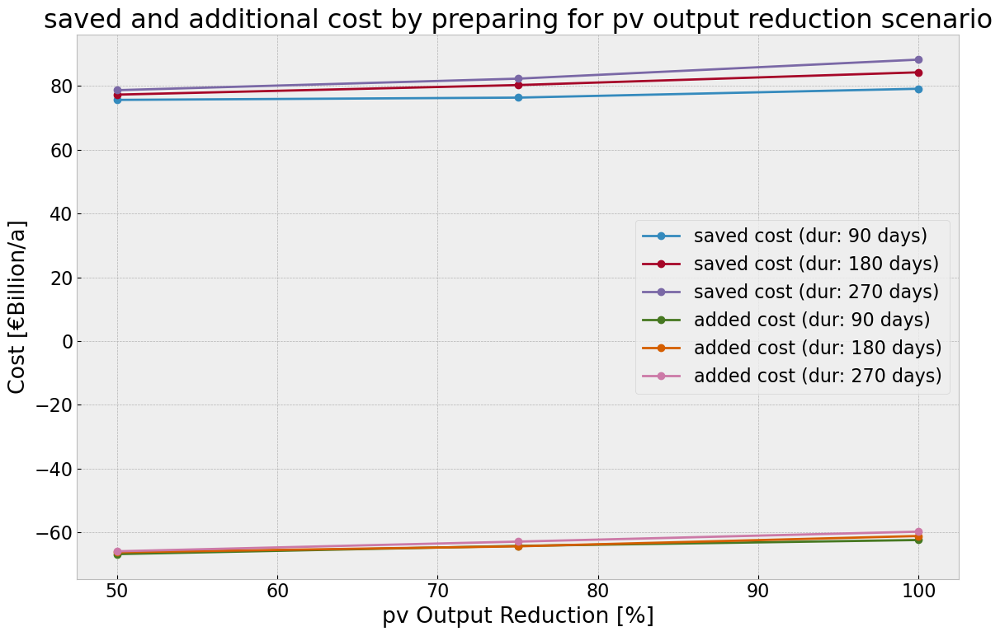

In [183]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [184]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [185]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [186]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '22.888536499999997' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.1032' has dtype incompa

In [187]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'offwind': 0, 'solar': 1, 'OCGT': 2, 'onwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

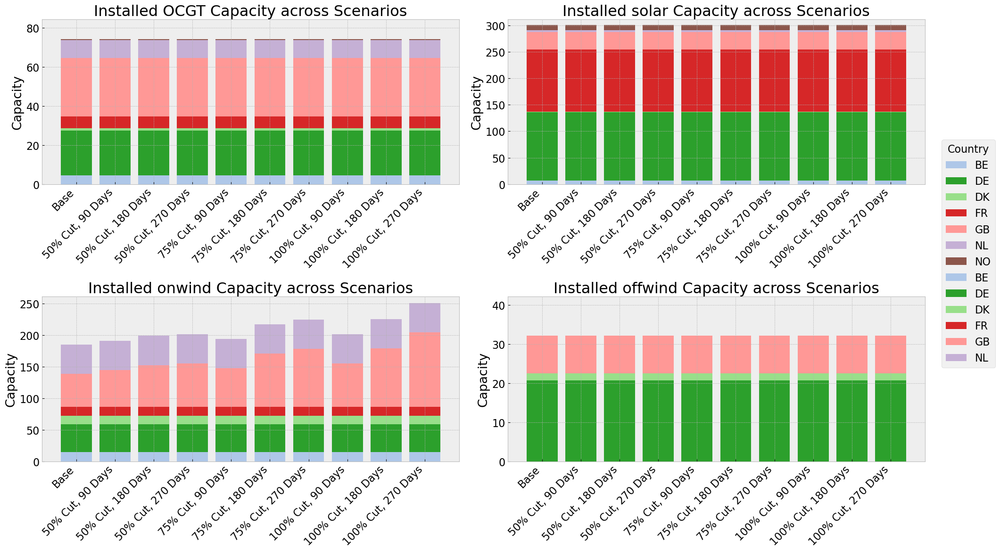

In [188]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [189]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '7.59922' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.9763' has dtype incompatible with int64, please explicitly cast to a compatible d

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

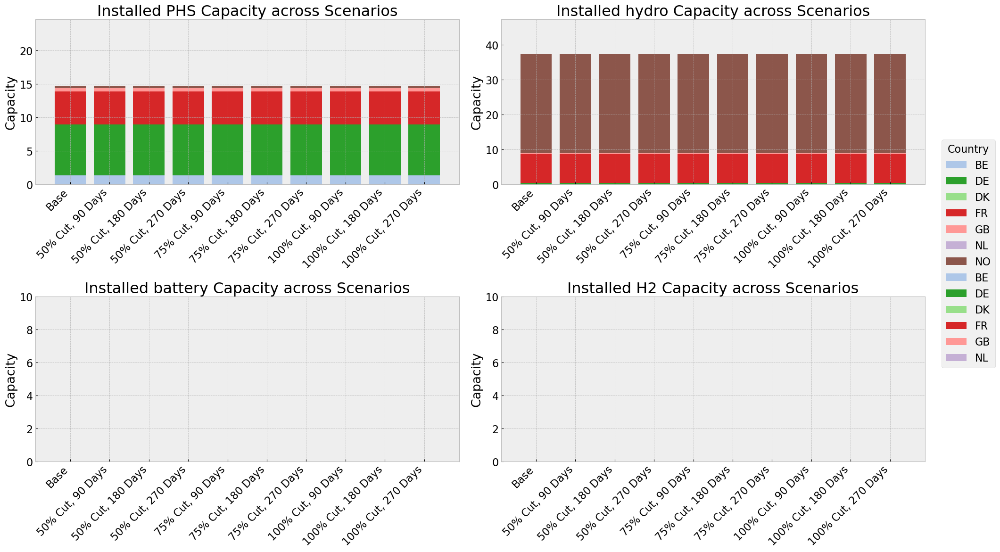

In [190]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [191]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '19.215371659169126' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.4377632528601' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '59.27718722299499' has dtype incompa

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_10408\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


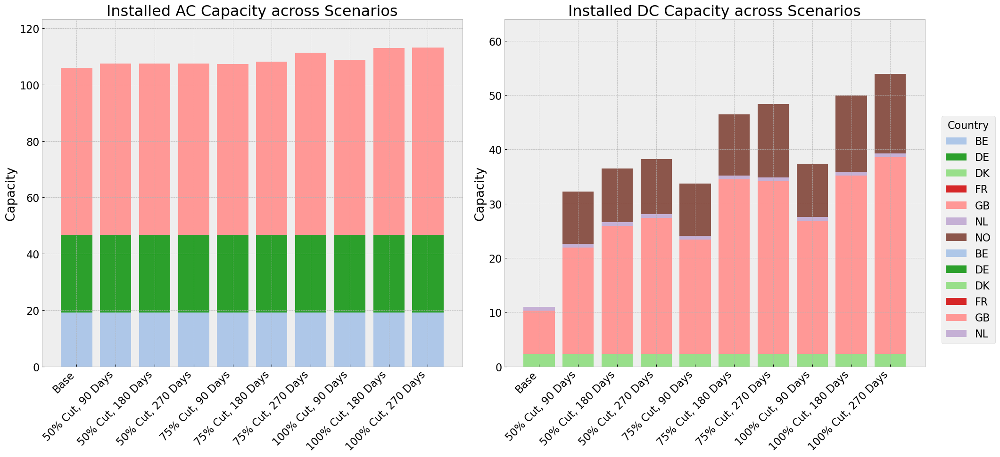

In [192]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()